# Define Input Folder and Files

In [1]:
import os

# Define the folder path
input_folder = "Input_Folder_without_Nan_KNN"

# Get the list of CSV file names in the folder
input_files = [file for file in os.listdir(input_folder) if file.endswith('.csv')]

# Print the results
print("Input Folder:", input_folder)
print(f"Input Files: {len(input_files)}")
print(input_files)


Input Folder: Input_Folder_without_Nan_KNN
Input Files: 41
['UP002.csv', 'UP003.csv', 'UP004.csv', 'UP008.csv', 'UP009.csv', 'UP012.csv', 'UP014.csv', 'UP016.csv', 'UP017.csv', 'UP018.csv', 'UP019.csv', 'UP020.csv', 'UP021.csv', 'UP022.csv', 'UP023.csv', 'UP024.csv', 'UP025.csv', 'UP026.csv', 'UP028.csv', 'UP029.csv', 'UP030.csv', 'UP031.csv', 'UP032.csv', 'UP033.csv', 'UP034.csv', 'UP035.csv', 'UP036.csv', 'UP037.csv', 'UP038.csv', 'UP039.csv', 'UP040.csv', 'UP041.csv', 'UP042.csv', 'UP043.csv', 'UP044.csv', 'UP046.csv', 'UP048.csv', 'UP049.csv', 'UP050.csv', 'UP051.csv', 'UP052.csv']


In [2]:
import pandas as pd

dataframes_dictionary = {}  # Dictionary to store DataFrames
print(input_folder)
for file in input_files:
    file_path = os.path.join(input_folder, file)
    if os.path.exists(file_path):
        # Load the CSV file
        df = pd.read_csv(file_path)
        dataframes_dictionary[file] = df


Input_Folder_without_Nan_KNN


# Add Additional columns to the dataframes

In [3]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
import torch
import torch.nn.functional as F
from torch_geometric.nn import GATConv
from torch_geometric.data import Data

from sklearn.preprocessing import LabelEncoder

# Initialize a label encoder
label_encoder = LabelEncoder()

# Load and process the data
dataframes = []
for file_name in input_files:
    df = dataframes_dictionary[file_name]
    
    # Convert 'From Date' to pandas datetime
    df['From Date'] = pd.to_datetime(df['From Date'])
    
    # Split 'From Date' into Year, Month, Day, Hour
    df['Year'] = df['From Date'].dt.year
    df['Month'] = df['From Date'].dt.month
    df['Day'] = df['From Date'].dt.day
    df['Hour'] = df['From Date'].dt.hour
    
    # Drop the original 'From Date' column
    df.drop('From Date', axis=1, inplace=True)
    
    dataframes.append(df)


# Split the data into training and test sets

In [4]:
train_dataframes = []
test_dataframes = []

split_ratio = 0.85  # 85% train, 15% test
train_size = int(len(dataframes[0]) * split_ratio)

for node_idx, df in enumerate(dataframes):
    # Split the dataframe into train and test sets

    train_df = df.iloc[:train_size]
    test_df = df.iloc[train_size:]
    
    # Append the train and test dataframes to the respective lists
    train_dataframes.append(train_df)
    test_dataframes.append(test_df)

print(f"Train dataframes shape: {train_dataframes[0].shape}")
print(f"Test dataframes shape: {test_dataframes[0].shape}")    

Train dataframes shape: (8343, 15)
Test dataframes shape: (1473, 15)


# Scale the Data

In [7]:
from sklearn.preprocessing import StandardScaler

scalers = {}

feature_scalers = {}

print(train_dataframes[0].dtypes)

# Apply StandardScaler to all numeric columns except 'Year', 'Month', 'Day', 'Hour'
for node_idx, df in enumerate(train_dataframes):

    print(f"Training Processing {input_files[node_idx]}, node index: {node_idx}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = StandardScaler()
    df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
    feature_scalers[input_files[node_idx]] = scaler

    scaler1 = StandardScaler()
    df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
    
    # Save the scaler for the target column
    scalers[input_files[node_idx]] = scaler1


print(test_dataframes[0].dtypes)    

# Apply the same scaling to the test dataframes
for node_idx, df in enumerate(test_dataframes):

    print(f"Testing Processing {input_files[node_idx]}, node index: {node_idx}, shape: {df.shape}")
    # Encode the 'Year' column
    df['Year'] = label_encoder.fit_transform(df['Year'])

    numeric_columns = df.select_dtypes(include=[np.number]).columns.tolist()
    columns_to_scale = [col for col in numeric_columns if col not in ['Year', 'Month', 'Day', 'Hour', 'AT (degree C)']]
    
    scaler = feature_scalers[input_files[node_idx]]
    df[columns_to_scale] = scaler.transform(df[columns_to_scale])
    
    scaler1 = scalers[input_files[node_idx]]
    df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
 

PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
CO (mg/m3)       float64
Ozone (ug/m3)    float64
RH (%)           float64
WS (m/s)         float64
WD (degree)      float64
AT (degree C)    float64
Year               int32
Month              int32
Day                int32
Hour               int32
dtype: object
Training Processing UP002.csv, node index: 0
Training Processing UP003.csv, node index: 1
Training Processing UP004.csv, node index: 2
Training Processing UP008.csv, node index: 3
Training Processing UP009.csv, node index: 4
Training Processing UP012.csv, node index: 5
Training Processing UP014.csv, node index: 6
Training Processing UP016.csv, node index: 7
Training Processing UP017.csv, node index: 8
Training Processing UP018.csv, node index: 9
Training Processing UP019.csv, node index: 10
Training Processing UP020.csv, node index: 11
Training Processing UP021.csv, node index: 12
Training Processing UP0

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

Training Processing UP032.csv, node index: 22
Training Processing UP033.csv, node index: 23
Training Processing UP034.csv, node index: 24
Training Processing UP035.csv, node index: 25
Training Processing UP036.csv, node index: 26
Training Processing UP037.csv, node index: 27
Training Processing UP038.csv, node index: 28
Training Processing UP039.csv, node index: 29
Training Processing UP040.csv, node index: 30
Training Processing UP041.csv, node index: 31
Training Processing UP042.csv, node index: 32
Training Processing UP043.csv, node index: 33
Training Processing UP044.csv, node index: 34
Training Processing UP046.csv, node index: 35
Training Processing UP048.csv, node index: 36
Training Processing UP049.csv, node index: 37
Training Processing UP050.csv, node index: 38
Training Processing UP051.csv, node index: 39
Training Processing UP052.csv, node index: 40
PM2.5 (ug/m3)    float64
PM10 (ug/m3)     float64
NO (ug/m3)       float64
NO2 (ug/m3)      float64
SO2 (ug/m3)      float64
C

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.fit_transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Year'] = label_encoder.fit_transform(df['Year'])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

Testing Processing UP008.csv, node index: 3, shape: (1473, 15)
Testing Processing UP009.csv, node index: 4, shape: (1473, 15)
Testing Processing UP012.csv, node index: 5, shape: (1473, 15)
Testing Processing UP014.csv, node index: 6, shape: (1473, 15)
Testing Processing UP016.csv, node index: 7, shape: (1473, 15)
Testing Processing UP017.csv, node index: 8, shape: (1473, 15)
Testing Processing UP018.csv, node index: 9, shape: (1473, 15)
Testing Processing UP019.csv, node index: 10, shape: (1473, 15)
Testing Processing UP020.csv, node index: 11, shape: (1473, 15)
Testing Processing UP021.csv, node index: 12, shape: (1473, 15)
Testing Processing UP022.csv, node index: 13, shape: (1473, 15)
Testing Processing UP023.csv, node index: 14, shape: (1473, 15)
Testing Processing UP024.csv, node index: 15, shape: (1473, 15)
Testing Processing UP025.csv, node index: 16, shape: (1473, 15)
Testing Processing UP026.csv, node index: 17, shape: (1473, 15)
Testing Processing UP028.csv, node index: 18, s

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[columns_to_scale] = scaler.transform(df[columns_to_scale])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:46: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['AT (degree C)'] = scaler1.transform(df[['AT (degree C)']])
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\2524091884.py:37: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Tr

# Modifying the csv to add latitude and longitude

In [8]:
import pandas as pd

# Load the CSV file
file_path = 'final.csv'  # Replace with your file path
df = pd.read_csv(file_path, header=None)

# Define the new column names
new_columns = ['file_name', 'state', 'city', 'agency', 'station_location', 
               'start_month', 'start_month_num', 'start_year', 'latitude', 'longitude']

# Assign the new column names to the dataframe
df.columns = new_columns

# Save the modified dataframe back to CSV
modified_file_path = 'final_modified.csv'  # Specify the output file path
df.to_csv(modified_file_path, index=False)

print(f"Modified file saved as {modified_file_path}")

Modified file saved as final_modified.csv


# Checking if all files have latitudes and longitudes

In [9]:
import pandas as pd

# Load the CSV file
df = pd.read_csv('final_modified.csv')

# Remove ".csv" extension from the files_with_at_column
files_without_extension = [file.replace('.csv', '') for file in input_files]

# Filter rows from the dataframe where the file_name is in the files_without_extension array
filtered_df = df[df['file_name'].isin(files_without_extension)]

# Extract latitude and longitude of the filtered rows
filtered_lat_long_positions = filtered_df[['latitude', 'longitude']].values.tolist()

# Find file names that do not have latitude and longitude information
missing_files = [file for file in files_without_extension if file not in filtered_df['file_name'].values]

# Print the results
print("Filtered latitude and longitude positions:", filtered_lat_long_positions)
print("Files without latitude and longitude information:", missing_files)


Filtered latitude and longitude positions: [[26.828687, 80.968257], [25.347671, 82.98085], [27.198724, 78.006069], [28.543866, 77.331016], [28.662102, 77.373283], [28.478246, 77.481831], [29.467858, 77.711593], [28.722131, 77.753682], [28.694105, 77.4549], [28.645805, 77.369211], [28.73341, 77.298604], [28.553622, 77.47128], [28.58997, 77.311681], [28.569039, 77.397499], [28.957922, 77.759078], [26.849806, 81.007399], [29.002044, 77.760152], [29.06265, 77.71476], [27.204282, 77.925518], [25.301191, 82.996499], [27.194169, 77.965192], [25.262166, 82.995247], [26.731409, 83.433118], [25.493404, 81.862706], [27.233706, 78.026988], [26.763279, 80.927821], [25.428788, 81.91389], [27.166823, 78.376626], [25.449042, 81.827394], [26.90648, 80.983889], [26.506816, 80.251968], [25.325445, 82.995173], [27.104555, 78.003352], [27.57421, 77.654082], [26.426674, 80.325968], [28.885193, 78.738921], [28.854246, 78.772174], [28.841239, 78.696695], [28.964466, 77.27869], [27.16446, 78.391286], [25.45357

# Calculating distances between the points

In [10]:
import math

# Function to calculate the Haversine distance between two points on the Earth
def haversine(lat1, lon1, lat2, lon2):
    # Radius of the Earth in kilometers
    R = 6371.0
    
    # Convert latitude and longitude from degrees to radians
    lat1_rad = math.radians(lat1)
    lon1_rad = math.radians(lon1)
    lat2_rad = math.radians(lat2)
    lon2_rad = math.radians(lon2)
    
    # Differences in coordinates
    dlat = lat2_rad - lat1_rad
    dlon = lon2_rad - lon1_rad
    
    # Haversine formula
    a = math.sin(dlat / 2)**2 + math.cos(lat1_rad) * math.cos(lat2_rad) * math.sin(dlon / 2)**2
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    
    # Distance in kilometers
    distance = R * c
    return distance

# Initialize a 2D array to store the distances
num_stations = len(filtered_lat_long_positions)
distance_matrix = [[0] * num_stations for _ in range(num_stations)]

# Iterate over the array to calculate distances between each pair of stations
for i in range(num_stations):
    for j in range(num_stations):
        lat1, lon1 = filtered_lat_long_positions[i]
        lat2, lon2 = filtered_lat_long_positions[j]
        
        # Check if any latitude or longitude is None
        if None in (lat1, lon1, lat2, lon2):
            distance_matrix[i][j] = -1
        else:
            # Calculate the distance using the Haversine formula
            distance_matrix[i][j] = haversine(lat1, lon1, lat2, lon2)

# Output the 2D distance array
for row in distance_matrix:
    print(row)

# Get the number of rows (length of the outer list)
rows = len(distance_matrix)

# Get the number of columns (length of the first inner list, assuming all rows have the same number of columns)
columns = len(distance_matrix[0]) if rows > 0 else 0

# Print the shape
print(f"Shape: ({rows}, {columns})")


[0.0, 259.831294268261, 296.3073062470489, 405.71967084165664, 408.2831201387903, 389.2780421976758, 433.6248093898384, 379.9022461663081, 403.1202784144766, 407.75269006951396, 418.5168023768209, 394.0985785077845, 409.75765217382735, 401.26086412872326, 394.3312597566813, 4.538336824596205, 397.16042095417515, 404.7358890189317, 304.28787362360157, 264.3631791522258, 300.25474049648807, 267.10222540161783, 244.91806957183363, 173.24469530741052, 294.77943248602156, 8.30691912317224, 182.0490886691721, 259.5051000084394, 175.75234561274783, 8.788059469298602, 79.66689357184394, 262.5205143903347, 295.4259311719268, 338.07059597527996, 77.93792481191839, 316.7232944225239, 311.9990131479505, 316.1633594061282, 433.3949665835895, 258.0326294852914, 281.95404023105255]
[259.831294268261, 0.0, 536.971001381933, 663.1333206367073, 666.5260268959933, 646.748508222628, 692.9632693541472, 639.2595346251944, 661.7347052324445, 665.8970511529196, 676.9228193417765, 652.0154437921375, 667.406227

# Plotting the points on the map

In [11]:
import folium

avg_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
avg_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
my_map = folium.Map(location=[avg_lat, avg_long], zoom_start=5)
    
# Add markers for each position
for lat, long in filtered_lat_long_positions:
    folium.Marker(location=[lat, long]).add_to(my_map)
    
# Save the map to an HTML file
my_map.save("map.html")

# Display the map in the notebook
my_map


# Plotting the points in a plot

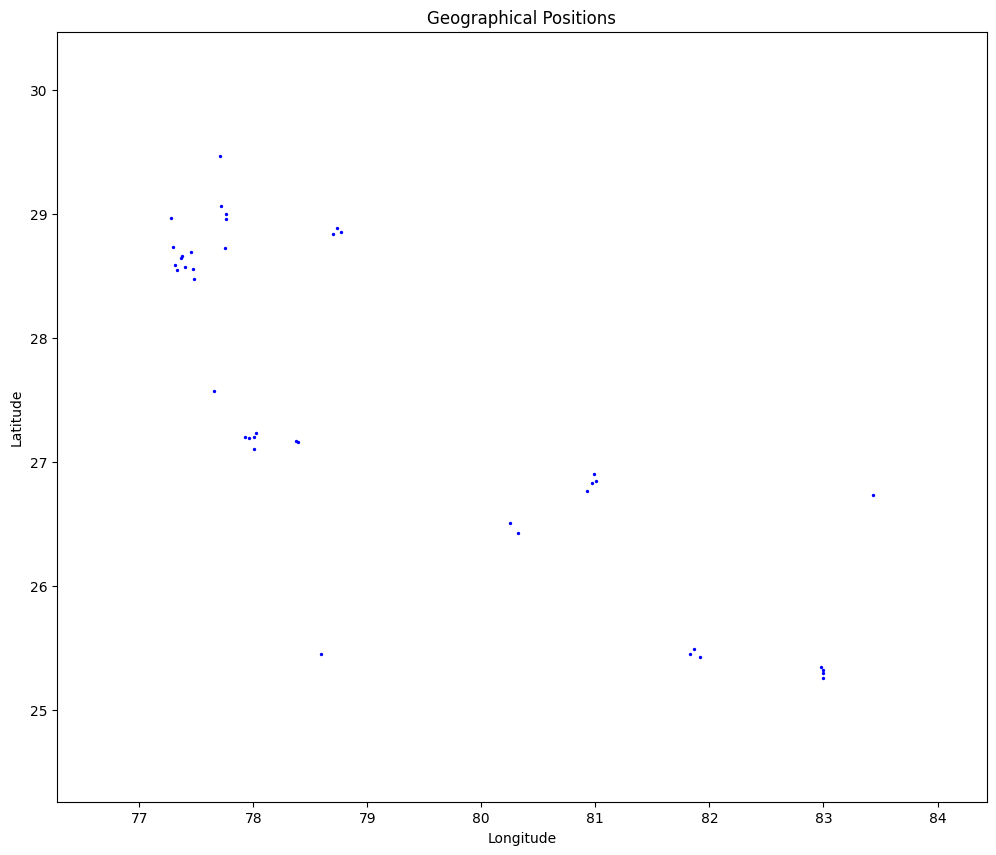

In [12]:
import matplotlib.pyplot as plt

# Split the latitude and longitude into separate lists
latitudes = [pos[0] for pos in filtered_lat_long_positions]
longitudes = [pos[1] for pos in filtered_lat_long_positions]

# Create a scatter plot with a larger figure size
plt.figure(figsize=(12, 10))  # Increase the figure size

# Plot the points with a larger marker size
plt.scatter(longitudes, latitudes, color='blue', marker='o', s=2)

# Label the axes
plt.xlabel('Longitude')
plt.ylabel('Latitude')

# Title of the plot
plt.title('Geographical Positions')

# Set the axis limits to zoom in and create more space between points
plt.xlim(min(longitudes) - 1, max(longitudes) + 1)
plt.ylim(min(latitudes) - 1, max(latitudes) + 1)

# Save the plot as an image file
output_image = 'positions_plot_large.png'
plt.savefig(output_image, dpi=300)  # Increase dpi for better resolution

# Show the plot
plt.show()


# Determine the k nearest neighbours

In [13]:
import numpy as np

k = 8  # Number of nearest neighbors

# Initialize adjacency matrix (with all zeros)
adjacency_matrix = np.zeros((len(input_files), len(input_files)), dtype=int)

# Loop through each entry to find k nearest neighbors
for i in range(len(input_files)):
    # Get distances for the i-th entry
    distances = distance_matrix[i]
    
    # Find the indices of the k smallest distances, excluding the distance to itself (i.e., index i)
    nearest_neighbors = np.argsort(distances)[1:k+1]  # 1:k+1 because argsort includes self-distance at position 0
    
    # Print the k nearest neighbors for the current file
    print(f"\nFile: {input_files[i]}")
    print(f"K-nearest neighbors: {[input_files[j] for j in nearest_neighbors]}")
    
    # Update the adjacency matrix to represent edges
    for neighbor in nearest_neighbors:
        adjacency_matrix[i][neighbor] = 1
        adjacency_matrix[neighbor][i] = 1  # Ensure undirected edge

# Print the adjacency matrix
print("\nAdjacency Matrix:")
print(adjacency_matrix)

# Print neighbors for each file based on the adjacency matrix
for i in range(len(input_files)):
    neighbors = [input_files[j] for j in range(len(input_files)) if adjacency_matrix[i][j] == 1]
    print(f"\nNeighbors of {input_files[i]} based on adjacency matrix: {neighbors}")


File: UP002.csv
K-nearest neighbors: ['UP024.csv', 'UP035.csv', 'UP039.csv', 'UP044.csv', 'UP040.csv', 'UP033.csv', 'UP038.csv', 'UP036.csv']

File: UP003.csv
K-nearest neighbors: ['UP041.csv', 'UP029.csv', 'UP031.csv', 'UP036.csv', 'UP033.csv', 'UP038.csv', 'UP032.csv', 'UP024.csv']

File: UP004.csv
K-nearest neighbors: ['UP030.csv', 'UP034.csv', 'UP028.csv', 'UP042.csv', 'UP037.csv', 'UP051.csv', 'UP043.csv', 'UP012.csv']

File: UP008.csv
K-nearest neighbors: ['UP021.csv', 'UP022.csv', 'UP018.csv', 'UP020.csv', 'UP009.csv', 'UP012.csv', 'UP017.csv', 'UP019.csv']

File: UP009.csv
K-nearest neighbors: ['UP018.csv', 'UP017.csv', 'UP021.csv', 'UP022.csv', 'UP019.csv', 'UP008.csv', 'UP020.csv', 'UP012.csv']

File: UP012.csv
K-nearest neighbors: ['UP020.csv', 'UP022.csv', 'UP008.csv', 'UP021.csv', 'UP018.csv', 'UP009.csv', 'UP017.csv', 'UP019.csv']

File: UP014.csv
K-nearest neighbors: ['UP026.csv', 'UP025.csv', 'UP023.csv', 'UP050.csv', 'UP016.csv', 'UP017.csv', 'UP019.csv', 'UP009.csv']

# Plotting the edges on the map

In [14]:
import folium

# Create a Folium map centered at the average of the coordinates
center_lat = sum([pos[0] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)
center_long = sum([pos[1] for pos in filtered_lat_long_positions]) / len(filtered_lat_long_positions)

# Initialize the map
m = folium.Map(location=[center_lat, center_long], zoom_start=5)

# Add markers for each position
for idx, (lat, long) in enumerate(filtered_lat_long_positions):
    folium.Marker([lat, long], tooltip=f'Point {idx + 1}').add_to(m)

# Add edges based on adjacency matrix
for i in range(len(adjacency_matrix)):
    for j in range(i + 1, len(adjacency_matrix)):  # Only check upper triangle to avoid duplicate edges
        if adjacency_matrix[i][j] == 1:
            # Draw a line between point i and point j
            folium.PolyLine([filtered_lat_long_positions[i], filtered_lat_long_positions[j]], color="blue").add_to(m)

# Save the map to an HTML file or display in Jupyter notebook
m.save("map_with_edges.html")

# To display directly in Jupyter notebook
m


# Change the diagonal elements to 1

In [15]:
# Change the diagonal elements to 1
np.fill_diagonal(adjacency_matrix, 1)
adjacency_matrix

array([[1, 0, 0, ..., 0, 0, 0],
       [0, 1, 0, ..., 0, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       ...,
       [0, 0, 0, ..., 1, 0, 0],
       [0, 0, 1, ..., 0, 1, 1],
       [0, 0, 1, ..., 0, 1, 1]])

# Prepare Graph Data for GNN

In [16]:
# Prepare graph data for each timestamp
def prepare_graph_data_for_timestamp(dataframes, adjacency_matrix, timestamp_index):
    # Extract the row corresponding to the timestamp index from all CSV files
    features = np.stack([df.iloc[timestamp_index].values for df in dataframes], axis=0)  # shape (num_nodes, num_features)
    
    # Create node features (tensor)
    node_features = torch.tensor(features, dtype=torch.float)
    
    # Create edge index (adjacency matrix)
    edge_index = torch.tensor(np.array(np.nonzero(adjacency_matrix)), dtype=torch.long)
    
    # Create target tensor (for 'AT (degree C)')
    target_values = torch.tensor([df.iloc[timestamp_index]['AT (degree C)'] for df in dataframes], dtype=torch.float)
    
    graph_data = Data(x=node_features, edge_index=edge_index, y=target_values)
    print(f"Graph data for timestamp {timestamp_index} created.")
    print(graph_data)
    return graph_data

# Get the number of timestamps
train_num_timestamps = len(train_dataframes[0])
test_num_timestamps = len(test_dataframes[0])

# Prepare graph data for each timestamp
train_graph_data_list = [prepare_graph_data_for_timestamp(train_dataframes, adjacency_matrix, i) for i in range(train_num_timestamps)]
test_graph_data_list = [prepare_graph_data_for_timestamp(test_dataframes, adjacency_matrix, i) for i in range(test_num_timestamps)]

print(f"Number of graph data objects created for training: {len(train_graph_data_list)}")
print(f"Number of graph data objects created for testing: {len(test_graph_data_list)}")
print("Sample training graph data object:")
print(train_graph_data_list[0])
print("Sample testing graph data object:")
print(test_graph_data_list[0])

Graph data for timestamp 0 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 1 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 2 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 3 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 4 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 5 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 6 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 7 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 8 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 9 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 10 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for timestamp 11 created.
Data(x=[41, 15], edge_index=[2, 451], y=[41])
Graph data for

# GAT Implementation

Epoch 0, Loss: 0.3693397545861756
Epoch 1, Loss: 0.16678145413196452
Epoch 2, Loss: 0.1592537150103753
Epoch 3, Loss: 0.15595426479099764
Epoch 4, Loss: 0.15561324802784238
Epoch 5, Loss: 0.15187743308414883
Epoch 6, Loss: 0.15175301398839486
Epoch 7, Loss: 0.15156993560781443
Epoch 8, Loss: 0.15196346368504027
Epoch 9, Loss: 0.151549806810552
Epoch 10, Loss: 0.15091920374817525
Epoch 11, Loss: 0.15100829508182376
Epoch 12, Loss: 0.15078153758162766
Epoch 13, Loss: 0.15060840199415607
Epoch 14, Loss: 0.15135974590120166
Epoch 15, Loss: 0.15065529477766584
Epoch 16, Loss: 0.15058874349001214
Epoch 17, Loss: 0.15059441027330753
Epoch 18, Loss: 0.15021224363526056
Epoch 19, Loss: 0.15043068435107843
Epoch 20, Loss: 0.15056510880599755
Epoch 21, Loss: 0.15011309425937183
Epoch 22, Loss: 0.15007331738949276
Epoch 23, Loss: 0.1501958523923291
Epoch 24, Loss: 0.15016719396759137
Epoch 25, Loss: 0.14996342303517798
Epoch 26, Loss: 0.15072444711899916
Epoch 27, Loss: 0.150141090529722
Epoch 28,

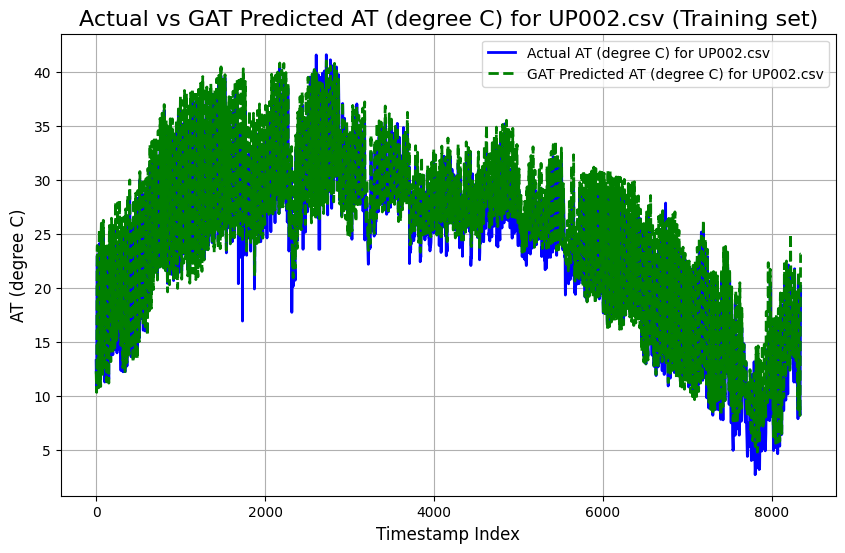

UP003.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3112
Mean Squared Error (MSE): 3.0098
Root Mean Squared Error (RMSE): 1.7349
Pearson Correlation Coefficient: 0.9834
R-squared (R²): 0.9603

----------------------------------------



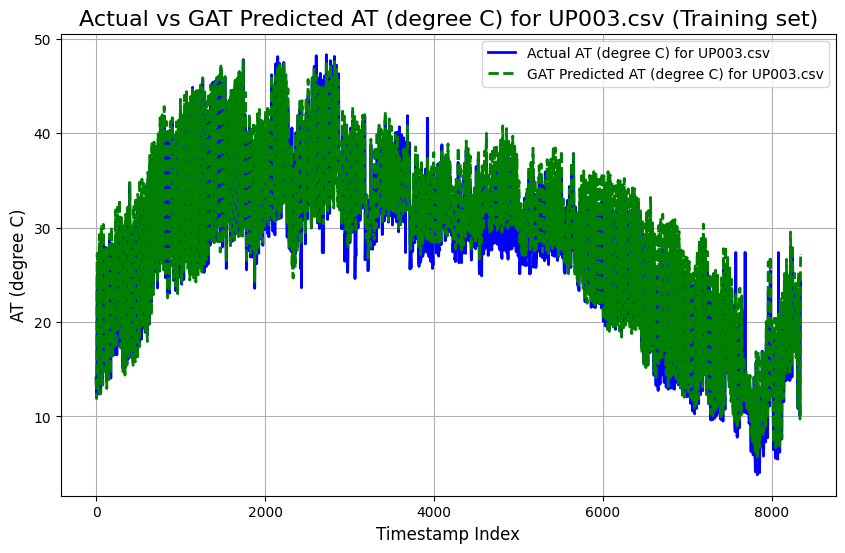

UP004.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5666
Mean Squared Error (MSE): 3.9776
Root Mean Squared Error (RMSE): 1.9944
Pearson Correlation Coefficient: 0.9784
R-squared (R²): 0.9521

----------------------------------------



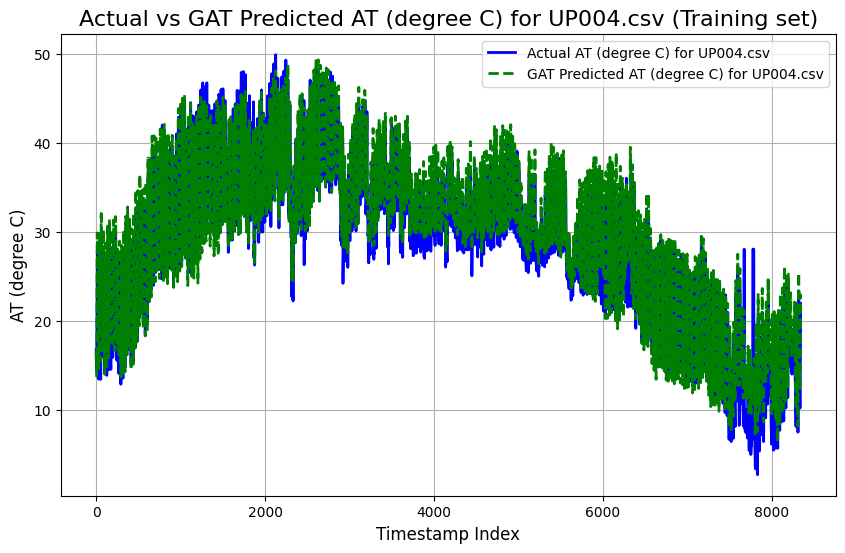

UP008.csv (Training set) Metrics:
Mean Absolute Error (MAE): 5.6247
Mean Squared Error (MSE): 66.0239
Root Mean Squared Error (RMSE): 8.1255
Pearson Correlation Coefficient: 0.7645
R-squared (R²): 0.5477

----------------------------------------



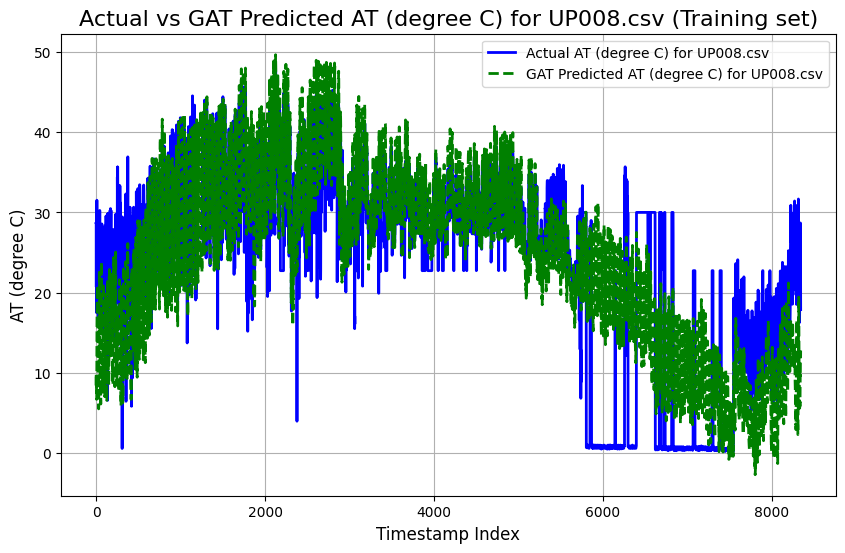

UP009.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3132
Mean Squared Error (MSE): 3.4037
Root Mean Squared Error (RMSE): 1.8449
Pearson Correlation Coefficient: 0.9736
R-squared (R²): 0.9427

----------------------------------------



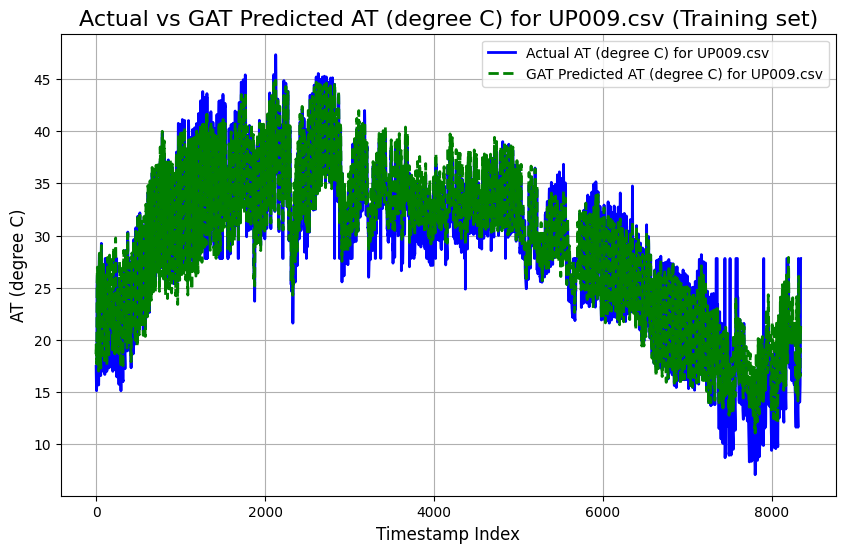

UP012.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.7731
Mean Squared Error (MSE): 8.2557
Root Mean Squared Error (RMSE): 2.8733
Pearson Correlation Coefficient: 0.9633
R-squared (R²): 0.9227

----------------------------------------



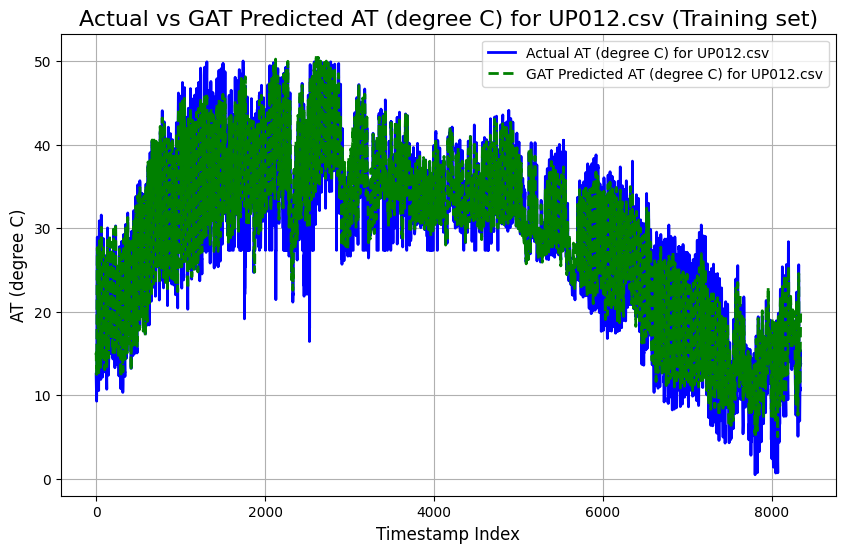

UP014.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.1644
Mean Squared Error (MSE): 16.3485
Root Mean Squared Error (RMSE): 4.0433
Pearson Correlation Coefficient: 0.9400
R-squared (R²): 0.8768

----------------------------------------



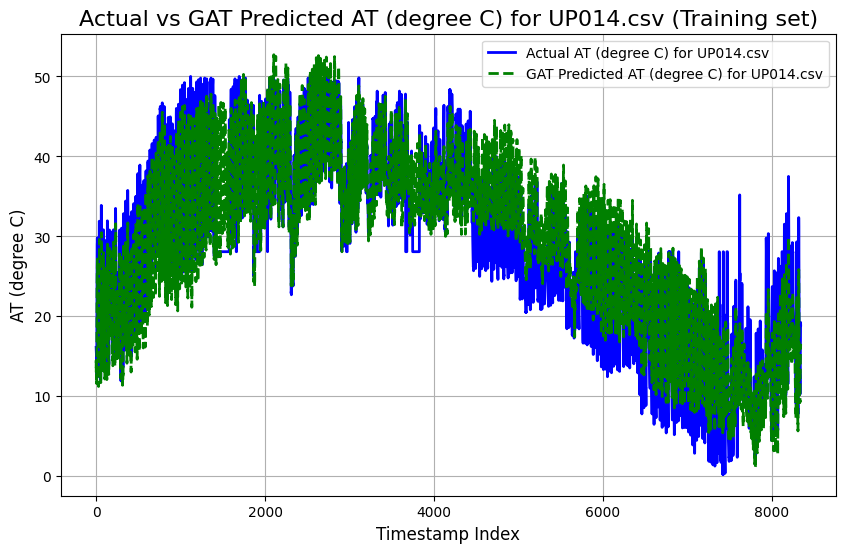

UP016.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.9942
Mean Squared Error (MSE): 16.1176
Root Mean Squared Error (RMSE): 4.0147
Pearson Correlation Coefficient: 0.9435
R-squared (R²): 0.8839

----------------------------------------



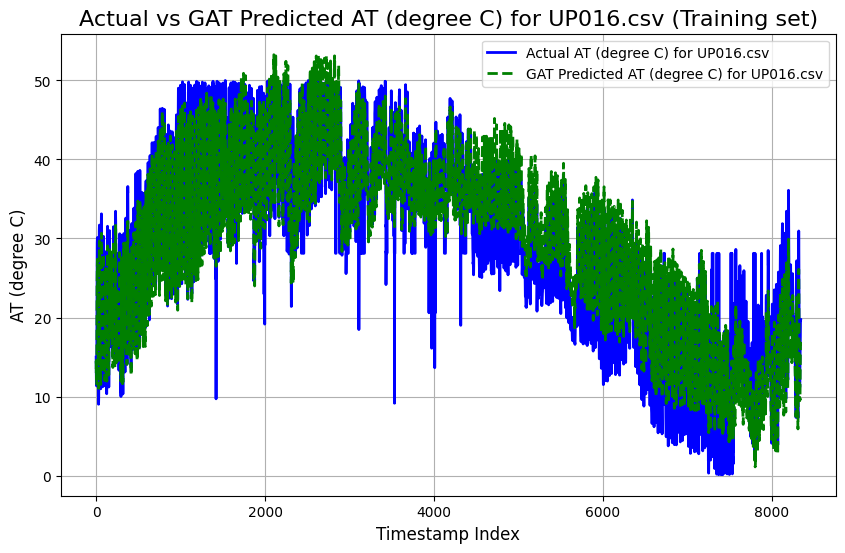

UP017.csv (Training set) Metrics:
Mean Absolute Error (MAE): 0.9404
Mean Squared Error (MSE): 1.3106
Root Mean Squared Error (RMSE): 1.1448
Pearson Correlation Coefficient: 0.9824
R-squared (R²): 0.9598

----------------------------------------



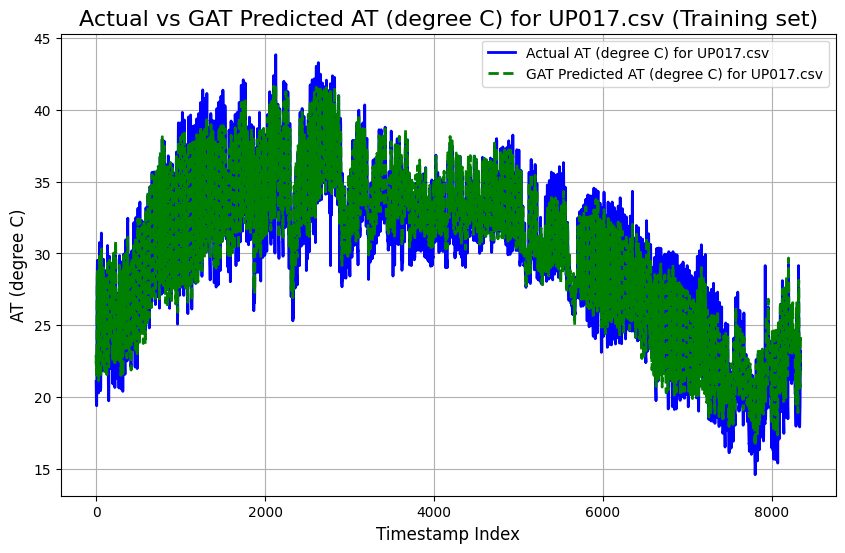

UP018.csv (Training set) Metrics:
Mean Absolute Error (MAE): 4.3889
Mean Squared Error (MSE): 40.5493
Root Mean Squared Error (RMSE): 6.3678
Pearson Correlation Coefficient: 0.5099
R-squared (R²): 0.0636

----------------------------------------



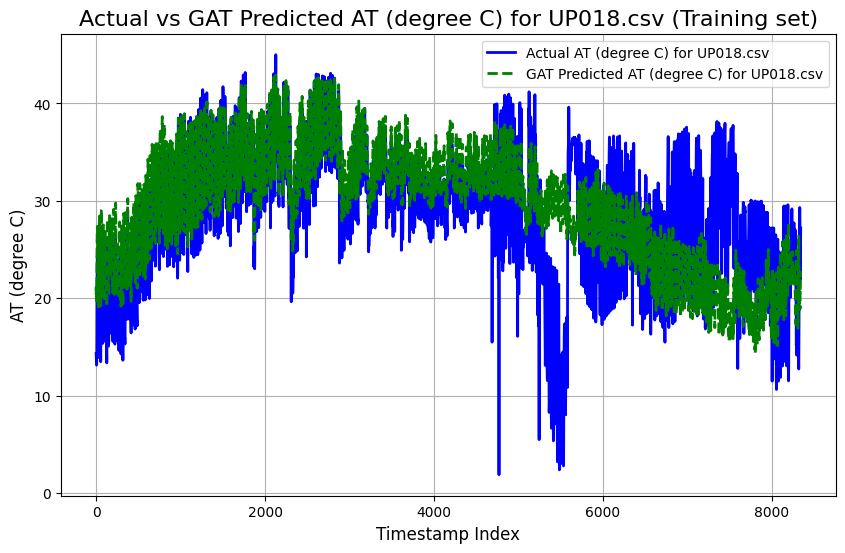

UP019.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.8015
Mean Squared Error (MSE): 7.1108
Root Mean Squared Error (RMSE): 2.6666
Pearson Correlation Coefficient: 0.8974
R-squared (R²): 0.7971

----------------------------------------



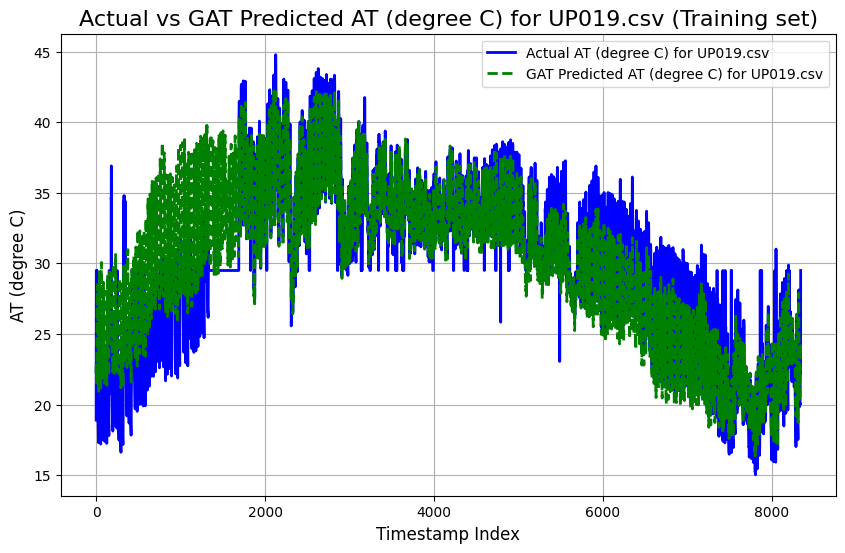

UP020.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3111
Mean Squared Error (MSE): 2.7685
Root Mean Squared Error (RMSE): 1.6639
Pearson Correlation Coefficient: 0.9781
R-squared (R²): 0.9511

----------------------------------------



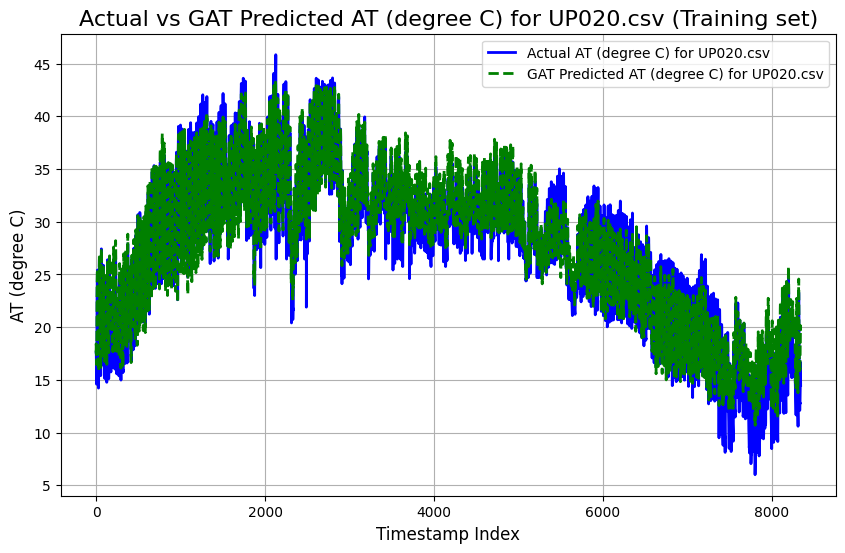

UP021.csv (Training set) Metrics:
Mean Absolute Error (MAE): 3.6356
Mean Squared Error (MSE): 23.4419
Root Mean Squared Error (RMSE): 4.8417
Pearson Correlation Coefficient: 0.8435
R-squared (R²): 0.6967

----------------------------------------



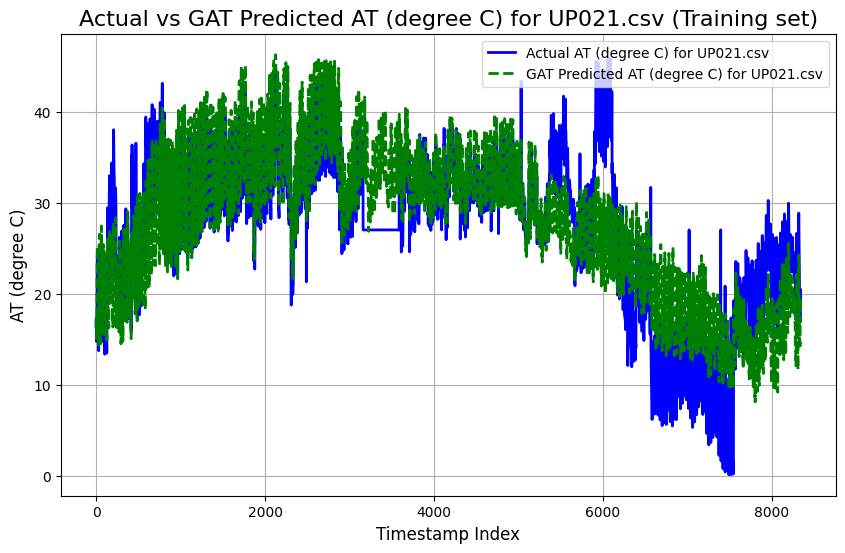

UP022.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3589
Mean Squared Error (MSE): 3.6586
Root Mean Squared Error (RMSE): 1.9127
Pearson Correlation Coefficient: 0.9702
R-squared (R²): 0.9360

----------------------------------------



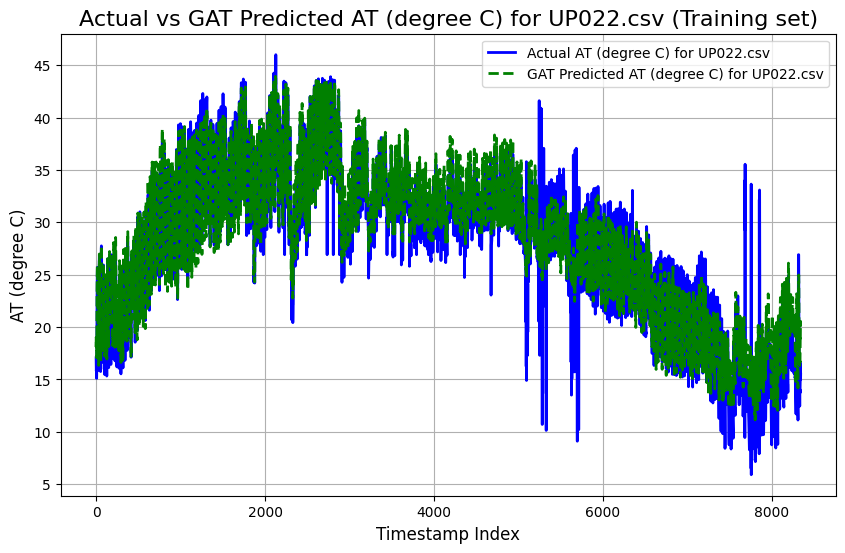

UP023.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.2922
Mean Squared Error (MSE): 14.2881
Root Mean Squared Error (RMSE): 3.7800
Pearson Correlation Coefficient: 0.8637
R-squared (R²): 0.7277

----------------------------------------



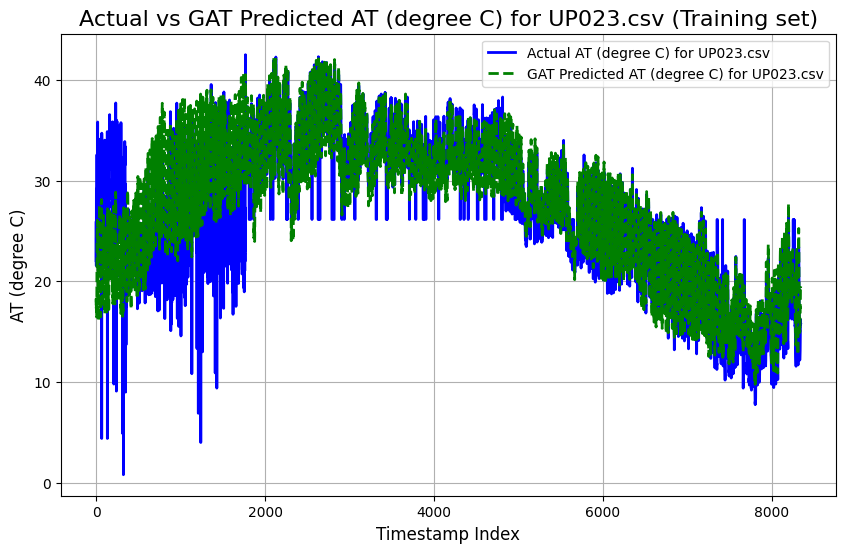

UP024.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6916
Mean Squared Error (MSE): 13.6743
Root Mean Squared Error (RMSE): 3.6979
Pearson Correlation Coefficient: 0.8264
R-squared (R²): 0.6423

----------------------------------------



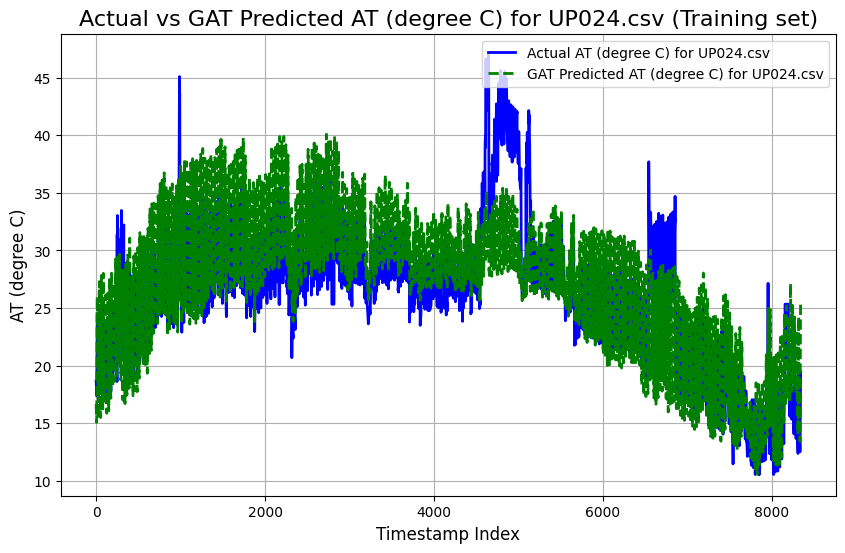

UP025.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2339
Mean Squared Error (MSE): 3.1994
Root Mean Squared Error (RMSE): 1.7887
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9451

----------------------------------------



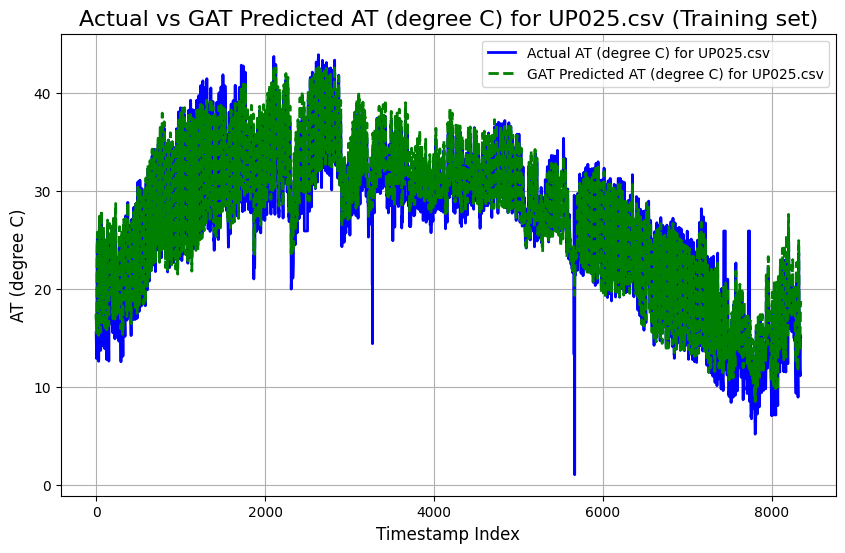

UP026.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1831
Mean Squared Error (MSE): 3.0205
Root Mean Squared Error (RMSE): 1.7380
Pearson Correlation Coefficient: 0.9800
R-squared (R²): 0.9553

----------------------------------------



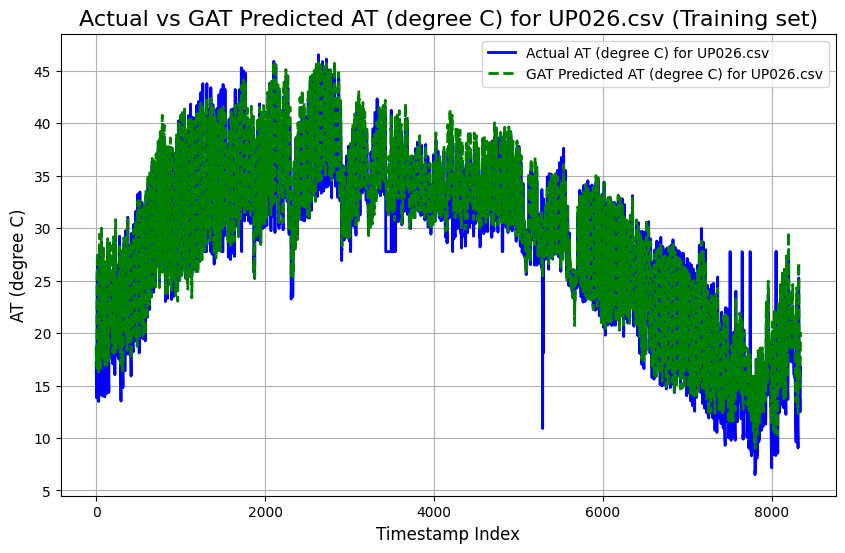

UP028.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.9088
Mean Squared Error (MSE): 5.8053
Root Mean Squared Error (RMSE): 2.4094
Pearson Correlation Coefficient: 0.9710
R-squared (R²): 0.9375

----------------------------------------



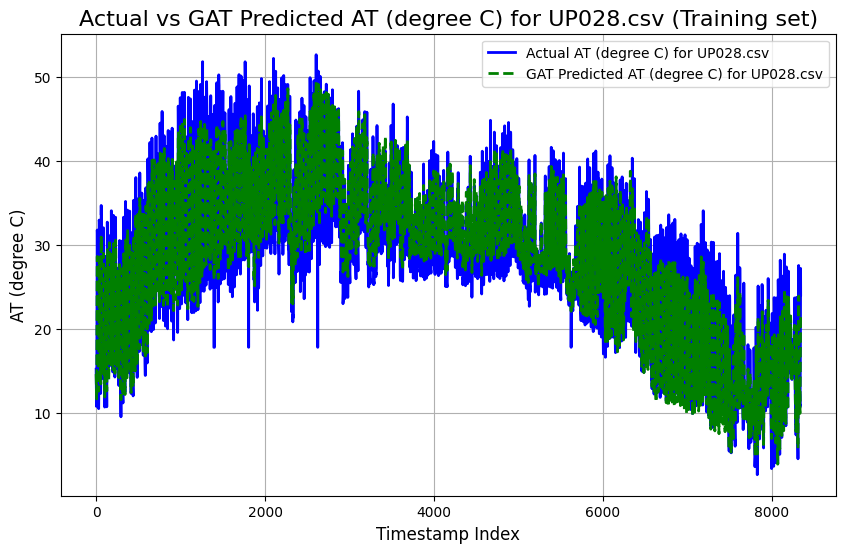

UP029.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1692
Mean Squared Error (MSE): 3.3412
Root Mean Squared Error (RMSE): 1.8279
Pearson Correlation Coefficient: 0.9751
R-squared (R²): 0.9433

----------------------------------------



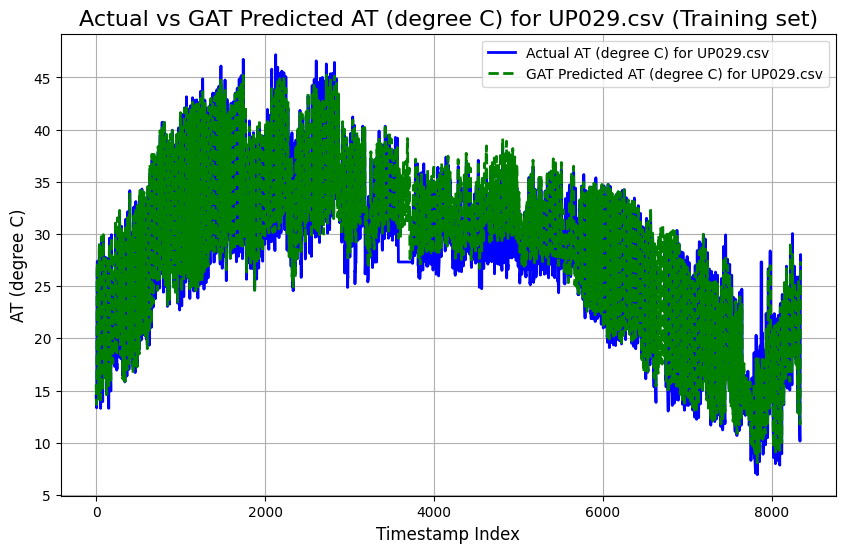

UP030.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4216
Mean Squared Error (MSE): 3.1814
Root Mean Squared Error (RMSE): 1.7836
Pearson Correlation Coefficient: 0.9829
R-squared (R²): 0.9610

----------------------------------------



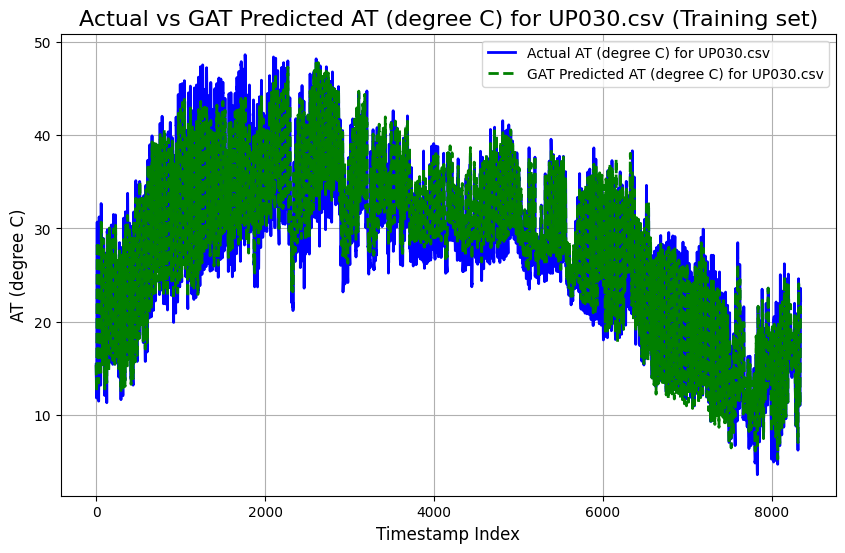

UP031.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5808
Mean Squared Error (MSE): 4.2869
Root Mean Squared Error (RMSE): 2.0705
Pearson Correlation Coefficient: 0.9720
R-squared (R²): 0.9371

----------------------------------------



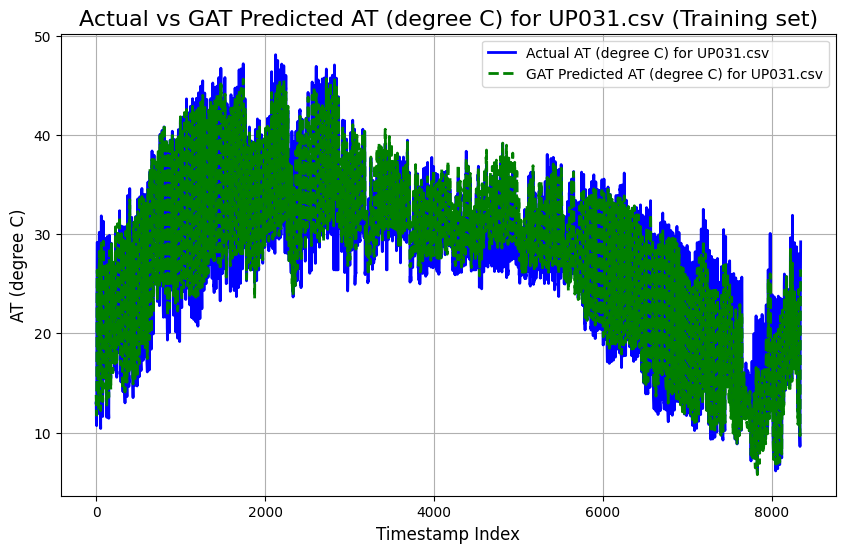

UP032.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4824
Mean Squared Error (MSE): 3.8680
Root Mean Squared Error (RMSE): 1.9667
Pearson Correlation Coefficient: 0.9674
R-squared (R²): 0.9277

----------------------------------------



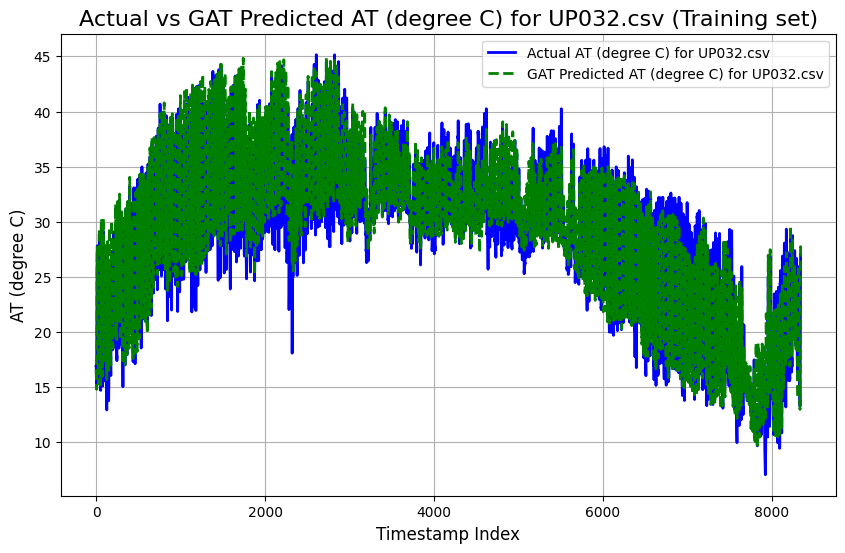

UP033.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.0364
Mean Squared Error (MSE): 2.2914
Root Mean Squared Error (RMSE): 1.5137
Pearson Correlation Coefficient: 0.9849
R-squared (R²): 0.9635

----------------------------------------



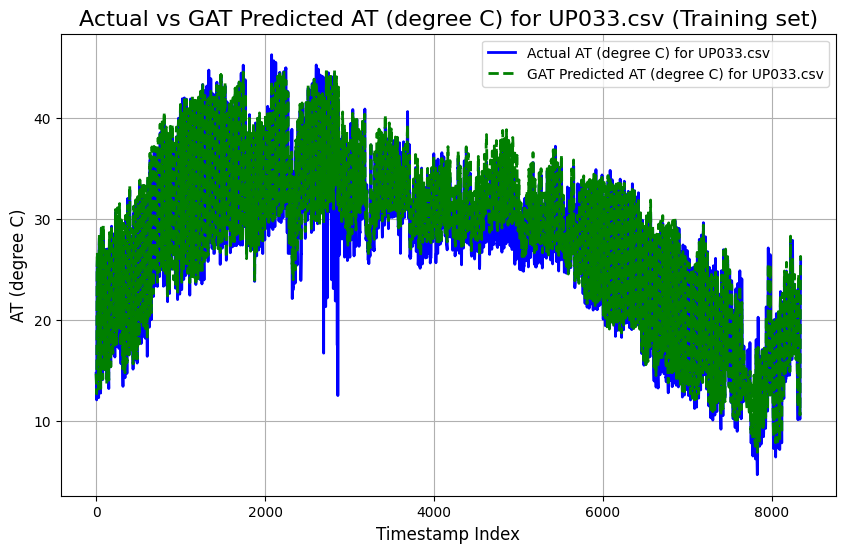

UP034.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5478
Mean Squared Error (MSE): 5.2209
Root Mean Squared Error (RMSE): 2.2849
Pearson Correlation Coefficient: 0.9737
R-squared (R²): 0.9429

----------------------------------------



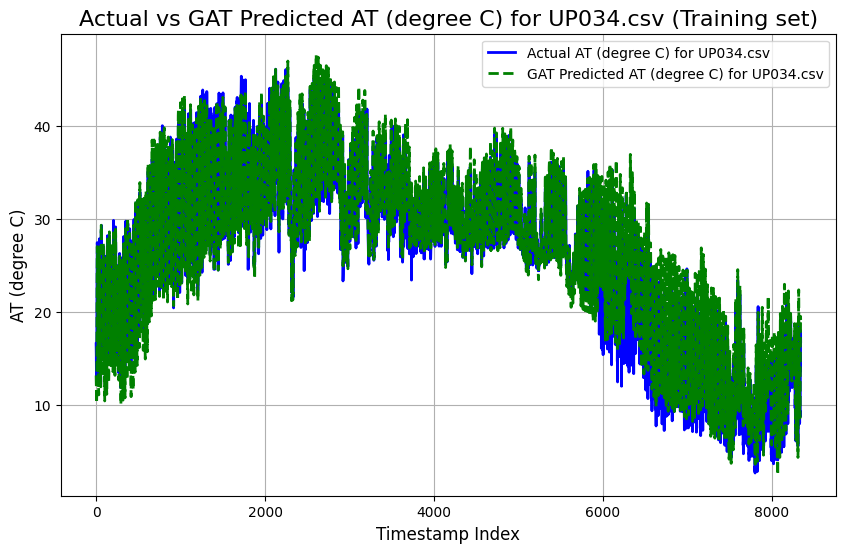

UP035.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1177
Mean Squared Error (MSE): 2.2884
Root Mean Squared Error (RMSE): 1.5128
Pearson Correlation Coefficient: 0.9867
R-squared (R²): 0.9671

----------------------------------------



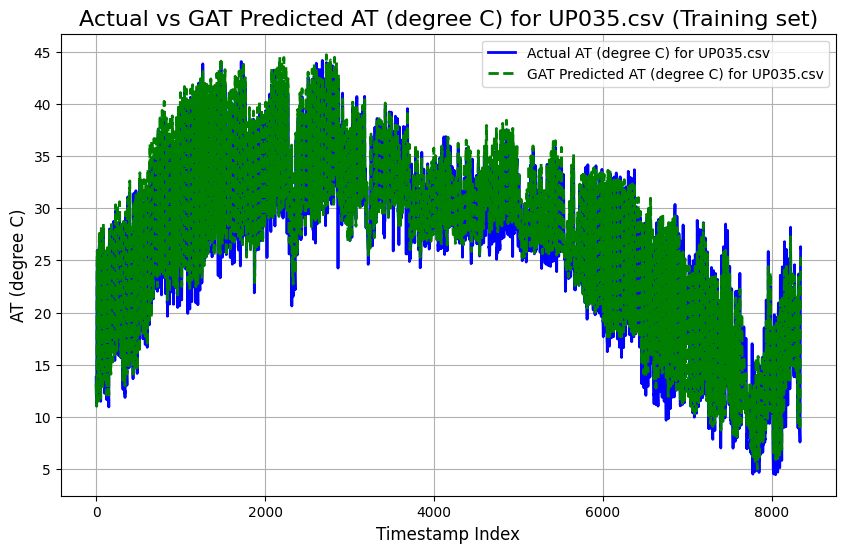

UP036.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.1957
Mean Squared Error (MSE): 3.0505
Root Mean Squared Error (RMSE): 1.7466
Pearson Correlation Coefficient: 0.9784
R-squared (R²): 0.9501

----------------------------------------



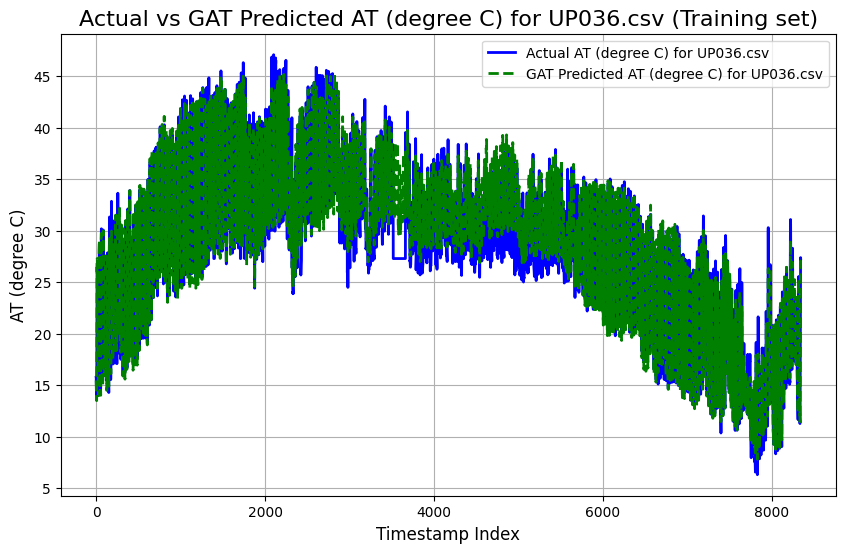

UP037.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4097
Mean Squared Error (MSE): 4.2697
Root Mean Squared Error (RMSE): 2.0663
Pearson Correlation Coefficient: 0.9742
R-squared (R²): 0.9439

----------------------------------------



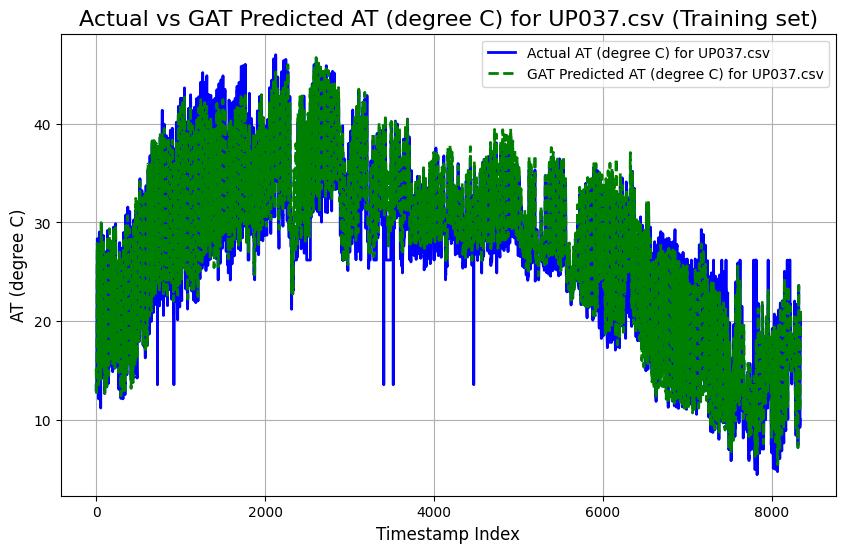

UP038.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3065
Mean Squared Error (MSE): 5.0492
Root Mean Squared Error (RMSE): 2.2470
Pearson Correlation Coefficient: 0.9601
R-squared (R²): 0.9133

----------------------------------------



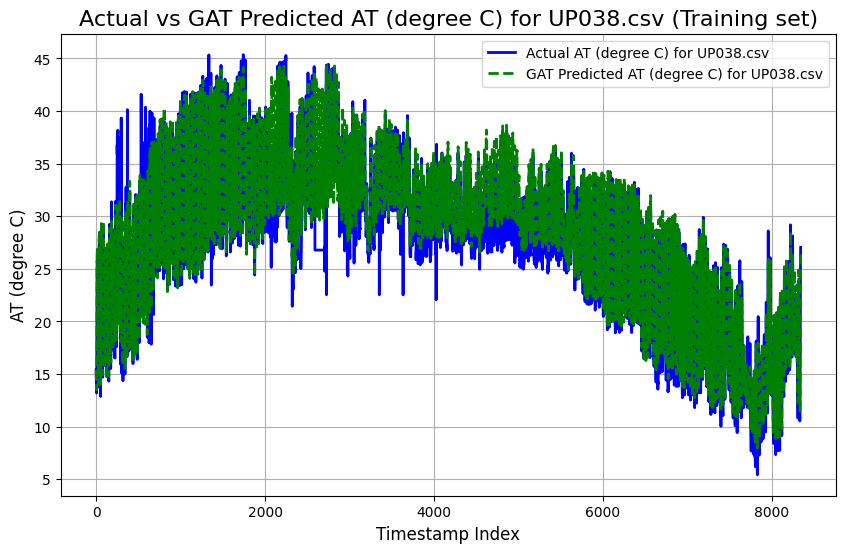

UP039.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6898
Mean Squared Error (MSE): 5.0447
Root Mean Squared Error (RMSE): 2.2461
Pearson Correlation Coefficient: 0.9713
R-squared (R²): 0.9360

----------------------------------------



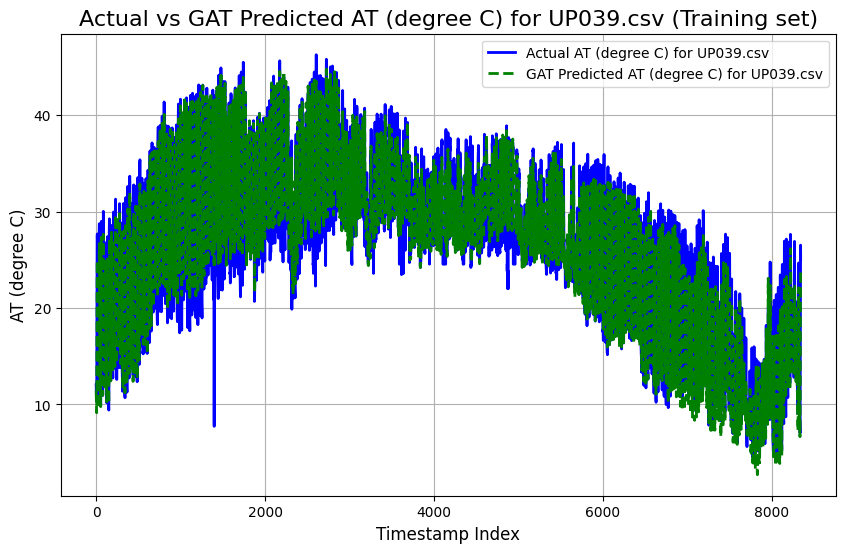

UP040.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4338
Mean Squared Error (MSE): 3.8367
Root Mean Squared Error (RMSE): 1.9587
Pearson Correlation Coefficient: 0.9789
R-squared (R²): 0.9520

----------------------------------------



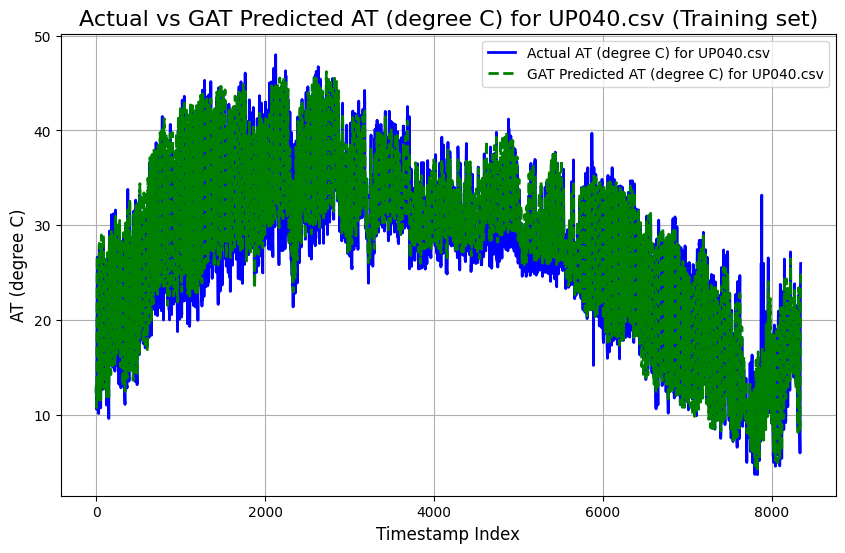

UP041.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.2190
Mean Squared Error (MSE): 3.6854
Root Mean Squared Error (RMSE): 1.9197
Pearson Correlation Coefficient: 0.9705
R-squared (R²): 0.9341

----------------------------------------



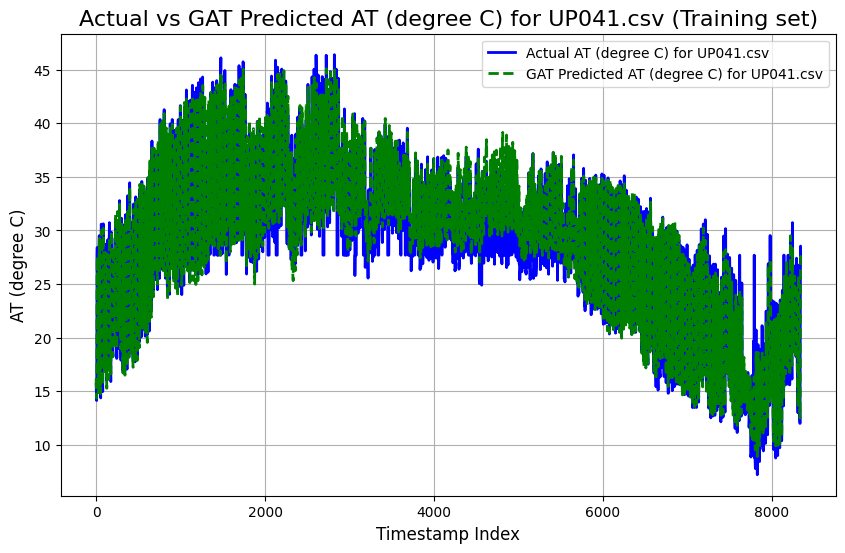

UP042.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.2578
Mean Squared Error (MSE): 14.8519
Root Mean Squared Error (RMSE): 3.8538
Pearson Correlation Coefficient: 0.8663
R-squared (R²): 0.7307

----------------------------------------



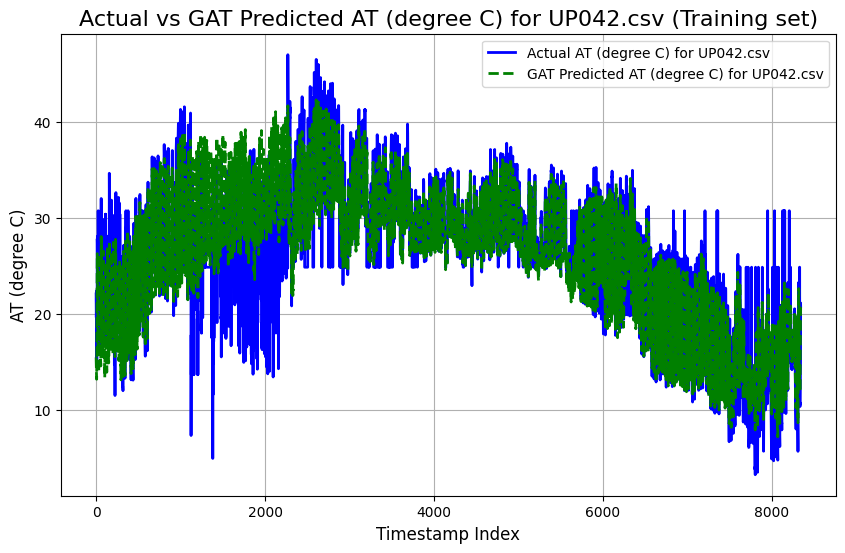

UP043.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.3029
Mean Squared Error (MSE): 12.8008
Root Mean Squared Error (RMSE): 3.5778
Pearson Correlation Coefficient: 0.8983
R-squared (R²): 0.7940

----------------------------------------



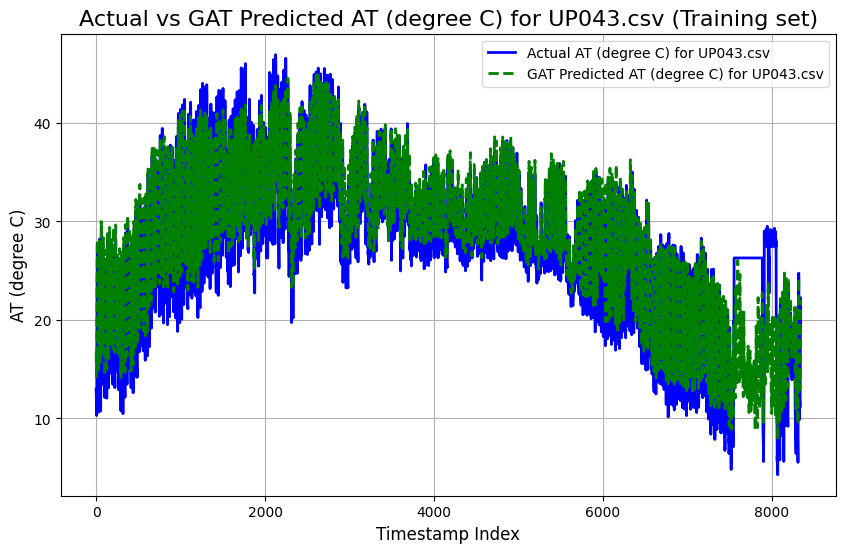

UP044.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.3024
Mean Squared Error (MSE): 3.5747
Root Mean Squared Error (RMSE): 1.8907
Pearson Correlation Coefficient: 0.9797
R-squared (R²): 0.9533

----------------------------------------



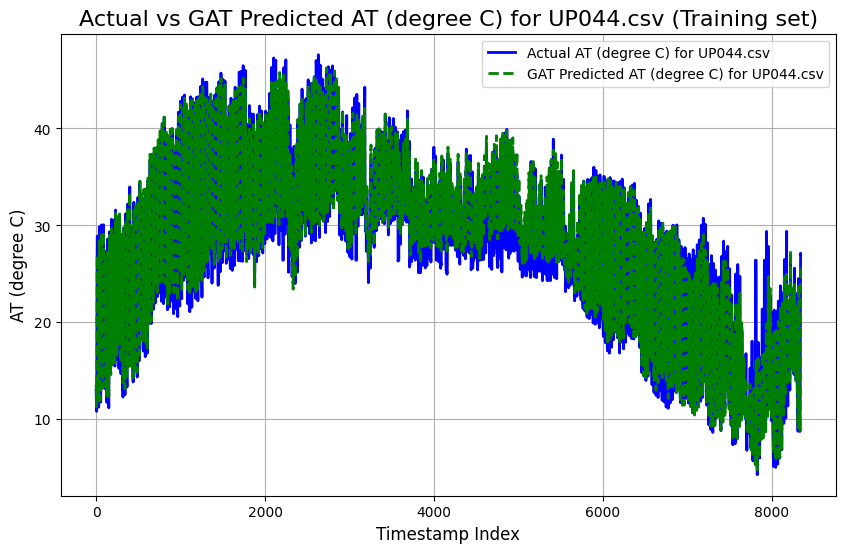

UP046.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.5388
Mean Squared Error (MSE): 4.3253
Root Mean Squared Error (RMSE): 2.0797
Pearson Correlation Coefficient: 0.9707
R-squared (R²): 0.9364

----------------------------------------



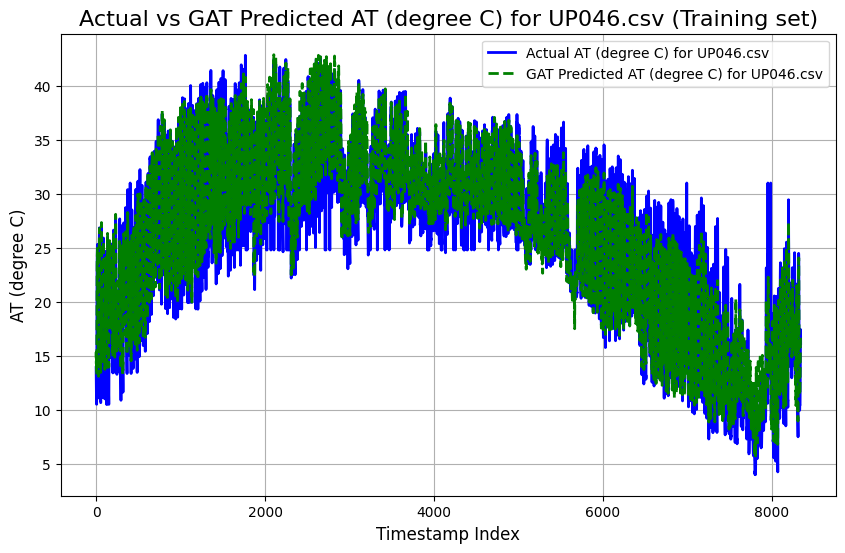

UP048.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.6593
Mean Squared Error (MSE): 5.2098
Root Mean Squared Error (RMSE): 2.2825
Pearson Correlation Coefficient: 0.9625
R-squared (R²): 0.9202

----------------------------------------



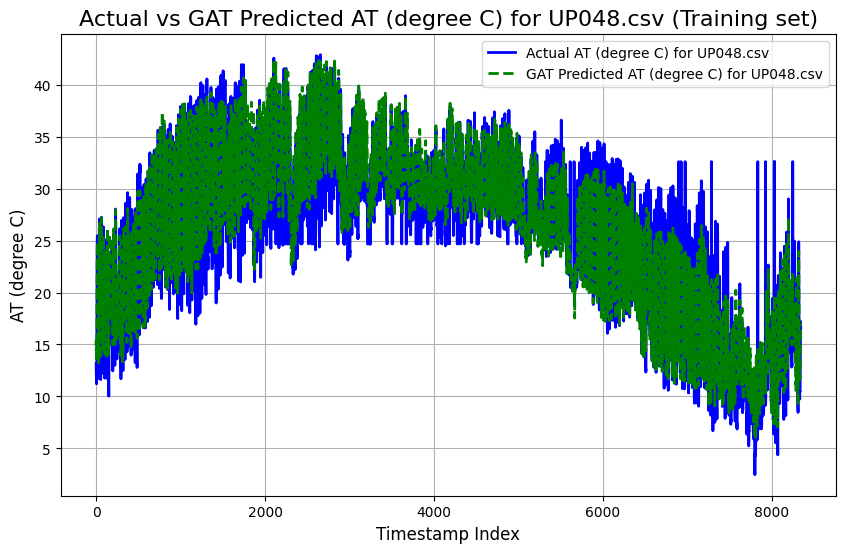

UP049.csv (Training set) Metrics:
Mean Absolute Error (MAE): 1.4678
Mean Squared Error (MSE): 4.9273
Root Mean Squared Error (RMSE): 2.2197
Pearson Correlation Coefficient: 0.9669
R-squared (R²): 0.9290

----------------------------------------



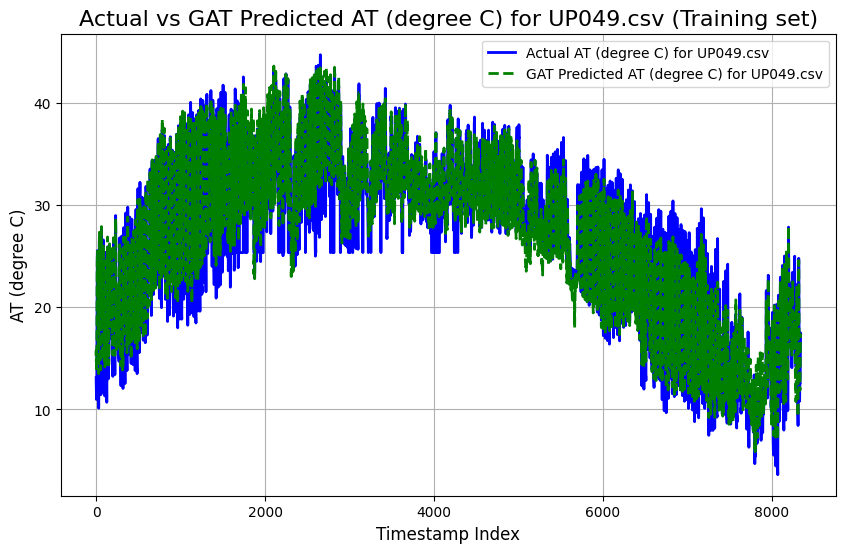

UP050.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.4691
Mean Squared Error (MSE): 10.8682
Root Mean Squared Error (RMSE): 3.2967
Pearson Correlation Coefficient: 0.8686
R-squared (R²): 0.7412

----------------------------------------



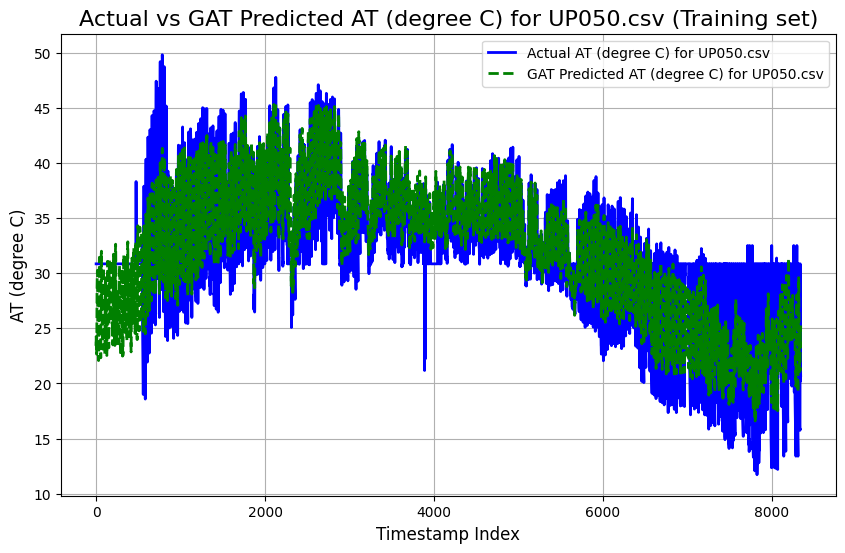

UP051.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.6983
Mean Squared Error (MSE): 26.5429
Root Mean Squared Error (RMSE): 5.1520
Pearson Correlation Coefficient: 0.7697
R-squared (R²): 0.5404

----------------------------------------



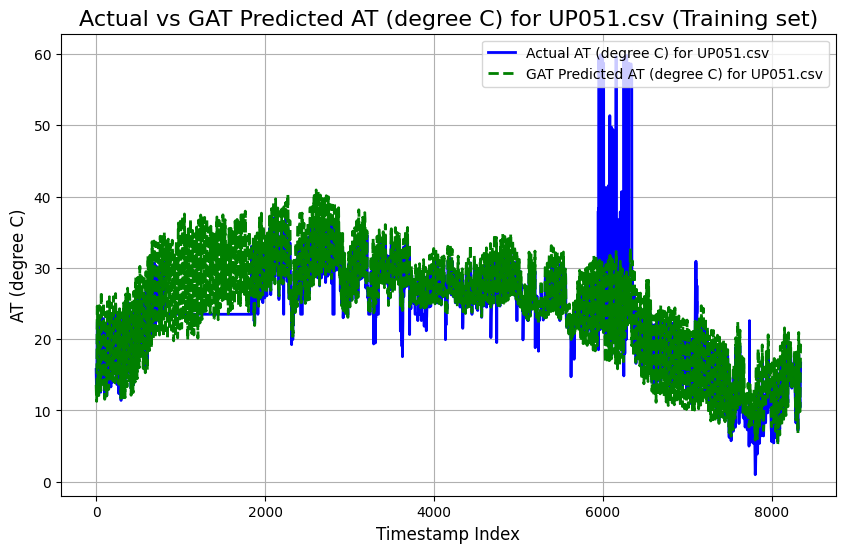

UP052.csv (Training set) Metrics:
Mean Absolute Error (MAE): 2.0597
Mean Squared Error (MSE): 8.8376
Root Mean Squared Error (RMSE): 2.9728
Pearson Correlation Coefficient: 0.9341
R-squared (R²): 0.8640

----------------------------------------



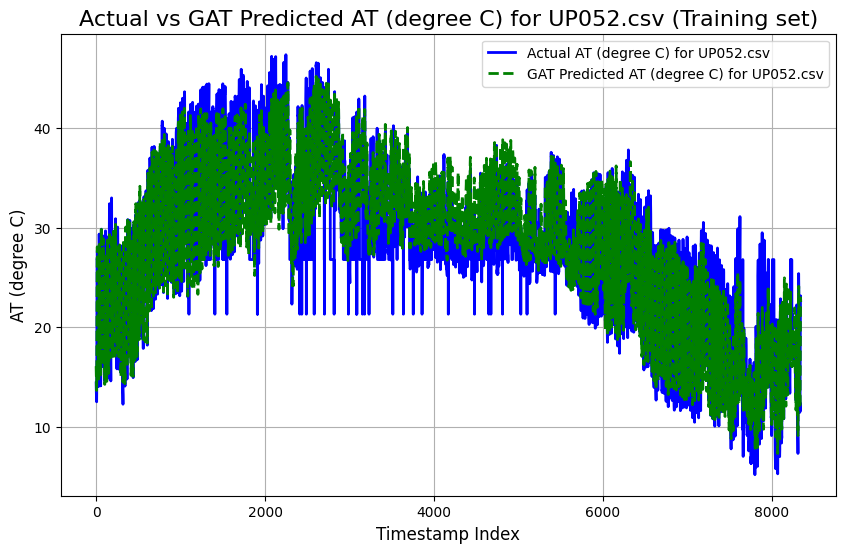

UP002.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1917
Mean Squared Error (MSE): 2.5161
Root Mean Squared Error (RMSE): 1.5862
Pearson Correlation Coefficient: 0.9642
R-squared (R²): 0.9098

----------------------------------------



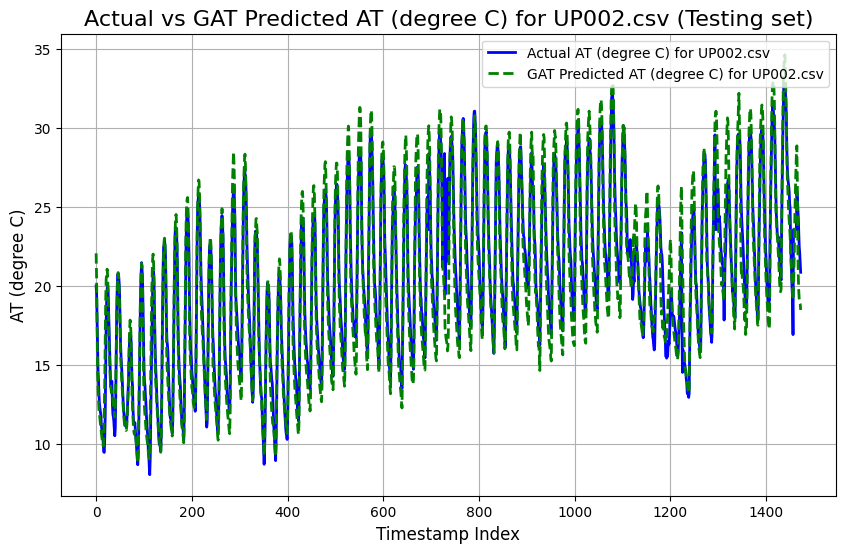

UP003.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3897
Mean Squared Error (MSE): 3.2164
Root Mean Squared Error (RMSE): 1.7934
Pearson Correlation Coefficient: 0.9675
R-squared (R²): 0.9139

----------------------------------------



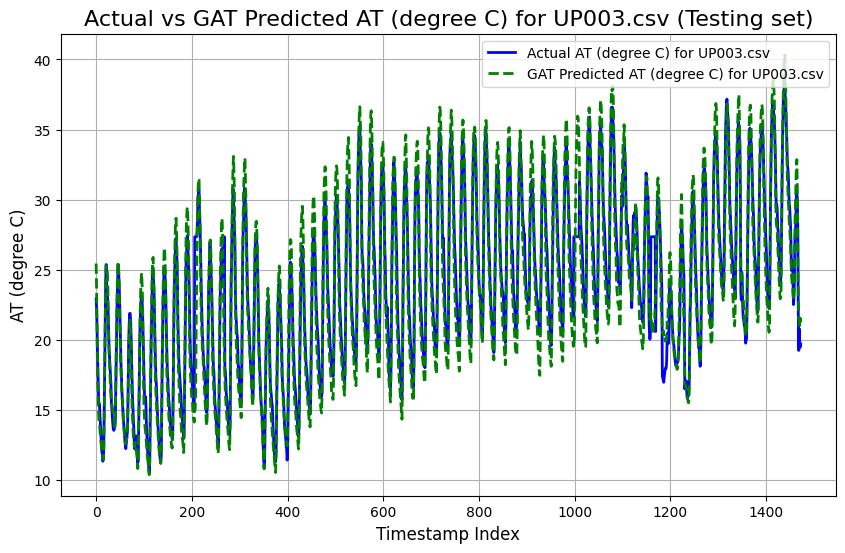

UP004.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4039
Mean Squared Error (MSE): 3.1713
Root Mean Squared Error (RMSE): 1.7808
Pearson Correlation Coefficient: 0.9650
R-squared (R²): 0.9076

----------------------------------------



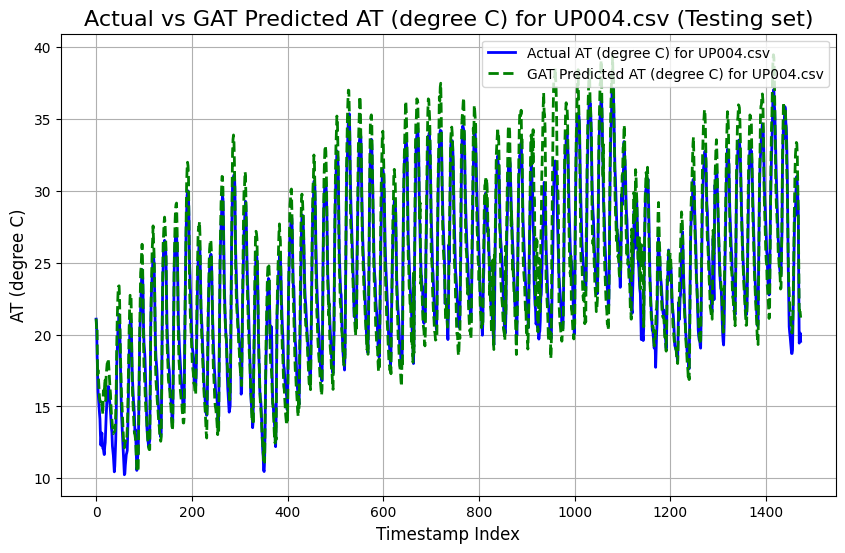

UP008.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.6043
Mean Squared Error (MSE): 47.6832
Root Mean Squared Error (RMSE): 6.9053
Pearson Correlation Coefficient: 0.6266
R-squared (R²): -0.8618

----------------------------------------



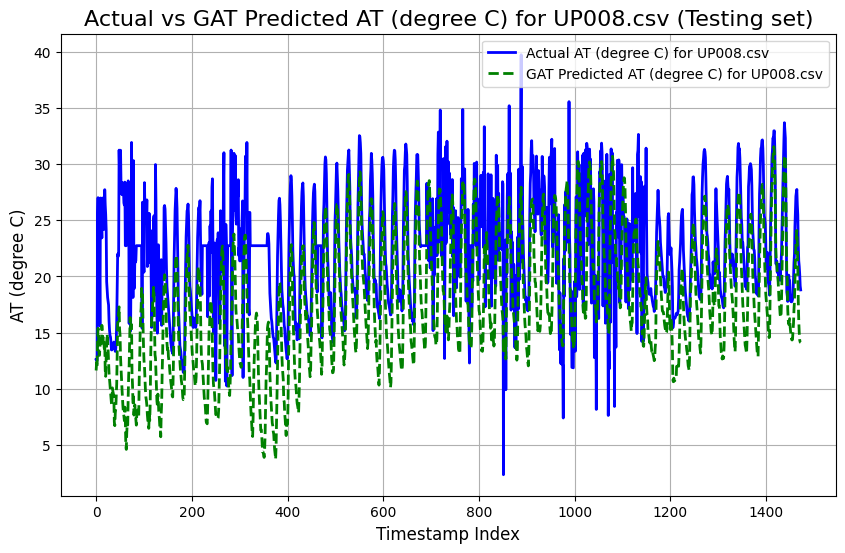

UP009.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1586
Mean Squared Error (MSE): 3.3702
Root Mean Squared Error (RMSE): 1.8358
Pearson Correlation Coefficient: 0.9203
R-squared (R²): 0.8353

----------------------------------------



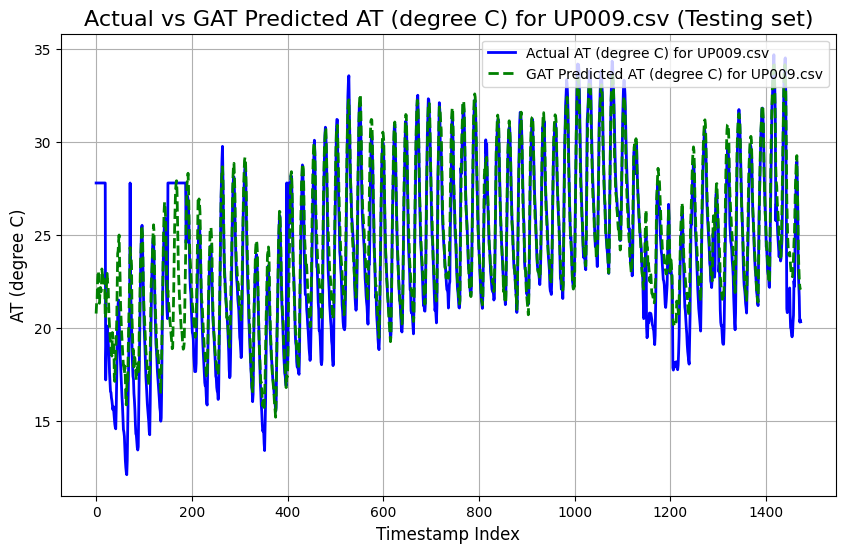

UP012.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5975
Mean Squared Error (MSE): 5.1415
Root Mean Squared Error (RMSE): 2.2675
Pearson Correlation Coefficient: 0.9415
R-squared (R²): 0.8851

----------------------------------------



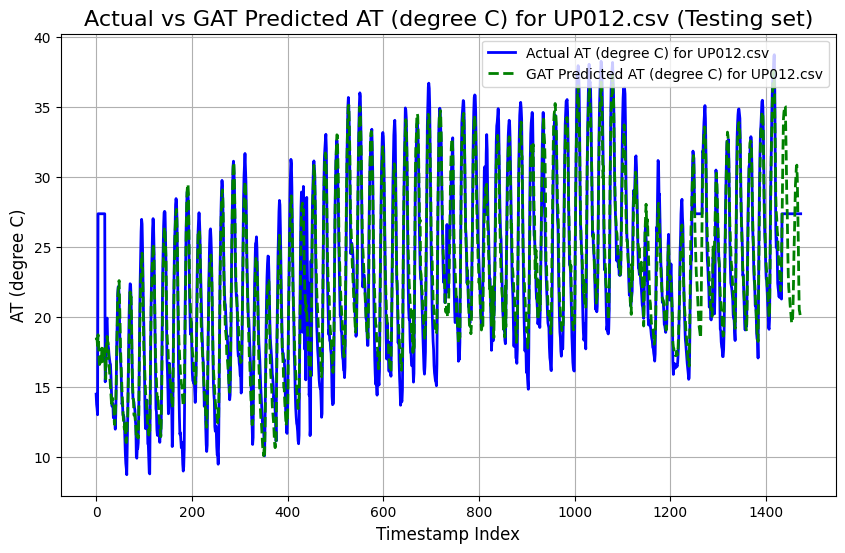

UP014.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 5.5255
Mean Squared Error (MSE): 34.4116
Root Mean Squared Error (RMSE): 5.8661
Pearson Correlation Coefficient: 0.9580
R-squared (R²): 0.4353

----------------------------------------



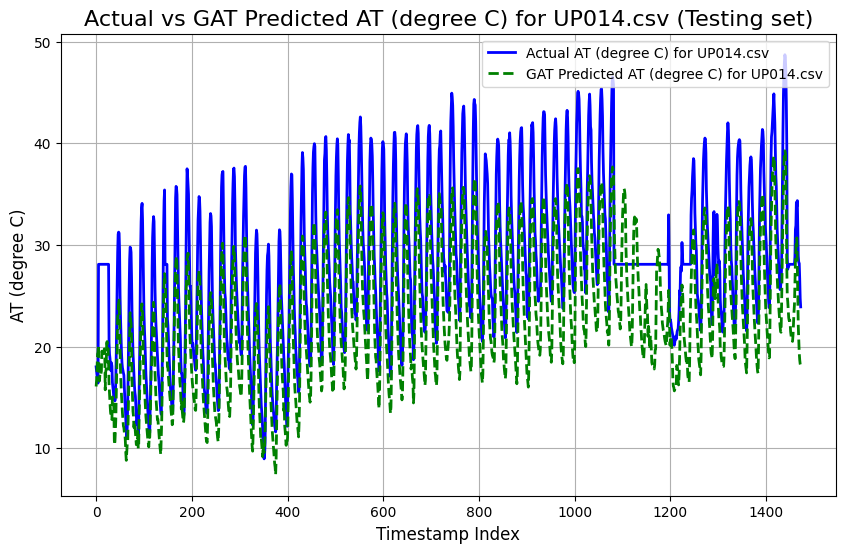

UP016.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.4441
Mean Squared Error (MSE): 23.1971
Root Mean Squared Error (RMSE): 4.8163
Pearson Correlation Coefficient: 0.9644
R-squared (R²): 0.6125

----------------------------------------



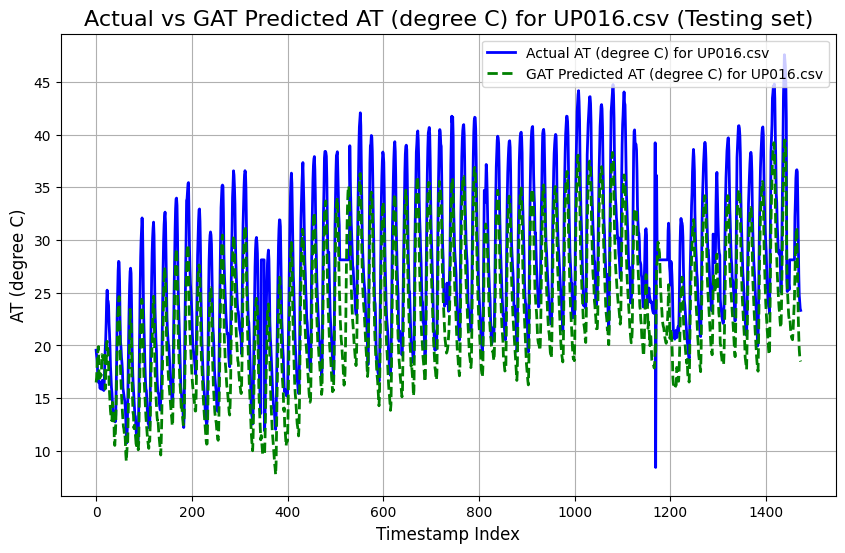

UP017.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8627
Mean Squared Error (MSE): 1.4051
Root Mean Squared Error (RMSE): 1.1854
Pearson Correlation Coefficient: 0.9569
R-squared (R²): 0.8936

----------------------------------------



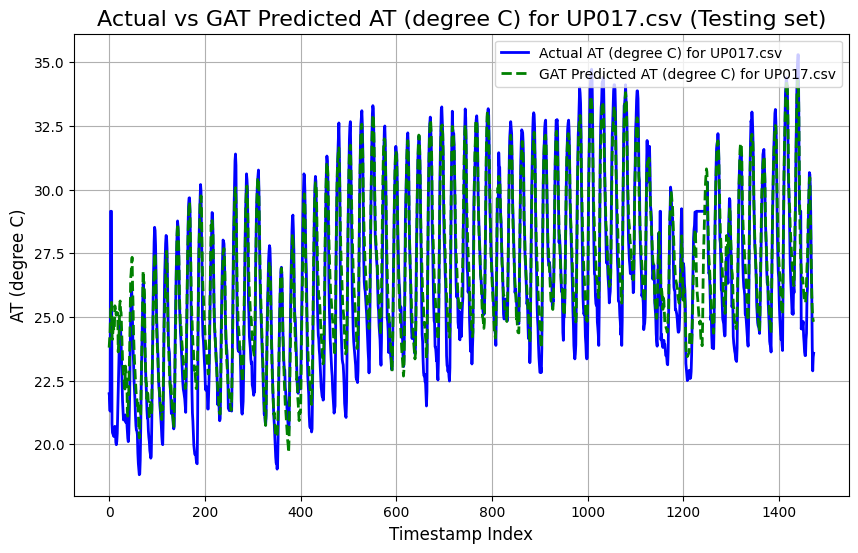

UP018.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 7.9668
Mean Squared Error (MSE): 98.8665
Root Mean Squared Error (RMSE): 9.9432
Pearson Correlation Coefficient: -0.6647
R-squared (R²): -2.5076

----------------------------------------



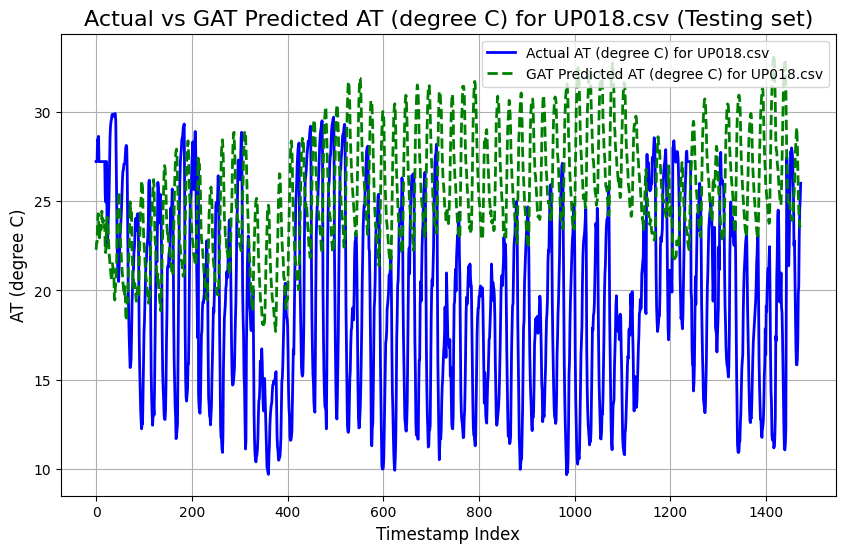

UP019.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8988
Mean Squared Error (MSE): 4.8015
Root Mean Squared Error (RMSE): 2.1912
Pearson Correlation Coefficient: 0.9436
R-squared (R²): 0.6621

----------------------------------------



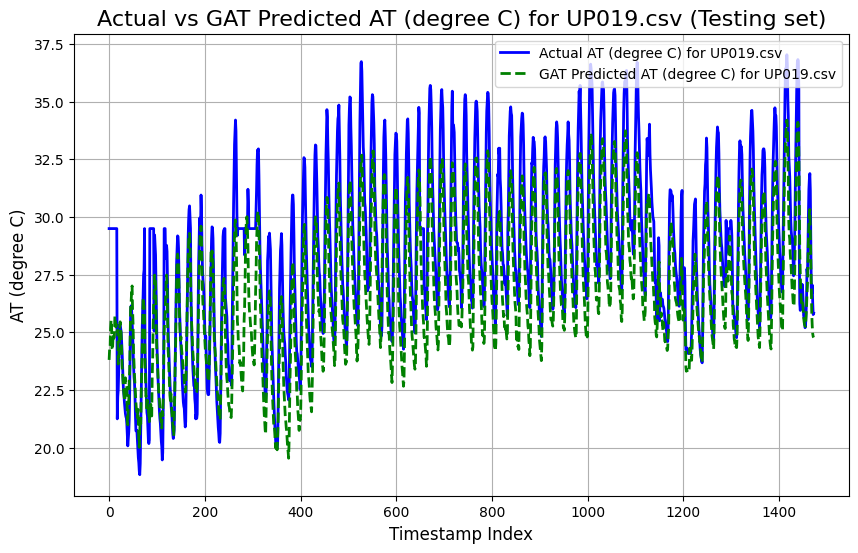

UP020.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1051
Mean Squared Error (MSE): 2.4690
Root Mean Squared Error (RMSE): 1.5713
Pearson Correlation Coefficient: 0.9549
R-squared (R²): 0.8777

----------------------------------------



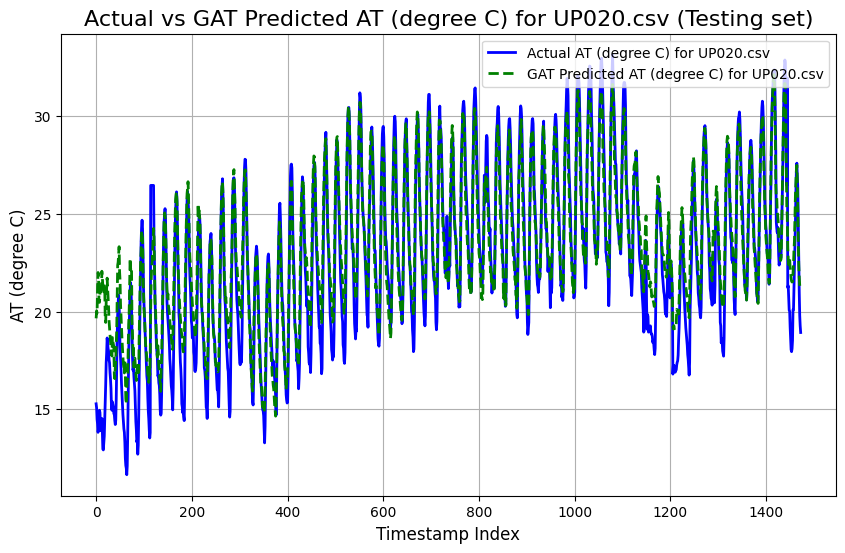

UP021.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.9900
Mean Squared Error (MSE): 13.0399
Root Mean Squared Error (RMSE): 3.6111
Pearson Correlation Coefficient: 0.8741
R-squared (R²): 0.2971

----------------------------------------



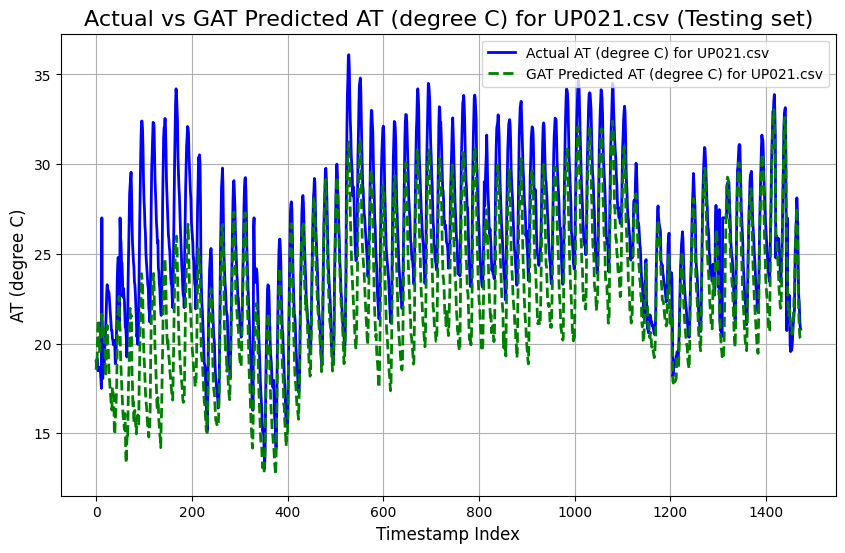

UP022.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0924
Mean Squared Error (MSE): 2.5374
Root Mean Squared Error (RMSE): 1.5929
Pearson Correlation Coefficient: 0.9515
R-squared (R²): 0.8698

----------------------------------------



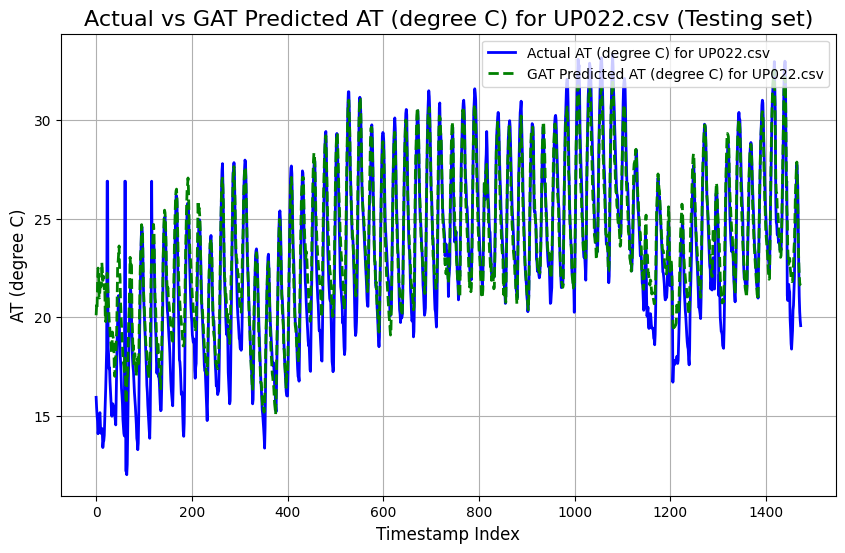

UP023.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5135
Mean Squared Error (MSE): 3.8185
Root Mean Squared Error (RMSE): 1.9541
Pearson Correlation Coefficient: 0.9249
R-squared (R²): 0.7843

----------------------------------------



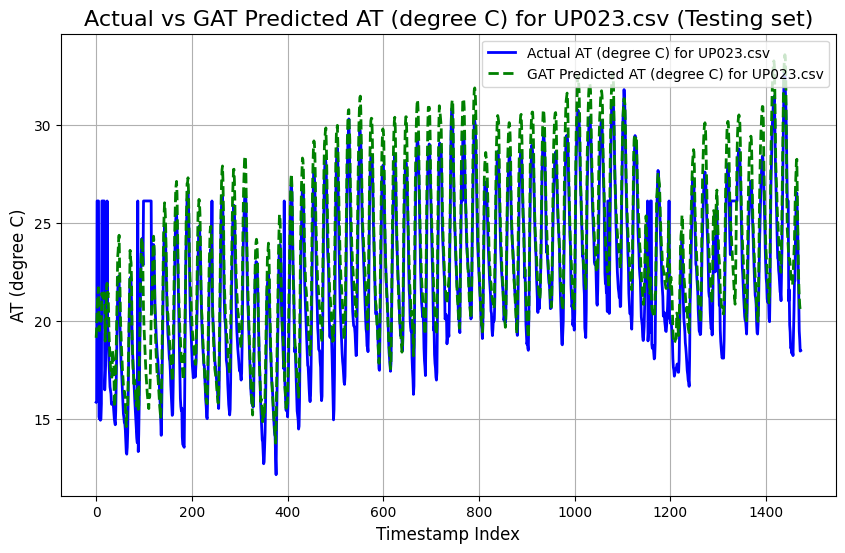

UP024.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.5022
Mean Squared Error (MSE): 16.3257
Root Mean Squared Error (RMSE): 4.0405
Pearson Correlation Coefficient: 0.9615
R-squared (R²): -0.8245

----------------------------------------



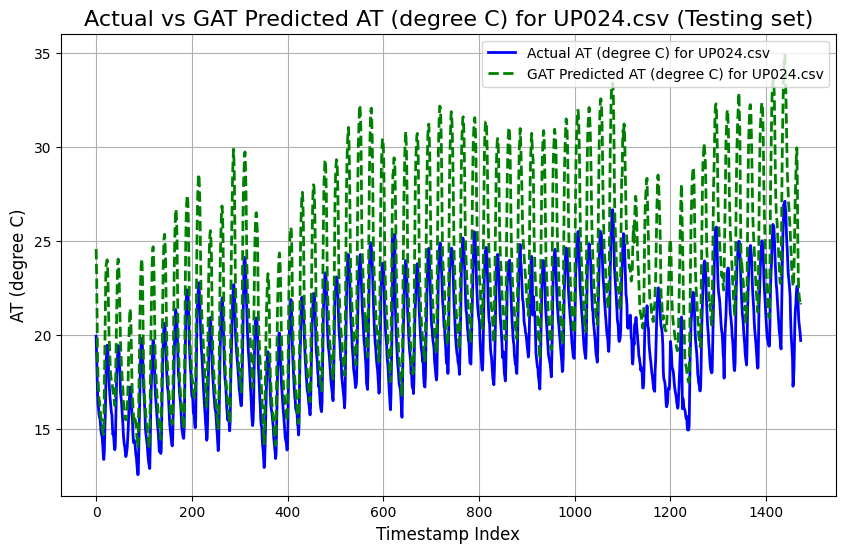

UP025.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1082
Mean Squared Error (MSE): 2.5769
Root Mean Squared Error (RMSE): 1.6053
Pearson Correlation Coefficient: 0.9570
R-squared (R²): 0.8894

----------------------------------------



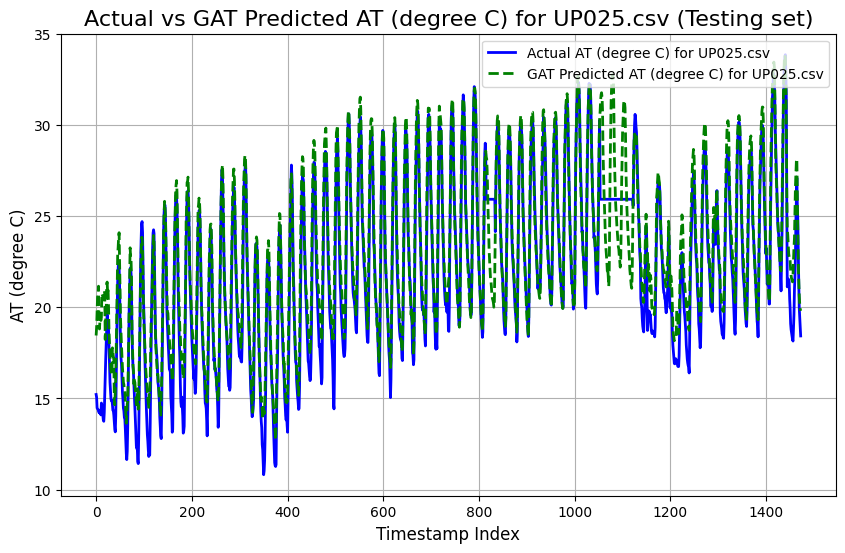

UP026.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.7941
Mean Squared Error (MSE): 5.5361
Root Mean Squared Error (RMSE): 2.3529
Pearson Correlation Coefficient: 0.9072
R-squared (R²): 0.7797

----------------------------------------



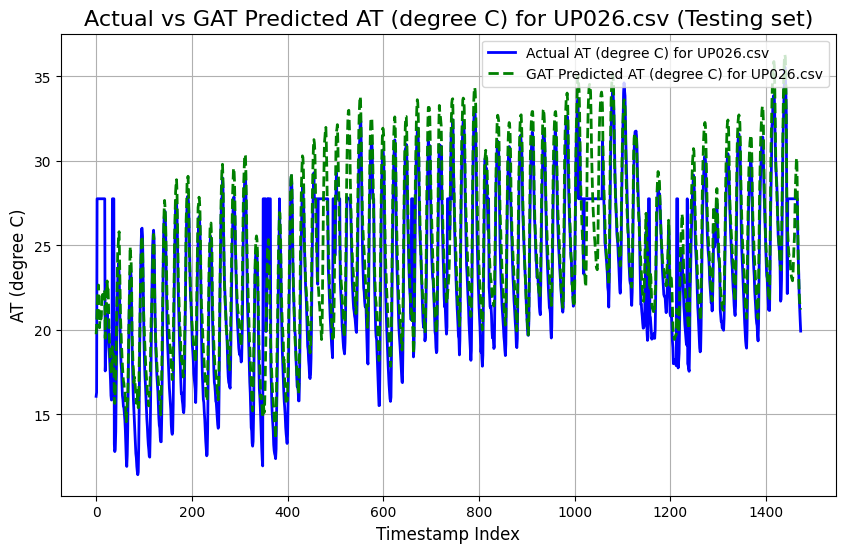

UP028.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3410
Mean Squared Error (MSE): 3.7090
Root Mean Squared Error (RMSE): 1.9259
Pearson Correlation Coefficient: 0.9705
R-squared (R²): 0.9363

----------------------------------------



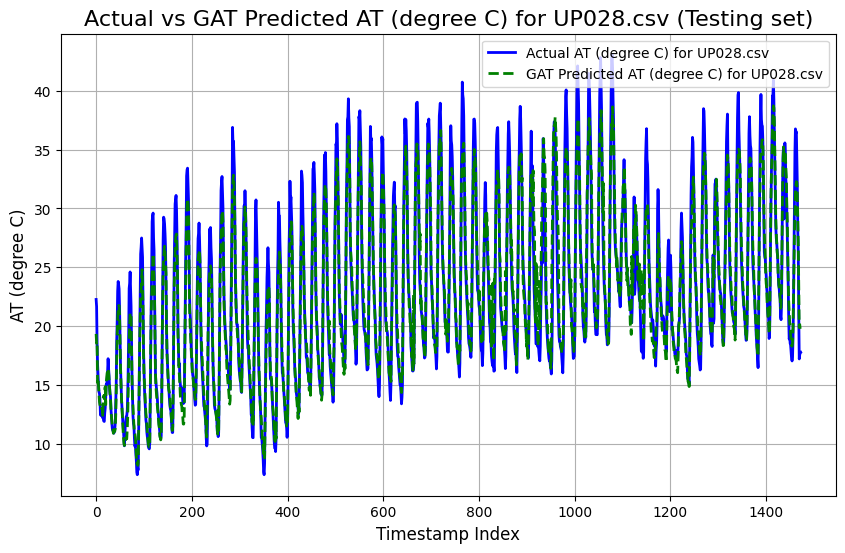

UP029.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7250
Mean Squared Error (MSE): 1.0646
Root Mean Squared Error (RMSE): 1.0318
Pearson Correlation Coefficient: 0.9869
R-squared (R²): 0.9712

----------------------------------------



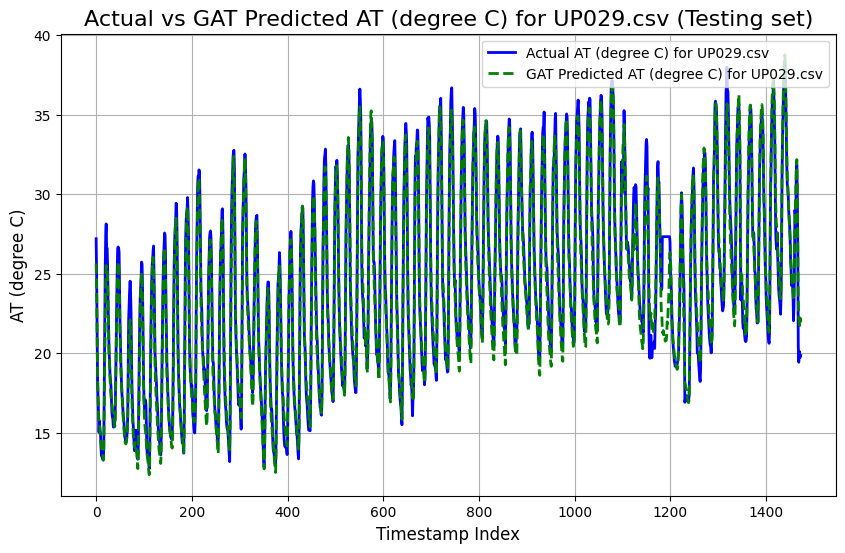

UP030.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.0692
Mean Squared Error (MSE): 2.2737
Root Mean Squared Error (RMSE): 1.5079
Pearson Correlation Coefficient: 0.9746
R-squared (R²): 0.9483

----------------------------------------



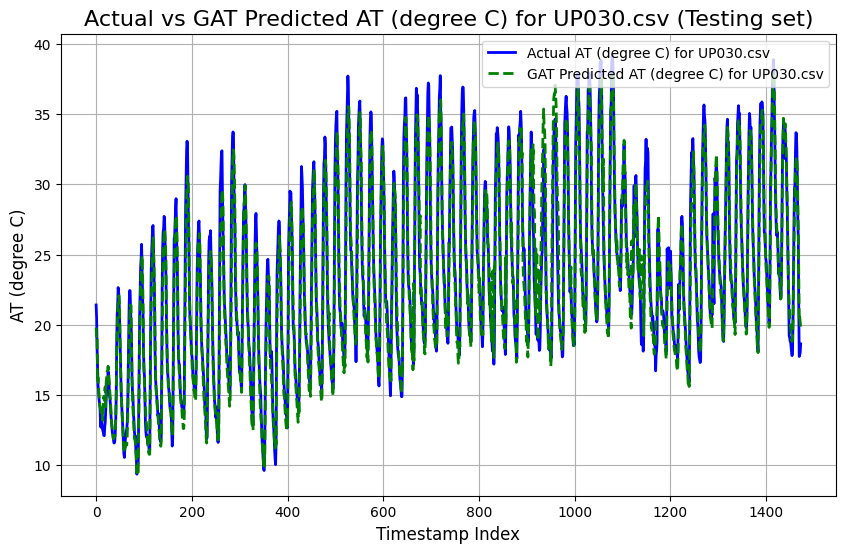

UP031.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5145
Mean Squared Error (MSE): 3.7142
Root Mean Squared Error (RMSE): 1.9272
Pearson Correlation Coefficient: 0.9633
R-squared (R²): 0.9238

----------------------------------------



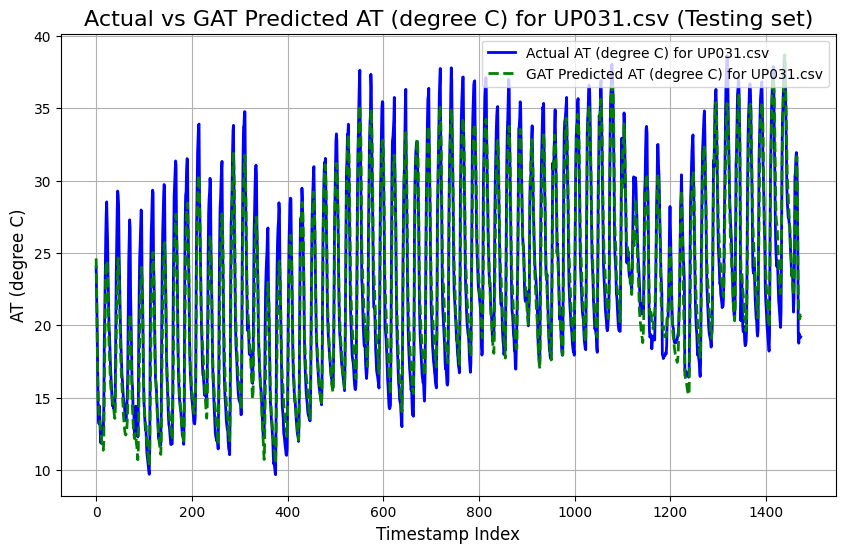

UP032.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1254
Mean Squared Error (MSE): 2.0479
Root Mean Squared Error (RMSE): 1.4311
Pearson Correlation Coefficient: 0.9698
R-squared (R²): 0.9403

----------------------------------------



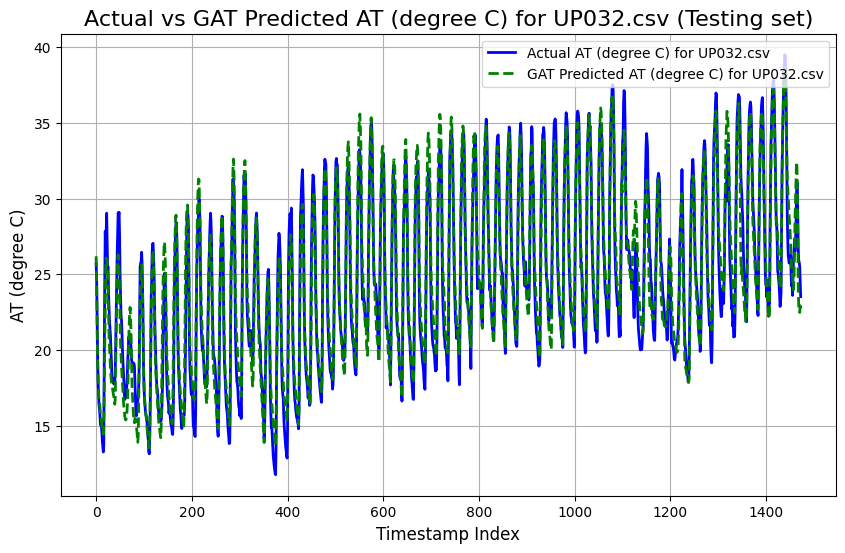

UP033.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.7161
Mean Squared Error (MSE): 0.9179
Root Mean Squared Error (RMSE): 0.9581
Pearson Correlation Coefficient: 0.9886
R-squared (R²): 0.9748

----------------------------------------



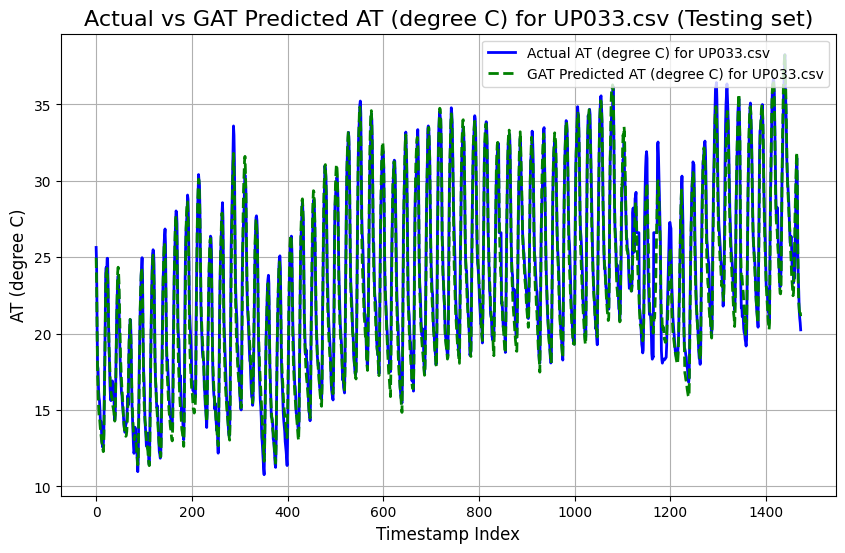

UP034.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 4.1736
Mean Squared Error (MSE): 26.9674
Root Mean Squared Error (RMSE): 5.1930
Pearson Correlation Coefficient: 0.8788
R-squared (R²): -0.1881

----------------------------------------



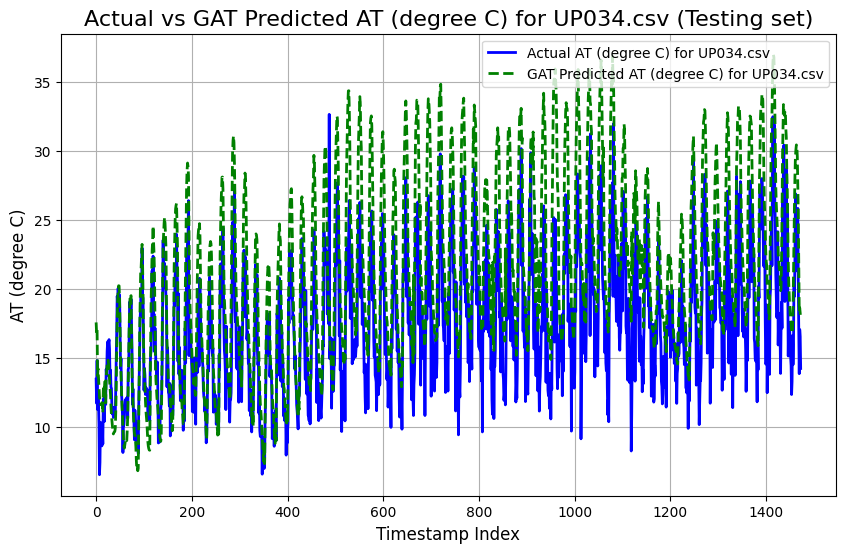

UP035.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.3379
Mean Squared Error (MSE): 4.9404
Root Mean Squared Error (RMSE): 2.2227
Pearson Correlation Coefficient: 0.9398
R-squared (R²): 0.8675

----------------------------------------



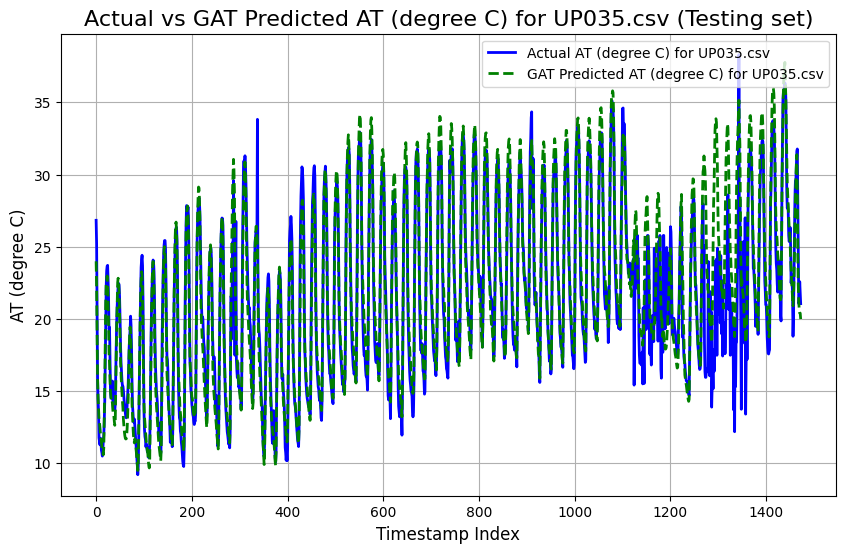

UP036.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1479
Mean Squared Error (MSE): 2.9809
Root Mean Squared Error (RMSE): 1.7265
Pearson Correlation Coefficient: 0.9609
R-squared (R²): 0.9107

----------------------------------------



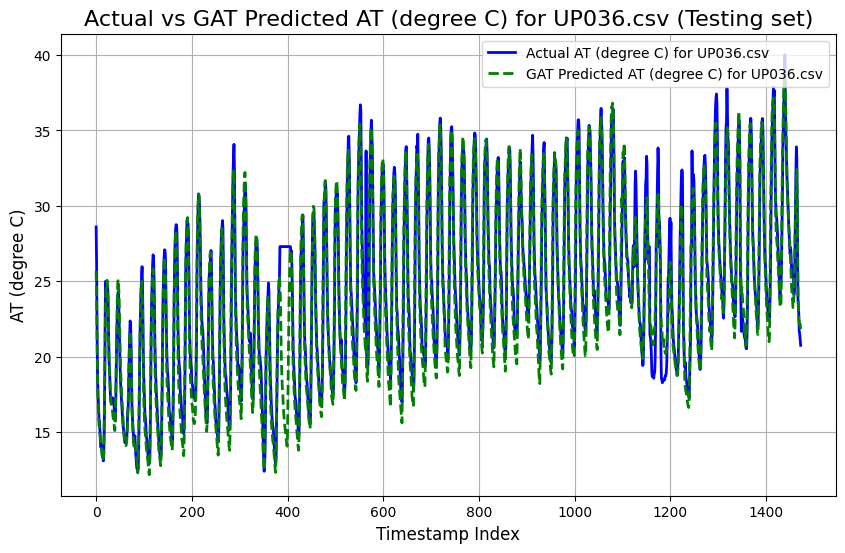

UP037.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1895
Mean Squared Error (MSE): 2.9301
Root Mean Squared Error (RMSE): 1.7117
Pearson Correlation Coefficient: 0.9626
R-squared (R²): 0.9259

----------------------------------------



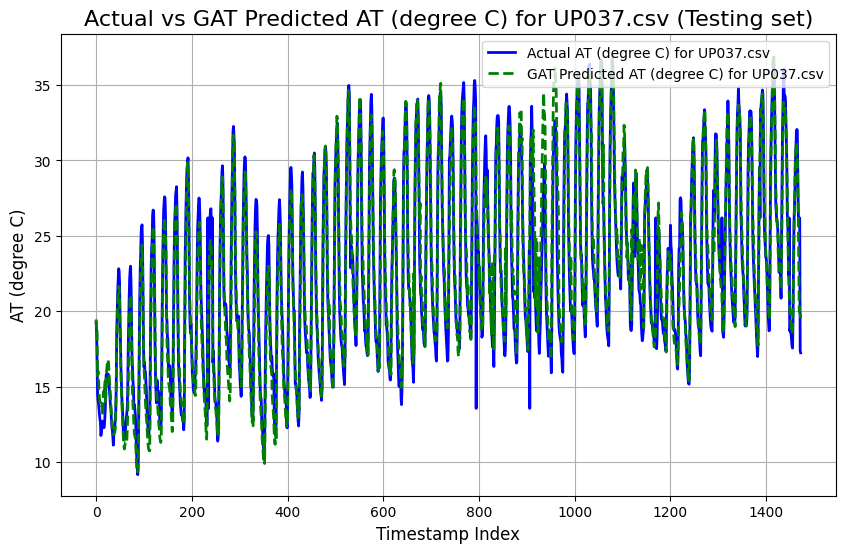

UP038.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.8076
Mean Squared Error (MSE): 1.1151
Root Mean Squared Error (RMSE): 1.0560
Pearson Correlation Coefficient: 0.9859
R-squared (R²): 0.9660

----------------------------------------



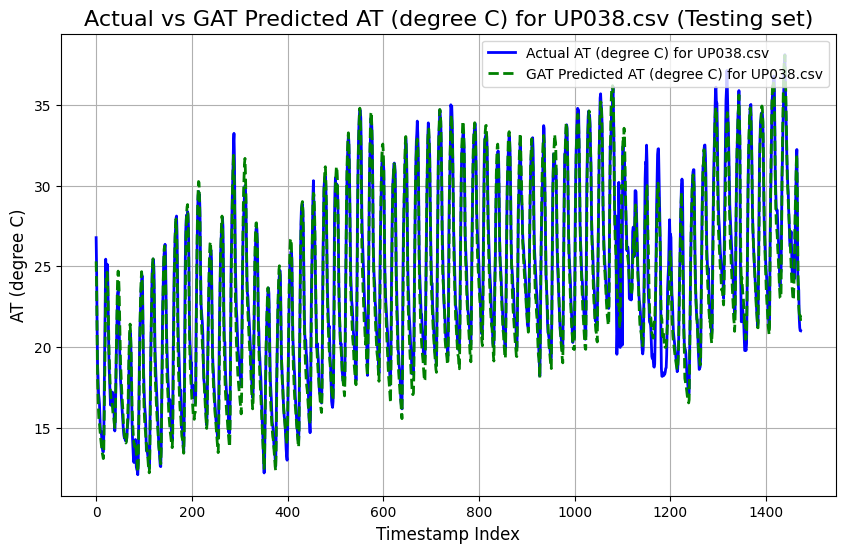

UP039.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4956
Mean Squared Error (MSE): 3.6579
Root Mean Squared Error (RMSE): 1.9126
Pearson Correlation Coefficient: 0.9675
R-squared (R²): 0.9293

----------------------------------------



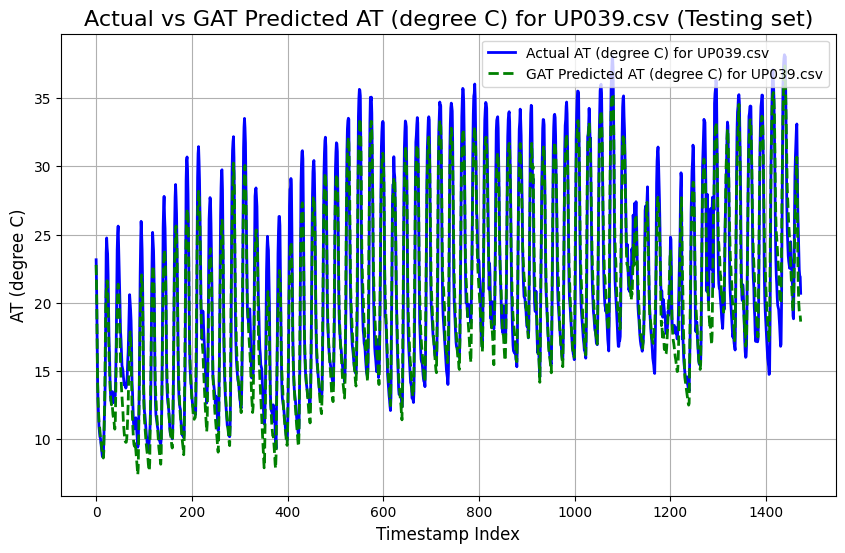

UP040.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.1634
Mean Squared Error (MSE): 2.1126
Root Mean Squared Error (RMSE): 1.4535
Pearson Correlation Coefficient: 0.9764
R-squared (R²): 0.9502

----------------------------------------



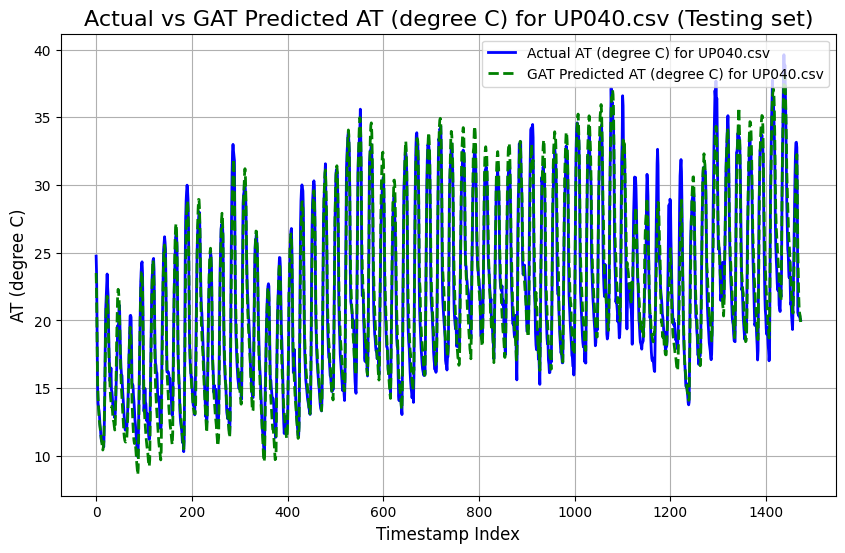

UP041.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.2441
Mean Squared Error (MSE): 3.0523
Root Mean Squared Error (RMSE): 1.7471
Pearson Correlation Coefficient: 0.9615
R-squared (R²): 0.9073

----------------------------------------



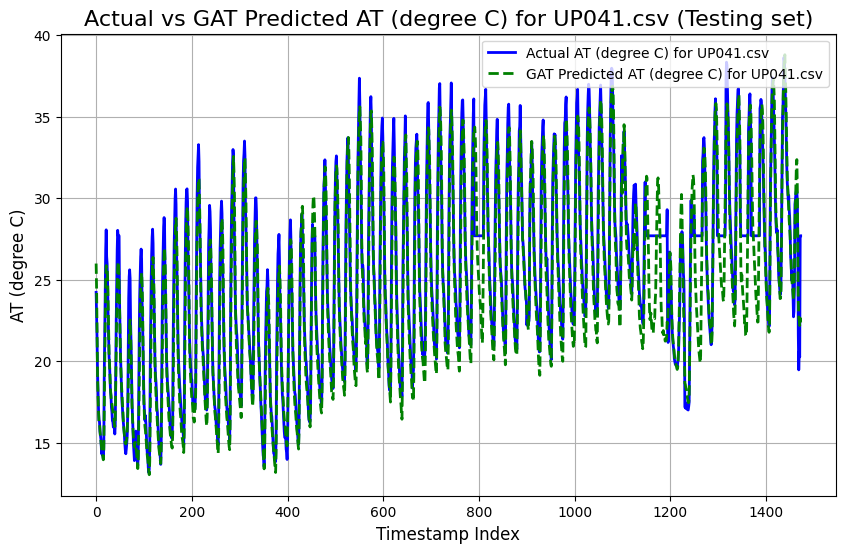

UP042.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4706
Mean Squared Error (MSE): 5.5263
Root Mean Squared Error (RMSE): 2.3508
Pearson Correlation Coefficient: 0.9219
R-squared (R²): 0.8273

----------------------------------------



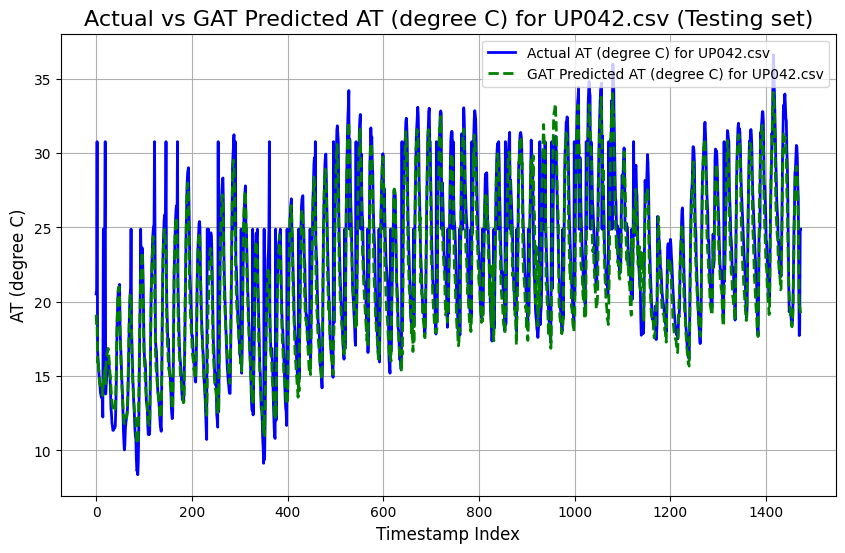

UP043.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.8786
Mean Squared Error (MSE): 5.0801
Root Mean Squared Error (RMSE): 2.2539
Pearson Correlation Coefficient: 0.9759
R-squared (R²): 0.8611

----------------------------------------



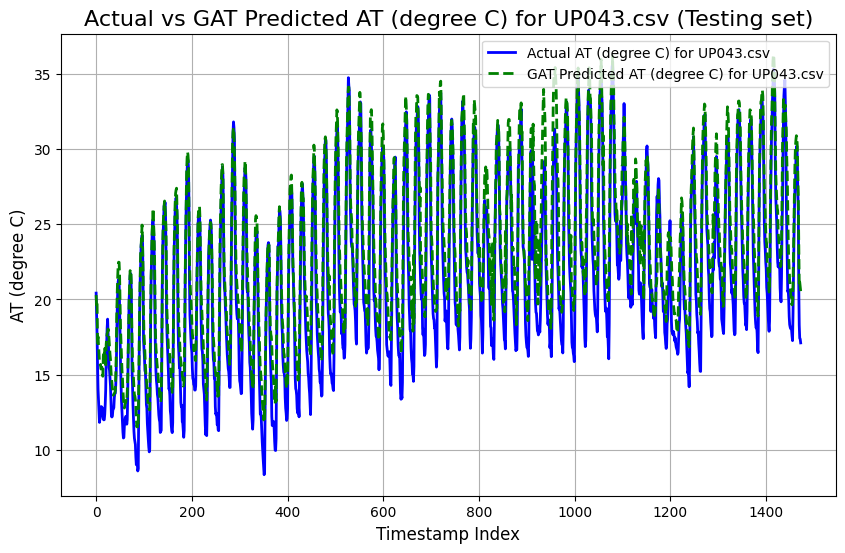

UP044.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 0.9405
Mean Squared Error (MSE): 1.7991
Root Mean Squared Error (RMSE): 1.3413
Pearson Correlation Coefficient: 0.9826
R-squared (R²): 0.9590

----------------------------------------



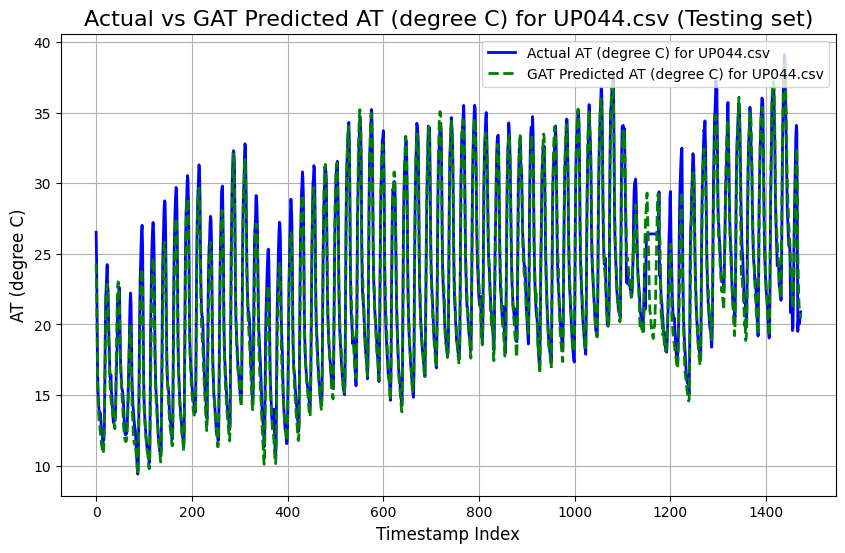

UP046.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4008
Mean Squared Error (MSE): 3.4123
Root Mean Squared Error (RMSE): 1.8472
Pearson Correlation Coefficient: 0.9632
R-squared (R²): 0.9043

----------------------------------------



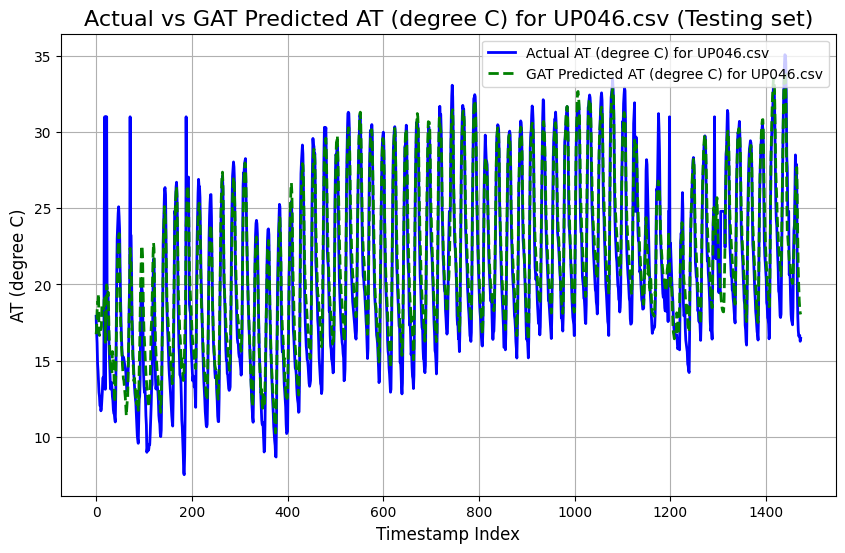

UP048.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.5683
Mean Squared Error (MSE): 4.1672
Root Mean Squared Error (RMSE): 2.0414
Pearson Correlation Coefficient: 0.9569
R-squared (R²): 0.8874

----------------------------------------



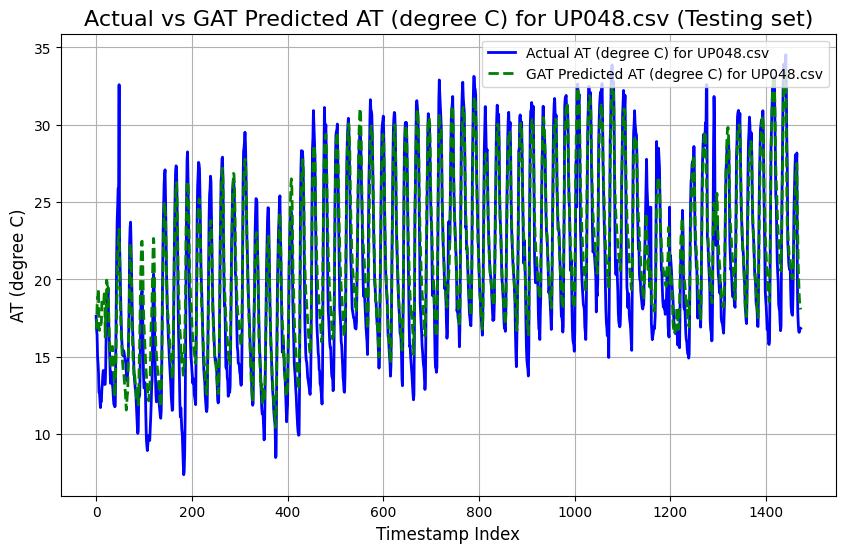

UP049.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4916
Mean Squared Error (MSE): 4.1273
Root Mean Squared Error (RMSE): 2.0316
Pearson Correlation Coefficient: 0.9412
R-squared (R²): 0.8670

----------------------------------------



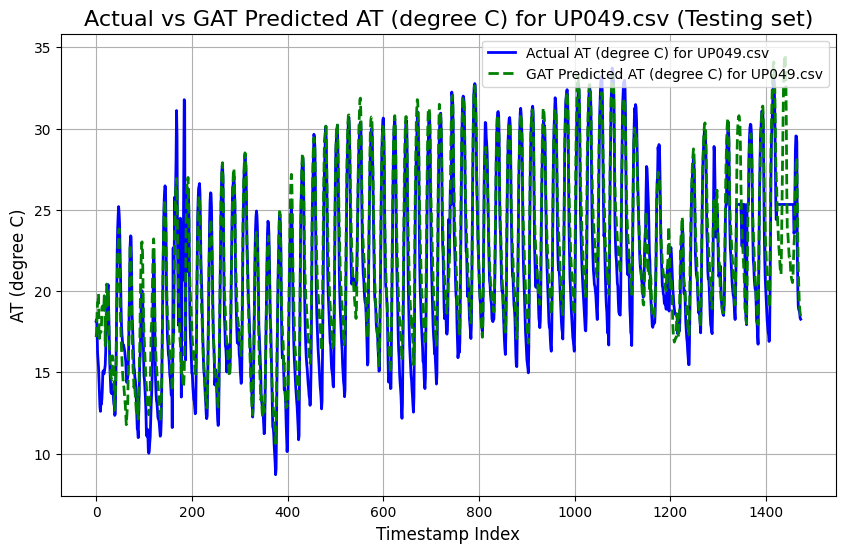

UP050.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 2.6995
Mean Squared Error (MSE): 10.5885
Root Mean Squared Error (RMSE): 3.2540
Pearson Correlation Coefficient: 0.7445
R-squared (R²): 0.5155

----------------------------------------



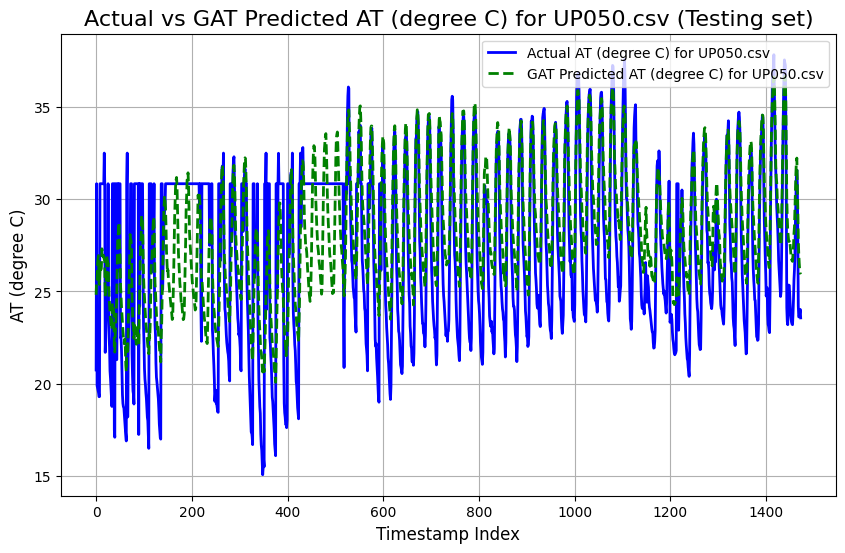

UP051.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 3.3042
Mean Squared Error (MSE): 44.9364
Root Mean Squared Error (RMSE): 6.7035
Pearson Correlation Coefficient: 0.6081
R-squared (R²): 0.3270

----------------------------------------



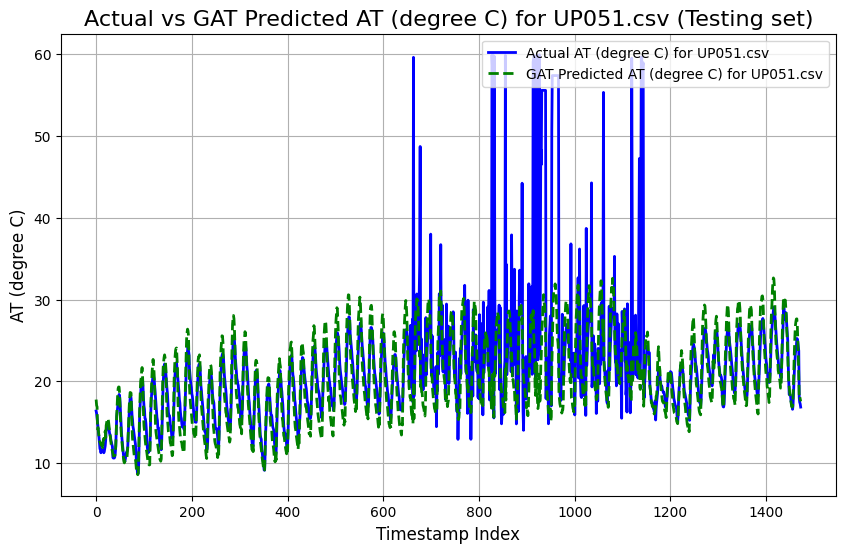

UP052.csv (Testing set) Metrics:
Mean Absolute Error (MAE): 1.4956
Mean Squared Error (MSE): 3.6966
Root Mean Squared Error (RMSE): 1.9227
Pearson Correlation Coefficient: 0.9589
R-squared (R²): 0.8980

----------------------------------------



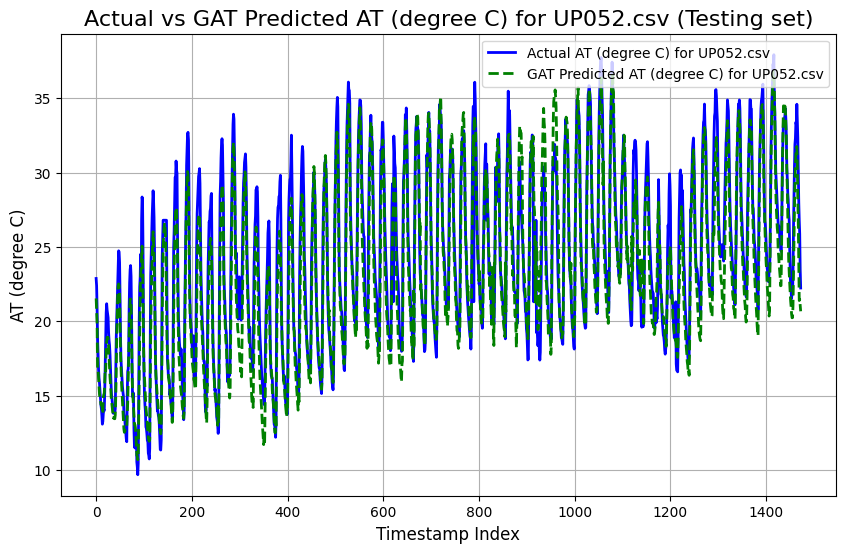

Train GNN Imputed KNN.csv
CSV file 'Train GNN Imputed KNN.csv' created successfully.
Test GNN Imputed KNN.csv
CSV file 'Test GNN Imputed KNN.csv' created successfully.
UP002.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2112
Mean Squared Error (MSE): 2.8092
Root Mean Squared Error (RMSE): 1.6761
Pearson Correlation Coefficient: 0.9775
R-squared (R²): 0.9493

----------------------------------------



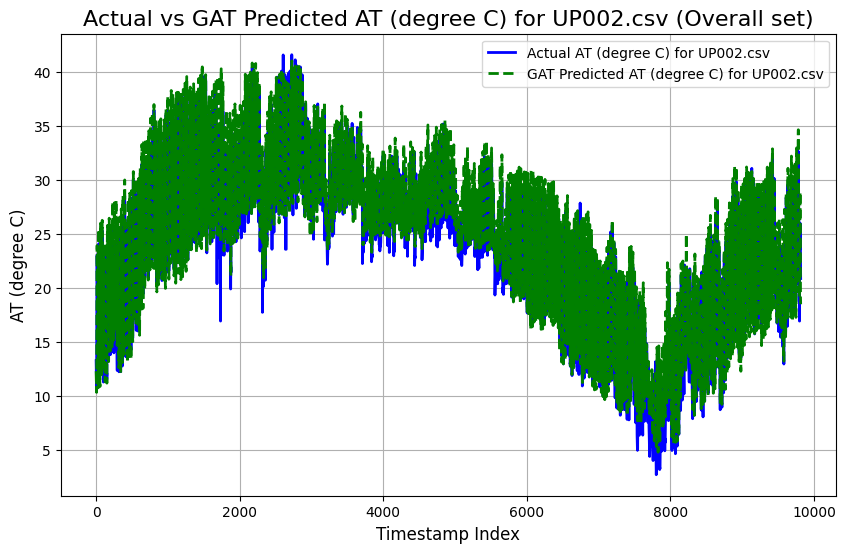

UP003.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3229
Mean Squared Error (MSE): 3.0408
Root Mean Squared Error (RMSE): 1.7438
Pearson Correlation Coefficient: 0.9817
R-squared (R²): 0.9578

----------------------------------------



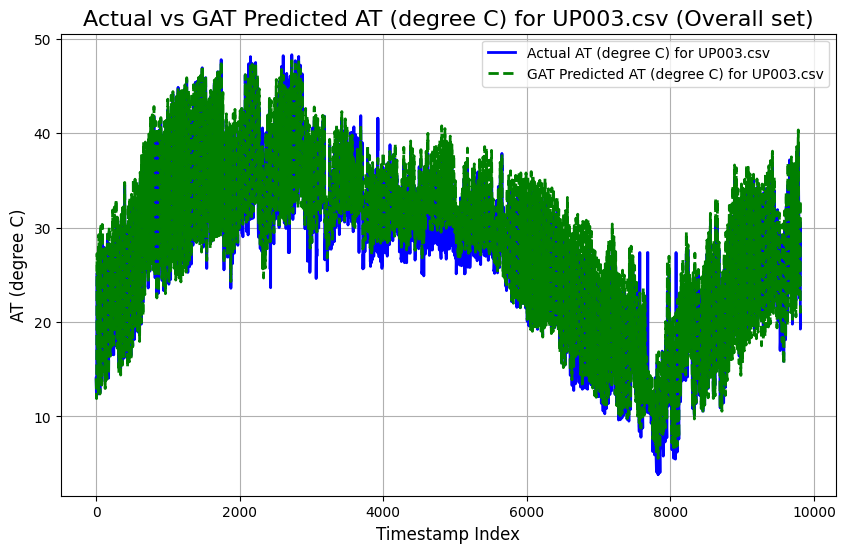

UP004.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5422
Mean Squared Error (MSE): 3.8566
Root Mean Squared Error (RMSE): 1.9638
Pearson Correlation Coefficient: 0.9777
R-squared (R²): 0.9509

----------------------------------------



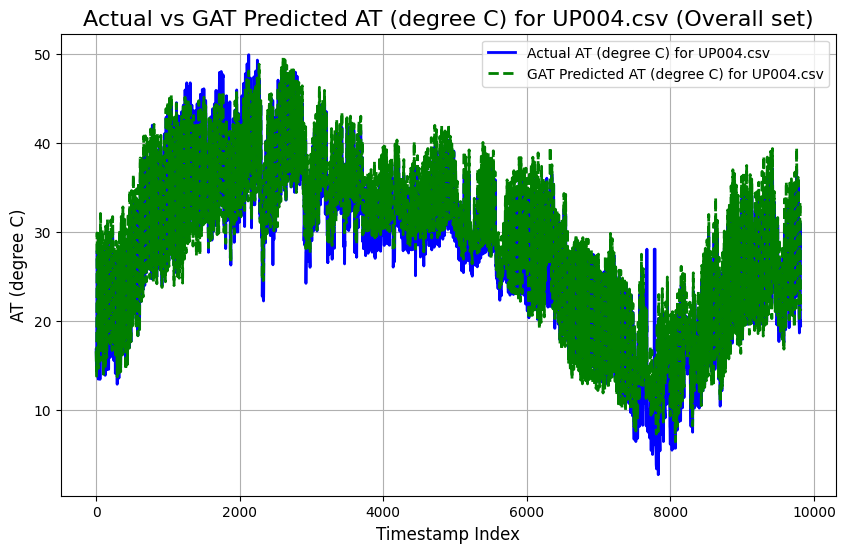

UP008.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 5.6216
Mean Squared Error (MSE): 63.2717
Root Mean Squared Error (RMSE): 7.9543
Pearson Correlation Coefficient: 0.7467
R-squared (R²): 0.5058

----------------------------------------



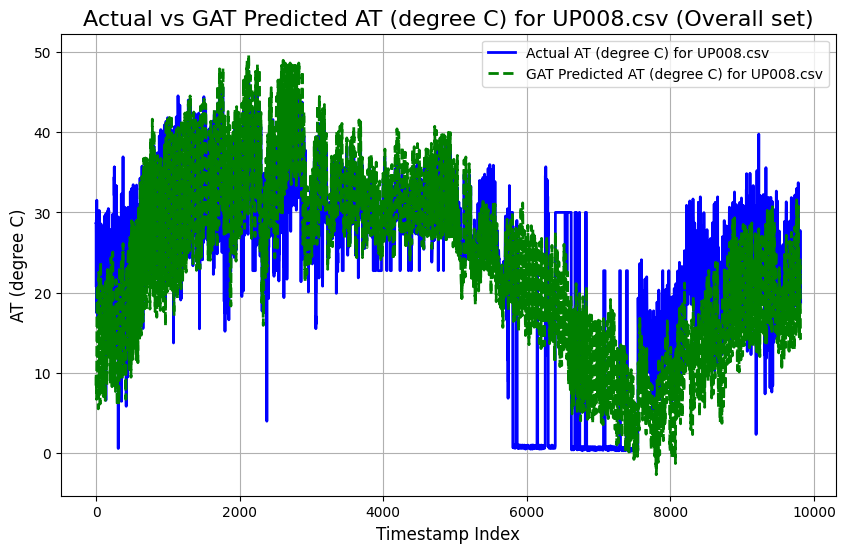

UP009.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2900
Mean Squared Error (MSE): 3.3987
Root Mean Squared Error (RMSE): 1.8435
Pearson Correlation Coefficient: 0.9719
R-squared (R²): 0.9392

----------------------------------------



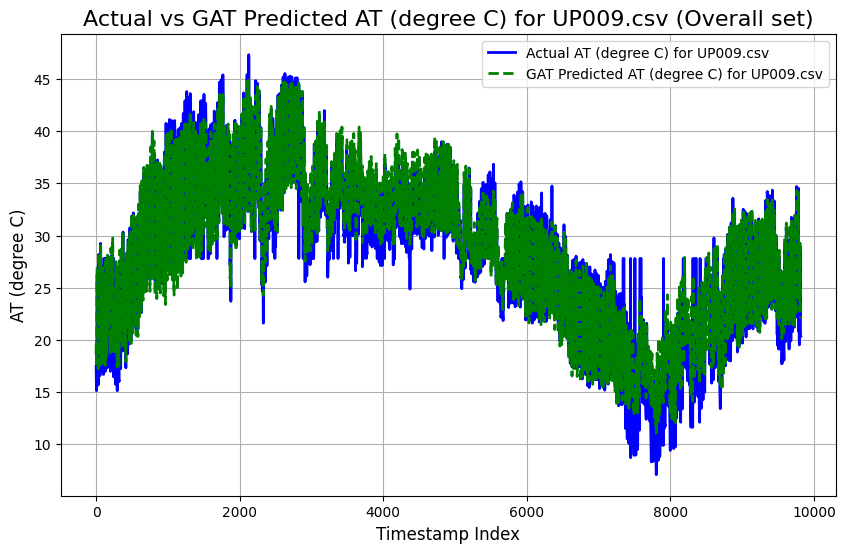

UP012.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.7468
Mean Squared Error (MSE): 7.7884
Root Mean Squared Error (RMSE): 2.7908
Pearson Correlation Coefficient: 0.9628
R-squared (R²): 0.9228

----------------------------------------



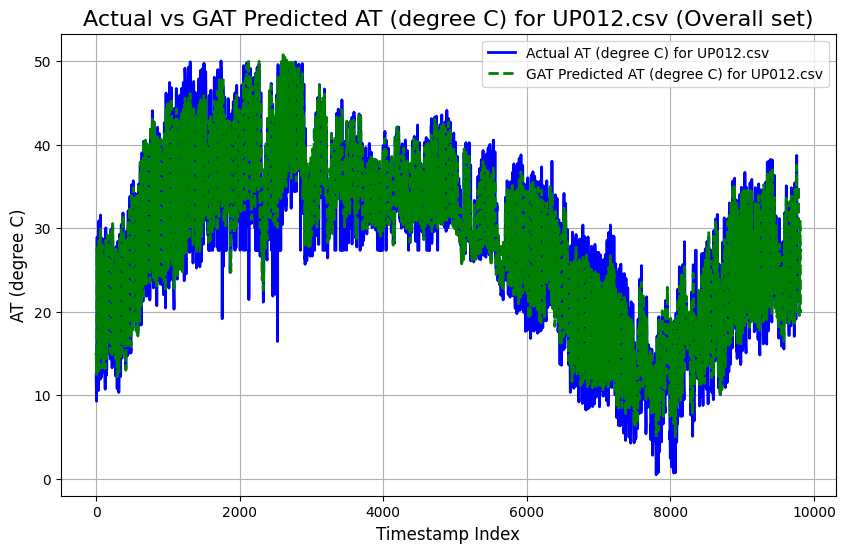

UP014.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5187
Mean Squared Error (MSE): 19.0591
Root Mean Squared Error (RMSE): 4.3657
Pearson Correlation Coefficient: 0.9216
R-squared (R²): 0.8437

----------------------------------------



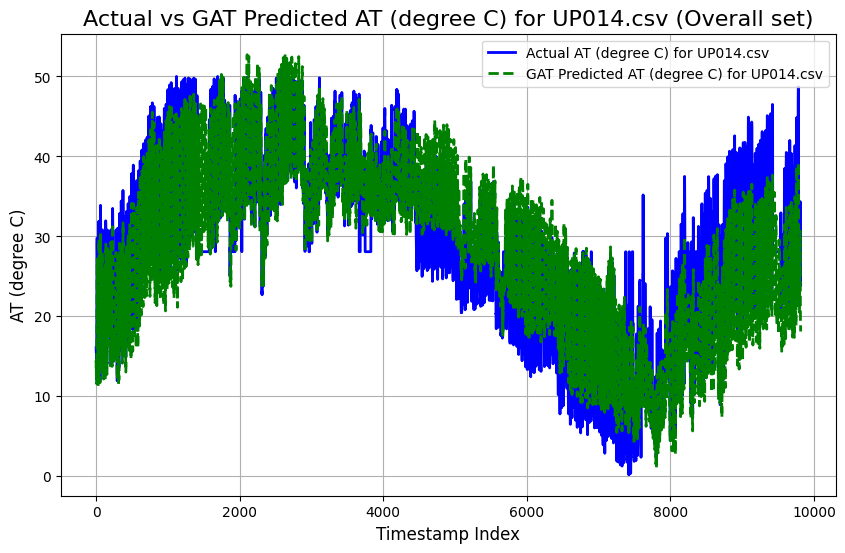

UP016.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.2118
Mean Squared Error (MSE): 17.1800
Root Mean Squared Error (RMSE): 4.1449
Pearson Correlation Coefficient: 0.9319
R-squared (R²): 0.8649

----------------------------------------



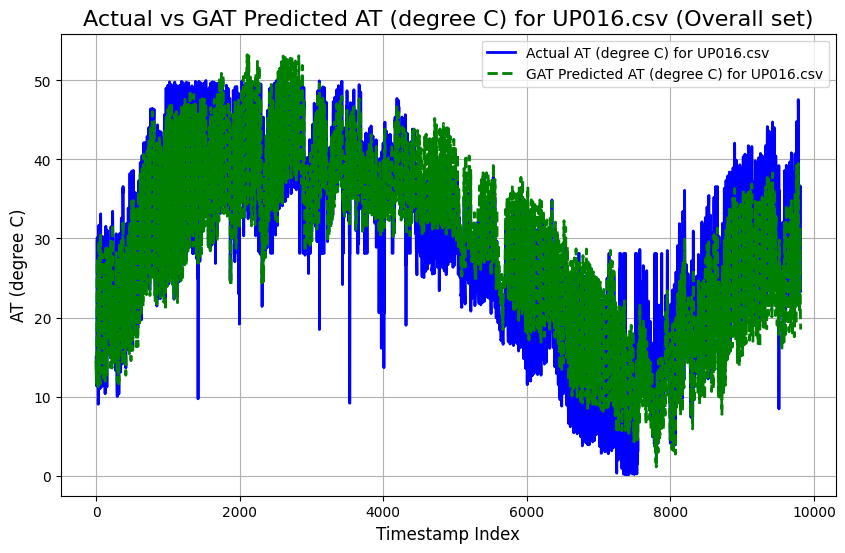

UP017.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9287
Mean Squared Error (MSE): 1.3248
Root Mean Squared Error (RMSE): 1.1510
Pearson Correlation Coefficient: 0.9813
R-squared (R²): 0.9572

----------------------------------------



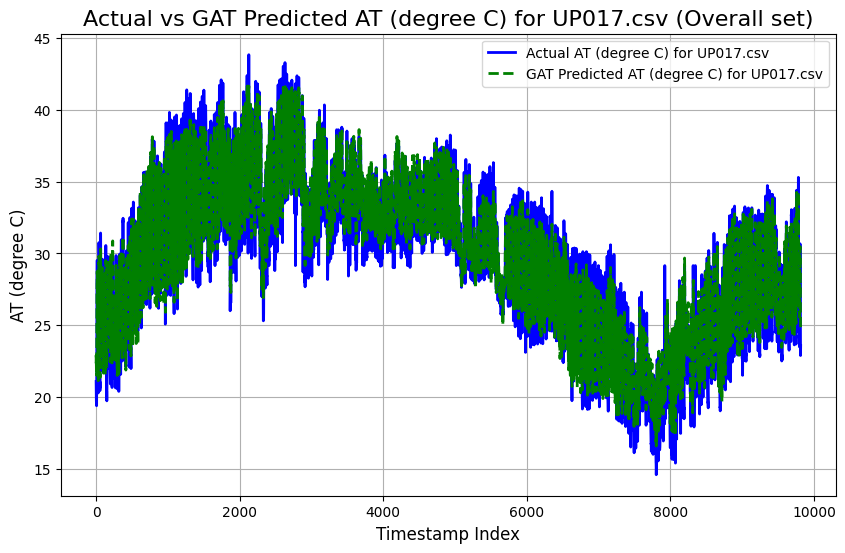

UP018.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 4.9258
Mean Squared Error (MSE): 49.3004
Root Mean Squared Error (RMSE): 7.0214
Pearson Correlation Coefficient: 0.4727
R-squared (R²): 0.0611

----------------------------------------



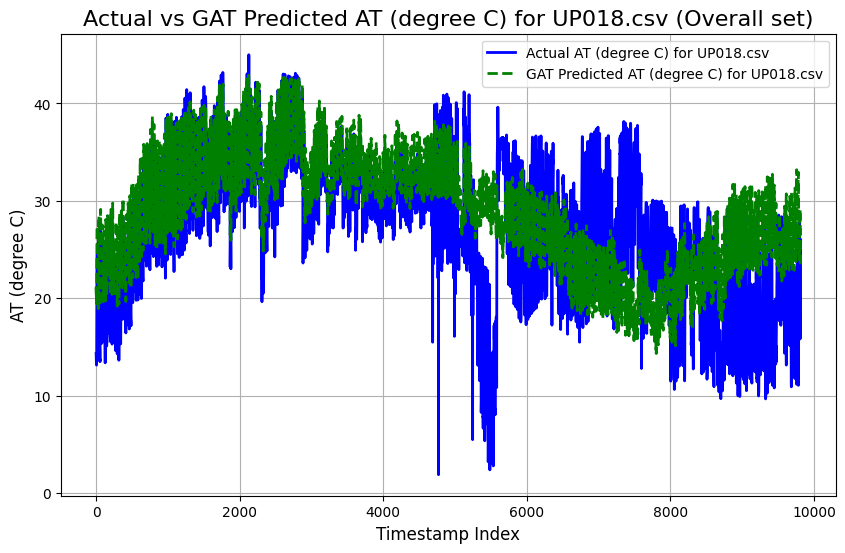

UP019.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8161
Mean Squared Error (MSE): 6.7643
Root Mean Squared Error (RMSE): 2.6008
Pearson Correlation Coefficient: 0.8918
R-squared (R²): 0.7892

----------------------------------------



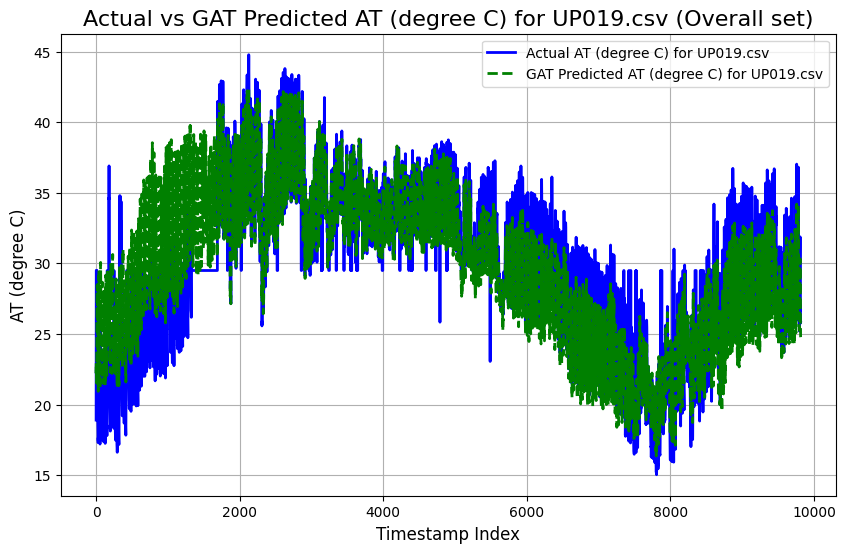

UP020.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2802
Mean Squared Error (MSE): 2.7235
Root Mean Squared Error (RMSE): 1.6503
Pearson Correlation Coefficient: 0.9774
R-squared (R²): 0.9491

----------------------------------------



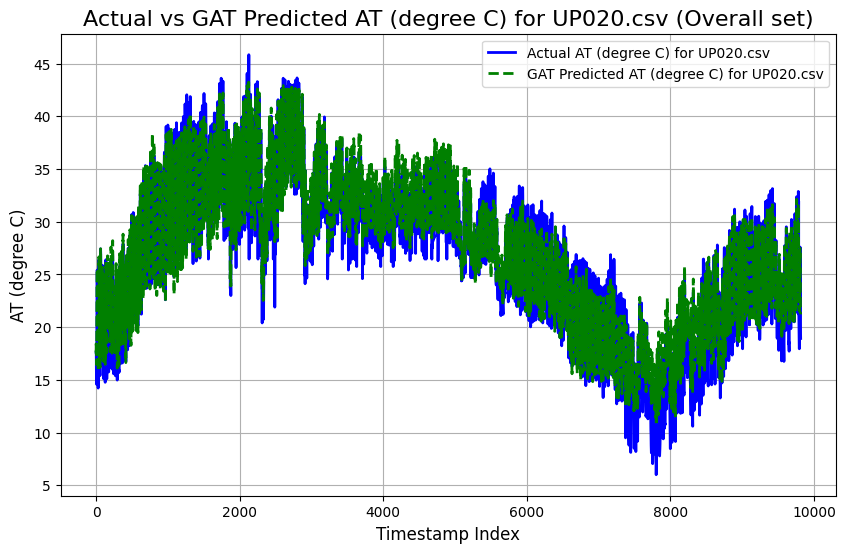

UP021.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 3.5387
Mean Squared Error (MSE): 21.8809
Root Mean Squared Error (RMSE): 4.6777
Pearson Correlation Coefficient: 0.8362
R-squared (R²): 0.6818

----------------------------------------



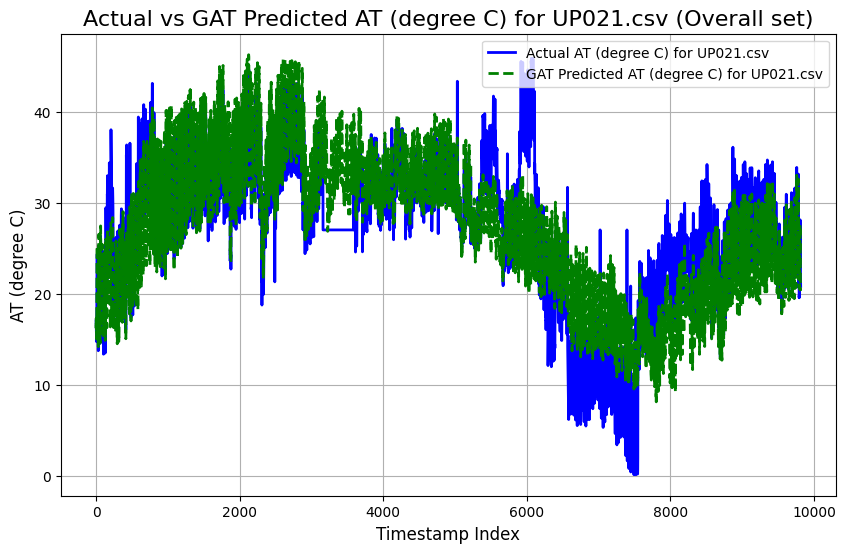

UP022.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3189
Mean Squared Error (MSE): 3.4903
Root Mean Squared Error (RMSE): 1.8682
Pearson Correlation Coefficient: 0.9703
R-squared (R²): 0.9353

----------------------------------------



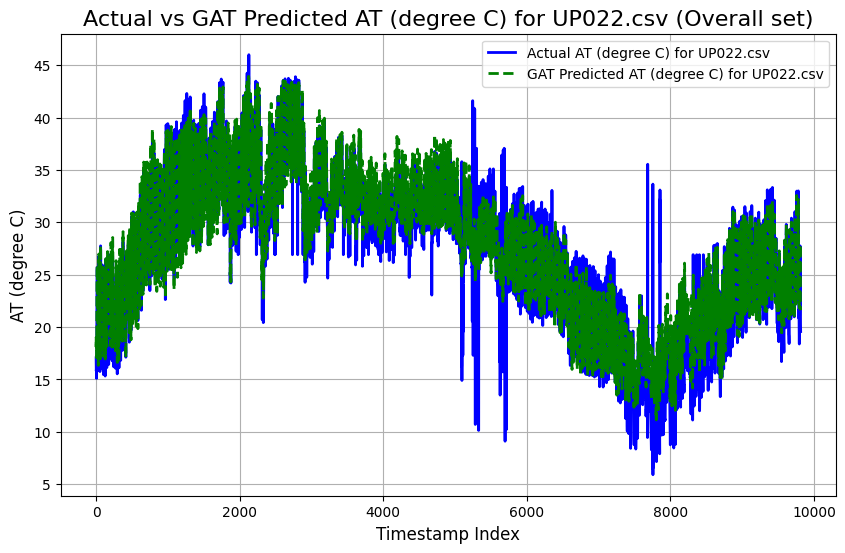

UP023.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1753
Mean Squared Error (MSE): 12.7170
Root Mean Squared Error (RMSE): 3.5661
Pearson Correlation Coefficient: 0.8732
R-squared (R²): 0.7449

----------------------------------------



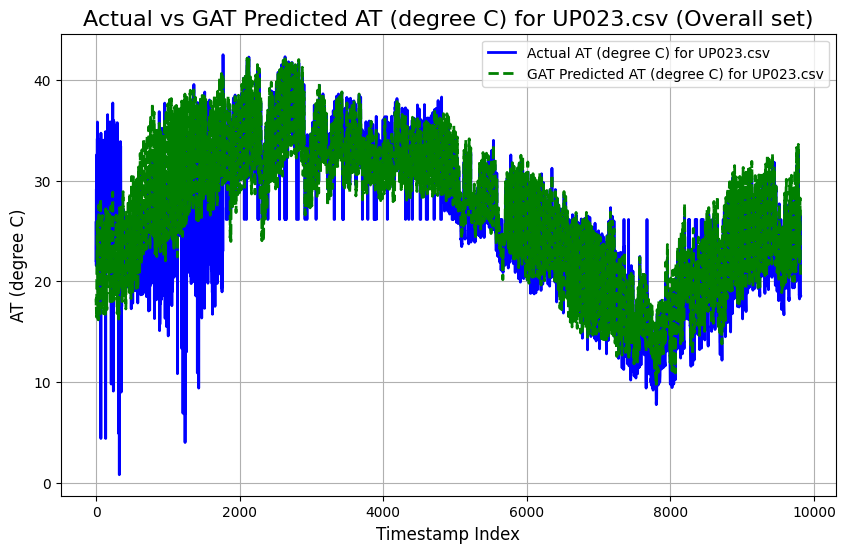

UP024.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.8132
Mean Squared Error (MSE): 14.0722
Root Mean Squared Error (RMSE): 3.7513
Pearson Correlation Coefficient: 0.8302
R-squared (R²): 0.6436

----------------------------------------



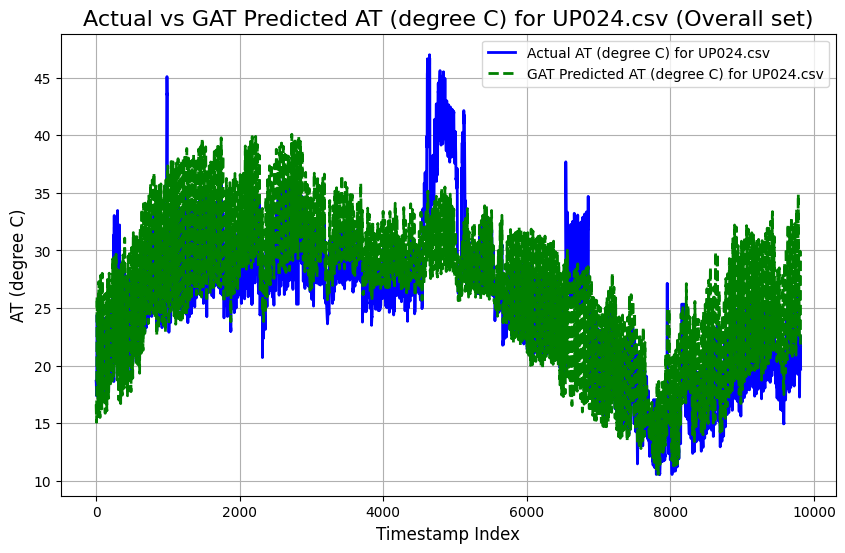

UP025.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2151
Mean Squared Error (MSE): 3.1060
Root Mean Squared Error (RMSE): 1.7624
Pearson Correlation Coefficient: 0.9748
R-squared (R²): 0.9441

----------------------------------------



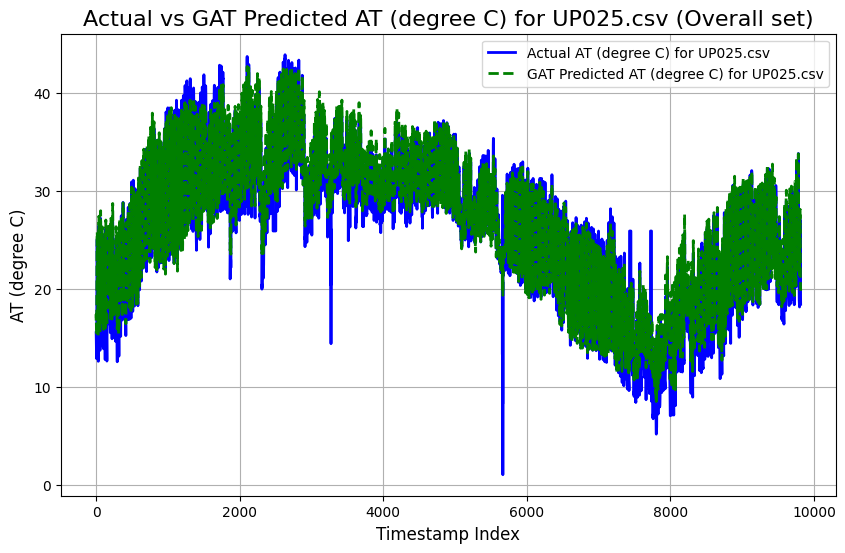

UP026.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2748
Mean Squared Error (MSE): 3.3980
Root Mean Squared Error (RMSE): 1.8434
Pearson Correlation Coefficient: 0.9766
R-squared (R²): 0.9471

----------------------------------------



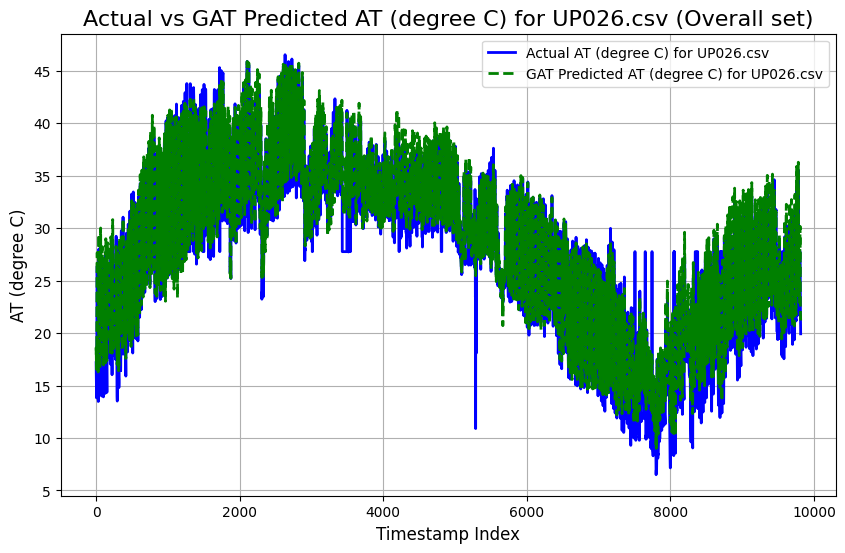

UP028.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.8236
Mean Squared Error (MSE): 5.4908
Root Mean Squared Error (RMSE): 2.3432
Pearson Correlation Coefficient: 0.9710
R-squared (R²): 0.9391

----------------------------------------



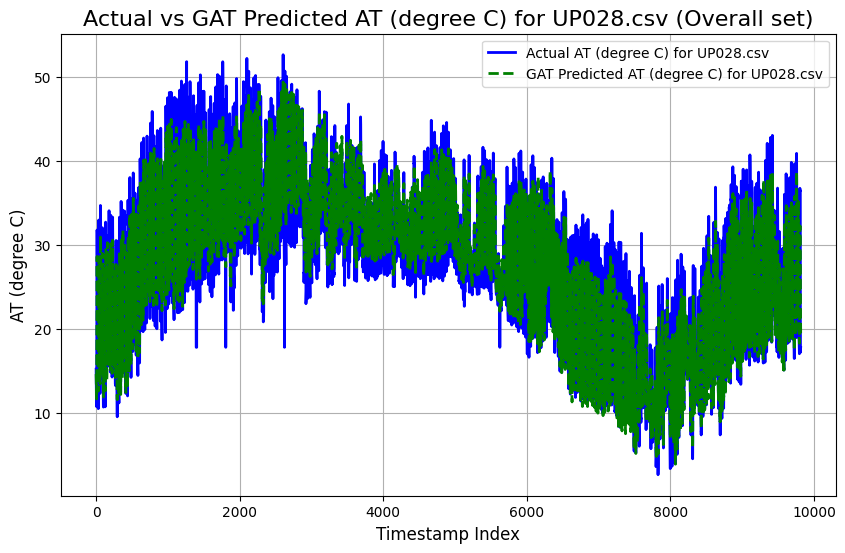

UP029.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1025
Mean Squared Error (MSE): 2.9996
Root Mean Squared Error (RMSE): 1.7319
Pearson Correlation Coefficient: 0.9762
R-squared (R²): 0.9476

----------------------------------------



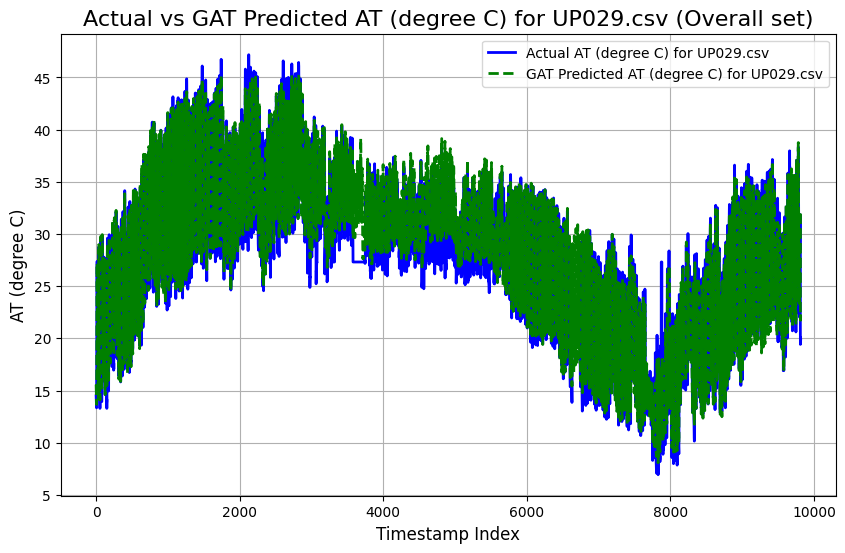

UP030.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3687
Mean Squared Error (MSE): 3.0452
Root Mean Squared Error (RMSE): 1.7450
Pearson Correlation Coefficient: 0.9821
R-squared (R²): 0.9610

----------------------------------------



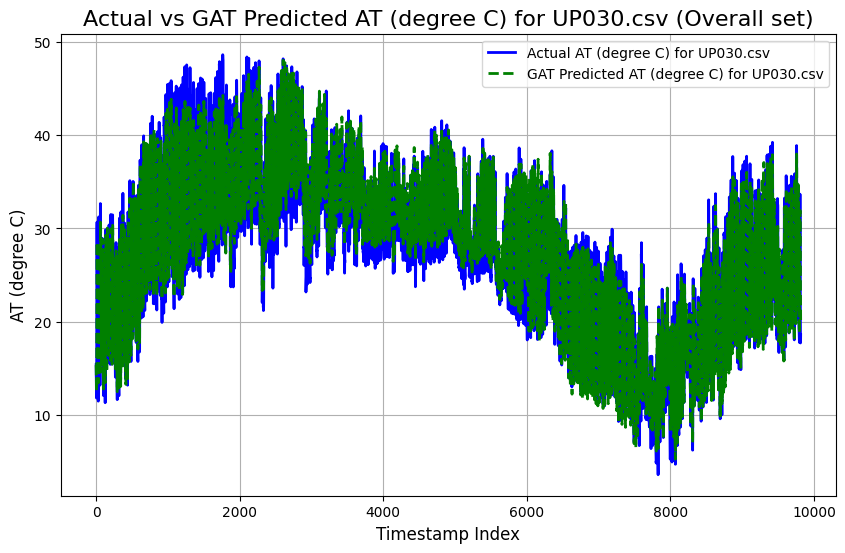

UP031.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5709
Mean Squared Error (MSE): 4.2009
Root Mean Squared Error (RMSE): 2.0496
Pearson Correlation Coefficient: 0.9709
R-squared (R²): 0.9374

----------------------------------------



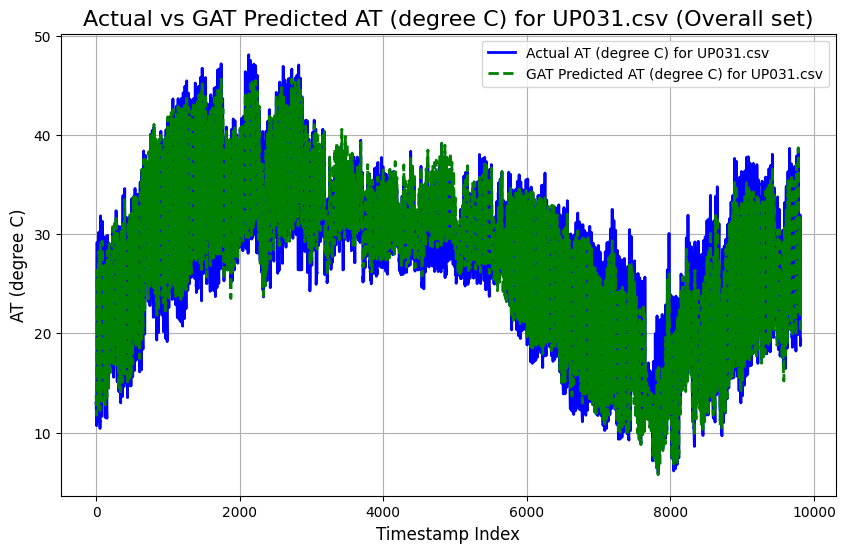

UP032.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4288
Mean Squared Error (MSE): 3.5949
Root Mean Squared Error (RMSE): 1.8960
Pearson Correlation Coefficient: 0.9685
R-squared (R²): 0.9313

----------------------------------------



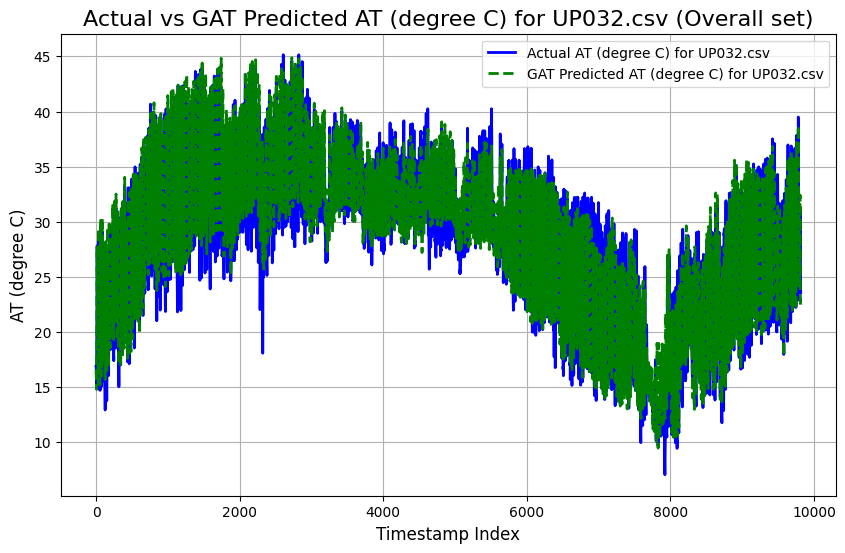

UP033.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 0.9883
Mean Squared Error (MSE): 2.0853
Root Mean Squared Error (RMSE): 1.4441
Pearson Correlation Coefficient: 0.9851
R-squared (R²): 0.9656

----------------------------------------



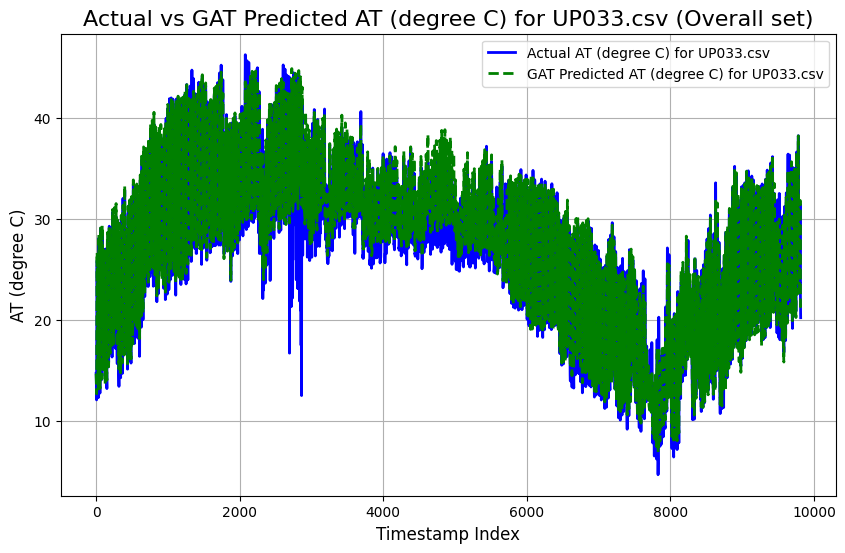

UP034.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9419
Mean Squared Error (MSE): 8.4842
Root Mean Squared Error (RMSE): 2.9128
Pearson Correlation Coefficient: 0.9599
R-squared (R²): 0.9062

----------------------------------------



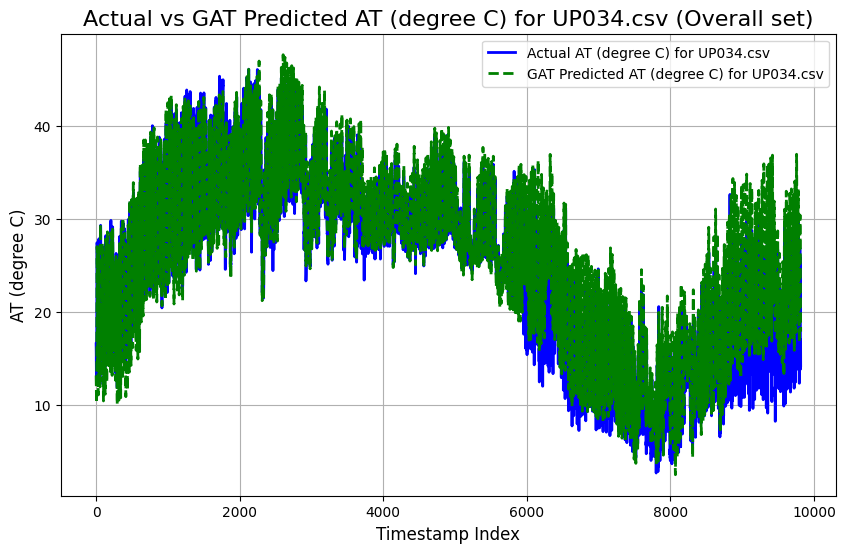

UP035.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1508
Mean Squared Error (MSE): 2.6864
Root Mean Squared Error (RMSE): 1.6390
Pearson Correlation Coefficient: 0.9832
R-squared (R²): 0.9602

----------------------------------------



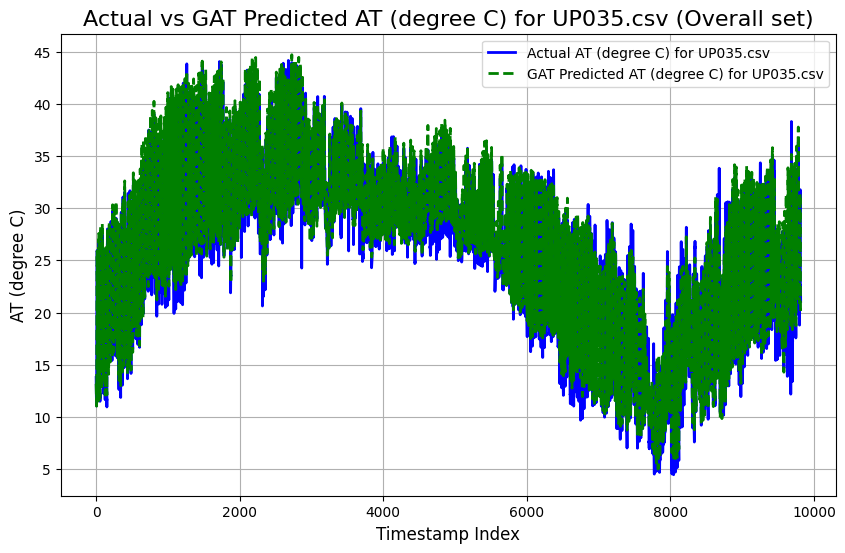

UP036.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.1886
Mean Squared Error (MSE): 3.0401
Root Mean Squared Error (RMSE): 1.7436
Pearson Correlation Coefficient: 0.9766
R-squared (R²): 0.9481

----------------------------------------



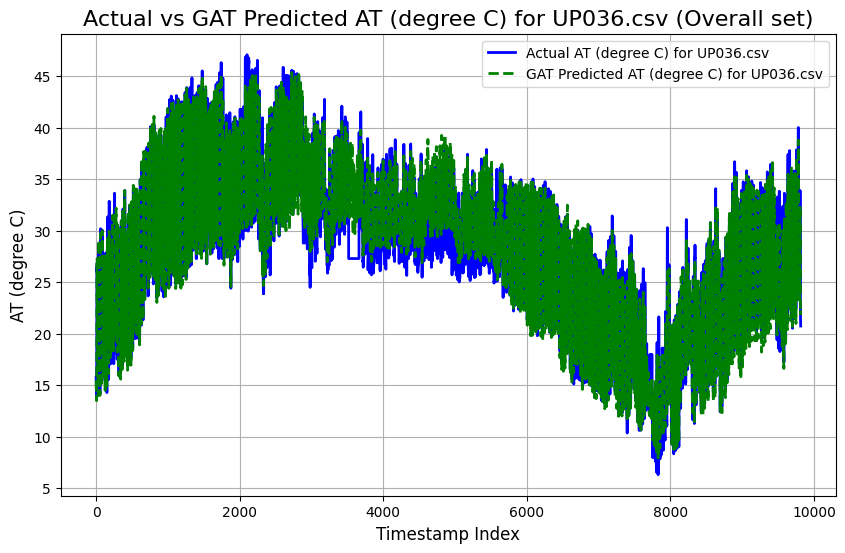

UP037.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3766
Mean Squared Error (MSE): 4.0686
Root Mean Squared Error (RMSE): 2.0171
Pearson Correlation Coefficient: 0.9739
R-squared (R²): 0.9442

----------------------------------------



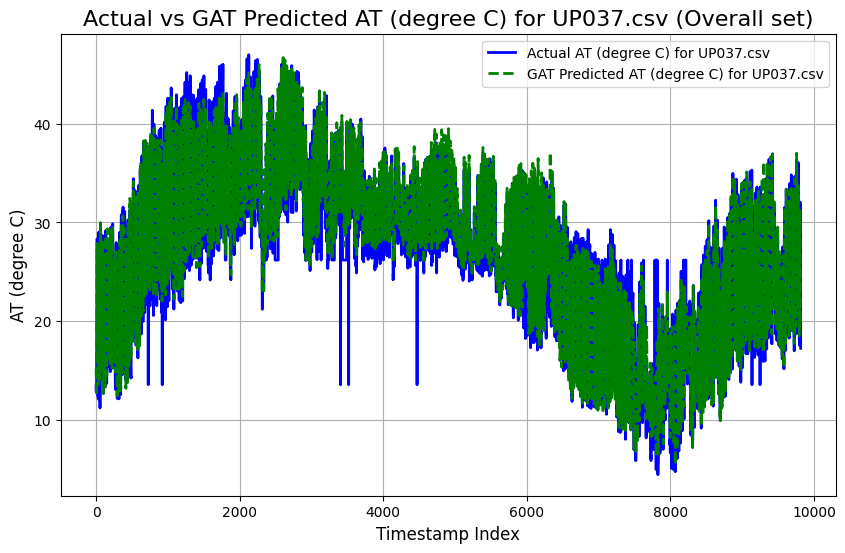

UP038.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2316
Mean Squared Error (MSE): 4.4588
Root Mean Squared Error (RMSE): 2.1116
Pearson Correlation Coefficient: 0.9629
R-squared (R²): 0.9203

----------------------------------------



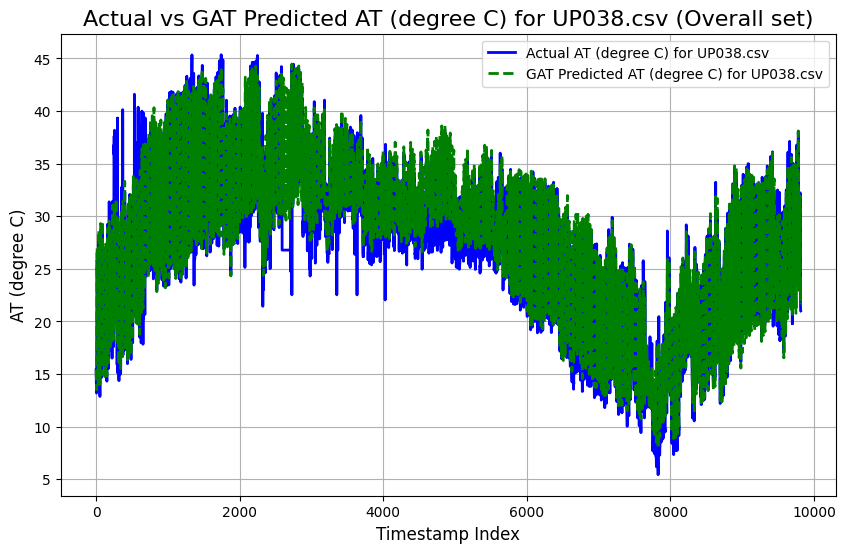

UP039.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6607
Mean Squared Error (MSE): 4.8366
Root Mean Squared Error (RMSE): 2.1992
Pearson Correlation Coefficient: 0.9706
R-squared (R²): 0.9370

----------------------------------------



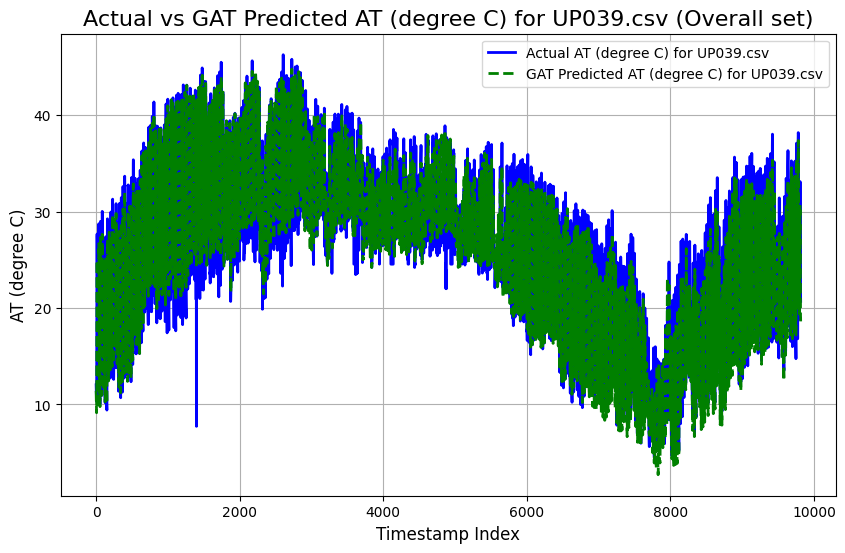

UP040.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.3932
Mean Squared Error (MSE): 3.5780
Root Mean Squared Error (RMSE): 1.8915
Pearson Correlation Coefficient: 0.9792
R-squared (R²): 0.9535

----------------------------------------



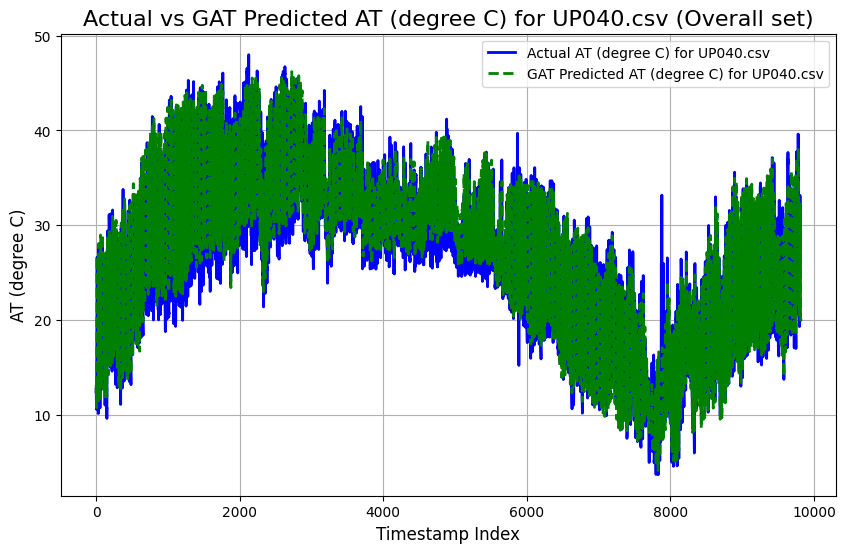

UP041.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2228
Mean Squared Error (MSE): 3.5904
Root Mean Squared Error (RMSE): 1.8948
Pearson Correlation Coefficient: 0.9690
R-squared (R²): 0.9331

----------------------------------------



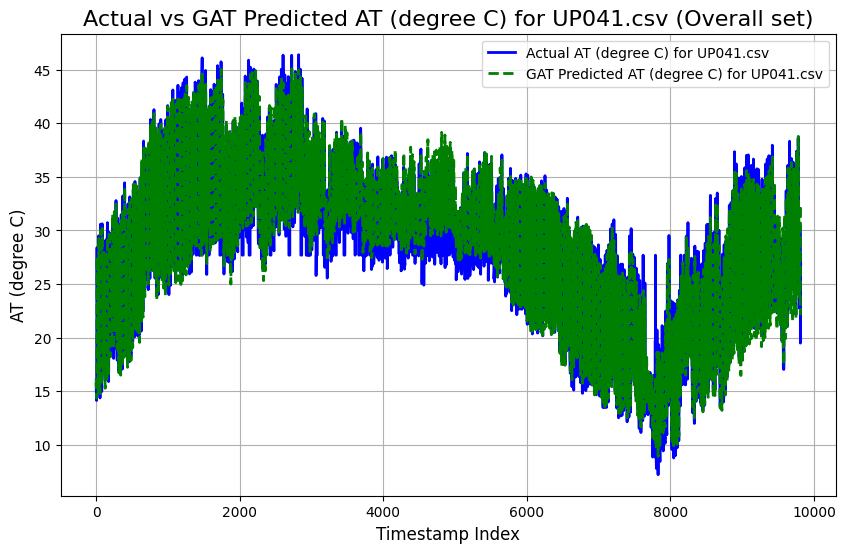

UP042.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.1396
Mean Squared Error (MSE): 13.4525
Root Mean Squared Error (RMSE): 3.6678
Pearson Correlation Coefficient: 0.8725
R-squared (R²): 0.7443

----------------------------------------



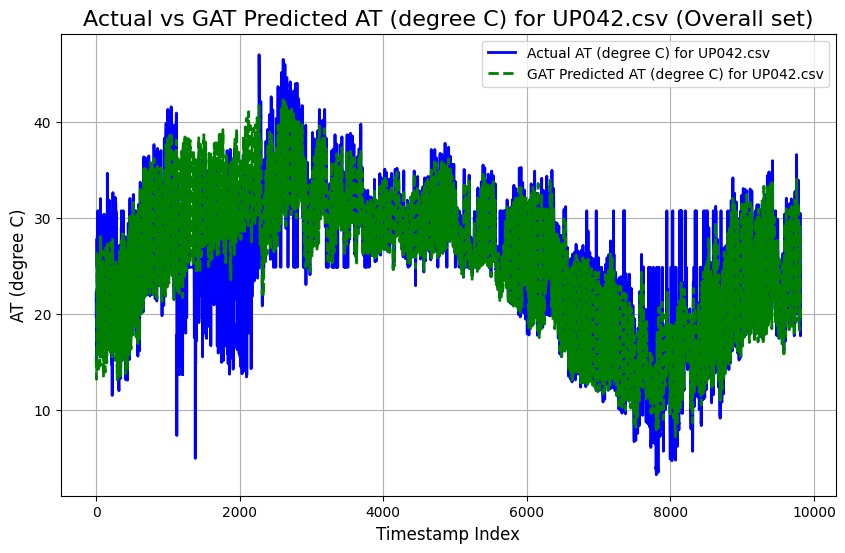

UP043.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.2392
Mean Squared Error (MSE): 11.6422
Root Mean Squared Error (RMSE): 3.4121
Pearson Correlation Coefficient: 0.9088
R-squared (R²): 0.8134

----------------------------------------



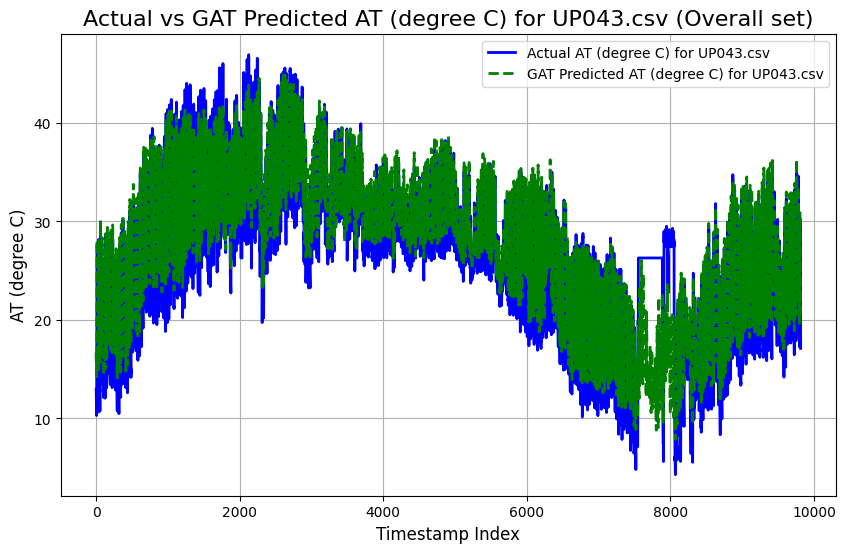

UP044.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.2481
Mean Squared Error (MSE): 3.3083
Root Mean Squared Error (RMSE): 1.8189
Pearson Correlation Coefficient: 0.9796
R-squared (R²): 0.9550

----------------------------------------



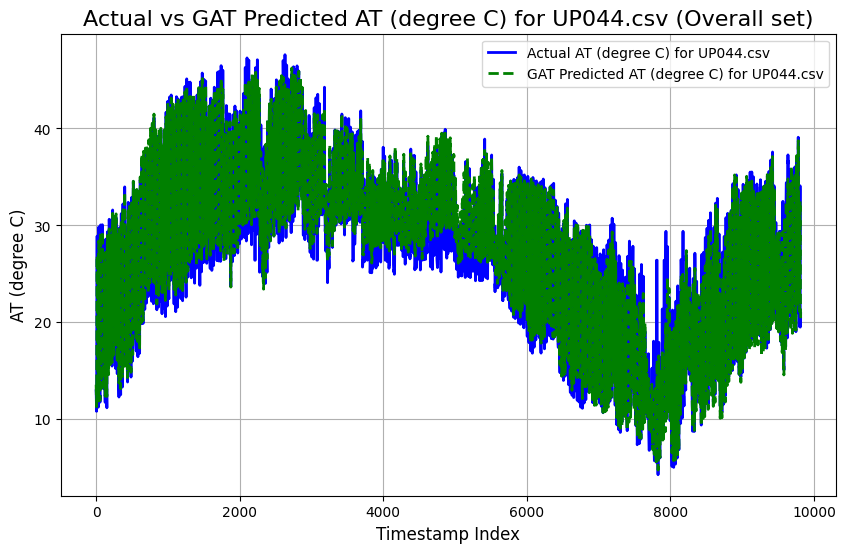

UP046.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.5181
Mean Squared Error (MSE): 4.1883
Root Mean Squared Error (RMSE): 2.0465
Pearson Correlation Coefficient: 0.9707
R-squared (R²): 0.9363

----------------------------------------



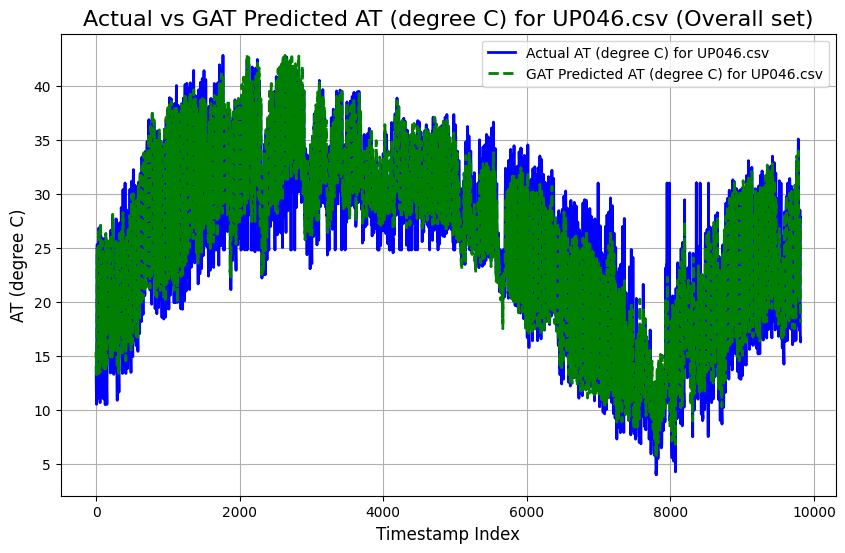

UP048.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.6456
Mean Squared Error (MSE): 5.0533
Root Mean Squared Error (RMSE): 2.2480
Pearson Correlation Coefficient: 0.9626
R-squared (R²): 0.9206

----------------------------------------



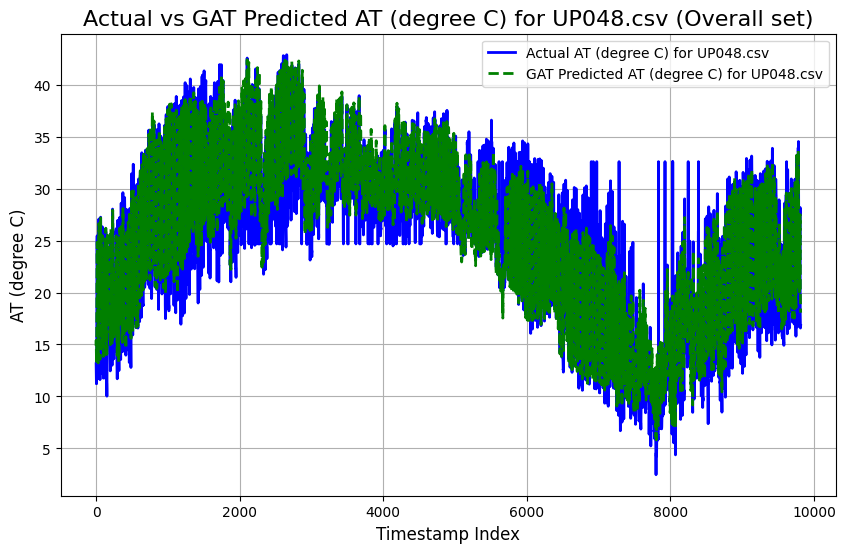

UP049.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.4714
Mean Squared Error (MSE): 4.8072
Root Mean Squared Error (RMSE): 2.1925
Pearson Correlation Coefficient: 0.9664
R-squared (R²): 0.9276

----------------------------------------



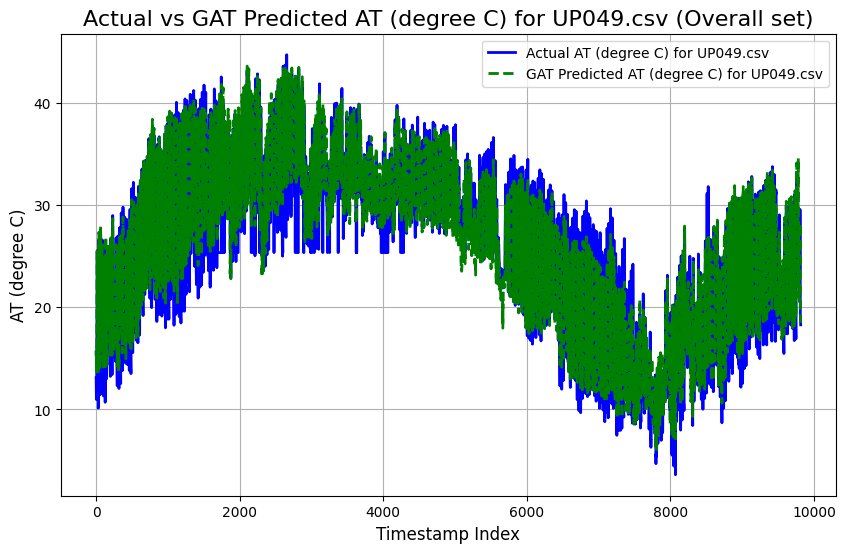

UP050.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.5037
Mean Squared Error (MSE): 10.8262
Root Mean Squared Error (RMSE): 3.2903
Pearson Correlation Coefficient: 0.8655
R-squared (R²): 0.7366

----------------------------------------



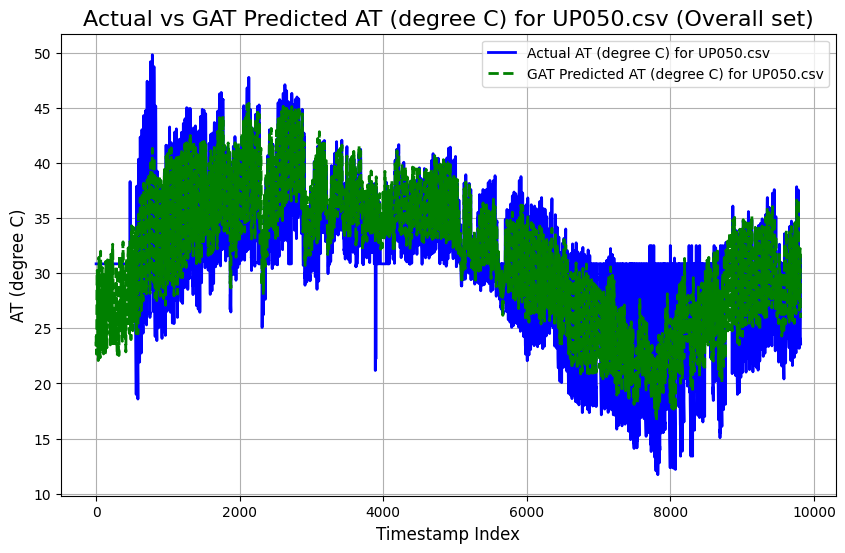

UP051.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 2.7892
Mean Squared Error (MSE): 29.3030
Root Mean Squared Error (RMSE): 5.4132
Pearson Correlation Coefficient: 0.7443
R-squared (R²): 0.5086

----------------------------------------



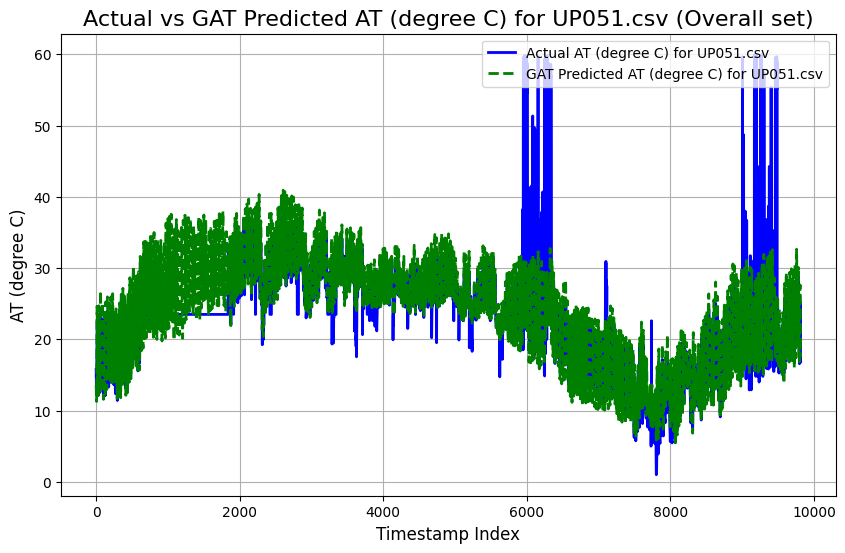

UP052.csv (Overall set) Metrics:
Mean Absolute Error (MAE): 1.9751
Mean Squared Error (MSE): 8.0661
Root Mean Squared Error (RMSE): 2.8401
Pearson Correlation Coefficient: 0.9360
R-squared (R²): 0.8696

----------------------------------------



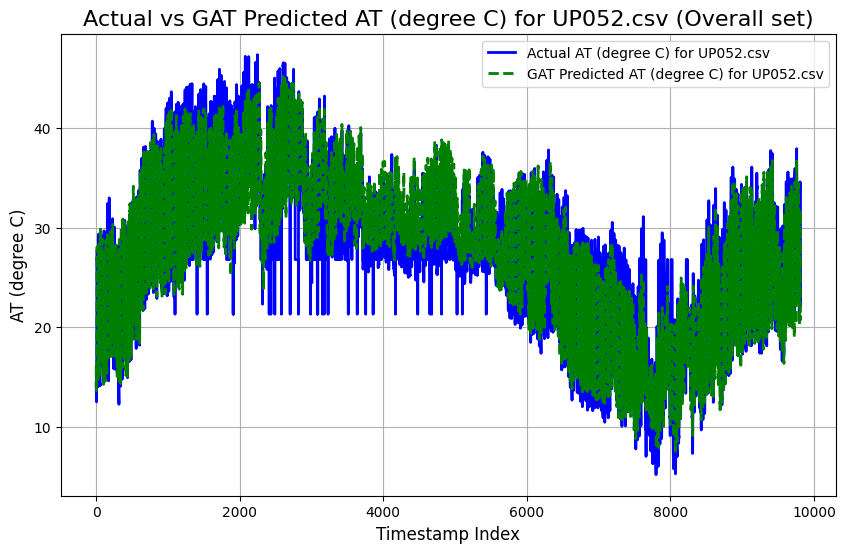

Overall GNN Imputed KNN.csv
CSV file 'Overall GNN Imputed KNN.csv' created successfully.
Shape of gat_outputs: (9816, 41)
Shape of actual_values: (9816, 41)


In [17]:

from torch.optim.lr_scheduler import StepLR
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.stats import pearsonr

# Define the GAT model
class GATModel(torch.nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GATModel, self).__init__()
        self.conv1 = GATConv(in_channels, 8, heads=8, dropout=0.2)
        self.conv2 = GATConv(8 * 8, out_channels, heads=1, concat=False, dropout=0.2)
        
    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        # First GAT layer followed by ELU activation
        x = self.conv1(x, edge_index)
        x = F.elu(x)
        # Dropout
        x = F.dropout(x, p=0.2, training=self.training)
        
        # Second GAT layer followed by ELU activation
        x = self.conv2(x, edge_index)
        return x

# Initialize the model and optimizer
in_channels = train_graph_data_list[0].x.size(-1)  # Number of input features (depends on the number of columns)
out_channels = 1  # Predicting a single value ('AT (degree C)')
model = GATModel(in_channels, out_channels)

optimizer = torch.optim.Adam(model.parameters(), lr=0.0005, weight_decay=5e-4)
loss_fn = torch.nn.MSELoss()

# StepLR: Reduces the learning rate by gamma every step_size epochs
scheduler = StepLR(optimizer, step_size=5, gamma=0.5)

# Train the GAT model on the training set
def train_gat(graph_data_list, epochs=30):
    model.train()
    for epoch in range(epochs):
        epoch_loss = 0
        for graph_data in graph_data_list:
            optimizer.zero_grad()
            out = model(graph_data)
            loss = loss_fn(out.squeeze(), graph_data.y)
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        scheduler.step()
        print(f"Epoch {epoch}, Loss: {epoch_loss/len(graph_data_list)}")

# Train the model using the training dataset
train_gat(train_graph_data_list)

# Evaluate the model on the training and testing sets
def evaluate_gat(graph_data_list):
    model.eval()
    gat_outputs = []
    actual_values = []
    with torch.no_grad():
        for graph_data in graph_data_list:
            gat_output = model(graph_data)
            gat_outputs.append(gat_output.squeeze().numpy())
            actual_values.append(graph_data.y.squeeze().numpy())
    return np.array(gat_outputs), np.array(actual_values)

# Get GAT predictions for training and testing sets
train_gat_outputs, train_actual_values = evaluate_gat(train_graph_data_list)
test_gat_outputs, test_actual_values = evaluate_gat(test_graph_data_list)

train_gnn_mae_list = []
train_gnn_mse_list = []
train_gnn_rmse_list = []
train_gnn_pearson_corr_list = []
train_gnn_r_squared_list = []

test_gnn_mae_list = []
test_gnn_mse_list = []
test_gnn_rmse_list = []
test_gnn_pearson_corr_list = []
test_gnn_r_squared_list = []

overall_gnn_mae_list = []
overall_gnn_mse_list = []
overall_gnn_rmse_list = []
overall_gnn_pearson_corr_list = []
overall_gnn_r_squared_list = []

# Apply inverse scaling and calculate performance metrics for training and testing sets
def inverse_scale_and_evaluate(gat_outputs, actual_values, set_type):
    gat_outputs_inverse_scaled = []
    actual_values_inverse_scaled = []
    for node_idx in range(gat_outputs.shape[1]):
        gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
        actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
        gat_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(gat_node_values).flatten()
        actual_node_inverse_scaled = scalers[input_files[node_idx]].inverse_transform(actual_node_values).flatten()
        gat_outputs_inverse_scaled.append(gat_node_inverse_scaled)
        actual_values_inverse_scaled.append(actual_node_inverse_scaled)
    
    # Evaluate performance metrics for each node
    num_nodes = gat_outputs.shape[1]
    for node_idx in range(num_nodes):
        actual = actual_values_inverse_scaled[node_idx]
        predicted = gat_outputs_inverse_scaled[node_idx]
        mae = mean_absolute_error(actual, predicted)
        mse = mean_squared_error(actual, predicted)
        rmse = np.sqrt(mse)
        pearson_corr, _ = pearsonr(actual, predicted)
        r_squared = r2_score(actual, predicted)
        
        print(f"{input_files[node_idx]} ({set_type} set) Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {pearson_corr:.4f}")
        print(f"R-squared (R²): {r_squared:.4f}")
        print("\n" + "-"*40 + "\n")

        if(set_type == 'Training'):
            train_gnn_mae_list.append(mae)
            train_gnn_mse_list.append(mse)
            train_gnn_rmse_list.append(rmse)
            train_gnn_pearson_corr_list.append(pearson_corr)
            train_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Testing'):
            test_gnn_mae_list.append(mae)
            test_gnn_mse_list.append(mse)
            test_gnn_rmse_list.append(rmse)
            test_gnn_pearson_corr_list.append(pearson_corr)
            test_gnn_r_squared_list.append(r_squared)

        if(set_type == 'Overall'):
            overall_gnn_mae_list.append(mae)
            overall_gnn_mse_list.append(mse)
            overall_gnn_rmse_list.append(rmse)
            overall_gnn_pearson_corr_list.append(pearson_corr)
            overall_gnn_r_squared_list.append(r_squared)        
        
        # Plot actual vs predicted values for this node
        plt.figure(figsize=(10, 6))
        plt.plot(actual, label=f'Actual AT (degree C) for {input_files[node_idx]}', color='blue', linewidth=2)
        plt.plot(predicted, label=f'GAT Predicted AT (degree C) for {input_files[node_idx]}', color='green', linestyle='--', linewidth=2)
        plt.title(f'Actual vs GAT Predicted AT (degree C) for {input_files[node_idx]} ({set_type} set)', fontsize=16)
        plt.xlabel('Timestamp Index', fontsize=12)
        plt.ylabel('AT (degree C)', fontsize=12)
        plt.legend(loc='upper right')
        plt.grid(True)
        plt.show()

# Evaluate and plot for both training and testing sets
inverse_scale_and_evaluate(train_gat_outputs, train_actual_values, 'Training')
inverse_scale_and_evaluate(test_gat_outputs, test_actual_values, 'Testing')

def create_metrics_gnn_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")


# Create CSV for training set
file_name = "Train GNN Imputed KNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, train_gnn_mae_list, train_gnn_mse_list, train_gnn_rmse_list, train_gnn_r_squared_list, train_gnn_pearson_corr_list)

# Create CSV for training set
file_name = "Test GNN Imputed KNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, test_gnn_mae_list, test_gnn_mse_list, test_gnn_rmse_list, test_gnn_r_squared_list, test_gnn_pearson_corr_list)

# Concatenate training and testing outputs
gat_outputs = np.concatenate([train_gat_outputs, test_gat_outputs], axis=0)
actual_values = np.concatenate([train_actual_values, test_actual_values], axis=0)
inverse_scale_and_evaluate(gat_outputs, actual_values, 'Overall')

# Create CSV for overall set
file_name = "Overall GNN Imputed KNN.csv"
print(file_name)
create_metrics_gnn_csv(file_name, input_files, overall_gnn_mae_list, overall_gnn_mse_list, overall_gnn_rmse_list, overall_gnn_r_squared_list, overall_gnn_pearson_corr_list)

# Print the shapes of gat_outputs and actual_values
print(f"Shape of gat_outputs: {gat_outputs.shape}")
print(f"Shape of actual_values: {actual_values.shape}")


# Showing the GAT outputs and actual outputs

In [18]:
gat_outputs_without_inverse_scaled = []
actual_values_without_inverse_scaled = []

for node_idx in range(gat_outputs.shape[1]):
    # Extract predictions and actual values for the current node across all timestamps
    gat_node_values = gat_outputs[:, node_idx].reshape(-1, 1)
    actual_node_values = actual_values[:, node_idx].reshape(-1, 1)
    
    # Append the inverse scaled values for this node
    gat_outputs_without_inverse_scaled.append(gat_node_values)
    actual_values_without_inverse_scaled.append(actual_node_values)

# Plot the actual vs predicted values for each node
num_nodes = gat_outputs.shape[1]
print(gat_outputs_without_inverse_scaled)
print(actual_values_without_inverse_scaled)


[array([[-1.5554813 ],
       [-1.5960152 ],
       [-1.6382308 ],
       ...,
       [-0.6841929 ],
       [-0.69380194],
       [-0.7439962 ]], dtype=float32), array([[-1.598667 ],
       [-1.6281327],
       [-1.6741792],
       ...,
       [-0.7950076],
       [-0.7344417],
       [-0.7706598]], dtype=float32), array([[-1.3334576 ],
       [-1.4109505 ],
       [-1.477291  ],
       ...,
       [-0.759726  ],
       [-0.79699934],
       [-0.8350511 ]], dtype=float32), array([[-1.2441459 ],
       [-1.1243515 ],
       [-1.252854  ],
       ...,
       [-0.76071554],
       [-0.77551883],
       [-0.77772945]], dtype=float32), array([[-1.2724818 ],
       [-1.1532611 ],
       [-1.2760036 ],
       ...,
       [-0.80134803],
       [-0.8226494 ],
       [-0.8289609 ]], dtype=float32), array([[-1.2937024 ],
       [-1.2700083 ],
       [-1.3710582 ],
       ...,
       [-0.76234597],
       [-0.7886899 ],
       [-0.809372  ]], dtype=float32), array([[-1.2856604 ],
       [-1.201551

# Adding the GNN predicted values as a new column

In [19]:
train_gat_outputs_without_inverse_scaled = []
test_gat_outputs_without_inverse_scaled = []
train_size = train_dataframes[0].shape[0]

for node_idx in range(num_nodes):
    train1 = gat_outputs_without_inverse_scaled[node_idx][:train_size]
    test1 = gat_outputs_without_inverse_scaled[node_idx][train_size:]
    train_gat_outputs_without_inverse_scaled.append(train1)
    test_gat_outputs_without_inverse_scaled.append(test1)

# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(train_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = train_gat_outputs_without_inverse_scaled[node_idx].flatten()
    print(df.shape)
    print(len(predicted_values))

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


# Add predicted values as a new column in each dataframe and print column and row details
for node_idx, df in enumerate(test_dataframes):
    # Extract the predicted values for the current node (inverse scaled)
    predicted_values = test_gat_outputs_without_inverse_scaled[node_idx].flatten()

    # Add a new column for the predicted values
    df['Predicted AT (degree C)'] = predicted_values

    # Print column numbers and names
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}: Columns")
    for col_idx, col_name in enumerate(df.columns):
        print(f"Column {col_idx + 1}: {col_name}")

    print(f"Row numbers total: {len(df)}")    

# Optionally print the first few rows to verify the predicted column was added correctly
    print(df.head(10))  # Display the first few rows of the dataframe for verification
    print("\n" + "="*60 + "\n")


(8343, 15)
8343
DataFrame 1 - UP002.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       0.018807      0.438601    0.109348     0.431761    -0.851437   
1       0.098702      0.339399    0.073593     0.341571    -0.300050   
2       0.071341      0.242997    0.194100     0.638389     0.123107   
3       0.079002      0.231930    0.095112     0.591948     0.187222   
4      -0.183669      0.088326    0.045452     0.200229     0.232102   
5      -0.094579     -0.003943    0.086173     0.334840    -0.062826   
6      -0.179947     -0.012343    0.206350     0.892469    -0.092746   
7       0.0

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

(8343, 15)
8343
DataFrame 15 - UP023.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 8343
   PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
0       1.041153      0.704864    1.182339    -0.778669    -0.355593   
1       0.537502      0.576995    2.106136    -0.612134    -0.399438   
2       0.890057      0.983288    1.954258    -0.665253    -0.519282   
3       1.091518      0.902855    2.630665    -0.609262    -0.400413   
4       0.926992      1.249339    2.829516    -0.627064    -0.446207   
5       1.027722      1.022474    3.322730    -0.535183    -0.487129   
6       1.919788      1.734004    3.040893    -0.551836    -0.189956   
7       2.

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

DataFrame 6 - UP012.csv: Columns
Column 1: PM2.5 (ug/m3)
Column 2: PM10 (ug/m3)
Column 3: NO (ug/m3)
Column 4: NO2 (ug/m3)
Column 5: SO2 (ug/m3)
Column 6: CO (mg/m3)
Column 7: Ozone (ug/m3)
Column 8: RH (%)
Column 9: WS (m/s)
Column 10: WD (degree)
Column 11: AT (degree C)
Column 12: Year
Column 13: Month
Column 14: Day
Column 15: Hour
Column 16: Predicted AT (degree C)
Row numbers total: 1473
      PM2.5 (ug/m3)  PM10 (ug/m3)  NO (ug/m3)  NO2 (ug/m3)  SO2 (ug/m3)  \
8343       0.134645     -0.679357   -0.301667     0.268134    -1.312692   
8344       0.174085     -0.623275   -0.257981     0.456332    -1.453746   
8345       0.216558     -0.674259   -0.270517     0.638705    -1.374921   
8346       0.316674     -0.551899   -0.269377     0.904422    -1.387367   
8347      -0.017024     -0.010448    0.031534     0.053433    -0.065357   
8348      -0.017024     -0.010448    0.031534     0.053433    -0.065357   
8349      -0.017024     -0.010448    0.031534     0.053433    -0.065357   
835

C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Predicted AT (degree C)'] = predicted_values
C:\Users\Asus\AppData\Local\Temp\ipykernel_19052\1830292258.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,co

# Creating feature and target lists

In [20]:
# Initialize lists to store features and target for each dataframe
train_features_list = []
train_target_list = []

test_features_list = []
test_target_list = []

# Iterate over each dataframe to separate features and target
for node_idx, (df1, df2) in enumerate(zip(train_dataframes, test_dataframes)):
    # Features include all columns except 'AT (degree C)'
    trainfeatures1 = df1.drop(columns=['AT (degree C)'])
    testfeatures1 = df2.drop(columns=['AT (degree C)'])
    
    # Target is the 'AT (degree C)' column
    traintarget1 = df1['AT (degree C)']
    testtarget1 = df2['AT (degree C)']
    
    # Append the features and target to the respective lists
    train_features_list.append(trainfeatures1)
    train_target_list.append(traintarget1)
    test_features_list.append(testfeatures1)
    test_target_list.append(testtarget1)
    
    # Print the columns of features and target, and number of rows
    print(f"DataFrame {node_idx + 1} - {input_files[node_idx]}:")
    print(f"Features columns: {len(trainfeatures1.columns)}")
    print(trainfeatures1.columns)
    
    print("\nTarget column:")
    print(traintarget1.name)
    
    print(f"\nNumber of rows in training features: {trainfeatures1.shape[0]}")
    print(f"Number of rows in training target: {traintarget1.shape[0]}")
    print(f"\nNumber of rows in testing features: {testfeatures1.shape[0]}")
    print(f"Number of rows in testing target: {testtarget1.shape[0]}")
    print("\n" + "="*60 + "\n")

DataFrame 1 - UP002.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFrame 2 - UP003.csv:
Features columns: 15
Index(['PM2.5 (ug/m3)', 'PM10 (ug/m3)', 'NO (ug/m3)', 'NO2 (ug/m3)',
       'SO2 (ug/m3)', 'CO (mg/m3)', 'Ozone (ug/m3)', 'RH (%)', 'WS (m/s)',
       'WD (degree)', 'Year', 'Month', 'Day', 'Hour',
       'Predicted AT (degree C)'],
      dtype='object')

Target column:
AT (degree C)

Number of rows in training features: 8343
Number of rows in training target: 8343

Number of rows in testing features: 1473
Number of rows in testing target: 1473


DataFr

# LSTM Model Implementation

For Batch Size= 3 and Sequence Length = 3
Processing node 1...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0887
Epoch [2/50], Train Loss: 0.0598
Epoch [3/50], Train Loss: 0.0547
Epoch [4/50], Train Loss: 0.0511
Epoch [5/50], Train Loss: 0.0492
Epoch [6/50], Train Loss: 0.0487
Epoch [7/50], Train Loss: 0.0466
Epoch [8/50], Train Loss: 0.0459
Epoch [9/50], Train Loss: 0.0450
Epoch [10/50], Train Loss: 0.0445
Epoch [11/50], Train Loss: 0.0436
Epoch [12/50], Train Loss: 0.0429
Epoch [13/50], Train Loss: 0.0420
Epoch [14/50], Train Loss: 0.0415
Epoch [15/50], Train Loss: 0.0416
Epoch [16/50], Train Loss: 0.0401
Epoch [17/50], Train Loss: 0.0407
Epoch [18/50], Train Loss: 0.0392
Epoch [19/50], Train Loss: 0.0396
Epoch [20/50], Train Loss: 0.0382
Epoch [21/50], Train Loss: 0.0383
Epoch [22/50], Train Loss: 0.0372
Epoch [23/50], Train Loss: 0.0370
Epoch [24/50], Train Loss: 0.0364
Epoch [25/50], Train Loss: 0.0360
Epoch [26/50], Train Loss: 0.0358
Epoch [27/50], Train Loss: 0.0353
Epoch [28/50], Train Loss: 0.0348
Epoch [29/50], Train Loss: 0.0342
Epoch [30/50], Train Lo

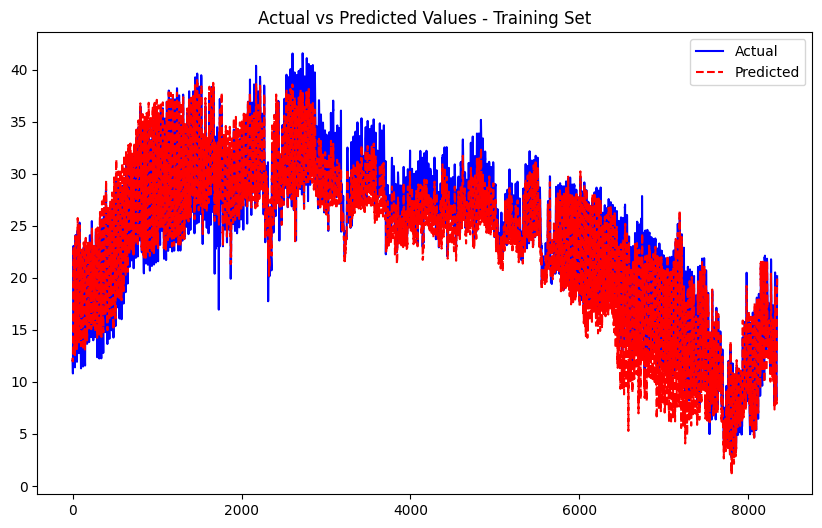

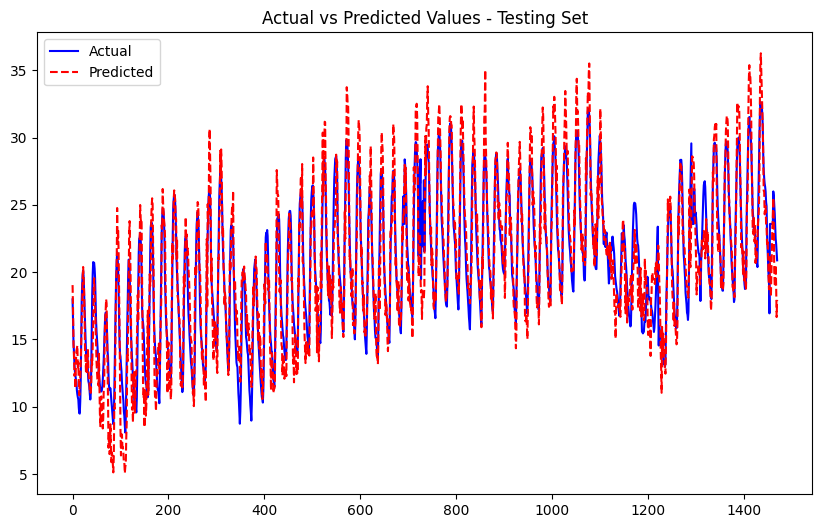

Processing node 2...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0492
Epoch [2/50], Train Loss: 0.0405
Epoch [3/50], Train Loss: 0.0379
Epoch [4/50], Train Loss: 0.0361
Epoch [5/50], Train Loss: 0.0345
Epoch [6/50], Train Loss: 0.0327
Epoch [7/50], Train Loss: 0.0324
Epoch [8/50], Train Loss: 0.0316
Epoch [9/50], Train Loss: 0.0306
Epoch [10/50], Train Loss: 0.0305
Epoch [11/50], Train Loss: 0.0292
Epoch [12/50], Train Loss: 0.0292
Epoch [13/50], Train Loss: 0.0289
Epoch [14/50], Train Loss: 0.0284
Epoch [15/50], Train Loss: 0.0279
Epoch [16/50], Train Loss: 0.0278
Epoch [17/50], Train Loss: 0.0274
Epoch [18/50], Train Loss: 0.0272
Epoch [19/50], Train Loss: 0.0270
Epoch [20/50], Train Loss: 0.0265
Epoch [21/50], Train Loss: 0.0261
Epoch [22/50], Train Loss: 0.0258
Epoch [23/50], Train Loss: 0.0259
Epoch [24/50], Train Loss: 0.0256
Epoch [25/50], Train Loss: 0.0249
Epoch [26/50], Train Loss: 0.0253
Epoch [27/50], Train Loss: 0.0247
Epoch [28/50], Train Loss: 0.0245
Epoch [29/50], Train Loss: 0.0246
Epoch [30/50], Train Lo

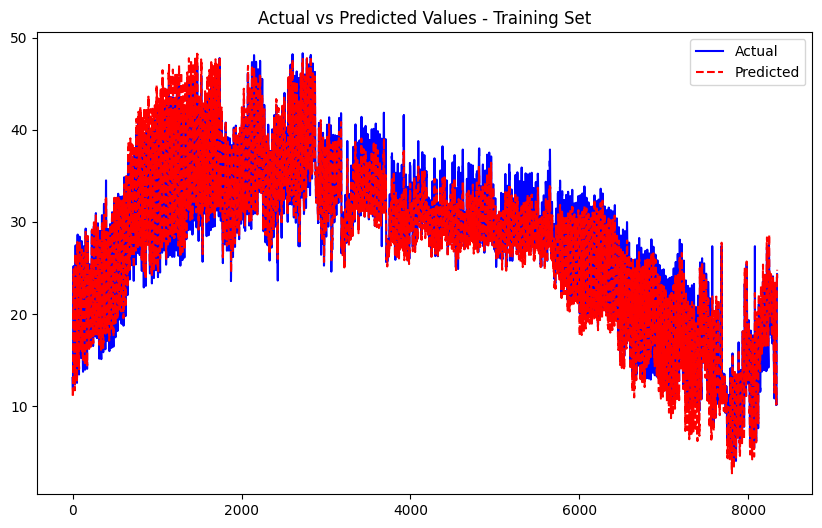

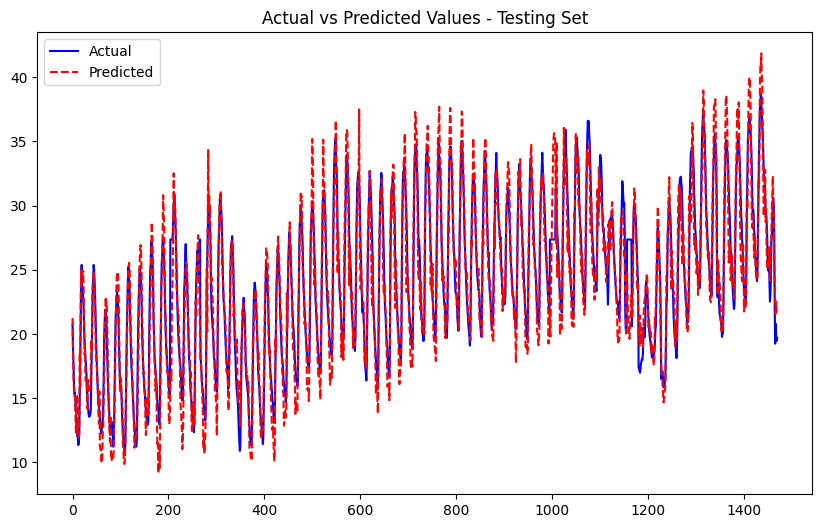

Processing node 3...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0480
Epoch [2/50], Train Loss: 0.0385
Epoch [3/50], Train Loss: 0.0336
Epoch [4/50], Train Loss: 0.0318
Epoch [5/50], Train Loss: 0.0298
Epoch [6/50], Train Loss: 0.0293
Epoch [7/50], Train Loss: 0.0282
Epoch [8/50], Train Loss: 0.0276
Epoch [9/50], Train Loss: 0.0260
Epoch [10/50], Train Loss: 0.0260
Epoch [11/50], Train Loss: 0.0249
Epoch [12/50], Train Loss: 0.0252
Epoch [13/50], Train Loss: 0.0246
Epoch [14/50], Train Loss: 0.0242
Epoch [15/50], Train Loss: 0.0239
Epoch [16/50], Train Loss: 0.0234
Epoch [17/50], Train Loss: 0.0236
Epoch [18/50], Train Loss: 0.0231
Epoch [19/50], Train Loss: 0.0231
Epoch [20/50], Train Loss: 0.0229
Epoch [21/50], Train Loss: 0.0225
Epoch [22/50], Train Loss: 0.0221
Epoch [23/50], Train Loss: 0.0222
Epoch [24/50], Train Loss: 0.0224
Epoch [25/50], Train Loss: 0.0219
Epoch [26/50], Train Loss: 0.0214
Epoch [27/50], Train Loss: 0.0215
Epoch [28/50], Train Loss: 0.0215
Epoch [29/50], Train Loss: 0.0211
Epoch [30/50], Train Lo

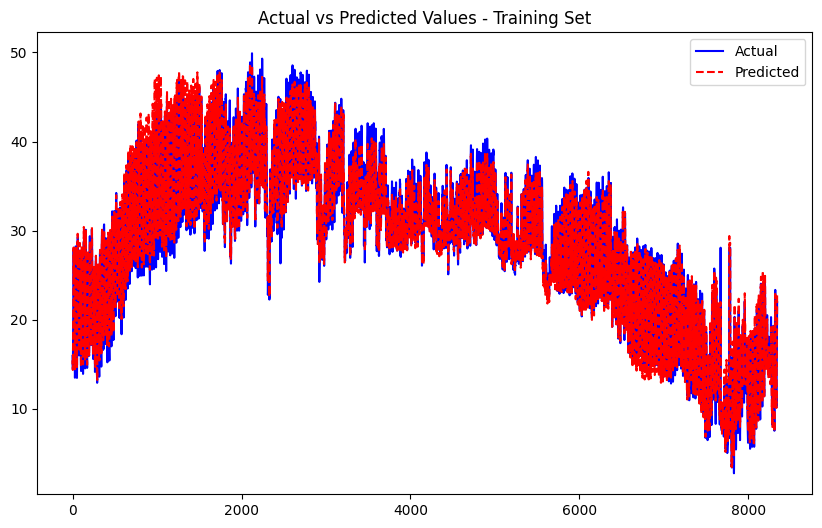

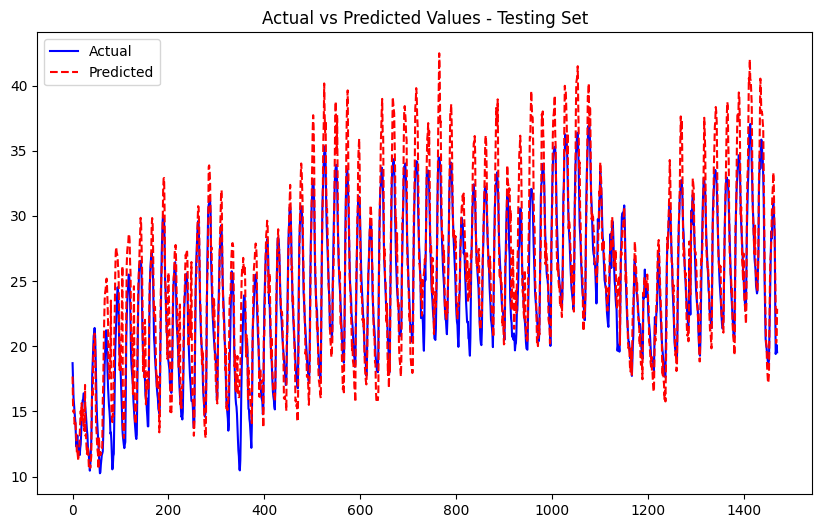

Processing node 4...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2608
Epoch [2/50], Train Loss: 0.2331
Epoch [3/50], Train Loss: 0.2041
Epoch [4/50], Train Loss: 0.1795
Epoch [5/50], Train Loss: 0.1605
Epoch [6/50], Train Loss: 0.1435
Epoch [7/50], Train Loss: 0.1325
Epoch [8/50], Train Loss: 0.1282
Epoch [9/50], Train Loss: 0.1233
Epoch [10/50], Train Loss: 0.1125
Epoch [11/50], Train Loss: 0.1050
Epoch [12/50], Train Loss: 0.1024
Epoch [13/50], Train Loss: 0.0968
Epoch [14/50], Train Loss: 0.0914
Epoch [15/50], Train Loss: 0.0867
Epoch [16/50], Train Loss: 0.0828
Epoch [17/50], Train Loss: 0.0781
Epoch [18/50], Train Loss: 0.0792
Epoch [19/50], Train Loss: 0.0753
Epoch [20/50], Train Loss: 0.0731
Epoch [21/50], Train Loss: 0.0727
Epoch [22/50], Train Loss: 0.0715
Epoch [23/50], Train Loss: 0.0693
Epoch [24/50], Train Loss: 0.0657
Epoch [25/50], Train Loss: 0.0647
Epoch [26/50], Train Loss: 0.0624
Epoch [27/50], Train Loss: 0.0601
Epoch [28/50], Train Loss: 0.0592
Epoch [29/50], Train Loss: 0.0579
Epoch [30/50], Train Lo

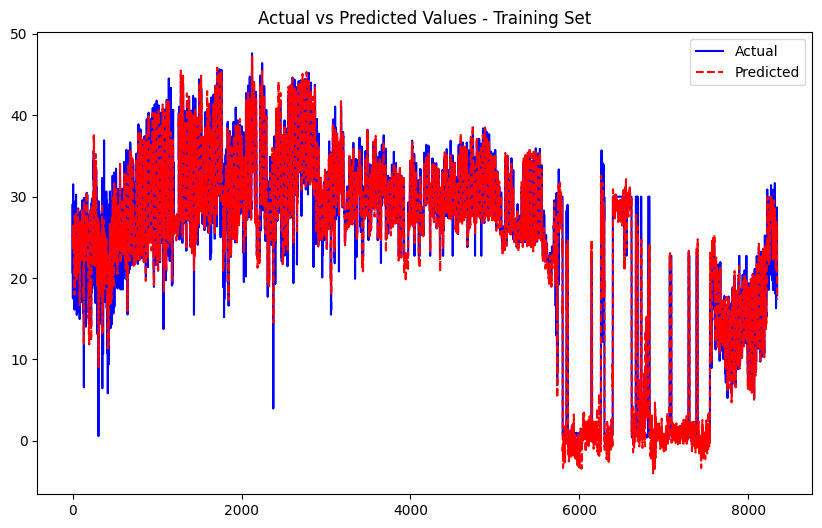

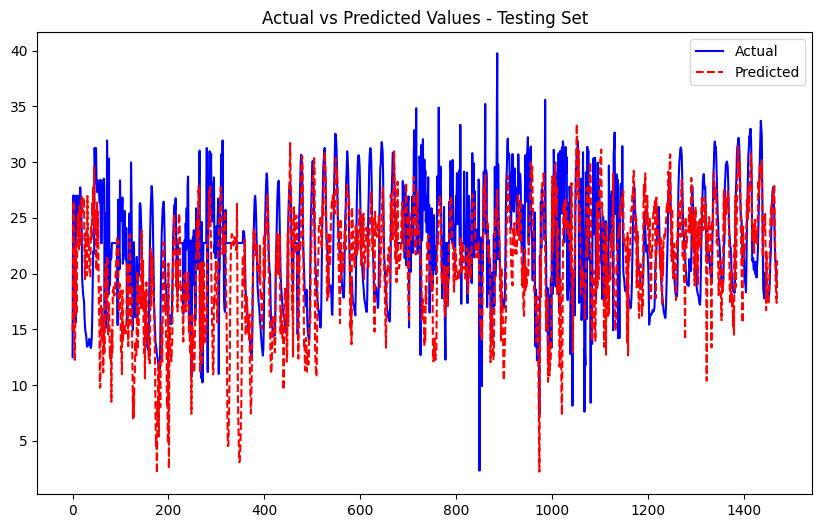

Processing node 5...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0848
Epoch [2/50], Train Loss: 0.0583
Epoch [3/50], Train Loss: 0.0504
Epoch [4/50], Train Loss: 0.0442
Epoch [5/50], Train Loss: 0.0405
Epoch [6/50], Train Loss: 0.0379
Epoch [7/50], Train Loss: 0.0360
Epoch [8/50], Train Loss: 0.0345
Epoch [9/50], Train Loss: 0.0334
Epoch [10/50], Train Loss: 0.0324
Epoch [11/50], Train Loss: 0.0315
Epoch [12/50], Train Loss: 0.0311
Epoch [13/50], Train Loss: 0.0305
Epoch [14/50], Train Loss: 0.0294
Epoch [15/50], Train Loss: 0.0290
Epoch [16/50], Train Loss: 0.0290
Epoch [17/50], Train Loss: 0.0281
Epoch [18/50], Train Loss: 0.0282
Epoch [19/50], Train Loss: 0.0280
Epoch [20/50], Train Loss: 0.0279
Epoch [21/50], Train Loss: 0.0273
Epoch [22/50], Train Loss: 0.0268
Epoch [23/50], Train Loss: 0.0263
Epoch [24/50], Train Loss: 0.0263
Epoch [25/50], Train Loss: 0.0264
Epoch [26/50], Train Loss: 0.0260
Epoch [27/50], Train Loss: 0.0255
Epoch [28/50], Train Loss: 0.0258
Epoch [29/50], Train Loss: 0.0256
Epoch [30/50], Train Lo

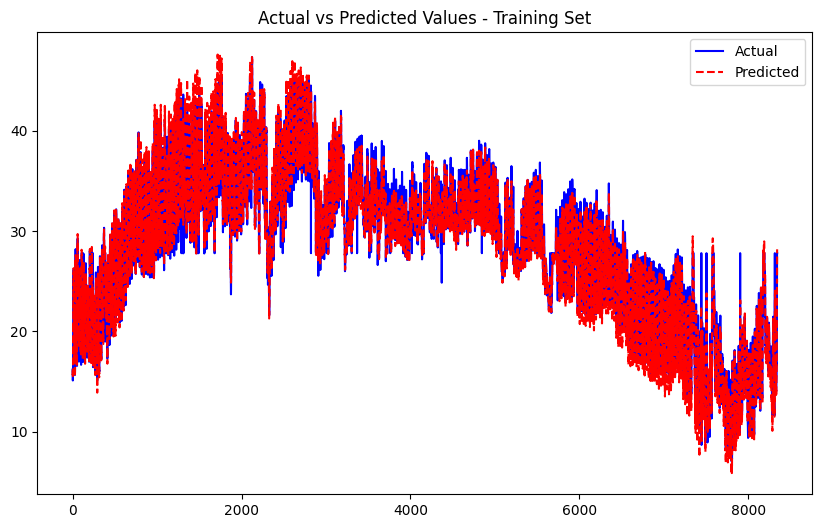

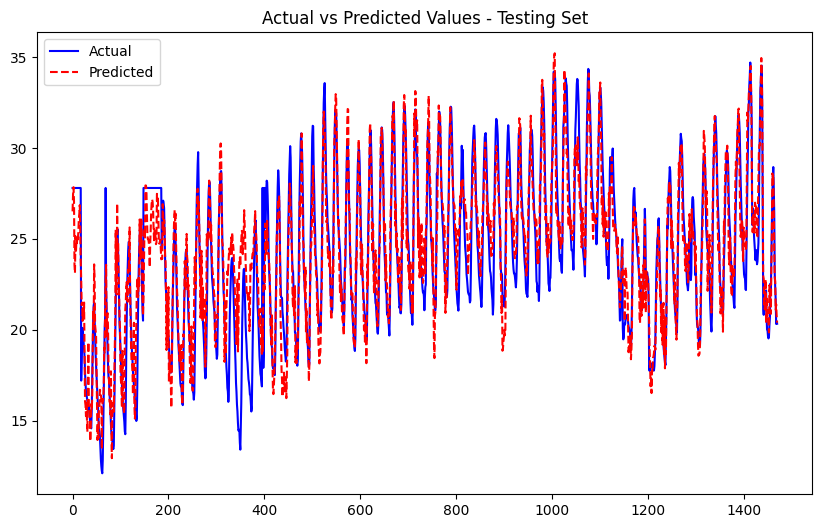

Processing node 6...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0727
Epoch [2/50], Train Loss: 0.0618
Epoch [3/50], Train Loss: 0.0560
Epoch [4/50], Train Loss: 0.0519
Epoch [5/50], Train Loss: 0.0501
Epoch [6/50], Train Loss: 0.0476
Epoch [7/50], Train Loss: 0.0464
Epoch [8/50], Train Loss: 0.0445
Epoch [9/50], Train Loss: 0.0435
Epoch [10/50], Train Loss: 0.0429
Epoch [11/50], Train Loss: 0.0424
Epoch [12/50], Train Loss: 0.0415
Epoch [13/50], Train Loss: 0.0408
Epoch [14/50], Train Loss: 0.0405
Epoch [15/50], Train Loss: 0.0401
Epoch [16/50], Train Loss: 0.0402
Epoch [17/50], Train Loss: 0.0398
Epoch [18/50], Train Loss: 0.0397
Epoch [19/50], Train Loss: 0.0391
Epoch [20/50], Train Loss: 0.0386
Epoch [21/50], Train Loss: 0.0385
Epoch [22/50], Train Loss: 0.0381
Epoch [23/50], Train Loss: 0.0380
Epoch [24/50], Train Loss: 0.0378
Epoch [25/50], Train Loss: 0.0381
Epoch [26/50], Train Loss: 0.0373
Epoch [27/50], Train Loss: 0.0376
Epoch [28/50], Train Loss: 0.0371
Epoch [29/50], Train Loss: 0.0372
Epoch [30/50], Train Lo

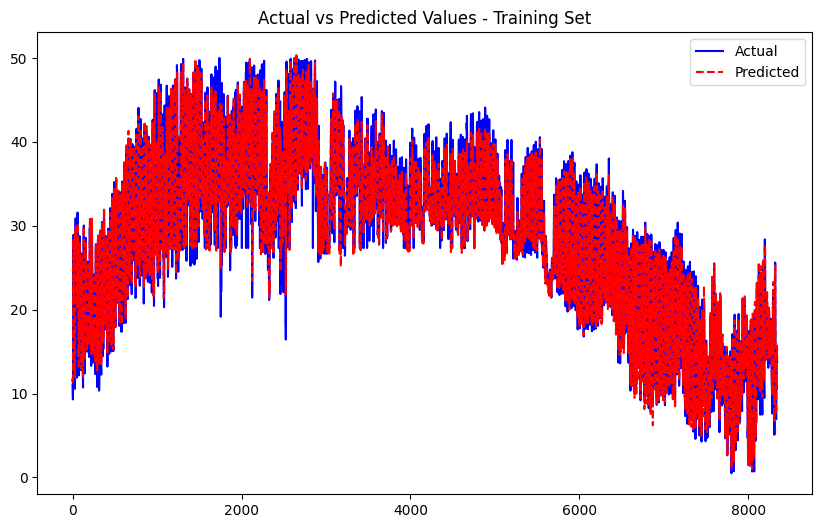

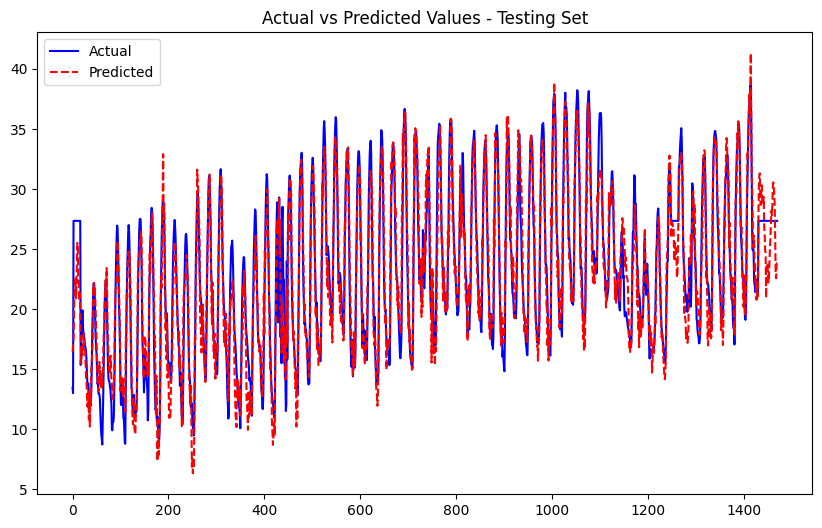

Processing node 7...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0656
Epoch [2/50], Train Loss: 0.0509
Epoch [3/50], Train Loss: 0.0436
Epoch [4/50], Train Loss: 0.0394
Epoch [5/50], Train Loss: 0.0364
Epoch [6/50], Train Loss: 0.0337
Epoch [7/50], Train Loss: 0.0325
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0301
Epoch [10/50], Train Loss: 0.0296
Epoch [11/50], Train Loss: 0.0288
Epoch [12/50], Train Loss: 0.0288
Epoch [13/50], Train Loss: 0.0277
Epoch [14/50], Train Loss: 0.0275
Epoch [15/50], Train Loss: 0.0270
Epoch [16/50], Train Loss: 0.0266
Epoch [17/50], Train Loss: 0.0265
Epoch [18/50], Train Loss: 0.0262
Epoch [19/50], Train Loss: 0.0260
Epoch [20/50], Train Loss: 0.0256
Epoch [21/50], Train Loss: 0.0258
Epoch [22/50], Train Loss: 0.0253
Epoch [23/50], Train Loss: 0.0252
Epoch [24/50], Train Loss: 0.0253
Epoch [25/50], Train Loss: 0.0250
Epoch [26/50], Train Loss: 0.0251
Epoch [27/50], Train Loss: 0.0244
Epoch [28/50], Train Loss: 0.0246
Epoch [29/50], Train Loss: 0.0245
Epoch [30/50], Train Lo

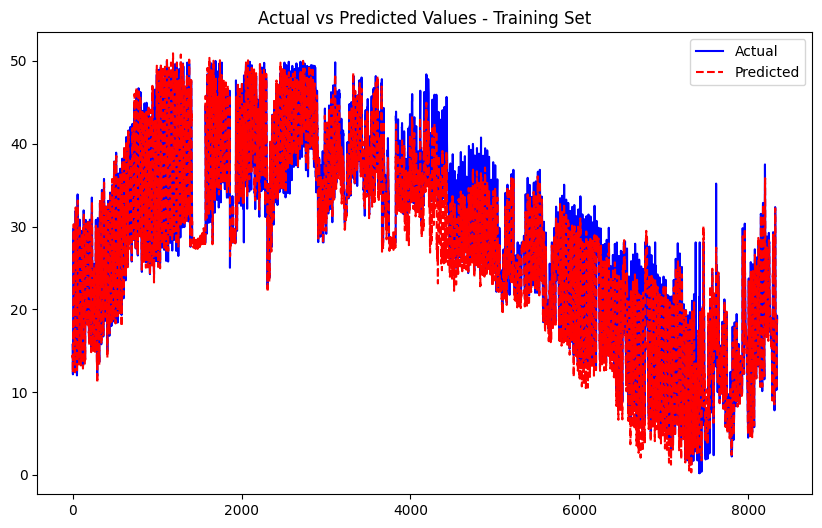

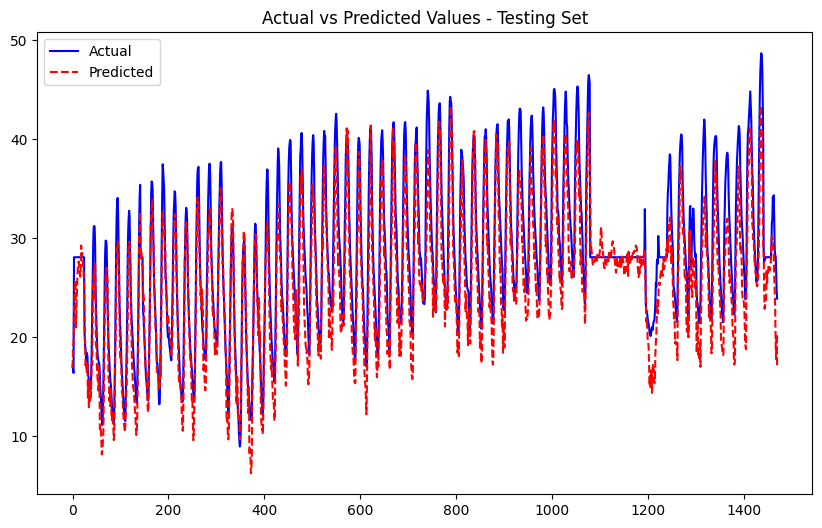

Processing node 8...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0794
Epoch [2/50], Train Loss: 0.0648
Epoch [3/50], Train Loss: 0.0583
Epoch [4/50], Train Loss: 0.0538
Epoch [5/50], Train Loss: 0.0508
Epoch [6/50], Train Loss: 0.0480
Epoch [7/50], Train Loss: 0.0470
Epoch [8/50], Train Loss: 0.0442
Epoch [9/50], Train Loss: 0.0438
Epoch [10/50], Train Loss: 0.0425
Epoch [11/50], Train Loss: 0.0420
Epoch [12/50], Train Loss: 0.0410
Epoch [13/50], Train Loss: 0.0404
Epoch [14/50], Train Loss: 0.0397
Epoch [15/50], Train Loss: 0.0391
Epoch [16/50], Train Loss: 0.0389
Epoch [17/50], Train Loss: 0.0382
Epoch [18/50], Train Loss: 0.0384
Epoch [19/50], Train Loss: 0.0385
Epoch [20/50], Train Loss: 0.0376
Epoch [21/50], Train Loss: 0.0378
Epoch [22/50], Train Loss: 0.0374
Epoch [23/50], Train Loss: 0.0374
Epoch [24/50], Train Loss: 0.0370
Epoch [25/50], Train Loss: 0.0370
Epoch [26/50], Train Loss: 0.0362
Epoch [27/50], Train Loss: 0.0364
Epoch [28/50], Train Loss: 0.0362
Epoch [29/50], Train Loss: 0.0373
Epoch [30/50], Train Lo

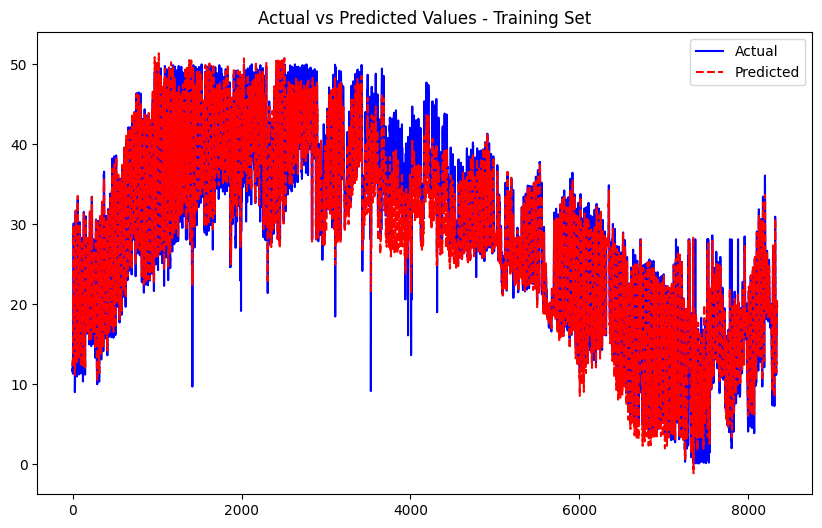

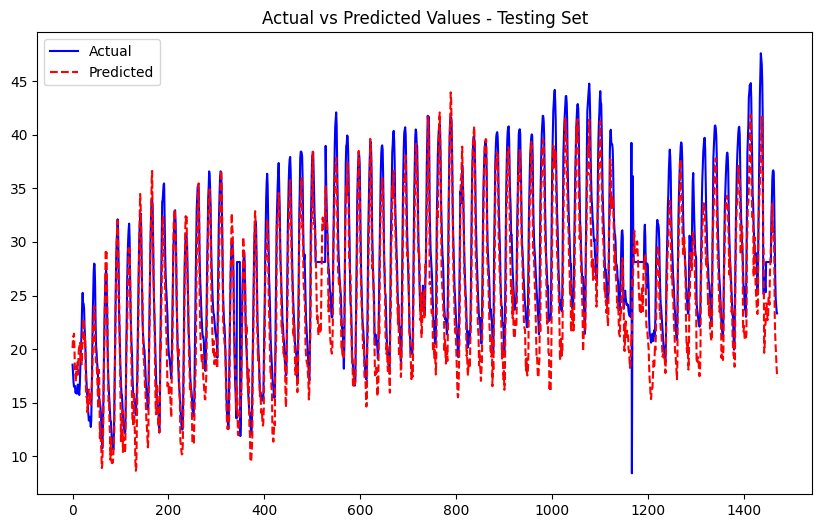

Processing node 9...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0478
Epoch [2/50], Train Loss: 0.0392
Epoch [3/50], Train Loss: 0.0354
Epoch [4/50], Train Loss: 0.0331
Epoch [5/50], Train Loss: 0.0313
Epoch [6/50], Train Loss: 0.0301
Epoch [7/50], Train Loss: 0.0292
Epoch [8/50], Train Loss: 0.0285
Epoch [9/50], Train Loss: 0.0278
Epoch [10/50], Train Loss: 0.0273
Epoch [11/50], Train Loss: 0.0277
Epoch [12/50], Train Loss: 0.0268
Epoch [13/50], Train Loss: 0.0259
Epoch [14/50], Train Loss: 0.0261
Epoch [15/50], Train Loss: 0.0254
Epoch [16/50], Train Loss: 0.0254
Epoch [17/50], Train Loss: 0.0252
Epoch [18/50], Train Loss: 0.0250
Epoch [19/50], Train Loss: 0.0246
Epoch [20/50], Train Loss: 0.0243
Epoch [21/50], Train Loss: 0.0245
Epoch [22/50], Train Loss: 0.0247
Epoch [23/50], Train Loss: 0.0244
Epoch [24/50], Train Loss: 0.0244
Epoch [25/50], Train Loss: 0.0243
Epoch [26/50], Train Loss: 0.0237
Epoch [27/50], Train Loss: 0.0239
Epoch [28/50], Train Loss: 0.0237
Epoch [29/50], Train Loss: 0.0238
Epoch [30/50], Train Lo

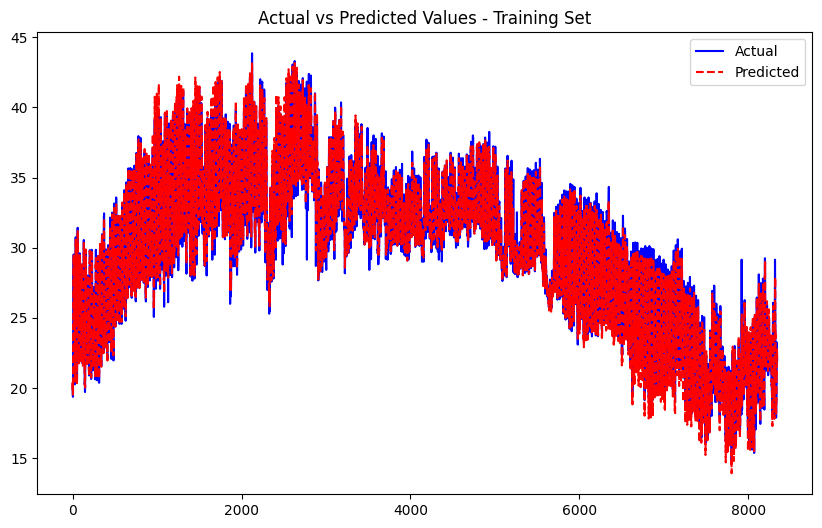

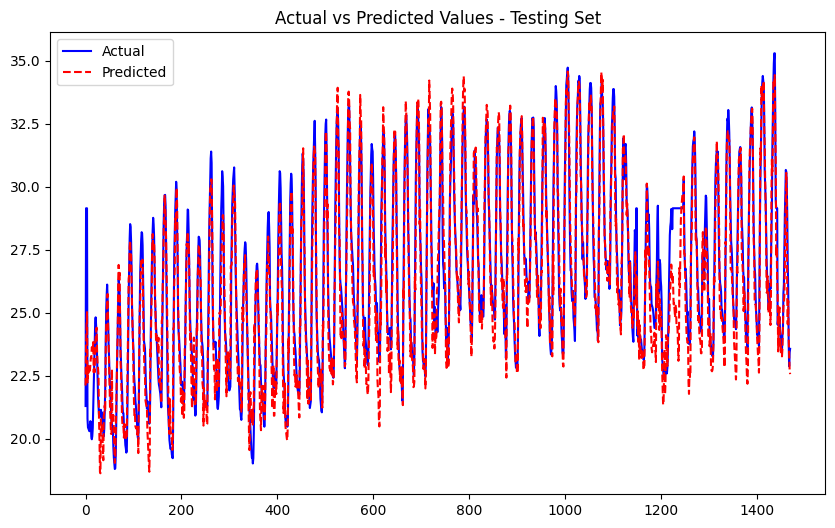

Processing node 10...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2516
Epoch [2/50], Train Loss: 0.2212
Epoch [3/50], Train Loss: 0.1704
Epoch [4/50], Train Loss: 0.1427
Epoch [5/50], Train Loss: 0.1245
Epoch [6/50], Train Loss: 0.1115
Epoch [7/50], Train Loss: 0.0994
Epoch [8/50], Train Loss: 0.0904
Epoch [9/50], Train Loss: 0.0849
Epoch [10/50], Train Loss: 0.0841
Epoch [11/50], Train Loss: 0.0791
Epoch [12/50], Train Loss: 0.0747
Epoch [13/50], Train Loss: 0.0732
Epoch [14/50], Train Loss: 0.0706
Epoch [15/50], Train Loss: 0.0685
Epoch [16/50], Train Loss: 0.0665
Epoch [17/50], Train Loss: 0.0647
Epoch [18/50], Train Loss: 0.0632
Epoch [19/50], Train Loss: 0.0616
Epoch [20/50], Train Loss: 0.0638
Epoch [21/50], Train Loss: 0.0600
Epoch [22/50], Train Loss: 0.0591
Epoch [23/50], Train Loss: 0.0588
Epoch [24/50], Train Loss: 0.0572
Epoch [25/50], Train Loss: 0.0575
Epoch [26/50], Train Loss: 0.0565
Epoch [27/50], Train Loss: 0.0558
Epoch [28/50], Train Loss: 0.0552
Epoch [29/50], Train Loss: 0.0548
Epoch [30/50], Train Lo

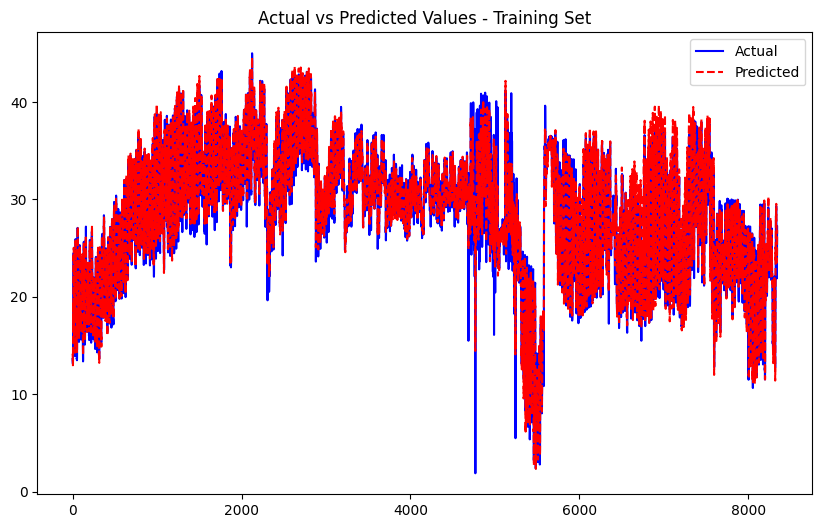

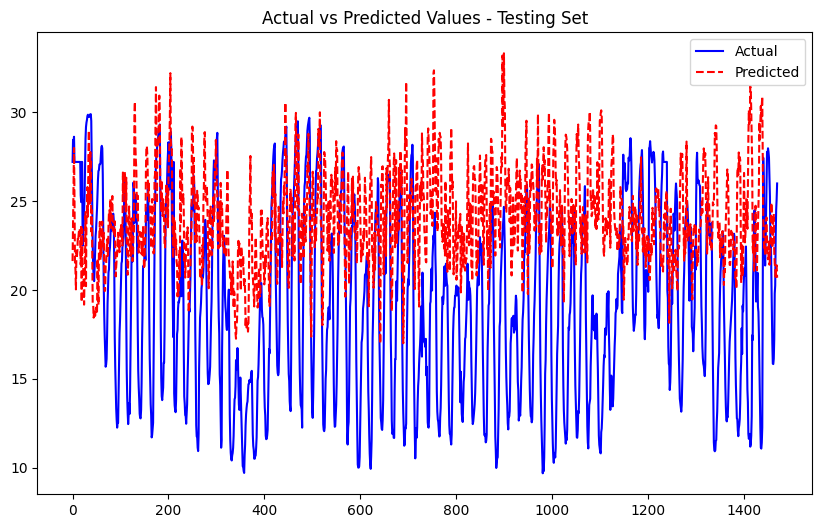

Processing node 11...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0890
Epoch [2/50], Train Loss: 0.0714
Epoch [3/50], Train Loss: 0.0564
Epoch [4/50], Train Loss: 0.0486
Epoch [5/50], Train Loss: 0.0429
Epoch [6/50], Train Loss: 0.0406
Epoch [7/50], Train Loss: 0.0386
Epoch [8/50], Train Loss: 0.0368
Epoch [9/50], Train Loss: 0.0354
Epoch [10/50], Train Loss: 0.0345
Epoch [11/50], Train Loss: 0.0339
Epoch [12/50], Train Loss: 0.0328
Epoch [13/50], Train Loss: 0.0326
Epoch [14/50], Train Loss: 0.0316
Epoch [15/50], Train Loss: 0.0314
Epoch [16/50], Train Loss: 0.0310
Epoch [17/50], Train Loss: 0.0306
Epoch [18/50], Train Loss: 0.0304
Epoch [19/50], Train Loss: 0.0305
Epoch [20/50], Train Loss: 0.0299
Epoch [21/50], Train Loss: 0.0297
Epoch [22/50], Train Loss: 0.0294
Epoch [23/50], Train Loss: 0.0293
Epoch [24/50], Train Loss: 0.0288
Epoch [25/50], Train Loss: 0.0288
Epoch [26/50], Train Loss: 0.0287
Epoch [27/50], Train Loss: 0.0282
Epoch [28/50], Train Loss: 0.0282
Epoch [29/50], Train Loss: 0.0280
Epoch [30/50], Train Lo

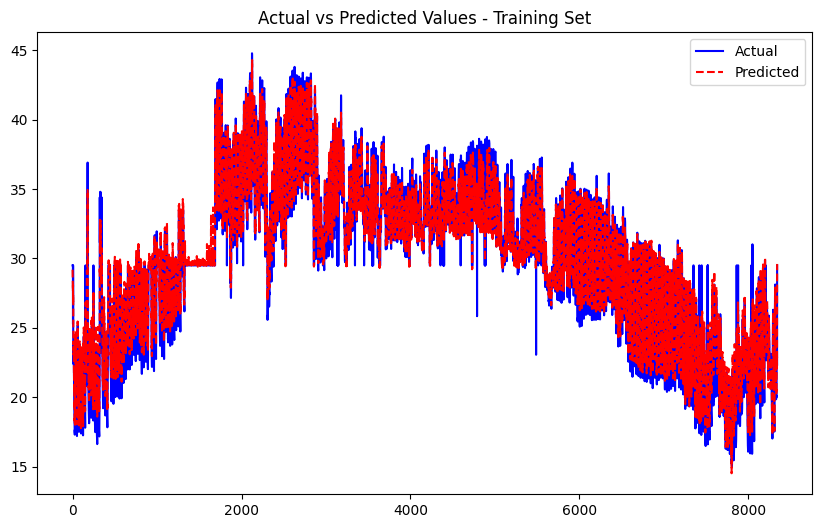

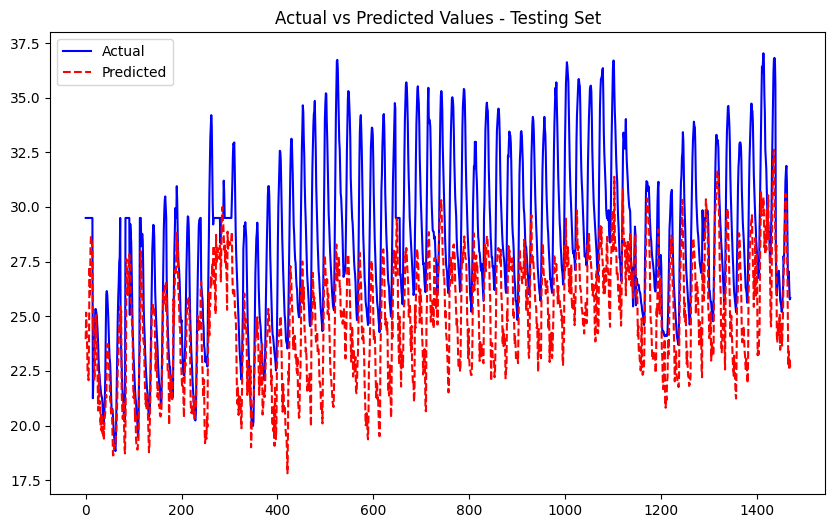

Processing node 12...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0406
Epoch [2/50], Train Loss: 0.0334
Epoch [3/50], Train Loss: 0.0293
Epoch [4/50], Train Loss: 0.0271
Epoch [5/50], Train Loss: 0.0253
Epoch [6/50], Train Loss: 0.0241
Epoch [7/50], Train Loss: 0.0237
Epoch [8/50], Train Loss: 0.0226
Epoch [9/50], Train Loss: 0.0222
Epoch [10/50], Train Loss: 0.0217
Epoch [11/50], Train Loss: 0.0210
Epoch [12/50], Train Loss: 0.0206
Epoch [13/50], Train Loss: 0.0205
Epoch [14/50], Train Loss: 0.0205
Epoch [15/50], Train Loss: 0.0198
Epoch [16/50], Train Loss: 0.0195
Epoch [17/50], Train Loss: 0.0202
Epoch [18/50], Train Loss: 0.0202
Epoch [19/50], Train Loss: 0.0196
Epoch [20/50], Train Loss: 0.0195
Epoch [21/50], Train Loss: 0.0192
Epoch [22/50], Train Loss: 0.0190
Epoch [23/50], Train Loss: 0.0189
Epoch [24/50], Train Loss: 0.0193
Epoch [25/50], Train Loss: 0.0184
Epoch [26/50], Train Loss: 0.0187
Epoch [27/50], Train Loss: 0.0185
Epoch [28/50], Train Loss: 0.0187
Epoch [29/50], Train Loss: 0.0185
Epoch [30/50], Train Lo

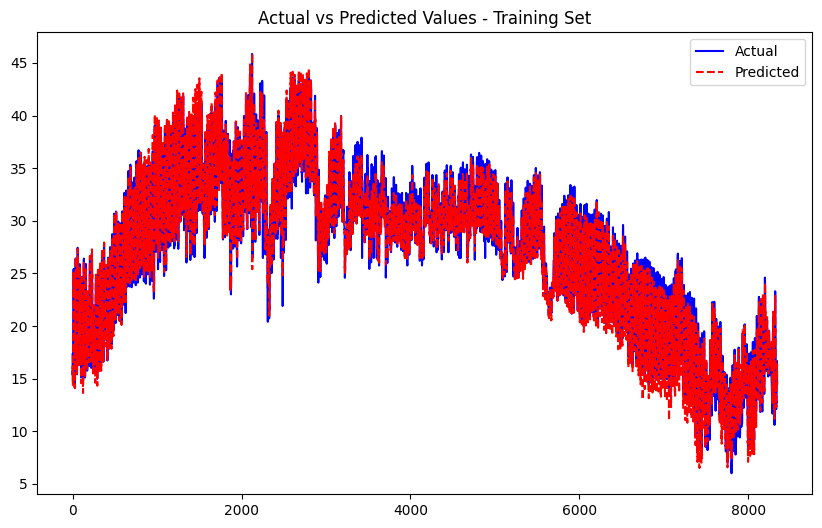

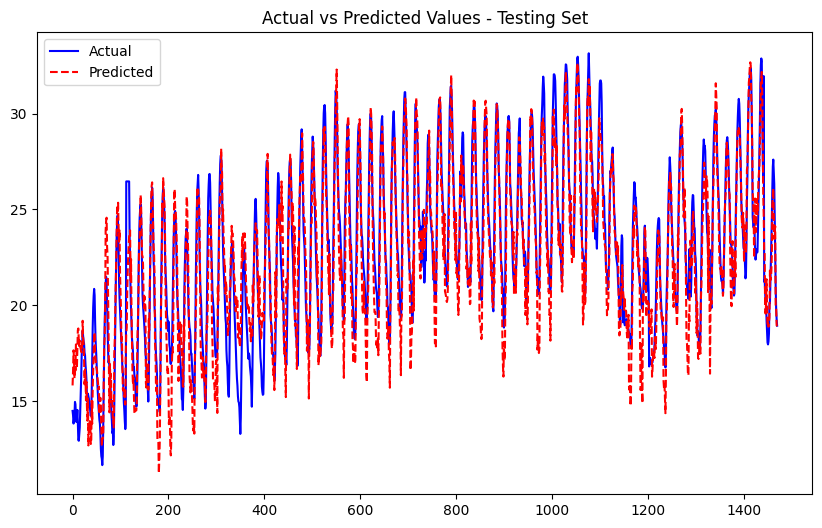

Processing node 13...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1328
Epoch [2/50], Train Loss: 0.1061
Epoch [3/50], Train Loss: 0.0830
Epoch [4/50], Train Loss: 0.0703
Epoch [5/50], Train Loss: 0.0605
Epoch [6/50], Train Loss: 0.0533
Epoch [7/50], Train Loss: 0.0486
Epoch [8/50], Train Loss: 0.0434
Epoch [9/50], Train Loss: 0.0393
Epoch [10/50], Train Loss: 0.0378
Epoch [11/50], Train Loss: 0.0348
Epoch [12/50], Train Loss: 0.0337
Epoch [13/50], Train Loss: 0.0307
Epoch [14/50], Train Loss: 0.0297
Epoch [15/50], Train Loss: 0.0292
Epoch [16/50], Train Loss: 0.0282
Epoch [17/50], Train Loss: 0.0263
Epoch [18/50], Train Loss: 0.0265
Epoch [19/50], Train Loss: 0.0257
Epoch [20/50], Train Loss: 0.0246
Epoch [21/50], Train Loss: 0.0242
Epoch [22/50], Train Loss: 0.0232
Epoch [23/50], Train Loss: 0.0229
Epoch [24/50], Train Loss: 0.0237
Epoch [25/50], Train Loss: 0.0222
Epoch [26/50], Train Loss: 0.0221
Epoch [27/50], Train Loss: 0.0215
Epoch [28/50], Train Loss: 0.0226
Epoch [29/50], Train Loss: 0.0217
Epoch [30/50], Train Lo

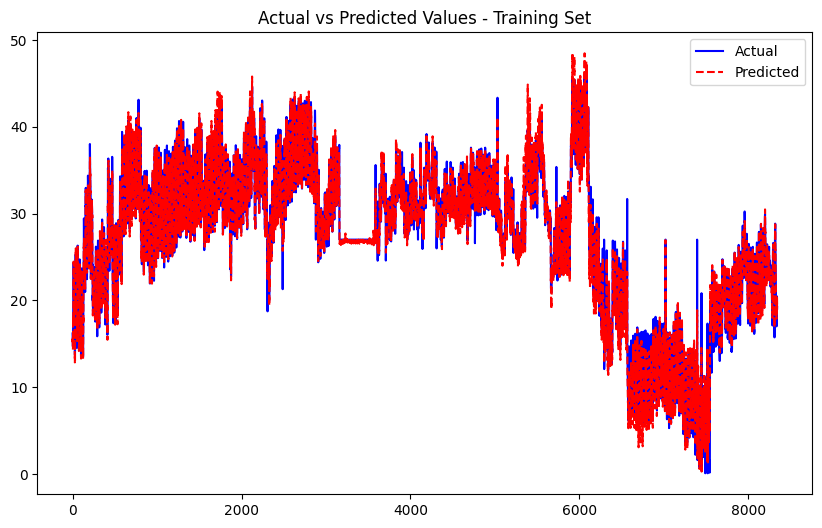

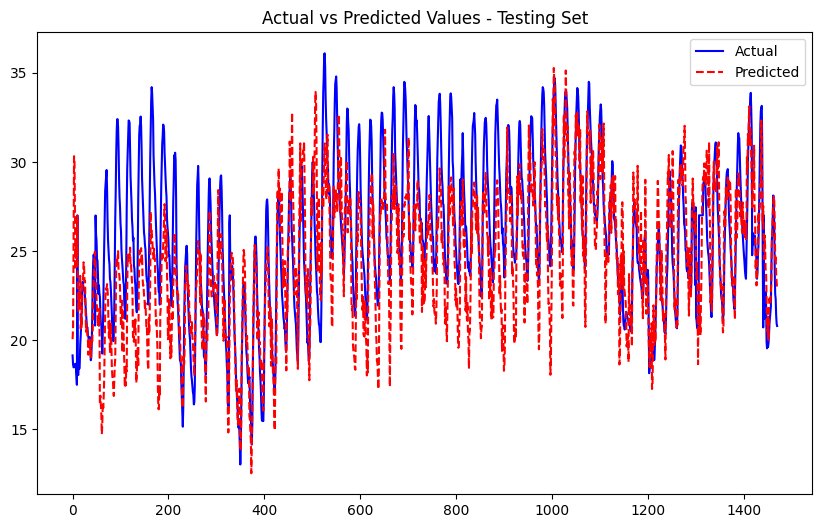

Processing node 14...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0683
Epoch [2/50], Train Loss: 0.0517
Epoch [3/50], Train Loss: 0.0446
Epoch [4/50], Train Loss: 0.0398
Epoch [5/50], Train Loss: 0.0372
Epoch [6/50], Train Loss: 0.0356
Epoch [7/50], Train Loss: 0.0342
Epoch [8/50], Train Loss: 0.0333
Epoch [9/50], Train Loss: 0.0321
Epoch [10/50], Train Loss: 0.0323
Epoch [11/50], Train Loss: 0.0310
Epoch [12/50], Train Loss: 0.0308
Epoch [13/50], Train Loss: 0.0304
Epoch [14/50], Train Loss: 0.0301
Epoch [15/50], Train Loss: 0.0297
Epoch [16/50], Train Loss: 0.0297
Epoch [17/50], Train Loss: 0.0293
Epoch [18/50], Train Loss: 0.0291
Epoch [19/50], Train Loss: 0.0290
Epoch [20/50], Train Loss: 0.0292
Epoch [21/50], Train Loss: 0.0289
Epoch [22/50], Train Loss: 0.0285
Epoch [23/50], Train Loss: 0.0281
Epoch [24/50], Train Loss: 0.0283
Epoch [25/50], Train Loss: 0.0280
Epoch [26/50], Train Loss: 0.0281
Epoch [27/50], Train Loss: 0.0278
Epoch [28/50], Train Loss: 0.0278
Epoch [29/50], Train Loss: 0.0278
Epoch [30/50], Train Lo

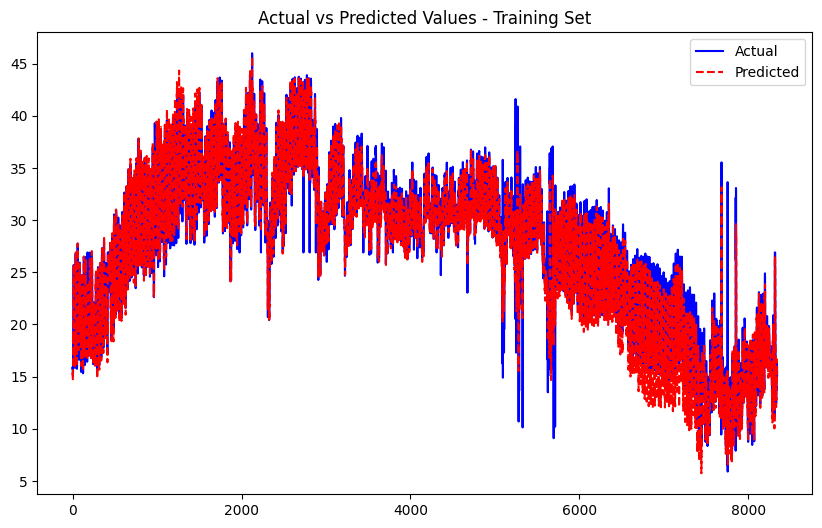

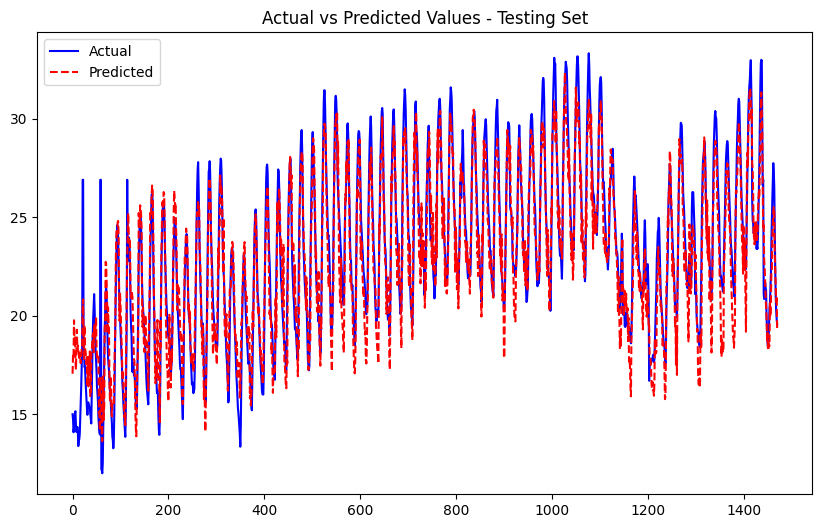

Processing node 15...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1380
Epoch [2/50], Train Loss: 0.1080
Epoch [3/50], Train Loss: 0.0903
Epoch [4/50], Train Loss: 0.0803
Epoch [5/50], Train Loss: 0.0750
Epoch [6/50], Train Loss: 0.0692
Epoch [7/50], Train Loss: 0.0662
Epoch [8/50], Train Loss: 0.0642
Epoch [9/50], Train Loss: 0.0633
Epoch [10/50], Train Loss: 0.0615
Epoch [11/50], Train Loss: 0.0605
Epoch [12/50], Train Loss: 0.0598
Epoch [13/50], Train Loss: 0.0586
Epoch [14/50], Train Loss: 0.0579
Epoch [15/50], Train Loss: 0.0576
Epoch [16/50], Train Loss: 0.0573
Epoch [17/50], Train Loss: 0.0568
Epoch [18/50], Train Loss: 0.0567
Epoch [19/50], Train Loss: 0.0566
Epoch [20/50], Train Loss: 0.0559
Epoch [21/50], Train Loss: 0.0557
Epoch [22/50], Train Loss: 0.0552
Epoch [23/50], Train Loss: 0.0553
Epoch [24/50], Train Loss: 0.0546
Epoch [25/50], Train Loss: 0.0547
Epoch [26/50], Train Loss: 0.0545
Epoch [27/50], Train Loss: 0.0548
Epoch [28/50], Train Loss: 0.0542
Epoch [29/50], Train Loss: 0.0539
Epoch [30/50], Train Lo

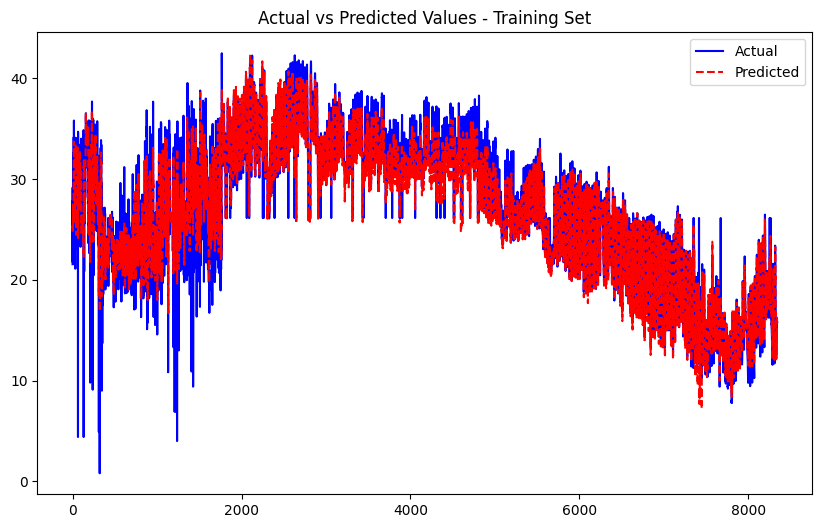

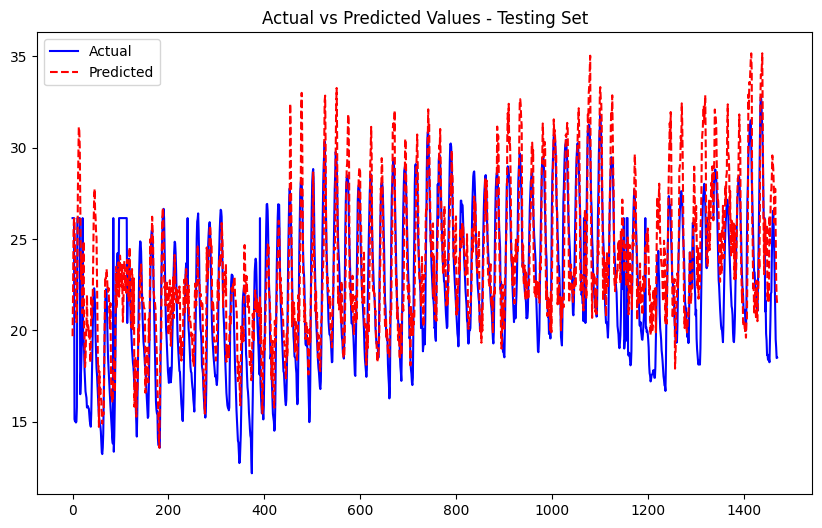

Processing node 16...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1538
Epoch [2/50], Train Loss: 0.1282
Epoch [3/50], Train Loss: 0.1108
Epoch [4/50], Train Loss: 0.0976
Epoch [5/50], Train Loss: 0.0857
Epoch [6/50], Train Loss: 0.0757
Epoch [7/50], Train Loss: 0.0708
Epoch [8/50], Train Loss: 0.0637
Epoch [9/50], Train Loss: 0.0587
Epoch [10/50], Train Loss: 0.0507
Epoch [11/50], Train Loss: 0.0480
Epoch [12/50], Train Loss: 0.0466
Epoch [13/50], Train Loss: 0.0443
Epoch [14/50], Train Loss: 0.0432
Epoch [15/50], Train Loss: 0.0394
Epoch [16/50], Train Loss: 0.0392
Epoch [17/50], Train Loss: 0.0377
Epoch [18/50], Train Loss: 0.0376
Epoch [19/50], Train Loss: 0.0343
Epoch [20/50], Train Loss: 0.0363
Epoch [21/50], Train Loss: 0.0333
Epoch [22/50], Train Loss: 0.0328
Epoch [23/50], Train Loss: 0.0313
Epoch [24/50], Train Loss: 0.0314
Epoch [25/50], Train Loss: 0.0304
Epoch [26/50], Train Loss: 0.0314
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0297
Epoch [29/50], Train Loss: 0.0298
Epoch [30/50], Train Lo

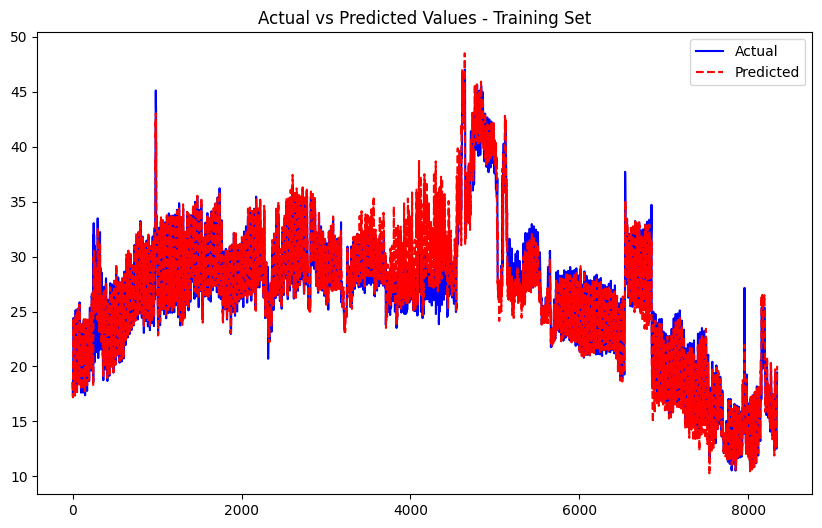

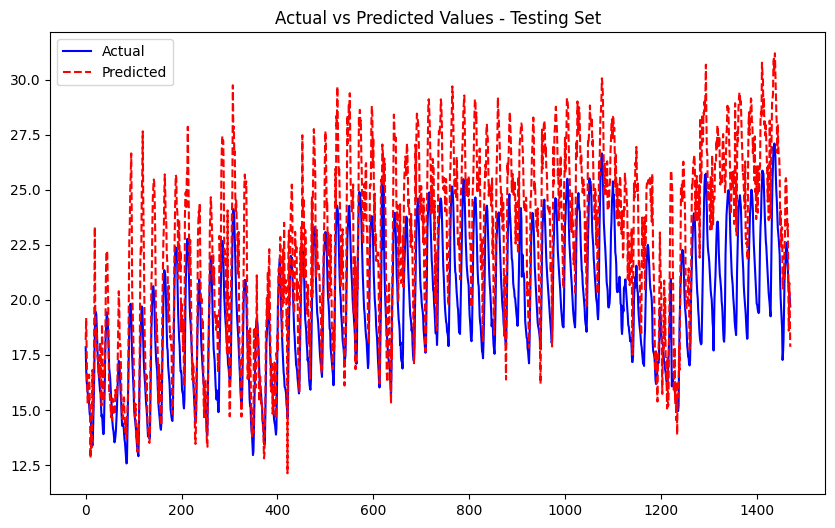

Processing node 17...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0816
Epoch [2/50], Train Loss: 0.0552
Epoch [3/50], Train Loss: 0.0447
Epoch [4/50], Train Loss: 0.0382
Epoch [5/50], Train Loss: 0.0350
Epoch [6/50], Train Loss: 0.0319
Epoch [7/50], Train Loss: 0.0307
Epoch [8/50], Train Loss: 0.0287
Epoch [9/50], Train Loss: 0.0277
Epoch [10/50], Train Loss: 0.0273
Epoch [11/50], Train Loss: 0.0263
Epoch [12/50], Train Loss: 0.0266
Epoch [13/50], Train Loss: 0.0257
Epoch [14/50], Train Loss: 0.0252
Epoch [15/50], Train Loss: 0.0242
Epoch [16/50], Train Loss: 0.0241
Epoch [17/50], Train Loss: 0.0244
Epoch [18/50], Train Loss: 0.0238
Epoch [19/50], Train Loss: 0.0235
Epoch [20/50], Train Loss: 0.0234
Epoch [21/50], Train Loss: 0.0231
Epoch [22/50], Train Loss: 0.0231
Epoch [23/50], Train Loss: 0.0226
Epoch [24/50], Train Loss: 0.0226
Epoch [25/50], Train Loss: 0.0227
Epoch [26/50], Train Loss: 0.0224
Epoch [27/50], Train Loss: 0.0220
Epoch [28/50], Train Loss: 0.0222
Epoch [29/50], Train Loss: 0.0222
Epoch [30/50], Train Lo

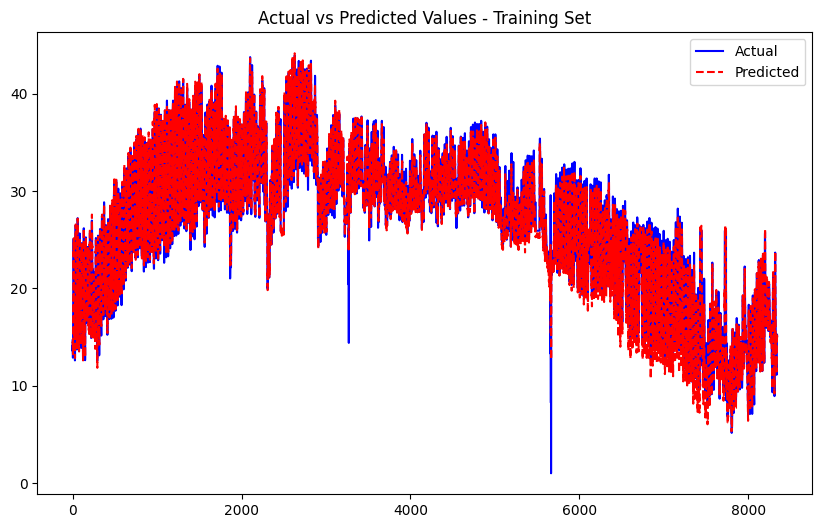

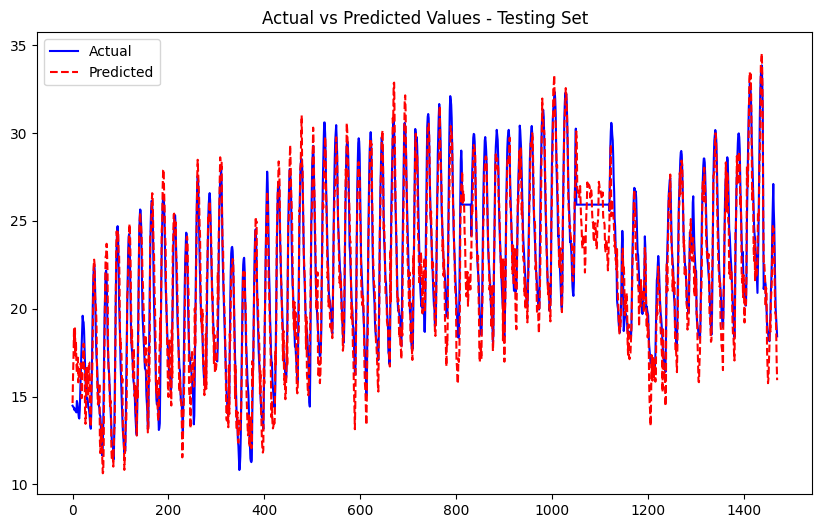

Processing node 18...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0499
Epoch [2/50], Train Loss: 0.0401
Epoch [3/50], Train Loss: 0.0358
Epoch [4/50], Train Loss: 0.0329
Epoch [5/50], Train Loss: 0.0312
Epoch [6/50], Train Loss: 0.0295
Epoch [7/50], Train Loss: 0.0283
Epoch [8/50], Train Loss: 0.0273
Epoch [9/50], Train Loss: 0.0272
Epoch [10/50], Train Loss: 0.0263
Epoch [11/50], Train Loss: 0.0260
Epoch [12/50], Train Loss: 0.0254
Epoch [13/50], Train Loss: 0.0252
Epoch [14/50], Train Loss: 0.0246
Epoch [15/50], Train Loss: 0.0242
Epoch [16/50], Train Loss: 0.0240
Epoch [17/50], Train Loss: 0.0242
Epoch [18/50], Train Loss: 0.0238
Epoch [19/50], Train Loss: 0.0240
Epoch [20/50], Train Loss: 0.0237
Epoch [21/50], Train Loss: 0.0234
Epoch [22/50], Train Loss: 0.0233
Epoch [23/50], Train Loss: 0.0237
Epoch [24/50], Train Loss: 0.0230
Epoch [25/50], Train Loss: 0.0231
Epoch [26/50], Train Loss: 0.0227
Epoch [27/50], Train Loss: 0.0228
Epoch [28/50], Train Loss: 0.0228
Epoch [29/50], Train Loss: 0.0227
Epoch [30/50], Train Lo

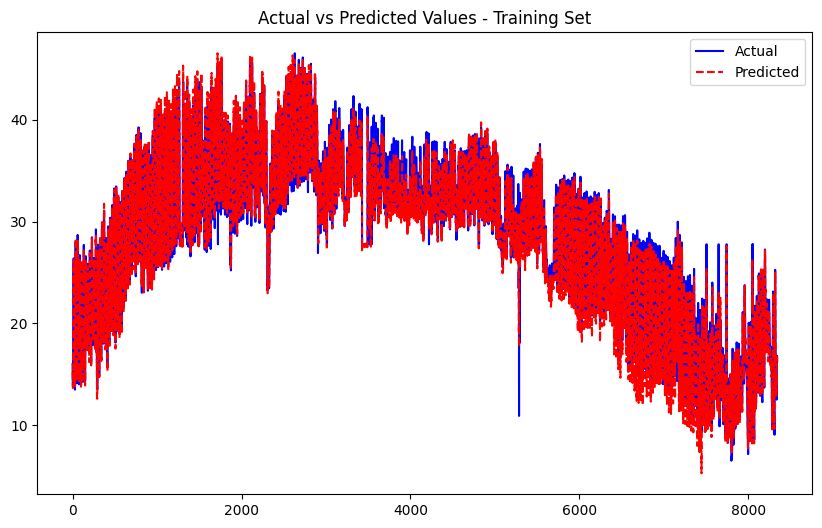

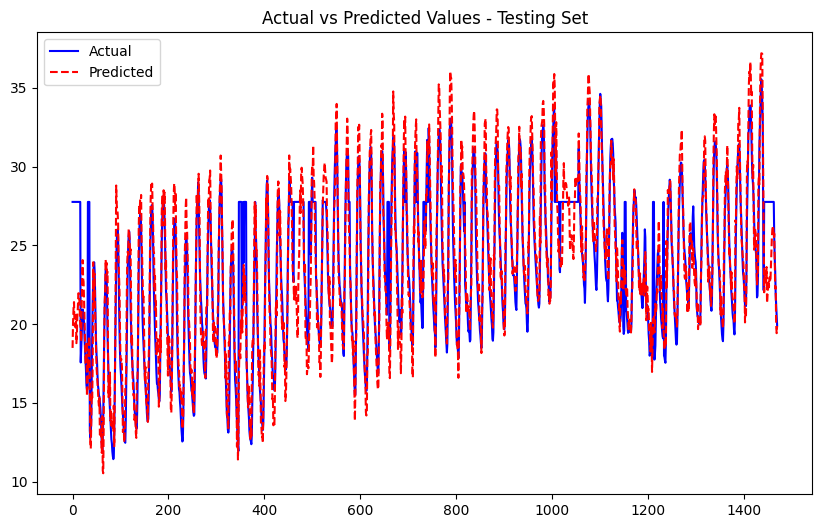

Processing node 19...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0695
Epoch [2/50], Train Loss: 0.0567
Epoch [3/50], Train Loss: 0.0510
Epoch [4/50], Train Loss: 0.0480
Epoch [5/50], Train Loss: 0.0455
Epoch [6/50], Train Loss: 0.0432
Epoch [7/50], Train Loss: 0.0420
Epoch [8/50], Train Loss: 0.0408
Epoch [9/50], Train Loss: 0.0398
Epoch [10/50], Train Loss: 0.0395
Epoch [11/50], Train Loss: 0.0386
Epoch [12/50], Train Loss: 0.0385
Epoch [13/50], Train Loss: 0.0378
Epoch [14/50], Train Loss: 0.0380
Epoch [15/50], Train Loss: 0.0372
Epoch [16/50], Train Loss: 0.0369
Epoch [17/50], Train Loss: 0.0367
Epoch [18/50], Train Loss: 0.0365
Epoch [19/50], Train Loss: 0.0362
Epoch [20/50], Train Loss: 0.0368
Epoch [21/50], Train Loss: 0.0361
Epoch [22/50], Train Loss: 0.0356
Epoch [23/50], Train Loss: 0.0359
Epoch [24/50], Train Loss: 0.0357
Epoch [25/50], Train Loss: 0.0357
Epoch [26/50], Train Loss: 0.0352
Epoch [27/50], Train Loss: 0.0354
Epoch [28/50], Train Loss: 0.0351
Epoch [29/50], Train Loss: 0.0352
Epoch [30/50], Train Lo

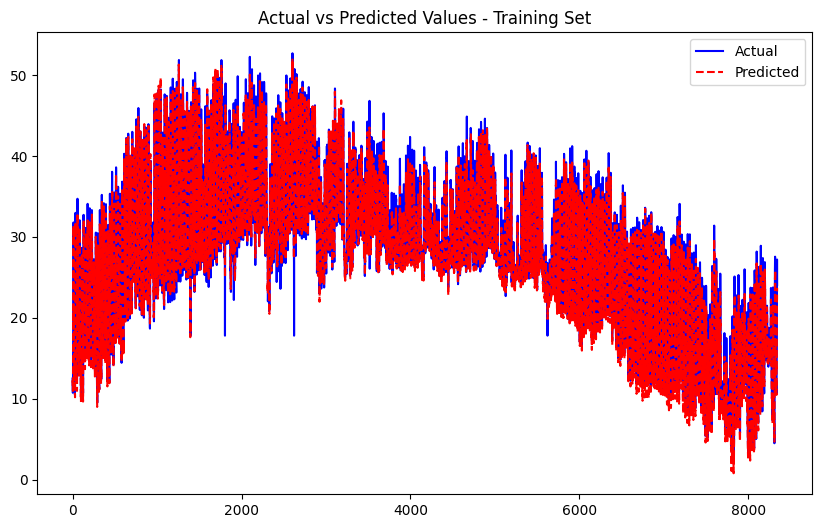

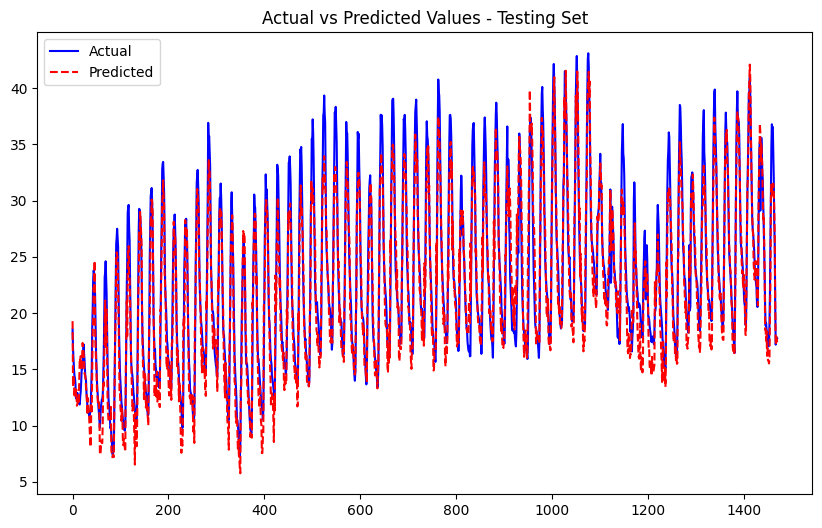

Processing node 20...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0631
Epoch [2/50], Train Loss: 0.0486
Epoch [3/50], Train Loss: 0.0422
Epoch [4/50], Train Loss: 0.0387
Epoch [5/50], Train Loss: 0.0360
Epoch [6/50], Train Loss: 0.0345
Epoch [7/50], Train Loss: 0.0330
Epoch [8/50], Train Loss: 0.0324
Epoch [9/50], Train Loss: 0.0313
Epoch [10/50], Train Loss: 0.0305
Epoch [11/50], Train Loss: 0.0301
Epoch [12/50], Train Loss: 0.0299
Epoch [13/50], Train Loss: 0.0291
Epoch [14/50], Train Loss: 0.0291
Epoch [15/50], Train Loss: 0.0288
Epoch [16/50], Train Loss: 0.0285
Epoch [17/50], Train Loss: 0.0286
Epoch [18/50], Train Loss: 0.0284
Epoch [19/50], Train Loss: 0.0281
Epoch [20/50], Train Loss: 0.0281
Epoch [21/50], Train Loss: 0.0282
Epoch [22/50], Train Loss: 0.0278
Epoch [23/50], Train Loss: 0.0279
Epoch [24/50], Train Loss: 0.0274
Epoch [25/50], Train Loss: 0.0271
Epoch [26/50], Train Loss: 0.0275
Epoch [27/50], Train Loss: 0.0270
Epoch [28/50], Train Loss: 0.0272
Epoch [29/50], Train Loss: 0.0269
Epoch [30/50], Train Lo

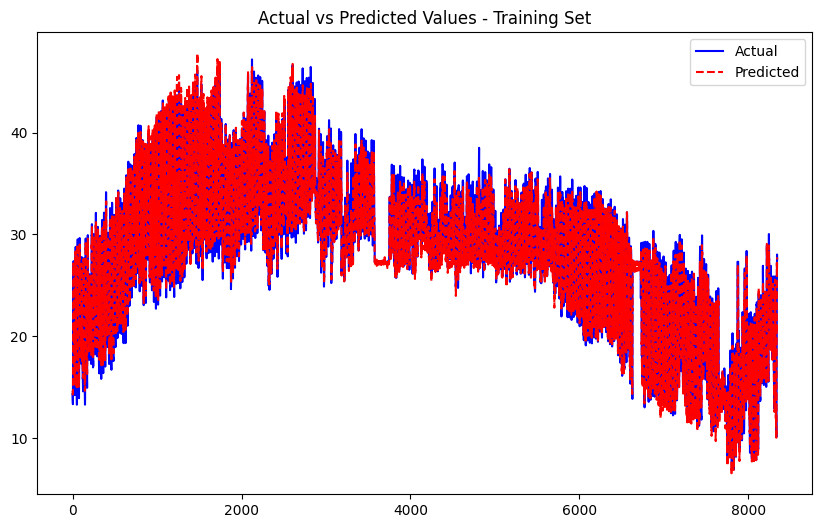

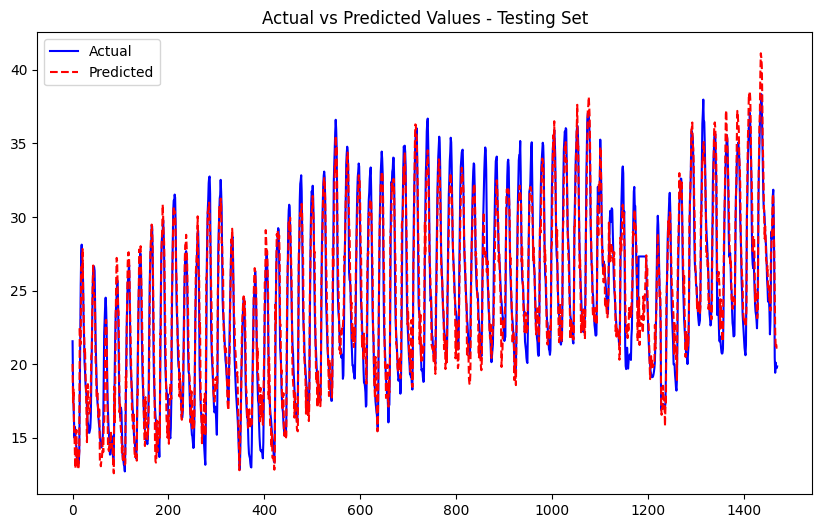

Processing node 21...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0475
Epoch [2/50], Train Loss: 0.0402
Epoch [3/50], Train Loss: 0.0367
Epoch [4/50], Train Loss: 0.0350
Epoch [5/50], Train Loss: 0.0337
Epoch [6/50], Train Loss: 0.0320
Epoch [7/50], Train Loss: 0.0314
Epoch [8/50], Train Loss: 0.0308
Epoch [9/50], Train Loss: 0.0304
Epoch [10/50], Train Loss: 0.0297
Epoch [11/50], Train Loss: 0.0293
Epoch [12/50], Train Loss: 0.0292
Epoch [13/50], Train Loss: 0.0287
Epoch [14/50], Train Loss: 0.0285
Epoch [15/50], Train Loss: 0.0284
Epoch [16/50], Train Loss: 0.0282
Epoch [17/50], Train Loss: 0.0280
Epoch [18/50], Train Loss: 0.0277
Epoch [19/50], Train Loss: 0.0281
Epoch [20/50], Train Loss: 0.0275
Epoch [21/50], Train Loss: 0.0276
Epoch [22/50], Train Loss: 0.0274
Epoch [23/50], Train Loss: 0.0274
Epoch [24/50], Train Loss: 0.0271
Epoch [25/50], Train Loss: 0.0271
Epoch [26/50], Train Loss: 0.0270
Epoch [27/50], Train Loss: 0.0271
Epoch [28/50], Train Loss: 0.0271
Epoch [29/50], Train Loss: 0.0269
Epoch [30/50], Train Lo

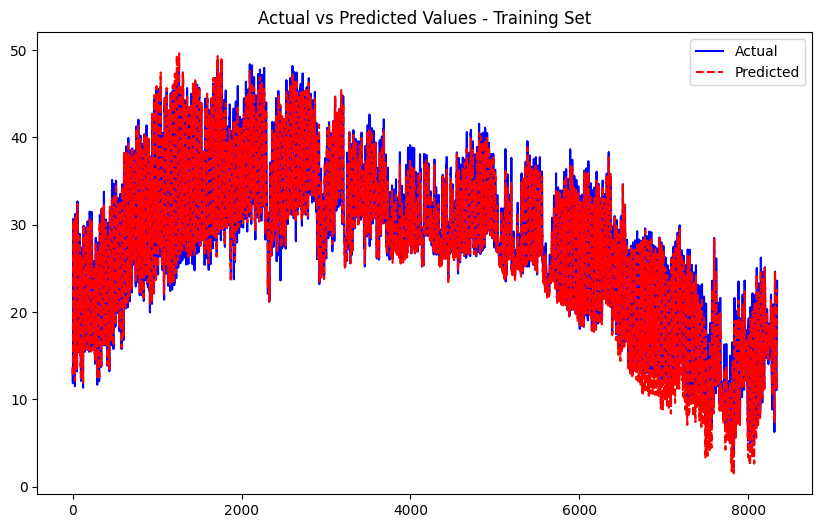

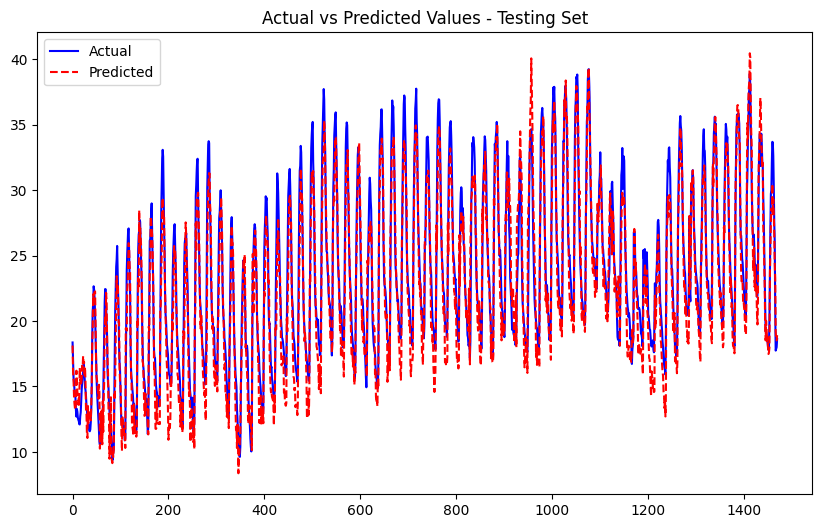

Processing node 22...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0592
Epoch [2/50], Train Loss: 0.0505
Epoch [3/50], Train Loss: 0.0459
Epoch [4/50], Train Loss: 0.0428
Epoch [5/50], Train Loss: 0.0409
Epoch [6/50], Train Loss: 0.0397
Epoch [7/50], Train Loss: 0.0383
Epoch [8/50], Train Loss: 0.0378
Epoch [9/50], Train Loss: 0.0369
Epoch [10/50], Train Loss: 0.0366
Epoch [11/50], Train Loss: 0.0359
Epoch [12/50], Train Loss: 0.0353
Epoch [13/50], Train Loss: 0.0353
Epoch [14/50], Train Loss: 0.0349
Epoch [15/50], Train Loss: 0.0349
Epoch [16/50], Train Loss: 0.0345
Epoch [17/50], Train Loss: 0.0341
Epoch [18/50], Train Loss: 0.0340
Epoch [19/50], Train Loss: 0.0340
Epoch [20/50], Train Loss: 0.0339
Epoch [21/50], Train Loss: 0.0333
Epoch [22/50], Train Loss: 0.0336
Epoch [23/50], Train Loss: 0.0333
Epoch [24/50], Train Loss: 0.0335
Epoch [25/50], Train Loss: 0.0333
Epoch [26/50], Train Loss: 0.0334
Epoch [27/50], Train Loss: 0.0330
Epoch [28/50], Train Loss: 0.0333
Epoch [29/50], Train Loss: 0.0333
Epoch [30/50], Train Lo

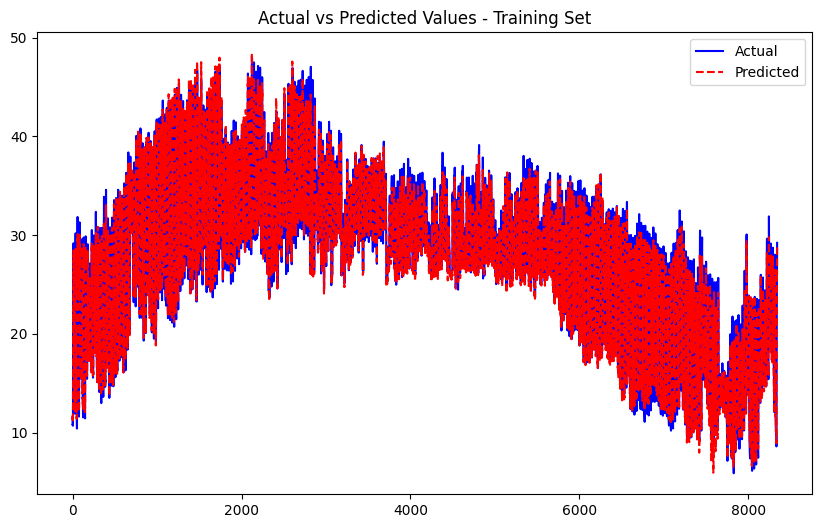

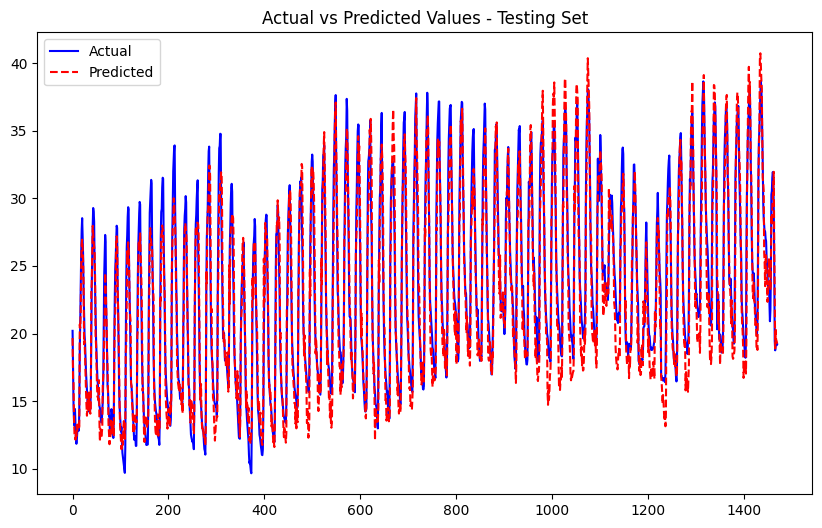

Processing node 23...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0605
Epoch [2/50], Train Loss: 0.0517
Epoch [3/50], Train Loss: 0.0464
Epoch [4/50], Train Loss: 0.0436
Epoch [5/50], Train Loss: 0.0408
Epoch [6/50], Train Loss: 0.0383
Epoch [7/50], Train Loss: 0.0369
Epoch [8/50], Train Loss: 0.0358
Epoch [9/50], Train Loss: 0.0343
Epoch [10/50], Train Loss: 0.0340
Epoch [11/50], Train Loss: 0.0329
Epoch [12/50], Train Loss: 0.0322
Epoch [13/50], Train Loss: 0.0316
Epoch [14/50], Train Loss: 0.0313
Epoch [15/50], Train Loss: 0.0311
Epoch [16/50], Train Loss: 0.0304
Epoch [17/50], Train Loss: 0.0304
Epoch [18/50], Train Loss: 0.0301
Epoch [19/50], Train Loss: 0.0294
Epoch [20/50], Train Loss: 0.0291
Epoch [21/50], Train Loss: 0.0296
Epoch [22/50], Train Loss: 0.0291
Epoch [23/50], Train Loss: 0.0289
Epoch [24/50], Train Loss: 0.0287
Epoch [25/50], Train Loss: 0.0285
Epoch [26/50], Train Loss: 0.0285
Epoch [27/50], Train Loss: 0.0282
Epoch [28/50], Train Loss: 0.0282
Epoch [29/50], Train Loss: 0.0281
Epoch [30/50], Train Lo

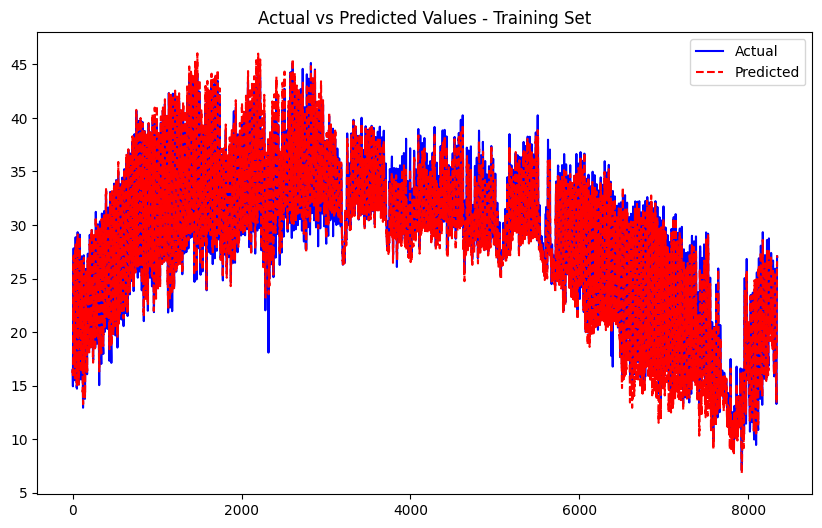

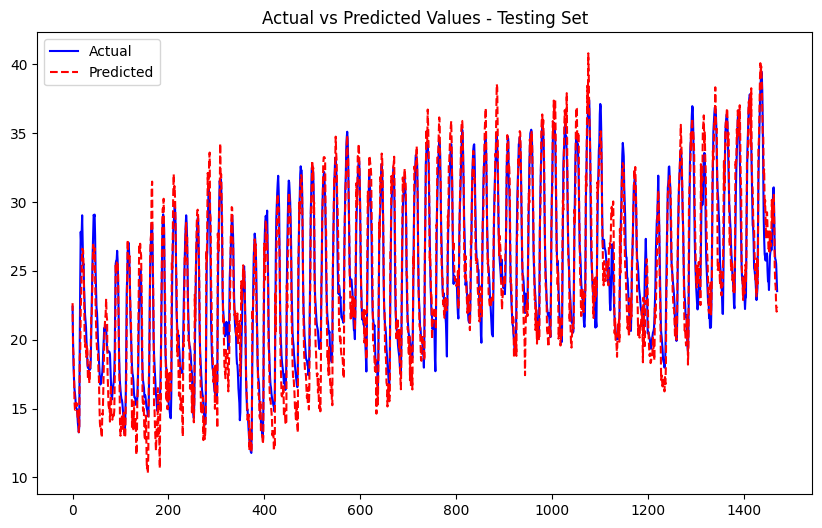

Processing node 24...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0503
Epoch [2/50], Train Loss: 0.0417
Epoch [3/50], Train Loss: 0.0377
Epoch [4/50], Train Loss: 0.0357
Epoch [5/50], Train Loss: 0.0336
Epoch [6/50], Train Loss: 0.0322
Epoch [7/50], Train Loss: 0.0310
Epoch [8/50], Train Loss: 0.0300
Epoch [9/50], Train Loss: 0.0294
Epoch [10/50], Train Loss: 0.0290
Epoch [11/50], Train Loss: 0.0288
Epoch [12/50], Train Loss: 0.0284
Epoch [13/50], Train Loss: 0.0279
Epoch [14/50], Train Loss: 0.0275
Epoch [15/50], Train Loss: 0.0272
Epoch [16/50], Train Loss: 0.0270
Epoch [17/50], Train Loss: 0.0265
Epoch [18/50], Train Loss: 0.0266
Epoch [19/50], Train Loss: 0.0267
Epoch [20/50], Train Loss: 0.0265
Epoch [21/50], Train Loss: 0.0262
Epoch [22/50], Train Loss: 0.0262
Epoch [23/50], Train Loss: 0.0259
Epoch [24/50], Train Loss: 0.0261
Epoch [25/50], Train Loss: 0.0258
Epoch [26/50], Train Loss: 0.0257
Epoch [27/50], Train Loss: 0.0257
Epoch [28/50], Train Loss: 0.0255
Epoch [29/50], Train Loss: 0.0253
Epoch [30/50], Train Lo

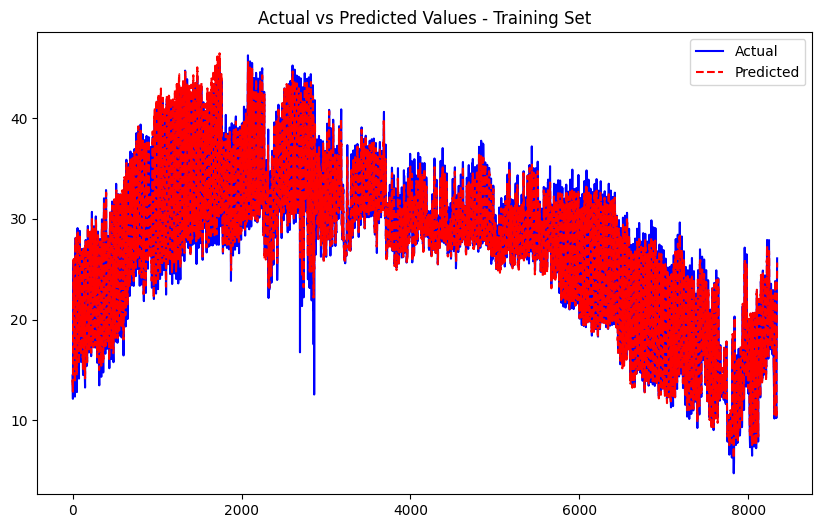

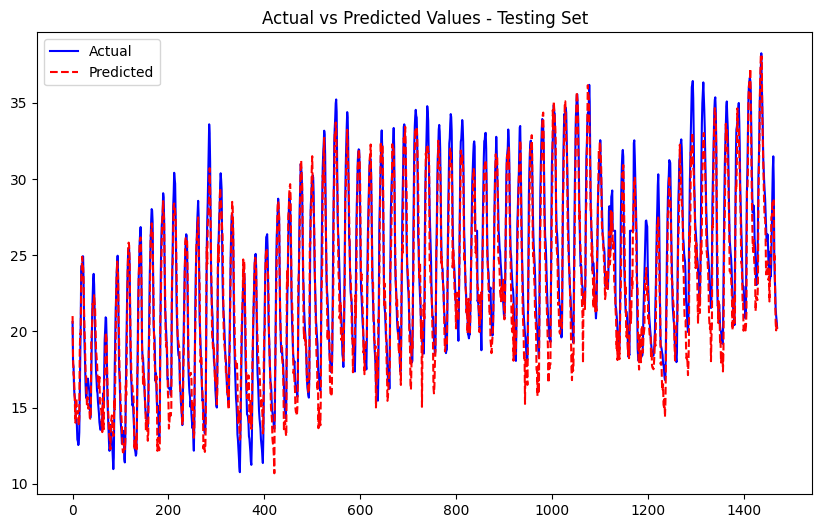

Processing node 25...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0449
Epoch [2/50], Train Loss: 0.0409
Epoch [3/50], Train Loss: 0.0354
Epoch [4/50], Train Loss: 0.0326
Epoch [5/50], Train Loss: 0.0305
Epoch [6/50], Train Loss: 0.0288
Epoch [7/50], Train Loss: 0.0283
Epoch [8/50], Train Loss: 0.0276
Epoch [9/50], Train Loss: 0.0270
Epoch [10/50], Train Loss: 0.0262
Epoch [11/50], Train Loss: 0.0259
Epoch [12/50], Train Loss: 0.0255
Epoch [13/50], Train Loss: 0.0251
Epoch [14/50], Train Loss: 0.0246
Epoch [15/50], Train Loss: 0.0244
Epoch [16/50], Train Loss: 0.0240
Epoch [17/50], Train Loss: 0.0241
Epoch [18/50], Train Loss: 0.0237
Epoch [19/50], Train Loss: 0.0234
Epoch [20/50], Train Loss: 0.0237
Epoch [21/50], Train Loss: 0.0231
Epoch [22/50], Train Loss: 0.0232
Epoch [23/50], Train Loss: 0.0229
Epoch [24/50], Train Loss: 0.0229
Epoch [25/50], Train Loss: 0.0228
Epoch [26/50], Train Loss: 0.0229
Epoch [27/50], Train Loss: 0.0226
Epoch [28/50], Train Loss: 0.0228
Epoch [29/50], Train Loss: 0.0228
Epoch [30/50], Train Lo

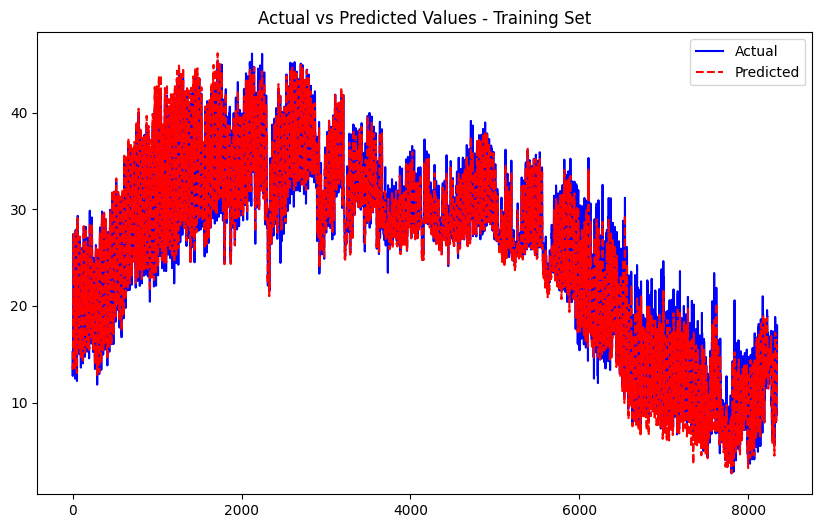

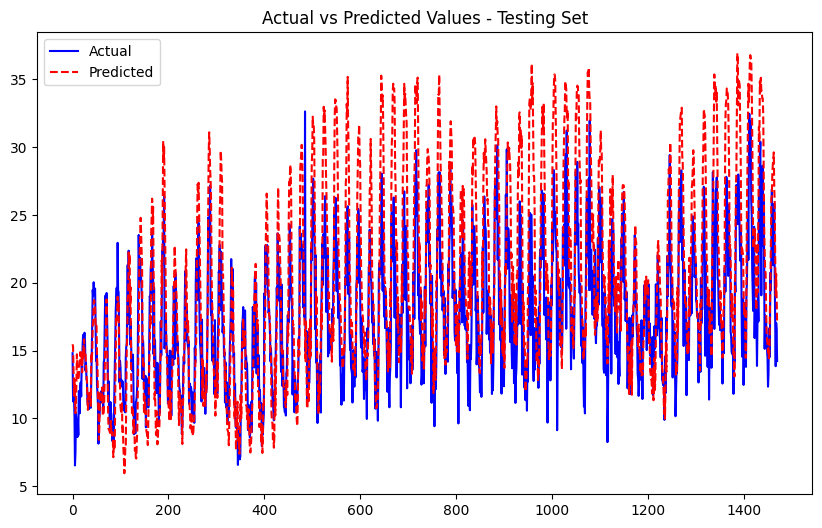

Processing node 26...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0525
Epoch [2/50], Train Loss: 0.0421
Epoch [3/50], Train Loss: 0.0373
Epoch [4/50], Train Loss: 0.0344
Epoch [5/50], Train Loss: 0.0326
Epoch [6/50], Train Loss: 0.0308
Epoch [7/50], Train Loss: 0.0298
Epoch [8/50], Train Loss: 0.0287
Epoch [9/50], Train Loss: 0.0283
Epoch [10/50], Train Loss: 0.0277
Epoch [11/50], Train Loss: 0.0273
Epoch [12/50], Train Loss: 0.0269
Epoch [13/50], Train Loss: 0.0267
Epoch [14/50], Train Loss: 0.0265
Epoch [15/50], Train Loss: 0.0262
Epoch [16/50], Train Loss: 0.0263
Epoch [17/50], Train Loss: 0.0260
Epoch [18/50], Train Loss: 0.0256
Epoch [19/50], Train Loss: 0.0255
Epoch [20/50], Train Loss: 0.0255
Epoch [21/50], Train Loss: 0.0252
Epoch [22/50], Train Loss: 0.0251
Epoch [23/50], Train Loss: 0.0252
Epoch [24/50], Train Loss: 0.0253
Epoch [25/50], Train Loss: 0.0249
Epoch [26/50], Train Loss: 0.0248
Epoch [27/50], Train Loss: 0.0249
Epoch [28/50], Train Loss: 0.0250
Epoch [29/50], Train Loss: 0.0248
Epoch [30/50], Train Lo

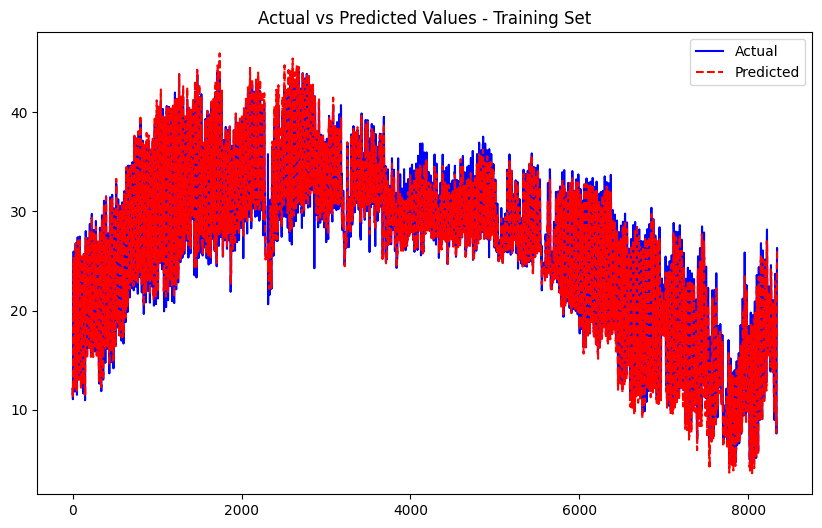

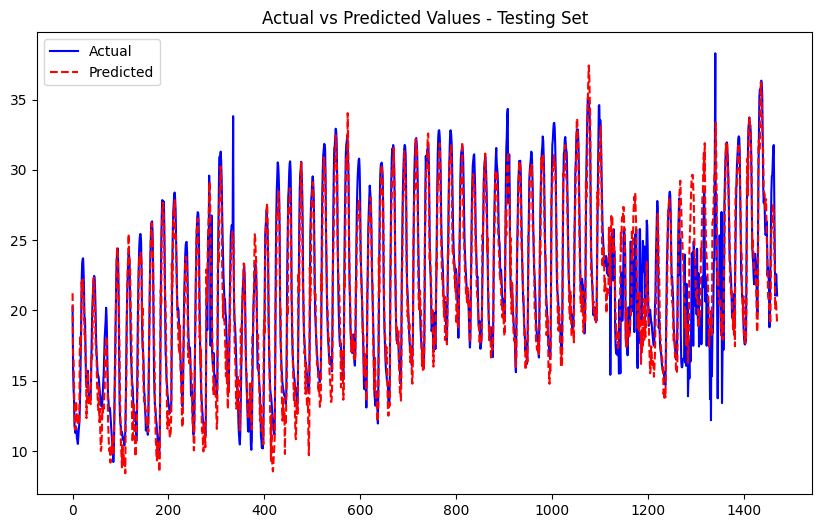

Processing node 27...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0483
Epoch [2/50], Train Loss: 0.0405
Epoch [3/50], Train Loss: 0.0371
Epoch [4/50], Train Loss: 0.0349
Epoch [5/50], Train Loss: 0.0337
Epoch [6/50], Train Loss: 0.0324
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0304
Epoch [10/50], Train Loss: 0.0298
Epoch [11/50], Train Loss: 0.0293
Epoch [12/50], Train Loss: 0.0293
Epoch [13/50], Train Loss: 0.0285
Epoch [14/50], Train Loss: 0.0287
Epoch [15/50], Train Loss: 0.0281
Epoch [16/50], Train Loss: 0.0284
Epoch [17/50], Train Loss: 0.0280
Epoch [18/50], Train Loss: 0.0283
Epoch [19/50], Train Loss: 0.0279
Epoch [20/50], Train Loss: 0.0278
Epoch [21/50], Train Loss: 0.0275
Epoch [22/50], Train Loss: 0.0272
Epoch [23/50], Train Loss: 0.0275
Epoch [24/50], Train Loss: 0.0273
Epoch [25/50], Train Loss: 0.0272
Epoch [26/50], Train Loss: 0.0271
Epoch [27/50], Train Loss: 0.0274
Epoch [28/50], Train Loss: 0.0270
Epoch [29/50], Train Loss: 0.0271
Epoch [30/50], Train Lo

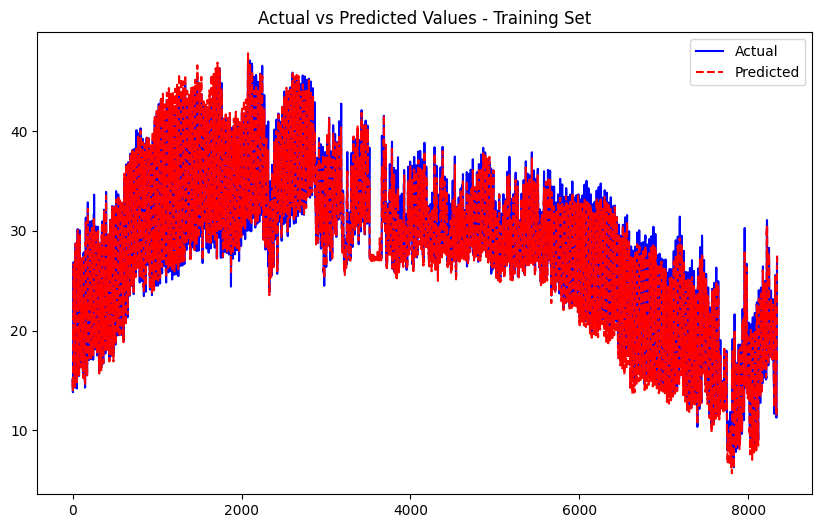

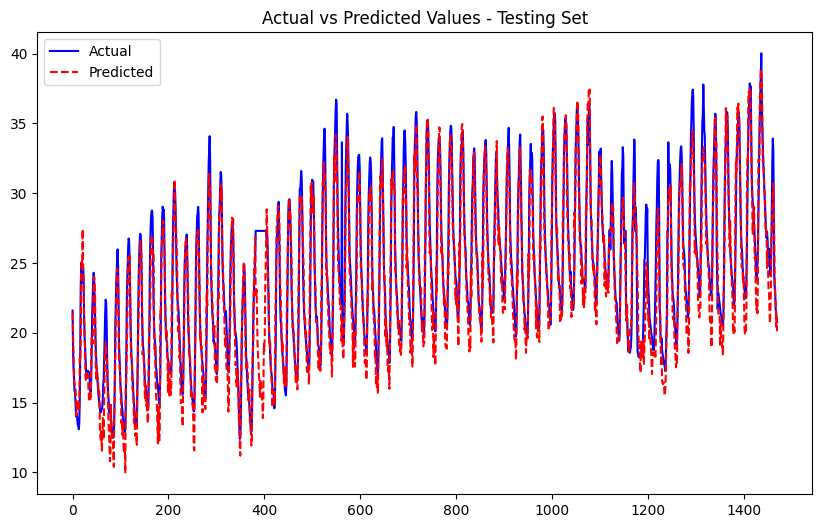

Processing node 28...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0595
Epoch [2/50], Train Loss: 0.0479
Epoch [3/50], Train Loss: 0.0439
Epoch [4/50], Train Loss: 0.0405
Epoch [5/50], Train Loss: 0.0384
Epoch [6/50], Train Loss: 0.0369
Epoch [7/50], Train Loss: 0.0353
Epoch [8/50], Train Loss: 0.0344
Epoch [9/50], Train Loss: 0.0336
Epoch [10/50], Train Loss: 0.0328
Epoch [11/50], Train Loss: 0.0324
Epoch [12/50], Train Loss: 0.0319
Epoch [13/50], Train Loss: 0.0312
Epoch [14/50], Train Loss: 0.0311
Epoch [15/50], Train Loss: 0.0307
Epoch [16/50], Train Loss: 0.0309
Epoch [17/50], Train Loss: 0.0302
Epoch [18/50], Train Loss: 0.0303
Epoch [19/50], Train Loss: 0.0299
Epoch [20/50], Train Loss: 0.0299
Epoch [21/50], Train Loss: 0.0298
Epoch [22/50], Train Loss: 0.0297
Epoch [23/50], Train Loss: 0.0294
Epoch [24/50], Train Loss: 0.0293
Epoch [25/50], Train Loss: 0.0296
Epoch [26/50], Train Loss: 0.0293
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0290
Epoch [29/50], Train Loss: 0.0291
Epoch [30/50], Train Lo

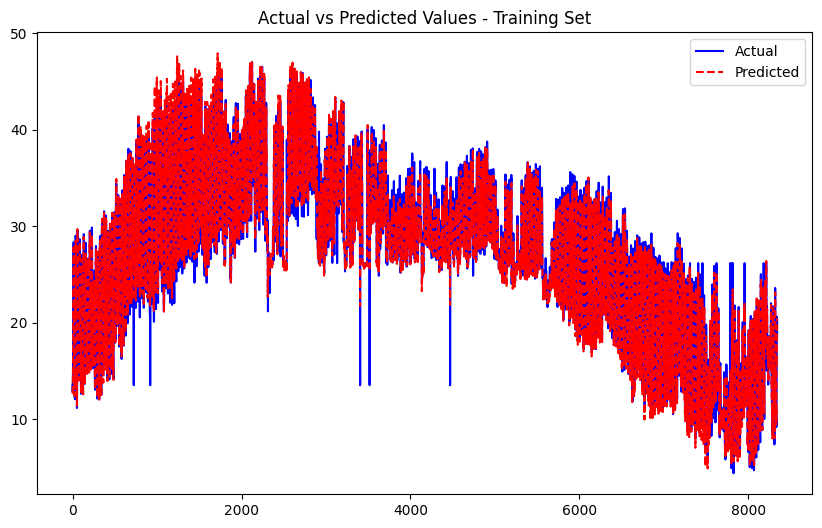

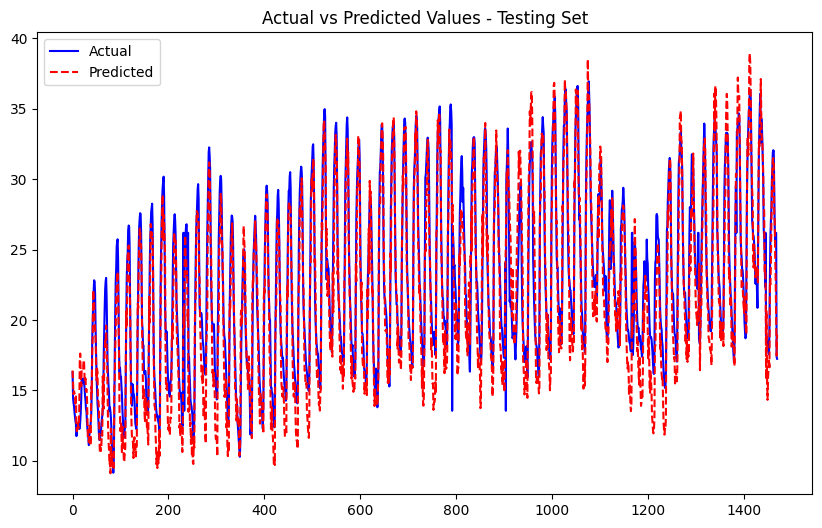

Processing node 29...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0646
Epoch [2/50], Train Loss: 0.0548
Epoch [3/50], Train Loss: 0.0490
Epoch [4/50], Train Loss: 0.0454
Epoch [5/50], Train Loss: 0.0426
Epoch [6/50], Train Loss: 0.0401
Epoch [7/50], Train Loss: 0.0387
Epoch [8/50], Train Loss: 0.0375
Epoch [9/50], Train Loss: 0.0364
Epoch [10/50], Train Loss: 0.0355
Epoch [11/50], Train Loss: 0.0352
Epoch [12/50], Train Loss: 0.0349
Epoch [13/50], Train Loss: 0.0343
Epoch [14/50], Train Loss: 0.0340
Epoch [15/50], Train Loss: 0.0337
Epoch [16/50], Train Loss: 0.0335
Epoch [17/50], Train Loss: 0.0333
Epoch [18/50], Train Loss: 0.0327
Epoch [19/50], Train Loss: 0.0328
Epoch [20/50], Train Loss: 0.0326
Epoch [21/50], Train Loss: 0.0324
Epoch [22/50], Train Loss: 0.0326
Epoch [23/50], Train Loss: 0.0324
Epoch [24/50], Train Loss: 0.0325
Epoch [25/50], Train Loss: 0.0319
Epoch [26/50], Train Loss: 0.0322
Epoch [27/50], Train Loss: 0.0320
Epoch [28/50], Train Loss: 0.0317
Epoch [29/50], Train Loss: 0.0317
Epoch [30/50], Train Lo

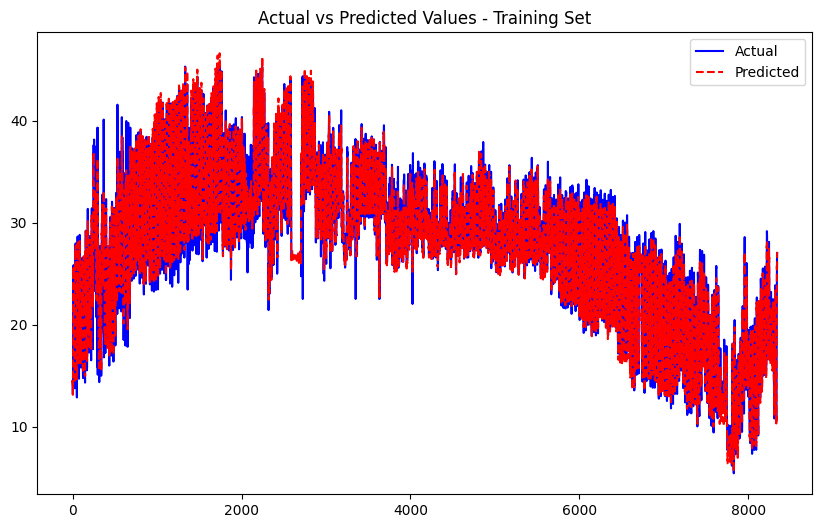

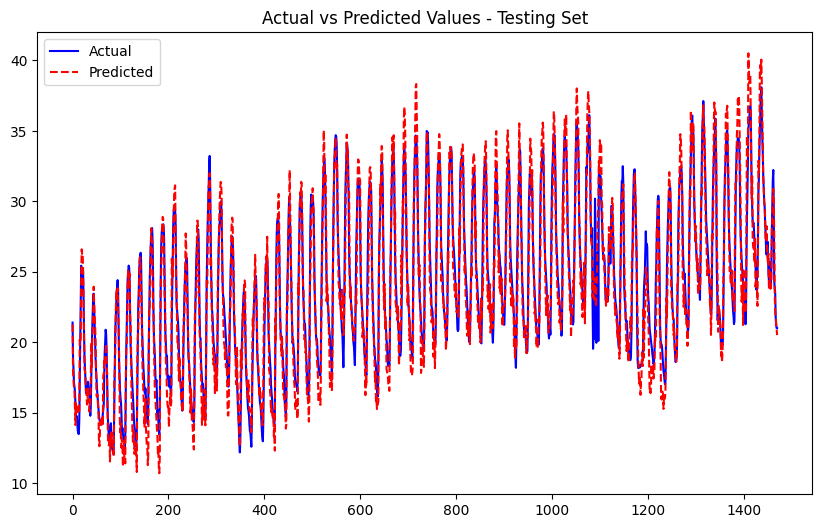

Processing node 30...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0636
Epoch [2/50], Train Loss: 0.0528
Epoch [3/50], Train Loss: 0.0486
Epoch [4/50], Train Loss: 0.0454
Epoch [5/50], Train Loss: 0.0430
Epoch [6/50], Train Loss: 0.0415
Epoch [7/50], Train Loss: 0.0402
Epoch [8/50], Train Loss: 0.0392
Epoch [9/50], Train Loss: 0.0385
Epoch [10/50], Train Loss: 0.0380
Epoch [11/50], Train Loss: 0.0371
Epoch [12/50], Train Loss: 0.0367
Epoch [13/50], Train Loss: 0.0364
Epoch [14/50], Train Loss: 0.0361
Epoch [15/50], Train Loss: 0.0360
Epoch [16/50], Train Loss: 0.0357
Epoch [17/50], Train Loss: 0.0355
Epoch [18/50], Train Loss: 0.0356
Epoch [19/50], Train Loss: 0.0355
Epoch [20/50], Train Loss: 0.0350
Epoch [21/50], Train Loss: 0.0348
Epoch [22/50], Train Loss: 0.0347
Epoch [23/50], Train Loss: 0.0348
Epoch [24/50], Train Loss: 0.0346
Epoch [25/50], Train Loss: 0.0344
Epoch [26/50], Train Loss: 0.0343
Epoch [27/50], Train Loss: 0.0344
Epoch [28/50], Train Loss: 0.0341
Epoch [29/50], Train Loss: 0.0341
Epoch [30/50], Train Lo

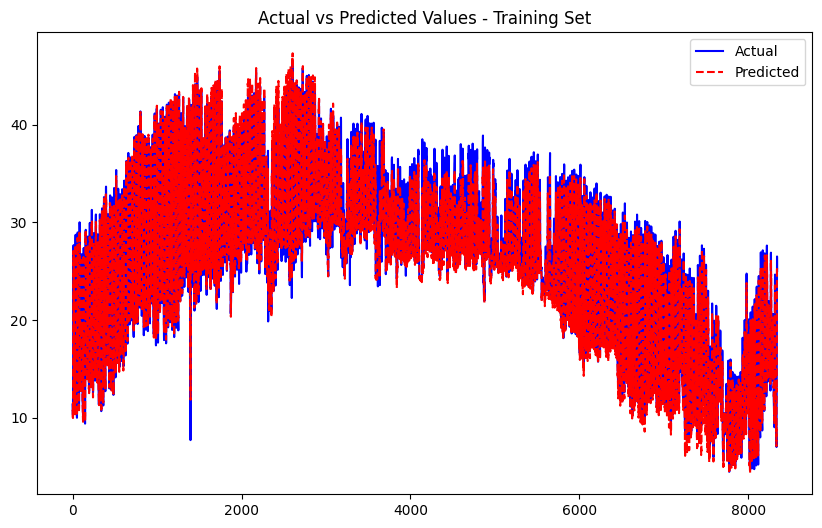

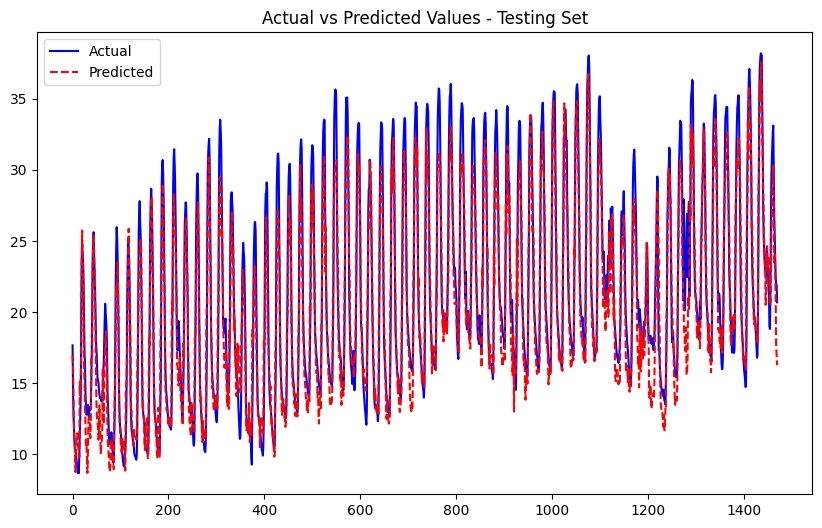

Processing node 31...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0548
Epoch [2/50], Train Loss: 0.0454
Epoch [3/50], Train Loss: 0.0416
Epoch [4/50], Train Loss: 0.0391
Epoch [5/50], Train Loss: 0.0374
Epoch [6/50], Train Loss: 0.0357
Epoch [7/50], Train Loss: 0.0346
Epoch [8/50], Train Loss: 0.0341
Epoch [9/50], Train Loss: 0.0331
Epoch [10/50], Train Loss: 0.0329
Epoch [11/50], Train Loss: 0.0322
Epoch [12/50], Train Loss: 0.0320
Epoch [13/50], Train Loss: 0.0315
Epoch [14/50], Train Loss: 0.0314
Epoch [15/50], Train Loss: 0.0314
Epoch [16/50], Train Loss: 0.0306
Epoch [17/50], Train Loss: 0.0304
Epoch [18/50], Train Loss: 0.0305
Epoch [19/50], Train Loss: 0.0304
Epoch [20/50], Train Loss: 0.0303
Epoch [21/50], Train Loss: 0.0302
Epoch [22/50], Train Loss: 0.0302
Epoch [23/50], Train Loss: 0.0301
Epoch [24/50], Train Loss: 0.0297
Epoch [25/50], Train Loss: 0.0296
Epoch [26/50], Train Loss: 0.0300
Epoch [27/50], Train Loss: 0.0293
Epoch [28/50], Train Loss: 0.0294
Epoch [29/50], Train Loss: 0.0294
Epoch [30/50], Train Lo

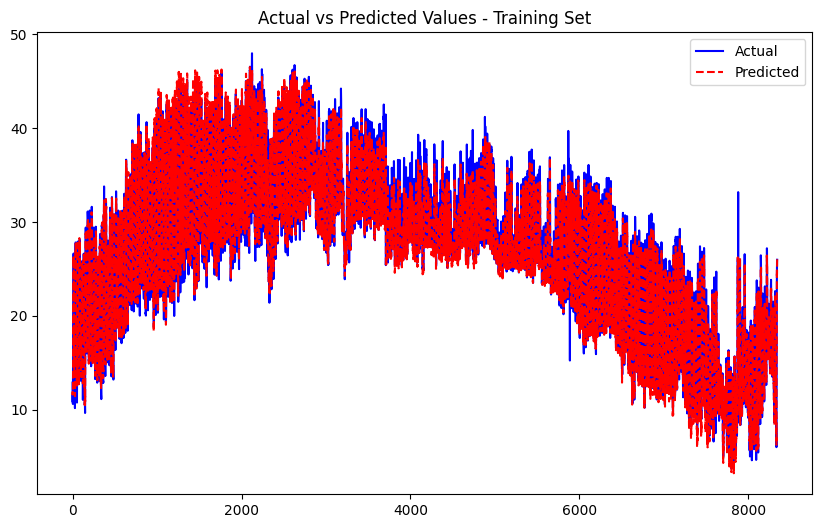

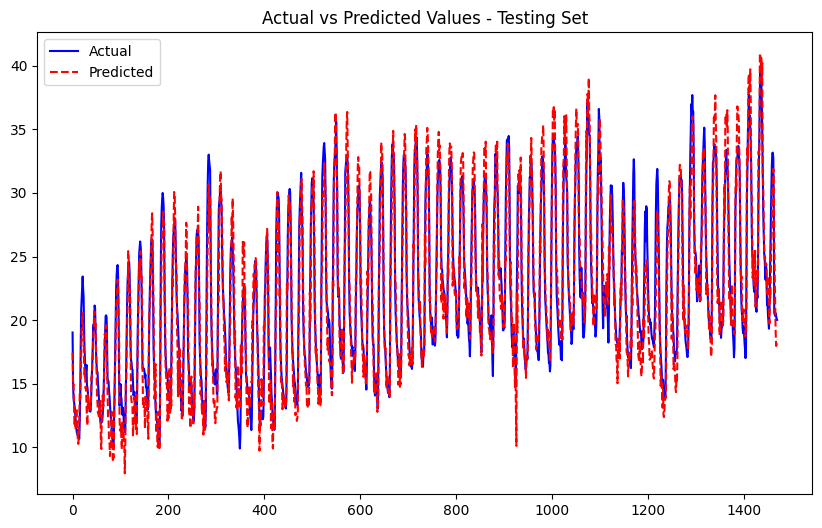

Processing node 32...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0634
Epoch [2/50], Train Loss: 0.0518
Epoch [3/50], Train Loss: 0.0461
Epoch [4/50], Train Loss: 0.0428
Epoch [5/50], Train Loss: 0.0403
Epoch [6/50], Train Loss: 0.0386
Epoch [7/50], Train Loss: 0.0370
Epoch [8/50], Train Loss: 0.0361
Epoch [9/50], Train Loss: 0.0354
Epoch [10/50], Train Loss: 0.0344
Epoch [11/50], Train Loss: 0.0344
Epoch [12/50], Train Loss: 0.0339
Epoch [13/50], Train Loss: 0.0334
Epoch [14/50], Train Loss: 0.0334
Epoch [15/50], Train Loss: 0.0328
Epoch [16/50], Train Loss: 0.0325
Epoch [17/50], Train Loss: 0.0325
Epoch [18/50], Train Loss: 0.0321
Epoch [19/50], Train Loss: 0.0321
Epoch [20/50], Train Loss: 0.0320
Epoch [21/50], Train Loss: 0.0316
Epoch [22/50], Train Loss: 0.0317
Epoch [23/50], Train Loss: 0.0314
Epoch [24/50], Train Loss: 0.0313
Epoch [25/50], Train Loss: 0.0314
Epoch [26/50], Train Loss: 0.0314
Epoch [27/50], Train Loss: 0.0309
Epoch [28/50], Train Loss: 0.0311
Epoch [29/50], Train Loss: 0.0310
Epoch [30/50], Train Lo

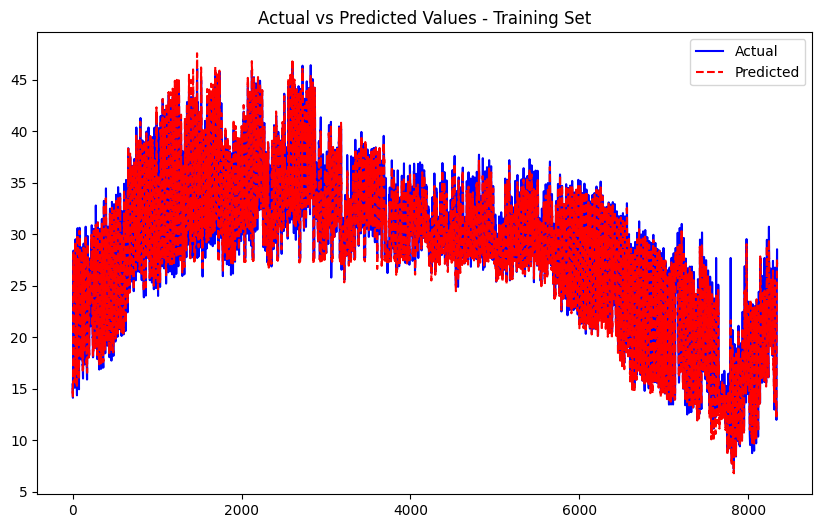

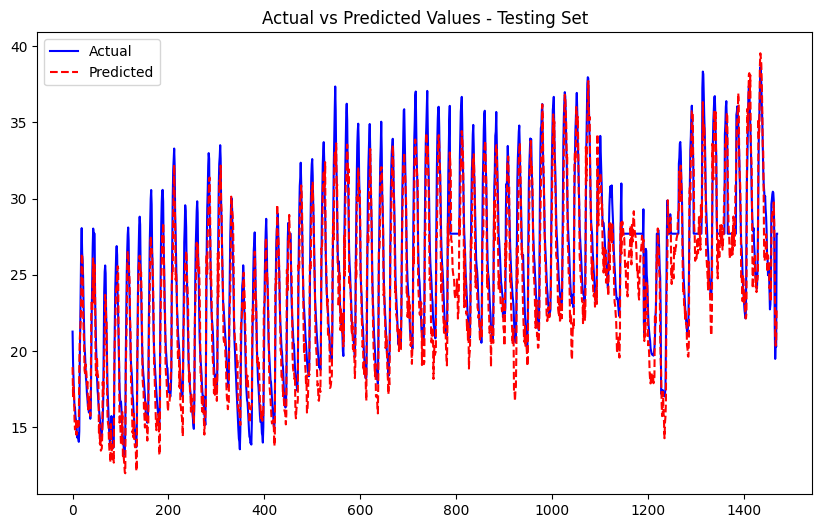

Processing node 33...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1432
Epoch [2/50], Train Loss: 0.1196
Epoch [3/50], Train Loss: 0.1065
Epoch [4/50], Train Loss: 0.0970
Epoch [5/50], Train Loss: 0.0897
Epoch [6/50], Train Loss: 0.0843
Epoch [7/50], Train Loss: 0.0807
Epoch [8/50], Train Loss: 0.0771
Epoch [9/50], Train Loss: 0.0745
Epoch [10/50], Train Loss: 0.0732
Epoch [11/50], Train Loss: 0.0713
Epoch [12/50], Train Loss: 0.0699
Epoch [13/50], Train Loss: 0.0689
Epoch [14/50], Train Loss: 0.0681
Epoch [15/50], Train Loss: 0.0677
Epoch [16/50], Train Loss: 0.0668
Epoch [17/50], Train Loss: 0.0663
Epoch [18/50], Train Loss: 0.0657
Epoch [19/50], Train Loss: 0.0658
Epoch [20/50], Train Loss: 0.0651
Epoch [21/50], Train Loss: 0.0648
Epoch [22/50], Train Loss: 0.0647
Epoch [23/50], Train Loss: 0.0643
Epoch [24/50], Train Loss: 0.0639
Epoch [25/50], Train Loss: 0.0640
Epoch [26/50], Train Loss: 0.0639
Epoch [27/50], Train Loss: 0.0635
Epoch [28/50], Train Loss: 0.0634
Epoch [29/50], Train Loss: 0.0632
Epoch [30/50], Train Lo

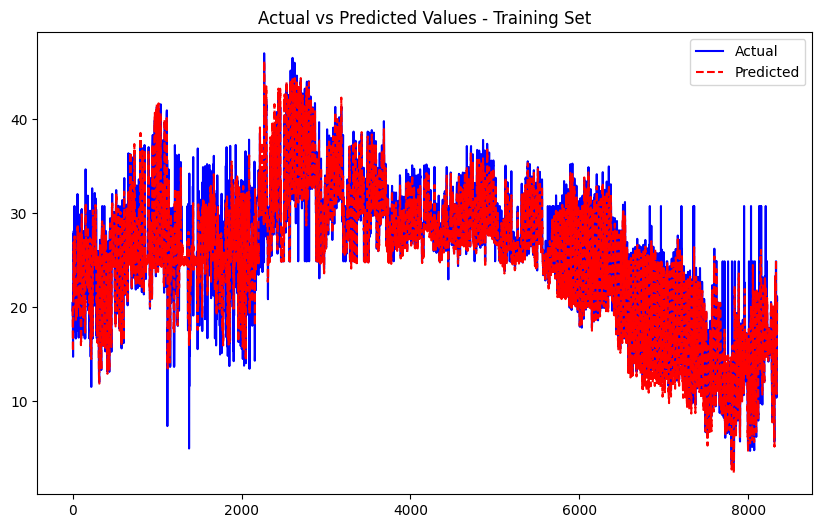

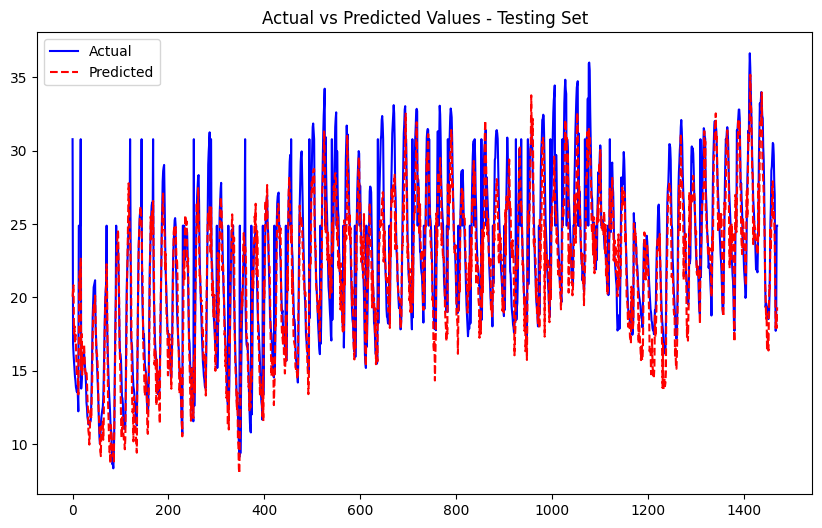

Processing node 34...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1083
Epoch [2/50], Train Loss: 0.0790
Epoch [3/50], Train Loss: 0.0558
Epoch [4/50], Train Loss: 0.0468
Epoch [5/50], Train Loss: 0.0405
Epoch [6/50], Train Loss: 0.0377
Epoch [7/50], Train Loss: 0.0359
Epoch [8/50], Train Loss: 0.0344
Epoch [9/50], Train Loss: 0.0336
Epoch [10/50], Train Loss: 0.0322
Epoch [11/50], Train Loss: 0.0318
Epoch [12/50], Train Loss: 0.0313
Epoch [13/50], Train Loss: 0.0304
Epoch [14/50], Train Loss: 0.0299
Epoch [15/50], Train Loss: 0.0297
Epoch [16/50], Train Loss: 0.0292
Epoch [17/50], Train Loss: 0.0292
Epoch [18/50], Train Loss: 0.0289
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0283
Epoch [21/50], Train Loss: 0.0282
Epoch [22/50], Train Loss: 0.0283
Epoch [23/50], Train Loss: 0.0280
Epoch [24/50], Train Loss: 0.0280
Epoch [25/50], Train Loss: 0.0278
Epoch [26/50], Train Loss: 0.0279
Epoch [27/50], Train Loss: 0.0276
Epoch [28/50], Train Loss: 0.0277
Epoch [29/50], Train Loss: 0.0273
Epoch [30/50], Train Lo

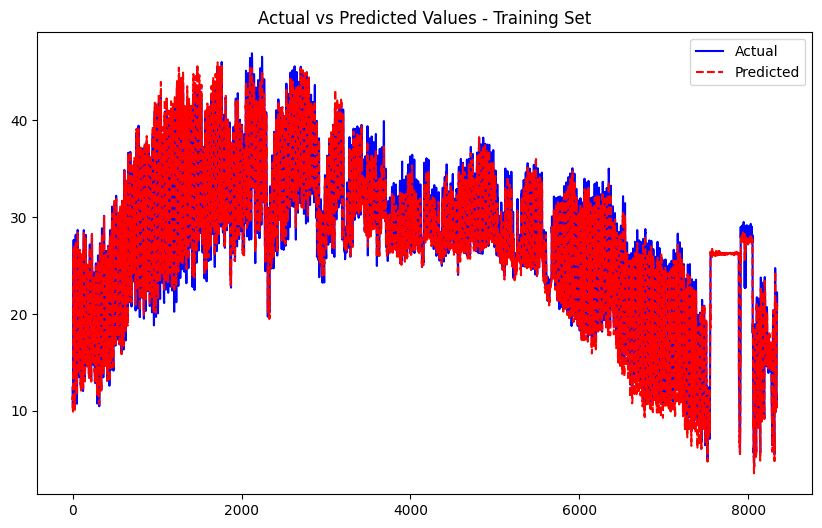

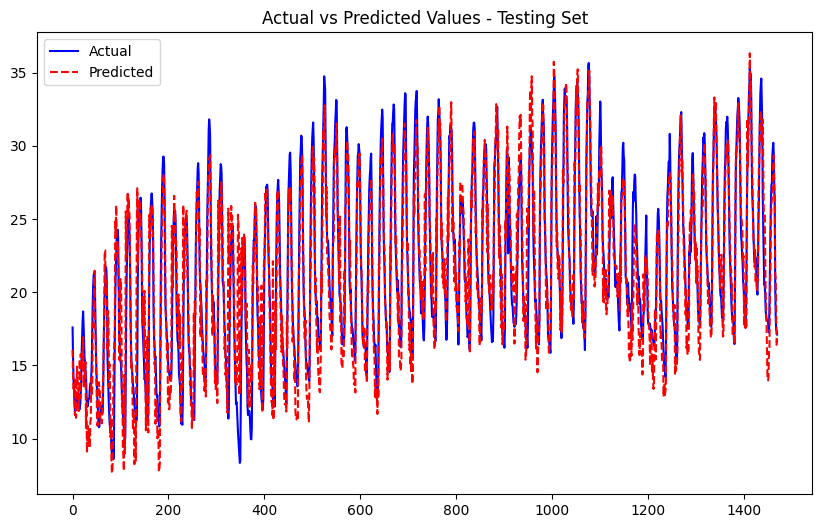

Processing node 35...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0493
Epoch [2/50], Train Loss: 0.0403
Epoch [3/50], Train Loss: 0.0368
Epoch [4/50], Train Loss: 0.0349
Epoch [5/50], Train Loss: 0.0335
Epoch [6/50], Train Loss: 0.0326
Epoch [7/50], Train Loss: 0.0317
Epoch [8/50], Train Loss: 0.0307
Epoch [9/50], Train Loss: 0.0302
Epoch [10/50], Train Loss: 0.0300
Epoch [11/50], Train Loss: 0.0294
Epoch [12/50], Train Loss: 0.0291
Epoch [13/50], Train Loss: 0.0288
Epoch [14/50], Train Loss: 0.0284
Epoch [15/50], Train Loss: 0.0283
Epoch [16/50], Train Loss: 0.0283
Epoch [17/50], Train Loss: 0.0281
Epoch [18/50], Train Loss: 0.0282
Epoch [19/50], Train Loss: 0.0280
Epoch [20/50], Train Loss: 0.0276
Epoch [21/50], Train Loss: 0.0274
Epoch [22/50], Train Loss: 0.0274
Epoch [23/50], Train Loss: 0.0274
Epoch [24/50], Train Loss: 0.0272
Epoch [25/50], Train Loss: 0.0275
Epoch [26/50], Train Loss: 0.0271
Epoch [27/50], Train Loss: 0.0270
Epoch [28/50], Train Loss: 0.0268
Epoch [29/50], Train Loss: 0.0270
Epoch [30/50], Train Lo

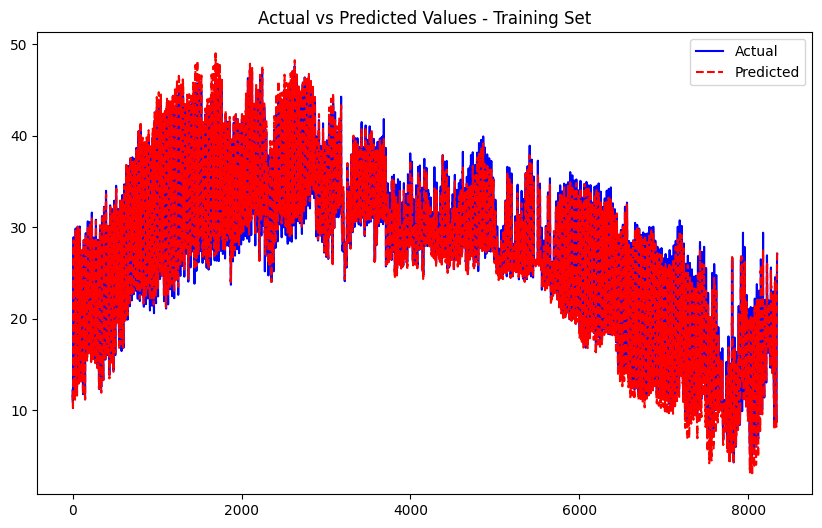

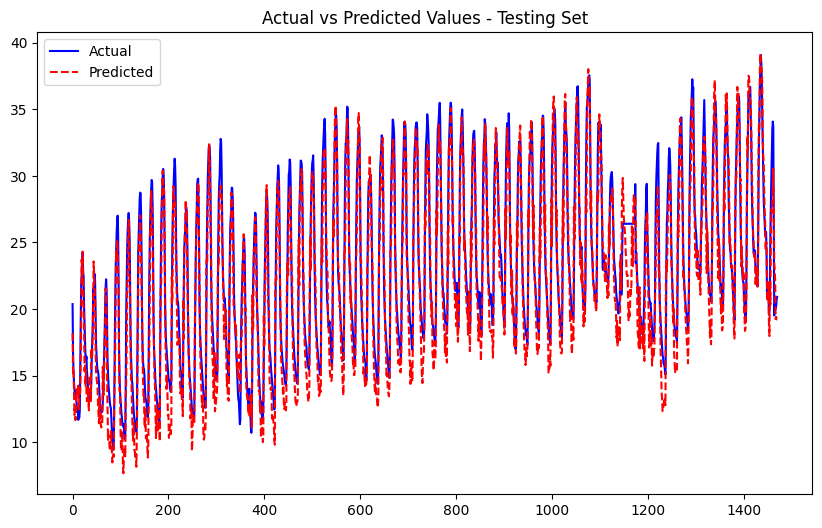

Processing node 36...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0576
Epoch [2/50], Train Loss: 0.0479
Epoch [3/50], Train Loss: 0.0438
Epoch [4/50], Train Loss: 0.0407
Epoch [5/50], Train Loss: 0.0386
Epoch [6/50], Train Loss: 0.0372
Epoch [7/50], Train Loss: 0.0359
Epoch [8/50], Train Loss: 0.0348
Epoch [9/50], Train Loss: 0.0339
Epoch [10/50], Train Loss: 0.0336
Epoch [11/50], Train Loss: 0.0329
Epoch [12/50], Train Loss: 0.0325
Epoch [13/50], Train Loss: 0.0325
Epoch [14/50], Train Loss: 0.0321
Epoch [15/50], Train Loss: 0.0317
Epoch [16/50], Train Loss: 0.0315
Epoch [17/50], Train Loss: 0.0311
Epoch [18/50], Train Loss: 0.0312
Epoch [19/50], Train Loss: 0.0309
Epoch [20/50], Train Loss: 0.0309
Epoch [21/50], Train Loss: 0.0306
Epoch [22/50], Train Loss: 0.0308
Epoch [23/50], Train Loss: 0.0304
Epoch [24/50], Train Loss: 0.0306
Epoch [25/50], Train Loss: 0.0303
Epoch [26/50], Train Loss: 0.0301
Epoch [27/50], Train Loss: 0.0303
Epoch [28/50], Train Loss: 0.0301
Epoch [29/50], Train Loss: 0.0302
Epoch [30/50], Train Lo

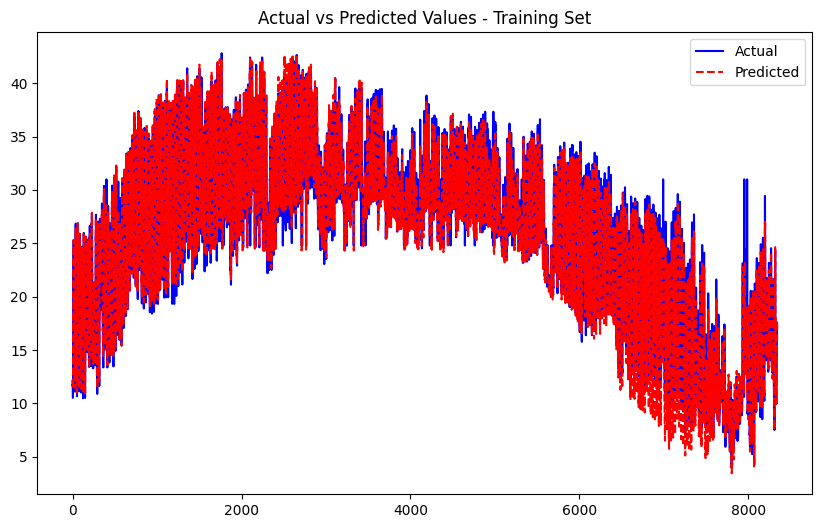

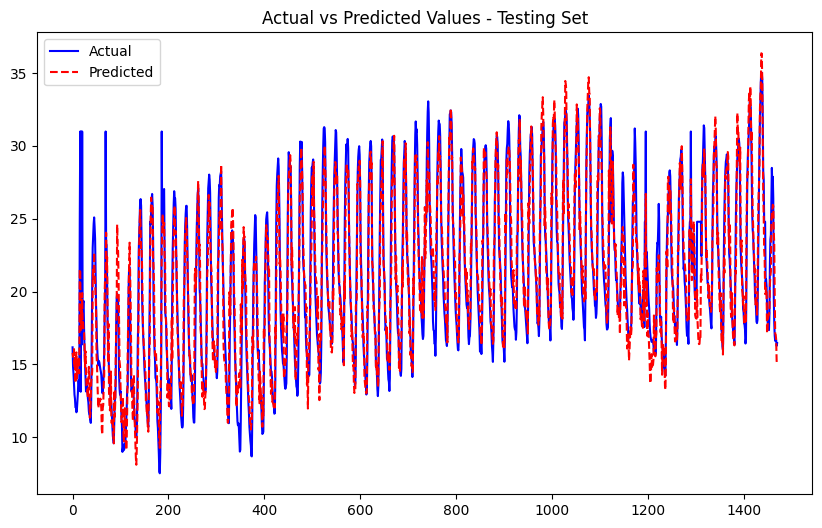

Processing node 37...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0628
Epoch [2/50], Train Loss: 0.0534
Epoch [3/50], Train Loss: 0.0486
Epoch [4/50], Train Loss: 0.0461
Epoch [5/50], Train Loss: 0.0433
Epoch [6/50], Train Loss: 0.0418
Epoch [7/50], Train Loss: 0.0406
Epoch [8/50], Train Loss: 0.0395
Epoch [9/50], Train Loss: 0.0384
Epoch [10/50], Train Loss: 0.0378
Epoch [11/50], Train Loss: 0.0372
Epoch [12/50], Train Loss: 0.0370
Epoch [13/50], Train Loss: 0.0367
Epoch [14/50], Train Loss: 0.0365
Epoch [15/50], Train Loss: 0.0365
Epoch [16/50], Train Loss: 0.0359
Epoch [17/50], Train Loss: 0.0354
Epoch [18/50], Train Loss: 0.0355
Epoch [19/50], Train Loss: 0.0353
Epoch [20/50], Train Loss: 0.0351
Epoch [21/50], Train Loss: 0.0350
Epoch [22/50], Train Loss: 0.0351
Epoch [23/50], Train Loss: 0.0351
Epoch [24/50], Train Loss: 0.0347
Epoch [25/50], Train Loss: 0.0347
Epoch [26/50], Train Loss: 0.0348
Epoch [27/50], Train Loss: 0.0344
Epoch [28/50], Train Loss: 0.0344
Epoch [29/50], Train Loss: 0.0346
Epoch [30/50], Train Lo

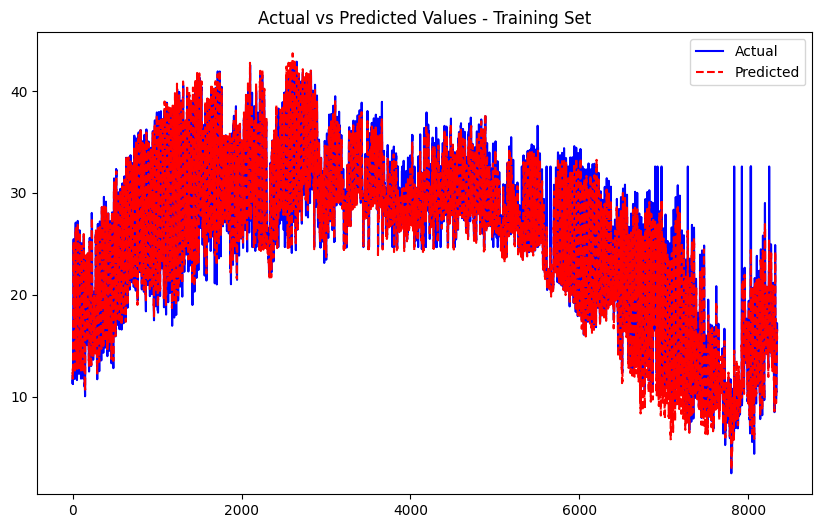

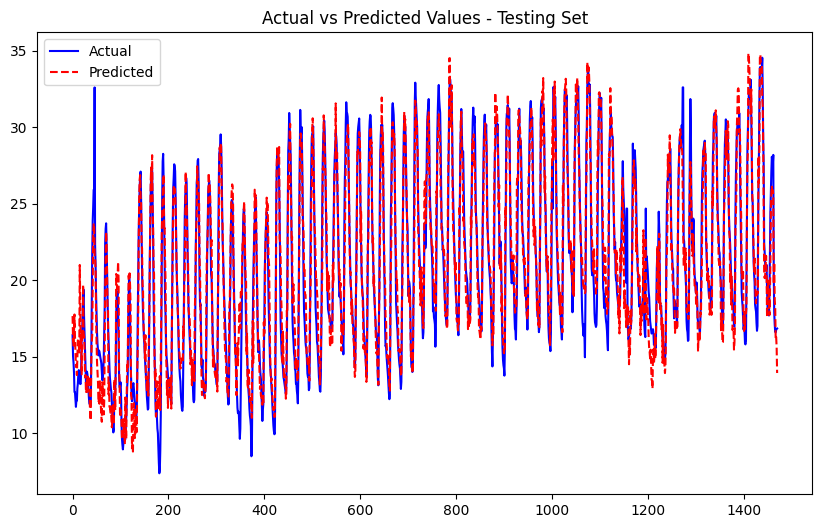

Processing node 38...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0546
Epoch [2/50], Train Loss: 0.0452
Epoch [3/50], Train Loss: 0.0408
Epoch [4/50], Train Loss: 0.0384
Epoch [5/50], Train Loss: 0.0365
Epoch [6/50], Train Loss: 0.0348
Epoch [7/50], Train Loss: 0.0336
Epoch [8/50], Train Loss: 0.0328
Epoch [9/50], Train Loss: 0.0318
Epoch [10/50], Train Loss: 0.0316
Epoch [11/50], Train Loss: 0.0310
Epoch [12/50], Train Loss: 0.0306
Epoch [13/50], Train Loss: 0.0298
Epoch [14/50], Train Loss: 0.0299
Epoch [15/50], Train Loss: 0.0297
Epoch [16/50], Train Loss: 0.0292
Epoch [17/50], Train Loss: 0.0293
Epoch [18/50], Train Loss: 0.0290
Epoch [19/50], Train Loss: 0.0289
Epoch [20/50], Train Loss: 0.0287
Epoch [21/50], Train Loss: 0.0291
Epoch [22/50], Train Loss: 0.0284
Epoch [23/50], Train Loss: 0.0282
Epoch [24/50], Train Loss: 0.0283
Epoch [25/50], Train Loss: 0.0281
Epoch [26/50], Train Loss: 0.0281
Epoch [27/50], Train Loss: 0.0277
Epoch [28/50], Train Loss: 0.0281
Epoch [29/50], Train Loss: 0.0279
Epoch [30/50], Train Lo

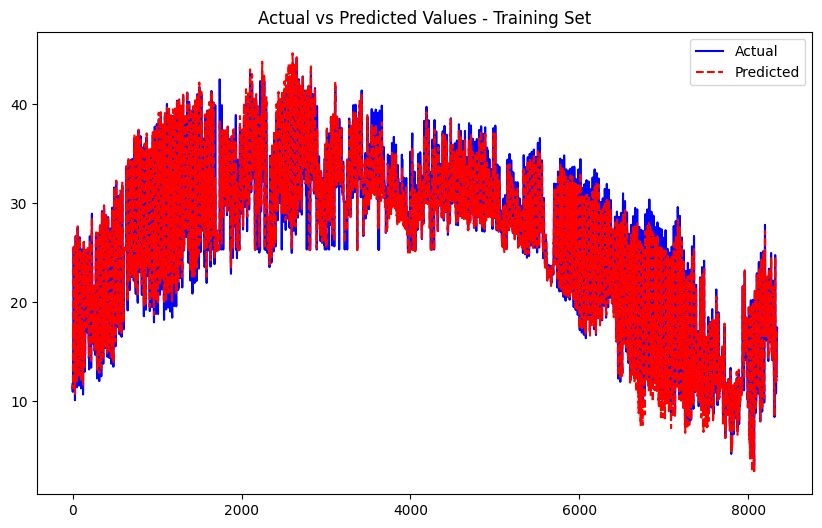

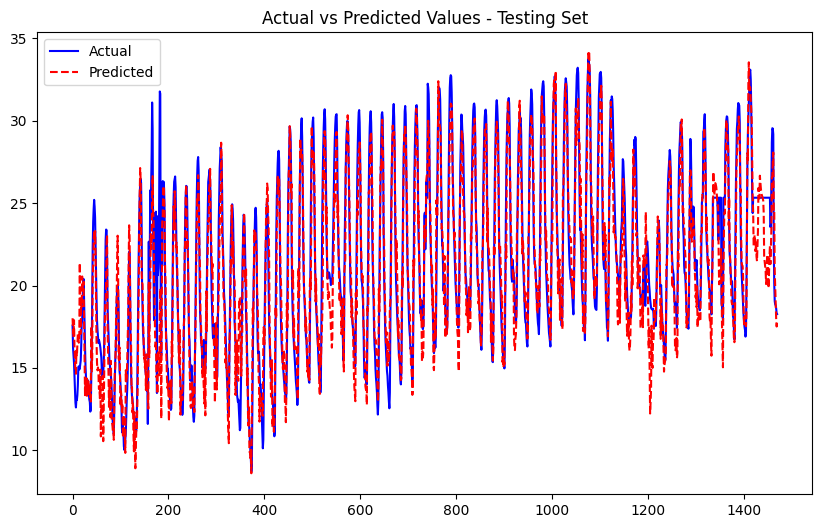

Processing node 39...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.1401
Epoch [2/50], Train Loss: 0.1164
Epoch [3/50], Train Loss: 0.1030
Epoch [4/50], Train Loss: 0.0966
Epoch [5/50], Train Loss: 0.0918
Epoch [6/50], Train Loss: 0.0886
Epoch [7/50], Train Loss: 0.0862
Epoch [8/50], Train Loss: 0.0840
Epoch [9/50], Train Loss: 0.0831
Epoch [10/50], Train Loss: 0.0817
Epoch [11/50], Train Loss: 0.0800
Epoch [12/50], Train Loss: 0.0798
Epoch [13/50], Train Loss: 0.0792
Epoch [14/50], Train Loss: 0.0785
Epoch [15/50], Train Loss: 0.0780
Epoch [16/50], Train Loss: 0.0778
Epoch [17/50], Train Loss: 0.0772
Epoch [18/50], Train Loss: 0.0768
Epoch [19/50], Train Loss: 0.0766
Epoch [20/50], Train Loss: 0.0764
Epoch [21/50], Train Loss: 0.0760
Epoch [22/50], Train Loss: 0.0760
Epoch [23/50], Train Loss: 0.0758
Epoch [24/50], Train Loss: 0.0754
Epoch [25/50], Train Loss: 0.0751
Epoch [26/50], Train Loss: 0.0752
Epoch [27/50], Train Loss: 0.0750
Epoch [28/50], Train Loss: 0.0753
Epoch [29/50], Train Loss: 0.0743
Epoch [30/50], Train Lo

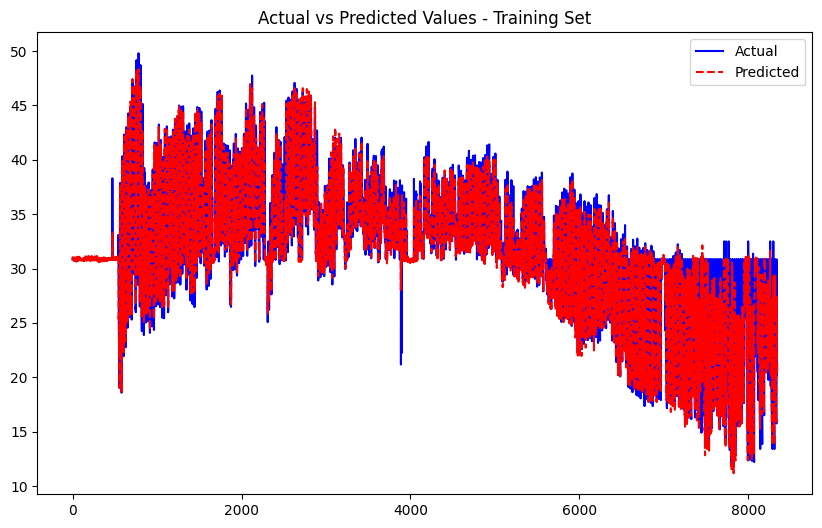

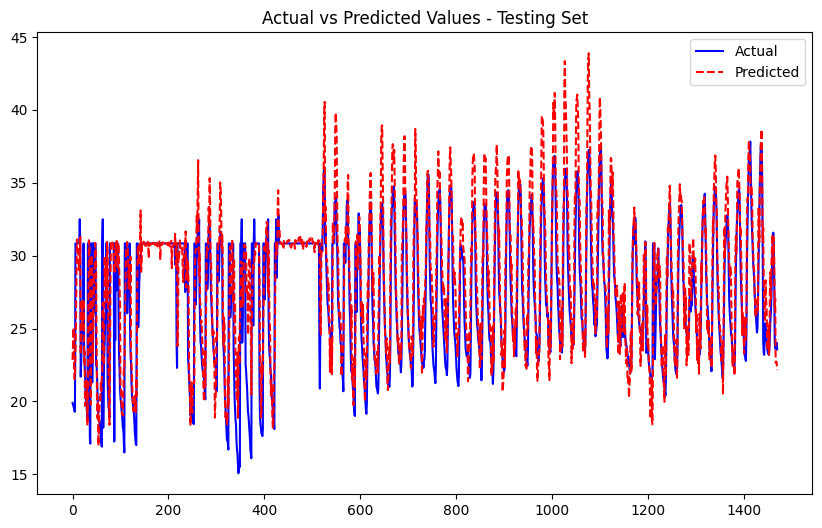

Processing node 40...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.2843
Epoch [2/50], Train Loss: 0.2034
Epoch [3/50], Train Loss: 0.1490
Epoch [4/50], Train Loss: 0.1112
Epoch [5/50], Train Loss: 0.0915
Epoch [6/50], Train Loss: 0.0802
Epoch [7/50], Train Loss: 0.0740
Epoch [8/50], Train Loss: 0.0698
Epoch [9/50], Train Loss: 0.0635
Epoch [10/50], Train Loss: 0.0615
Epoch [11/50], Train Loss: 0.0577
Epoch [12/50], Train Loss: 0.0573
Epoch [13/50], Train Loss: 0.0565
Epoch [14/50], Train Loss: 0.0538
Epoch [15/50], Train Loss: 0.0532
Epoch [16/50], Train Loss: 0.0523
Epoch [17/50], Train Loss: 0.0512
Epoch [18/50], Train Loss: 0.0504
Epoch [19/50], Train Loss: 0.0501
Epoch [20/50], Train Loss: 0.0498
Epoch [21/50], Train Loss: 0.0501
Epoch [22/50], Train Loss: 0.0497
Epoch [23/50], Train Loss: 0.0487
Epoch [24/50], Train Loss: 0.0485
Epoch [25/50], Train Loss: 0.0482
Epoch [26/50], Train Loss: 0.0469
Epoch [27/50], Train Loss: 0.0479
Epoch [28/50], Train Loss: 0.0476
Epoch [29/50], Train Loss: 0.0456
Epoch [30/50], Train Lo

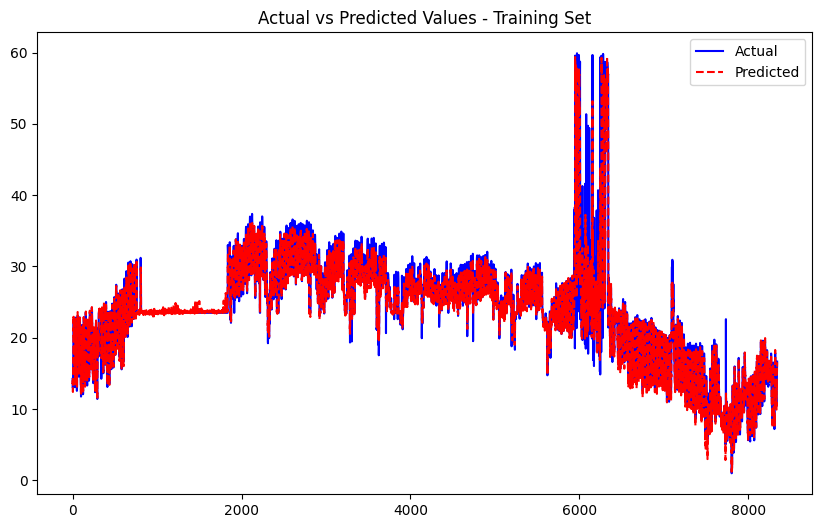

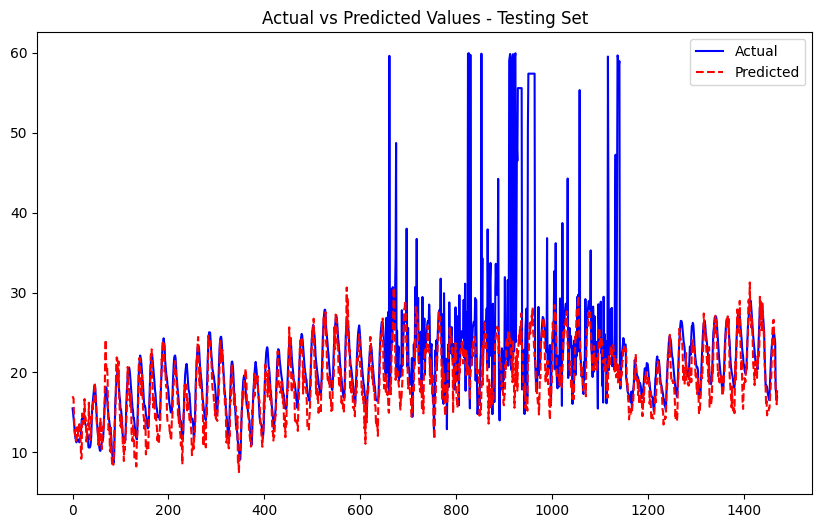

Processing node 41...


C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([3])) that is different to the input size (torch.Size([3, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)
C:\Users\Asus\AppData\Roaming\Python\Python311\site-packages\torch\nn\modules\loss.py:538: UserWarning: Using a target size (torch.Size([1])) that is different to the input size (torch.Size([1, 1])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  return F.mse_loss(input, target, reduction=self.reduction)


Epoch [1/50], Train Loss: 0.0977
Epoch [2/50], Train Loss: 0.0736
Epoch [3/50], Train Loss: 0.0659
Epoch [4/50], Train Loss: 0.0602
Epoch [5/50], Train Loss: 0.0571
Epoch [6/50], Train Loss: 0.0539
Epoch [7/50], Train Loss: 0.0516
Epoch [8/50], Train Loss: 0.0501
Epoch [9/50], Train Loss: 0.0485
Epoch [10/50], Train Loss: 0.0476
Epoch [11/50], Train Loss: 0.0467
Epoch [12/50], Train Loss: 0.0462
Epoch [13/50], Train Loss: 0.0459
Epoch [14/50], Train Loss: 0.0452
Epoch [15/50], Train Loss: 0.0446
Epoch [16/50], Train Loss: 0.0445
Epoch [17/50], Train Loss: 0.0441
Epoch [18/50], Train Loss: 0.0431
Epoch [19/50], Train Loss: 0.0431
Epoch [20/50], Train Loss: 0.0428
Epoch [21/50], Train Loss: 0.0432
Epoch [22/50], Train Loss: 0.0424
Epoch [23/50], Train Loss: 0.0420
Epoch [24/50], Train Loss: 0.0421
Epoch [25/50], Train Loss: 0.0418
Epoch [26/50], Train Loss: 0.0415
Epoch [27/50], Train Loss: 0.0416
Epoch [28/50], Train Loss: 0.0412
Epoch [29/50], Train Loss: 0.0412
Epoch [30/50], Train Lo

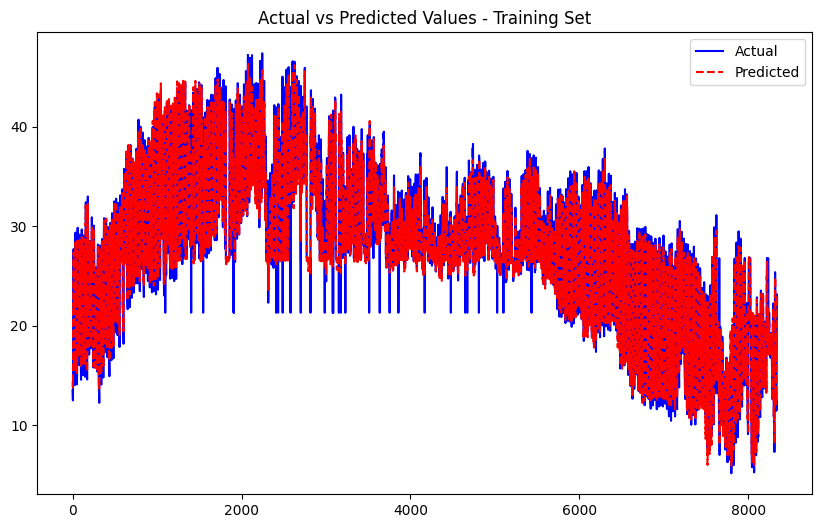

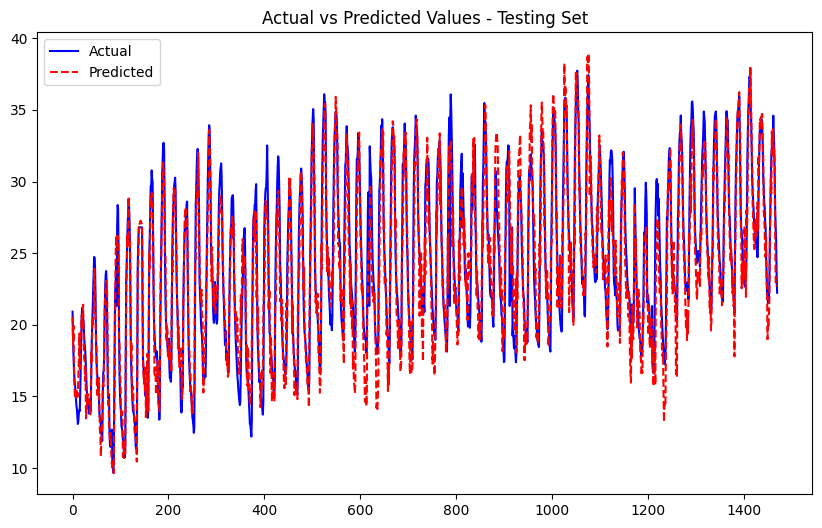

Train GNN and LSTM Imputed KNN bs 3 sl 3.csv
CSV file 'Train GNN and LSTM Imputed KNN bs 3 sl 3.csv' created successfully.
Test GNN and LSTM Imputed KNN bs 3 sl 3.csv
CSV file 'Test GNN and LSTM Imputed KNN bs 3 sl 3.csv' created successfully.


In [21]:
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import matplotlib.pyplot as plt
import numpy as np
import torch.optim.lr_scheduler as lr_scheduler

# Define the LSTM Model
class LSTMModel(nn.Module):
    def __init__(self, input_size, hidden_size, num_layers, output_size, dropout_prob=0.2):
        super(LSTMModel, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        
        # Define the LSTM layer
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)  # One hidden layer
        
        # Dropout layer
        self.dropout = nn.Dropout(dropout_prob)
        
        # Fully connected layer (output layer)
        self.fc = nn.Linear(hidden_size, output_size)
        
        # Activation function
        self.elu = nn.ELU()

    def forward(self, x):
        # Initialize hidden state and cell state with zeros
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)  # 1 layer, batch_size, hidden_size

        # Forward pass through LSTM
        out, _ = self.lstm(x, (h0, c0))  # LSTM returns all outputs (hidden states) and the final states
        
        # Apply ReLU activation function to the last time step output
        out = self.elu(out[:, -1, :])  # out[:, -1, :] -> output from the last time step
        
        # Apply dropout to the hidden layer's output
        out = self.dropout(out)
        
        # Pass the output through the fully connected layer
        out = self.fc(out)
        
        return out


def train_model(model, train_loader, criterion, optimizer, num_epochs):
    model.train()  # Set the model to training mode
    for epoch in range(num_epochs):
        running_loss = 0.0
        
        # Training phase
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)

            # Reshape input for LSTM (batch_size, sequence_length, num_features)
            # features should already be of shape (batch_size, sequence_length, num_features)
            
            # Forward pass
            outputs = model(features)  # LSTM will process the sequence data correctly
            loss = criterion(outputs, targets)  # Compute the loss

            # Backward and optimize
            optimizer.zero_grad()  # Clear previous gradients
            loss.backward()  # Backpropagate the loss
            optimizer.step()  # Update weights

            running_loss += loss.item()   

        # Print training loss after each epoch
        print(f'Epoch [{epoch+1}/{num_epochs}], Train Loss: {running_loss/len(train_loader):.4f}')
    
    # Switch back to evaluation mode
    model.eval()



def test_model(model, train_loader, test_loader, node_idx):
    model.eval()
    all_actuals = []
    all_predictions = []
    
    # For tracking actuals and predictions for train and test sets separately
    train_actuals = []
    train_predictions = []
    
    test_actuals = []
    test_predictions = []

    
    with torch.no_grad():
        # Predict on training data
        for features, targets in train_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            train_actuals.append(targets.cpu().numpy())
            train_predictions.append(outputs.cpu().numpy())

        # Predict on testing data
        for features, targets in test_loader:
            features, targets = features.to(device), targets.to(device)
            outputs = model(features)

            test_actuals.append(targets.cpu().numpy())
            test_predictions.append(outputs.cpu().numpy())
    
    # Concatenate all sets
    train_actuals = np.concatenate(train_actuals, axis=0)
    test_actuals = np.concatenate(test_actuals, axis=0)
    
    train_predictions = np.concatenate(train_predictions, axis=0)
    test_predictions = np.concatenate(test_predictions, axis=0)

    # Check shapes before proceeding
    print(f"Training actuals shape: {train_actuals.shape}, Predictions shape: {train_predictions.shape}")
    print(f"Testing actuals shape: {test_actuals.shape}, Predictions shape: {test_predictions.shape}")
    
    # Combine them for inverse scaling
    all_actuals = np.concatenate([train_actuals, test_actuals])
    all_predictions = np.concatenate([train_predictions, test_predictions])
    
    # Inverse scaling
    file_name = input_files[node_idx]
    
    if file_name in scalers:
        all_actuals = all_actuals.reshape(-1, 1)
        all_predictions = all_predictions.reshape(-1, 1)
        
        # Apply inverse scaling
        all_actuals_inverse = scalers[file_name].inverse_transform(all_actuals).flatten()
        all_predictions_inverse = scalers[file_name].inverse_transform(all_predictions).flatten()
    else:
        print(f"Scaler not found for {file_name}")
        return
    
    # Split them back into training and test sets
    train_size = len(train_actuals)
    test_size = len(test_actuals)
    
    train_actuals_inverse = all_actuals_inverse[:train_size]
    test_actuals_inverse = all_actuals_inverse[train_size:]
    
    train_predictions_inverse = all_predictions_inverse[:train_size]
    test_predictions_inverse = all_predictions_inverse[train_size:]

    # Verify split sizes
    print(f"Split Training actuals shape: {train_actuals_inverse.shape}, Predictions shape: {train_predictions_inverse.shape}")
    print(f"Split Testing actuals shape: {test_actuals_inverse.shape}, Predictions shape: {test_predictions_inverse.shape}")
    
    # Function to calculate and print metrics
    def calculate_metrics(actuals, predictions, set_name):
        mae = mean_absolute_error(actuals, predictions)
        mse = mean_squared_error(actuals, predictions)
        rmse = np.sqrt(mse)
        r2 = r2_score(actuals, predictions)
        corr_coeff = np.corrcoef(actuals.flatten(), predictions.flatten())[0, 1]
        
        # Print the metrics
        print(f"{set_name} Set Metrics:")
        print(f"Mean Absolute Error (MAE): {mae:.4f}")
        print(f"Mean Squared Error (MSE): {mse:.4f}")
        print(f"Root Mean Squared Error (RMSE): {rmse:.4f}")
        print(f"Pearson Correlation Coefficient: {corr_coeff:.4f}")
        print(f"R-squared (R²): {r2:.4f}")
        print("\n" + "-"*40 + "\n")

        if set_name == 'Training':
            train_mae_list.append(mae)
            train_mse_list.append(mse)
            train_rmse_list.append(rmse)
            train_r2_list.append(r2)
            train_corr_list.append(corr_coeff)

        elif set_name == 'Testing':
            test_mae_list.append(mae)
            test_mse_list.append(mse)
            test_rmse_list.append(rmse)
            test_r2_list.append(r2)
            test_corr_list.append(corr_coeff)        
    
    # Calculate and print metrics for each set
    print(f"\nCalculating metrics for Node {node_idx+1} - {file_name}")
    calculate_metrics(train_actuals_inverse, train_predictions_inverse, 'Training')
    calculate_metrics(test_actuals_inverse, test_predictions_inverse, 'Testing')

    print(f"\n\nCalculating Average Metrics for Training:")
    print(f"Mean MAE: {np.mean(train_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(train_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(train_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(train_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(train_corr_list):.4f}")

    print(f"\n\nCalculating Average Metrics for Testing:")
    print(f"Mean MAE: {np.mean(test_mae_list):.4f}")
    print(f"Mean MSE: {np.mean(test_mse_list):.4f}")
    print(f"Mean RMSE: {np.mean(test_rmse_list):.4f}")
    print(f"Mean R²: {np.mean(test_r2_list):.4f}")
    print(f"Mean CorrCoeff: {np.mean(test_corr_list):.4f}")    
    
    # Function to plot actual vs predicted values
    def plot_results(actuals, predictions, set_name):
        plt.figure(figsize=(10, 6))
        plt.plot(actuals, label="Actual", color='blue')
        plt.plot(predictions, label="Predicted", color='red', linestyle='dashed')
        plt.title(f'Actual vs Predicted Values - {set_name} Set')
        plt.legend()
        plt.show()
    
    # Plot results for each set
    plot_results(train_actuals_inverse, train_predictions_inverse, 'Training')
    plot_results(test_actuals_inverse, test_predictions_inverse, 'Testing')


def create_dataloaders(features, targets, batch_size, sequence_length):
    # Convert DataFrame to NumPy arrays
    features_np = features.to_numpy()
    targets_np = targets.to_numpy()

    # Prepare sequences of data
    feature_sequences = []
    target_sequences = []

    # Create rolling windows of `sequence_length`
    for i in range(len(features_np) - sequence_length + 1):
        # Get sequence of features and corresponding target
        feature_sequences.append(features_np[i:i+sequence_length])
        target_sequences.append(targets_np[i+sequence_length-1])  # target is the last value of the sequence

    # Convert to NumPy arrays
    feature_sequences = np.array(feature_sequences)
    target_sequences = np.array(target_sequences)

    # Convert to PyTorch tensors
    features_tensor = torch.tensor(feature_sequences, dtype=torch.float32)
    targets_tensor = torch.tensor(target_sequences, dtype=torch.float32)

    # Create a dataset and dataloader
    dataset = torch.utils.data.TensorDataset(features_tensor, targets_tensor)
    return torch.utils.data.DataLoader(dataset, batch_size=batch_size, shuffle=False)

# Initialize the PyTorch model, criterion, and optimizer
input_size = train_features_list[0].shape[1]
hidden_size = 128
num_layers = 2
output_size = 1
num_epochs = 50
learning_rate = 0.0005
batch_size = 3
sequence_length = 3

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTMModel(input_size, hidden_size, num_layers, output_size).to(device)
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

print(f"For Batch Size= {batch_size} and Sequence Length = {sequence_length}")
train_mae_list = []
train_mse_list = []
train_rmse_list = []
train_r2_list = []
train_corr_list = []

test_mae_list = []
test_mse_list = []
test_rmse_list = []
test_r2_list = []
test_corr_list = []

# Process for each node
for node_idx, (train_features, train_targets, test_features, test_targets) in enumerate(zip(train_features_list, train_target_list, test_features_list, test_target_list)):
    print(f"Processing node {node_idx+1}...")

    # Create dataloaders
    train_loader = create_dataloaders(train_features, train_targets, batch_size, sequence_length)
    test_loader = create_dataloaders(test_features, test_targets, batch_size, sequence_length)

    # Train the model
    train_model(model, train_loader, criterion, optimizer, num_epochs)

    # Test the model and output metrics/plot
    test_model(model, train_loader, test_loader, node_idx)

    # Define function to create DataFrame and save to CSV
def create_metrics_csv(file_name, input_files, mae_list, mse_list, rmse_list, r2_list, corr_list):
    metrics_df = pd.DataFrame({
        "File Name": input_files,
        "MAE": mae_list,
        "MSE": mse_list,
        "RMSE": rmse_list,
        "R2": r2_list,
        "CorrCoeff": corr_list
    })
    metrics_df.to_csv(file_name, index=False)
    print(f"CSV file '{file_name}' created successfully.")

# Create CSV for training set
file_name = "Train GNN and LSTM Imputed KNN bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, train_mae_list, train_mse_list, train_rmse_list, train_r2_list, train_corr_list)

# Create CSV for test set
file_name = "Test GNN and LSTM Imputed KNN bs 3 sl 3.csv"
print(file_name)
create_metrics_csv(file_name, input_files, test_mae_list, test_mse_list, test_rmse_list, test_r2_list, test_corr_list)    
